Performs edge detection and noise removal on images using the Canny edge detection algorithm and watershed segmentation. 

Process:
1. **Color Conversion**: The function first converts the input image from RGBA to RGB format and then to grayscale.

2. **Canny Edge Detection**: The Canny edge detection algorithm is applied to the grayscale image to identify edges.

3. **Binary Filling**: The detected edges are filled using binary hole filling techniques to create a more complete representation of the edges.

4. **Elevation Map Calculation**: An elevation map is generated using the Sobel filter applied to the grayscale image. This map helps in understanding the gradient of the image, which is useful for segmentation.

5. **Morphological Dilation**: The image undergoes morphological dilation to enhance the features, making regions more distinct. This step helps in improving the results of subsequent segmentation.

6. **Marker Creation for Watershed Segmentation**: Markers are created based on the dilated image. Pixels below a certain intensity are marked as background (2), while those above a higher threshold are marked as foreground (1).

7. **Watershed Segmentation**: The watershed algorithm is applied to the elevation map using the markers to segment the image into distinct regions. This technique is useful for separating overlapping objects.

8. **Fill Holes in Segmentation**: Any holes in the segmented regions are filled to create a binary mask that represents the segmented areas.

9. **Labeling Segmented Regions**: The labeled regions are overlaid onto the original image for visualization purposes.

10. **Padding Segmentation**: The segmentation mask is dilated by 20 pixels to create a padded contour. This helps in isolating the regions of interest more effectively.

11. **Contour Analysis**: Each labeled contour is analyzed to check the percentage of pixel intensities below a specified threshold. If a contour meets the condition (i.e., a significant percentage of pixels are below the threshold), the corresponding area in the output image is set to white (indicating removal).

12. **Output Visualization**: The final output image is displayed, showing the areas that have been processed based on the defined conditions.

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread, imsave
from skimage import data, io, filters, color, feature
from skimage.exposure import  histogram
import scipy.ndimage as nd

import os
import glob

In [5]:
original_images_path = "static/inputs/" 
bg_removed_images_path = "static/results/"

sample_image_path = "static/inputs/JD2001_2.jpg"
sample_bg_image_path = "static/results/JD2001_2.png"

# Load the original image
sample_image = imread(sample_image_path)
# Load the background removed image
sample_bg_image = imread(sample_bg_image_path)

sample_image = color.rgb2gray(sample_image)
sample_bg_image = color.rgba2rgb(sample_bg_image)
sample_bg_image =  color.rgb2gray(sample_bg_image)

Text(0.5, 1.0, 'Canny detector')

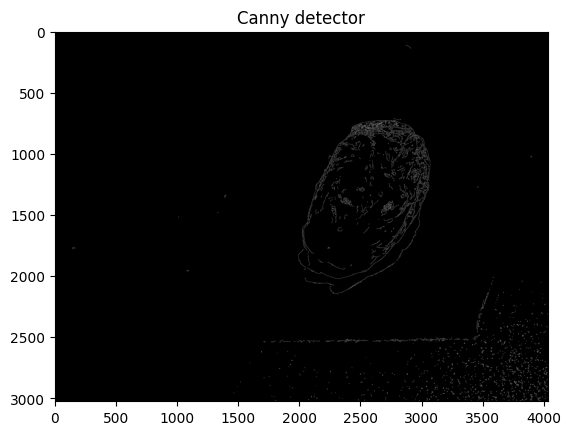

In [3]:
edges = feature.canny(sample_image)
plt.imshow(edges, cmap='gray')
plt.title('Canny detector')

Text(0.5, 1.0, 'Canny Edge Detection background removed images')

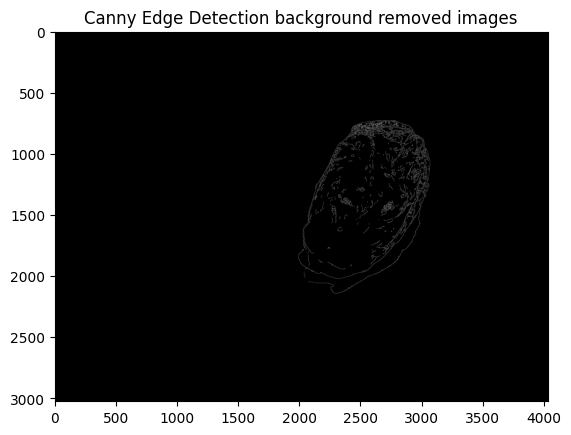

In [4]:
edges2 = feature.canny(sample_bg_image)
plt.imshow(edges2, cmap="gray")
plt.title("Canny Edge Detection background removed images")


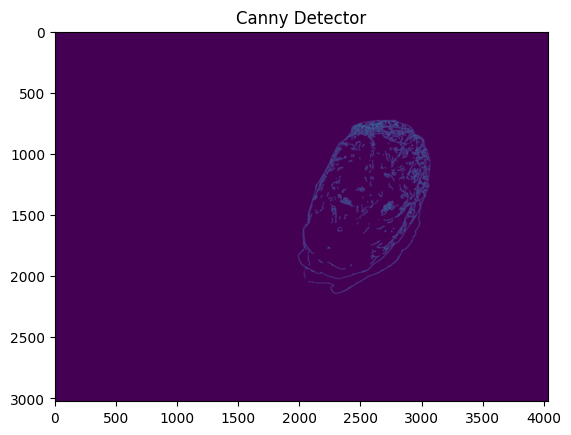

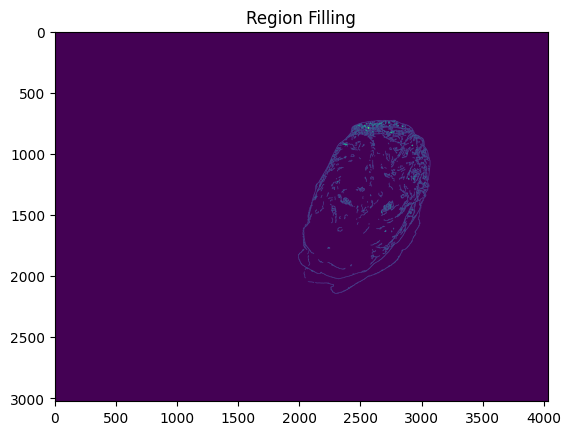

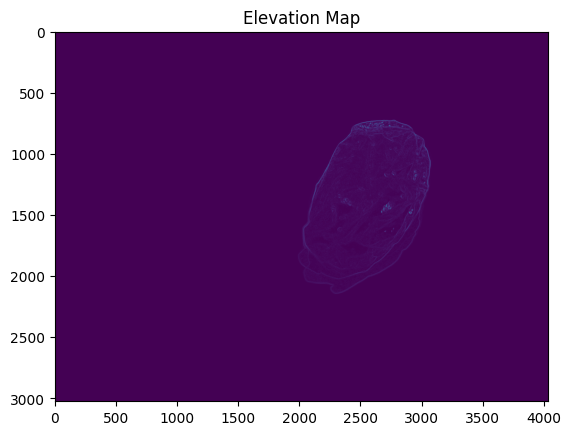

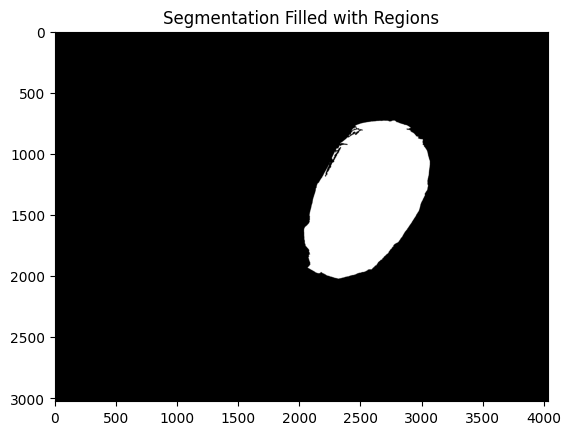

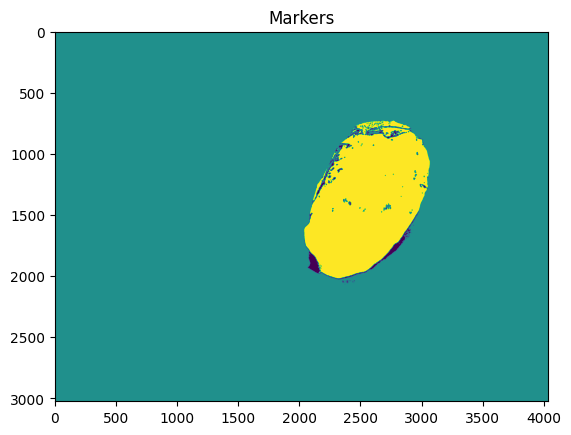

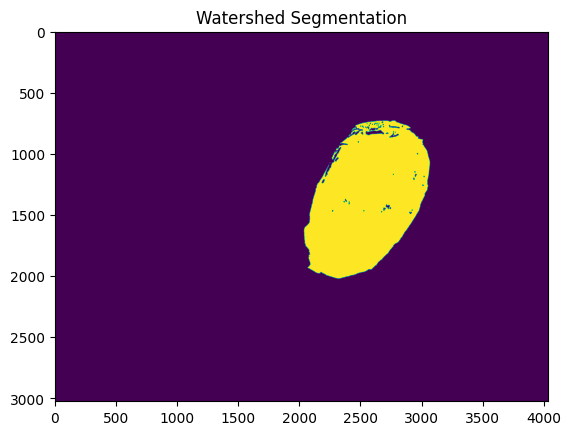

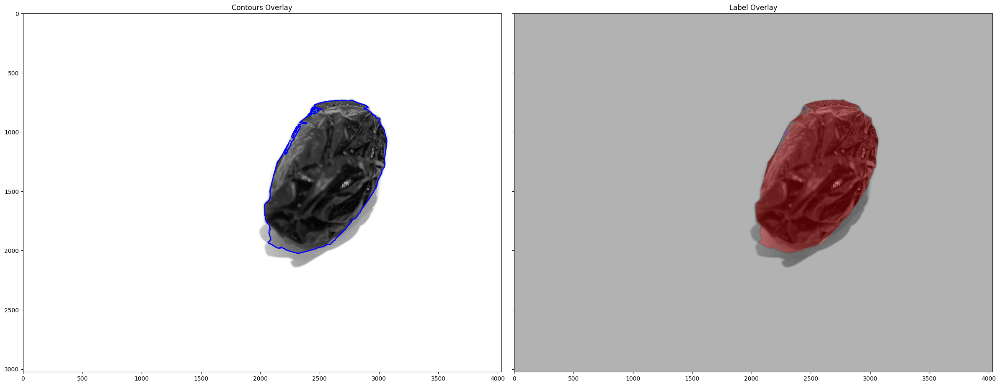

/tmp/ipykernel_11482/255548132.py:89: UserWarning: The following kwargs were not used by contour: 'label'
  ax.contour(segmentation_filled, [0.5], linewidths=1.8, colors='blue', label='Original Contour')
/tmp/ipykernel_11482/255548132.py:92: UserWarning: The following kwargs were not used by contour: 'label'
  ax.contour(padded_segmentation, [0.5], linewidths=1.8, colors='r', linestyles='dashed', label='Padded Contour')


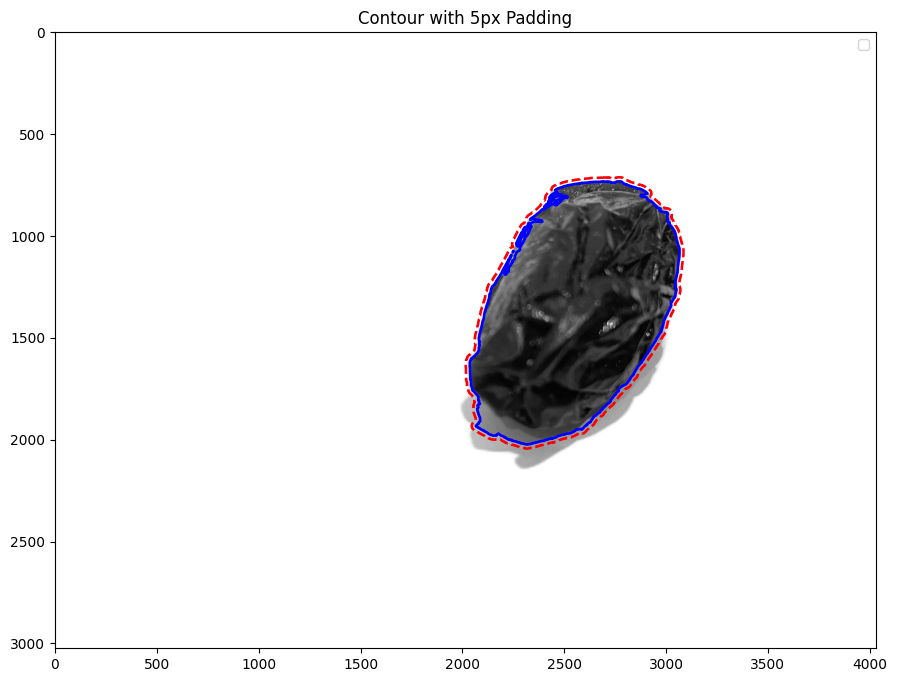

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import color, feature, filters, segmentation
from skimage.morphology import dilation, disk
from skimage.color import label2rgb
from scipy import ndimage as nd
from skimage.io import imread



# Canny edge detection
edges3 = feature.canny(sample_bg_image)
plt.imshow(edges3, interpolation='gaussian')
plt.title('Canny Detector')
plt.show()

# Fill regions to perform edge segmentation
fill_im = nd.binary_fill_holes(edges3)
plt.imshow(fill_im)
plt.title('Region Filling')
plt.show()

# Calculate the elevation map
elevation_map = filters.sobel(sample_bg_image)
plt.imshow(elevation_map)
plt.title('Elevation Map')
plt.show()

# Apply morphological dilation to make regions more distinct
sample_bg_image_dilated = dilation(sample_bg_image, disk(2))

# Generate an elevation map on the modified image
elevation_map = filters.sobel(sample_bg_image_dilated)

# Update markers based on the dilated image
markers = np.zeros_like(sample_bg_image_dilated, dtype=int)
markers[sample_bg_image_dilated < 0.5] = 2
markers[sample_bg_image_dilated > 0.6] = 1

# Perform watershed region segmentation
segmentation_result = segmentation.watershed(elevation_map, markers)

# Fill holes in the segmented result to create binary mask regions
segmentation_filled = nd.binary_fill_holes(segmentation_result - 1)

# Visualize segmentation result
plt.imshow(segmentation_filled, cmap='gray')
plt.title('Segmentation Filled with Regions')
plt.show()

plt.imshow(markers)
plt.title('Markers')
plt.show()

# Perform watershed segmentation
segmentation_result = segmentation.watershed(elevation_map, markers)
plt.imshow(segmentation_result)
plt.title('Watershed Segmentation')
plt.show()

# Fill holes in the segmented result
segmentation_filled = nd.binary_fill_holes(segmentation_result - 1)
label_rock, _ = nd.label(segmentation_filled)

# Overlay the labeled segmentation onto the original image
image_label_overlay = label2rgb(label_rock, image=sample_bg_image)

# Plot overlays and contours
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 16), sharey=True)
ax1.imshow(sample_bg_image, cmap='gray')
ax1.contour(segmentation_filled, [0.4], linewidths=1.8, colors='blue')
ax1.set_title('Contours Overlay')
ax2.imshow(image_label_overlay)
ax2.set_title('Label Overlay')

plt.tight_layout()
plt.show()

# Dilate the segmentation mask by 5 pixels
padded_segmentation = dilation(segmentation_filled, disk(20))
# Optional: Subtract the original segmentation to isolate only the padding region
padding_only = padded_segmentation & ~segmentation_filled

fig, ax = plt.subplots(figsize=(12, 8))
# Display the original grayscale image
ax.imshow(sample_bg_image, cmap='gray')

# Plot the original contour
ax.contour(segmentation_filled, [0.5], linewidths=1.8, colors='blue', label='Original Contour')

# Plot the padded contour
ax.contour(padded_segmentation, [0.5], linewidths=1.8, colors='r', linestyles='dashed', label='Padded Contour')

plt.legend(['Original Contour', 'Padded Contour'])
plt.title("Contour with 5px Padding")
plt.show()


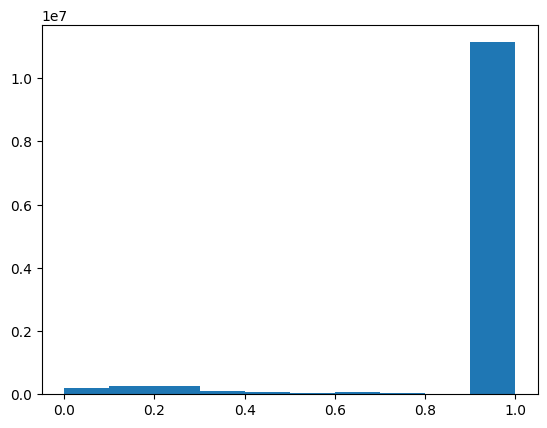

Contour 1: 1004906 pixels
  Below threshold: 824294 (82.03%)
  Contour 1 meets the condition.


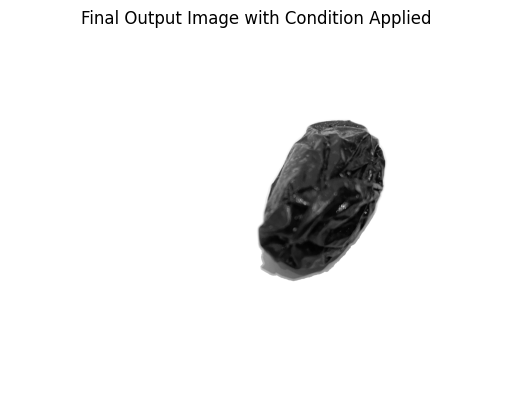

In [47]:
import numpy as np
from skimage import measure
import matplotlib.pyplot as plt

# Assuming `segmentation_filled` is your binary mask of the contours
# Threshold value
threshold = 0.4
percentage_threshold = 0.7

plt.hist(sample_bg_image.ravel())
plt.show()

# Create an output image initialized to the original image
output_image = np.copy(sample_bg_image)  # Start with the original image

# Label the padded contours
labeled_contours, num_contours = measure.label(padded_segmentation, return_num=True)

# Iterate over each labeled padded contour
for contour_label in range(1, num_contours + 1):
    # Create a mask for the current padded contour
    contour_mask = (labeled_contours == contour_label)

    # Get pixel intensity values within the contour
    contour_intensities = sample_bg_image[contour_mask]

    # Print to debug the intensities and conditions
    print(f"Contour {contour_label}: {len(contour_intensities)} pixels")
    below_threshold = np.sum(contour_intensities < threshold)
    percentage_below_threshold = below_threshold / len(contour_intensities) if len(contour_intensities) > 0 else 0
    print(f"  Below threshold: {below_threshold} ({percentage_below_threshold * 100:.2f}%)")

    # Check if the percentage is above the threshold condition
    if percentage_below_threshold >= percentage_threshold:
        print(f"  Contour {contour_label} meets the condition.")
        # Set pixels outside the contour to white in the output image
        output_image[~contour_mask] = 1  # Set outside pixels to white (1 for grayscale)
    else:
        print(f"  Contour {contour_label} does not meet the condition.")

# Convert the output image to a proper format for visualization
output_image_visual = (output_image * 255).astype(np.uint8)  # Scale back to uint8 if necessary

# Display the final output image
plt.imshow(output_image_visual, cmap='gray')
plt.title("Final Output Image with Condition Applied")
plt.axis('off')
plt.show()

In [52]:
def edge_detect_and_noise_remover(image):
    image = color.rgba2rgb(image)
    image = color.rgb2gray(image)
    
    canny_edge = feature.canny(image)    # Canny edge detection
    fill_im = nd.binary_fill_holes(canny_edge)    # Fill regions to perform edge segmentation

    elevation_map = filters.sobel(image)    # Calculate the elevation map
    image_dilated = dilation(image, disk(2))    # Apply morphological dilation to make regions more distinct
    elevation_map = filters.sobel(image_dilated)    # Generate an elevation map on the modified image

    # Update markers based on the dilated image
    markers = np.zeros_like(image_dilated, dtype=int)
    markers[image_dilated < 0.5] = 2
    markers[image_dilated > 0.6] = 1

    # Perform watershed region segmentation
    segmentation_result = segmentation.watershed(elevation_map, markers)
    # Fill holes in the segmented result to create binary mask regions
    segmentation_filled = nd.binary_fill_holes(segmentation_result - 1)
    label_rock, _ = nd.label(segmentation_filled)

    # Overlay the labeled segmentation onto the original image
    image_label_overlay = label2rgb(label_rock, image=image)

    # Dilate the segmentation mask by 20 pixels
    padded_segmentation = dilation(segmentation_filled, disk(20))
    # Optional: Subtract the original segmentation to isolate only the padding region
    padding_only = padded_segmentation & ~segmentation_filled

    # fig, ax = plt.subplots(figsize=(12, 8))
    # # Display the original grayscale image
    # ax.imshow(image, cmap='gray')
    # # Plot the original contour
    # ax.contour(segmentation_filled, [0.5], linewidths=1.8, colors='blue', label='Original Contour')
    # # Plot the padded contour
    # ax.contour(padded_segmentation, [0.5], linewidths=1.8, colors='r', linestyles='dashed', label='Padded Contour')
    # plt.legend(['Original Contour', 'Padded Contour'])
    # plt.title("Contour with 20px Padding")
    # plt.show()



    threshold = 0.4
    percentage_threshold = 0.7
    # Create an output image initialized to the original image
    output_image = np.copy(image)  # Start with the original image

    # Label the padded contours
    labeled_contours, num_contours = measure.label(padded_segmentation, return_num=True)


    # Iterate over each labeled padded contour
    for contour_label in range(1, num_contours + 1):
        # Create a mask for the current padded contour
        contour_mask = (labeled_contours == contour_label)

        # Get pixel intensity values within the contour
        contour_intensities = image[contour_mask]

        # Print to debug the intensities and conditions
        print(f"Contour {contour_label}: {len(contour_intensities)} pixels")
        below_threshold = np.sum(contour_intensities < threshold)
        percentage_below_threshold = below_threshold / len(contour_intensities) if len(contour_intensities) > 0 else 0
        print(f"  Below threshold: {below_threshold} ({percentage_below_threshold * 100:.2f}%)")

        # Check if the percentage is above the threshold condition
        if percentage_below_threshold >= percentage_threshold:
            print(f"  Contour {contour_label} meets the condition.")
            # Set pixels outside the contour to white in the output image
            output_image[~contour_mask] = 1  # Set outside pixels to white (1 for grayscale)
        else:
            print(f"  Contour {contour_label} does not meet the condition.")

    # Convert the output image to a proper format for visualization
    output_image_visual = (output_image * 255).astype(np.uint8)  # Scale back to uint8 if necessary
    # Display the final output image
    plt.imshow(output_image_visual, cmap='gray')
    plt.title("Final Output Image with Condition Applied")
    plt.axis('off')
    plt.show()

    return output_image_visual


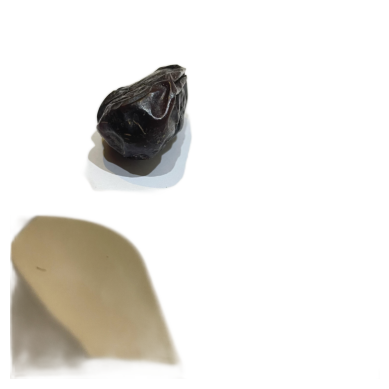

In [54]:
plt.imshow(imread("static/results/JD2007_3.png"), cmap='gray')
plt.axis('off')
plt.show()

Contour 1: 535783 pixels
  Below threshold: 425722 (79.46%)
  Contour 1 meets the condition.
Contour 2: 297140 pixels
  Below threshold: 0 (0.00%)
  Contour 2 does not meet the condition.
Contour 3: 1746 pixels
  Below threshold: 0 (0.00%)
  Contour 3 does not meet the condition.
Contour 4: 167887 pixels
  Below threshold: 327 (0.19%)
  Contour 4 does not meet the condition.


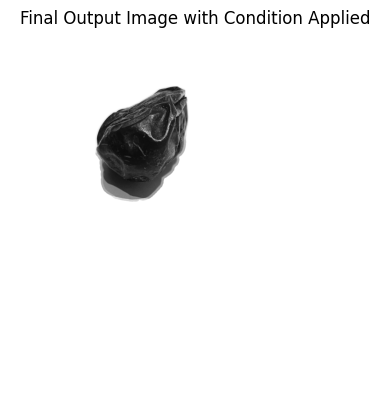

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)

In [55]:
edge_detect_and_noise_remover(imread("static/results/JD2007_3.png"))

Processing: static/results/JD2001_2.png
Contour 1: 1004906 pixels
  Below threshold: 824294 (82.03%)
  Contour 1 meets the condition.


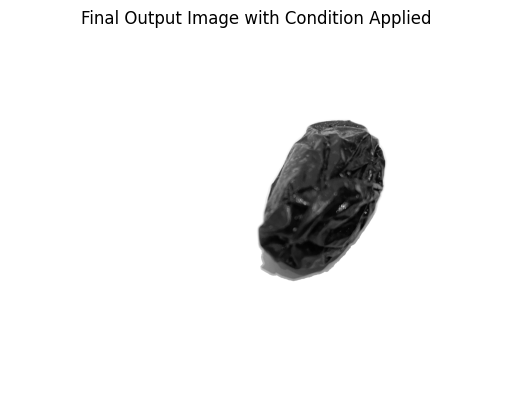

Processing: static/results/JD2023_4.png
Contour 1: 836906 pixels
  Below threshold: 718779 (85.89%)
  Contour 1 meets the condition.


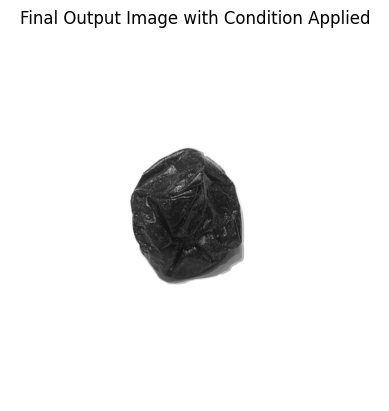

Processing: static/results/JD2021_8.png
Contour 1: 945029 pixels
  Below threshold: 786535 (83.23%)
  Contour 1 meets the condition.


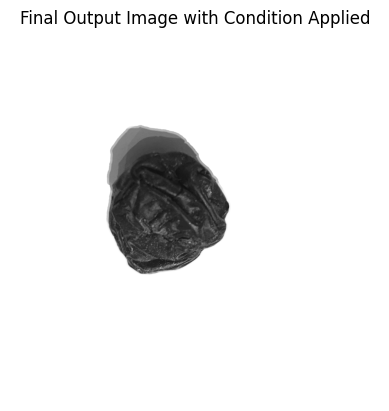

Processing: static/results/JD2021_3.png
Contour 1: 1083874 pixels
  Below threshold: 887854 (81.91%)
  Contour 1 meets the condition.


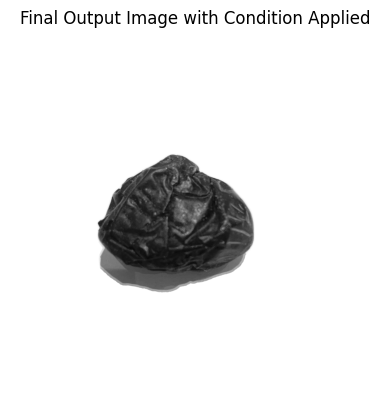

Processing: static/results/JD2003_6.png
Contour 1: 1025253 pixels
  Below threshold: 729987 (71.20%)
  Contour 1 meets the condition.


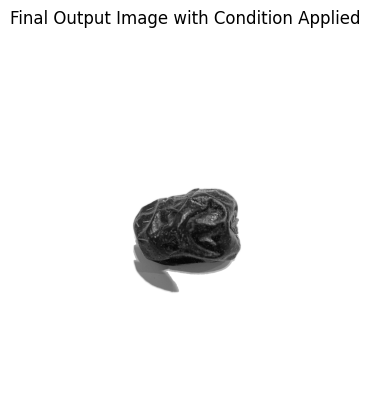

Processing: static/results/JD2040_7.png
Contour 1: 1013961 pixels
  Below threshold: 861028 (84.92%)
  Contour 1 meets the condition.


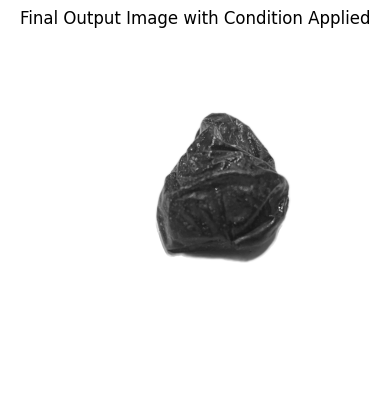

Processing: static/results/JD2034_3.png
Contour 1: 1001200 pixels
  Below threshold: 792216 (79.13%)
  Contour 1 meets the condition.


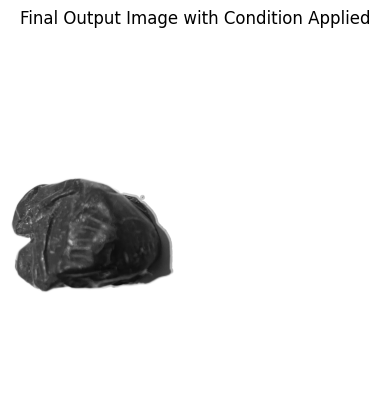

Processing: static/results/JD2030_4.png
Contour 1: 767677 pixels
  Below threshold: 637204 (83.00%)
  Contour 1 meets the condition.


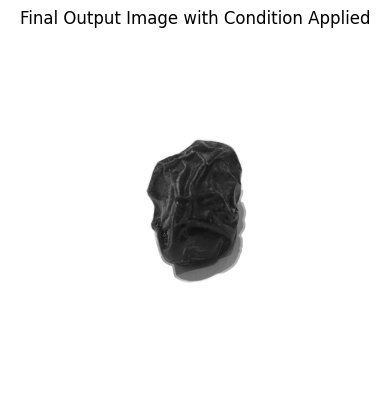

Processing: static/results/JD2015_5.png
Contour 1: 681030 pixels
  Below threshold: 589439 (86.55%)
  Contour 1 meets the condition.


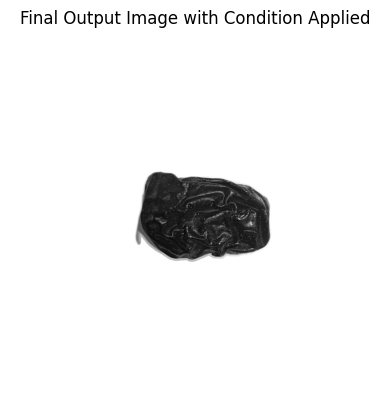

Processing: static/results/JD2030_1.png
Contour 1: 777341 pixels
  Below threshold: 687975 (88.50%)
  Contour 1 meets the condition.


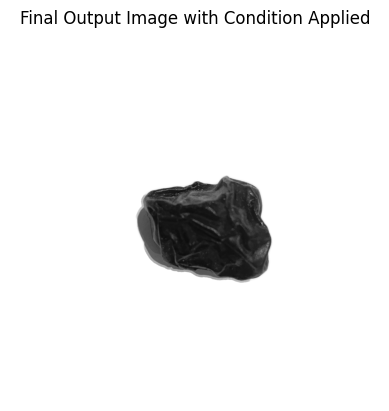

Processing: static/results/JD2005_5.png
Contour 1: 774099 pixels
  Below threshold: 651177 (84.12%)
  Contour 1 meets the condition.


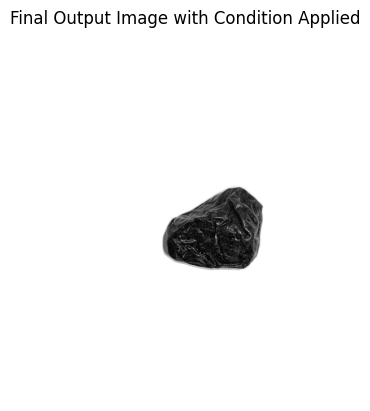

Processing: static/results/JD2026_6.png
Contour 1: 824501 pixels
  Below threshold: 699604 (84.85%)
  Contour 1 meets the condition.


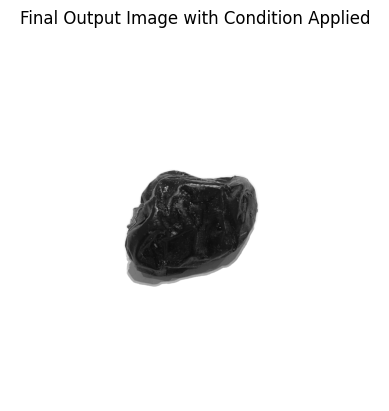

Processing: static/results/JD2022_4.png
Contour 1: 926972 pixels
  Below threshold: 786612 (84.86%)
  Contour 1 meets the condition.


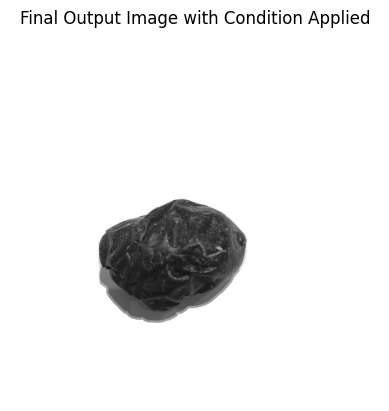

Processing: static/results/JD2014_4.png
Contour 1: 801243 pixels
  Below threshold: 643982 (80.37%)
  Contour 1 meets the condition.


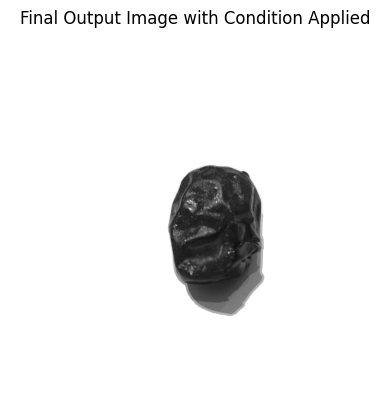

Processing: static/results/JD2011_4.png
Contour 1: 882022 pixels
  Below threshold: 702522 (79.65%)
  Contour 1 meets the condition.


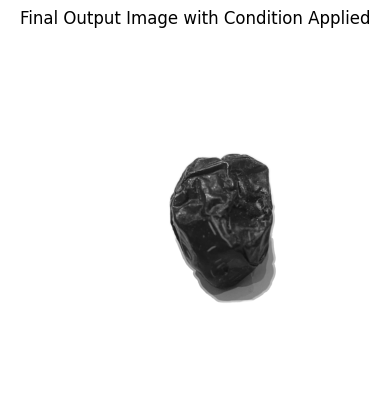

Processing: static/results/JD2006_6.png
Contour 1: 1252515 pixels
  Below threshold: 1015510 (81.08%)
  Contour 1 meets the condition.


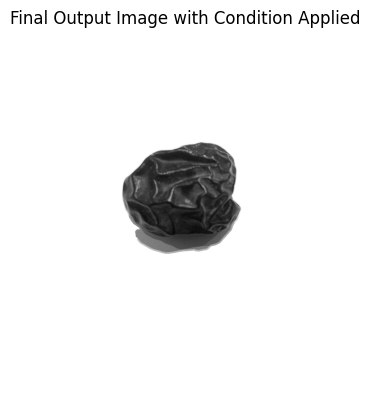

Processing: static/results/JD2003_7.png
Contour 1: 830858 pixels
  Below threshold: 691765 (83.26%)
  Contour 1 meets the condition.


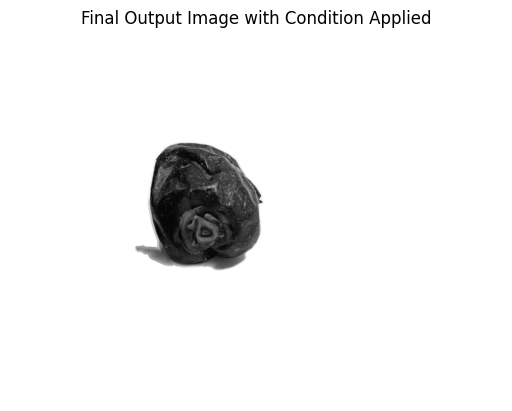

Processing: static/results/JD2012_8.png
Contour 1: 910101 pixels
  Below threshold: 688540 (75.66%)
  Contour 1 meets the condition.


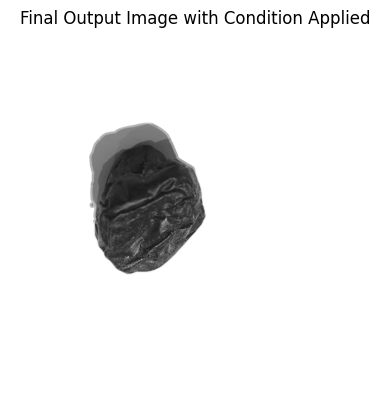

Processing: static/results/JD2027_2.png
Contour 1: 980352 pixels
  Below threshold: 833318 (85.00%)
  Contour 1 meets the condition.


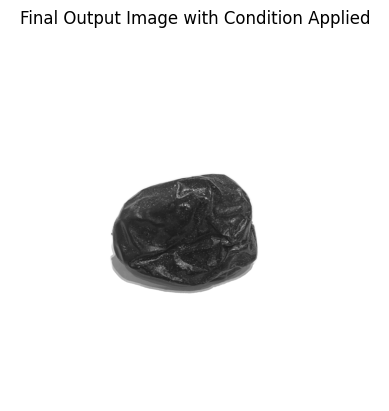

Processing: static/results/JD2002_7.png
Contour 1: 842046 pixels
  Below threshold: 716238 (85.06%)
  Contour 1 meets the condition.


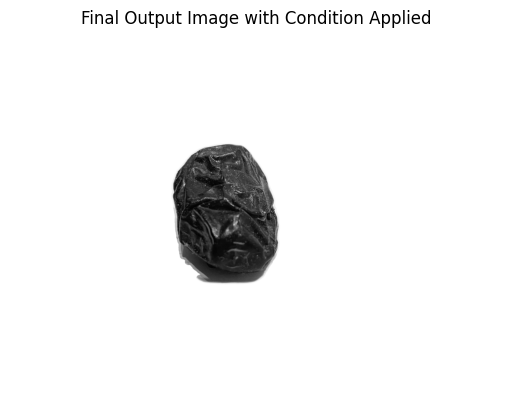

Processing: static/results/JD2029_2.png
Contour 1: 1161490 pixels
  Below threshold: 983579 (84.68%)
  Contour 1 meets the condition.


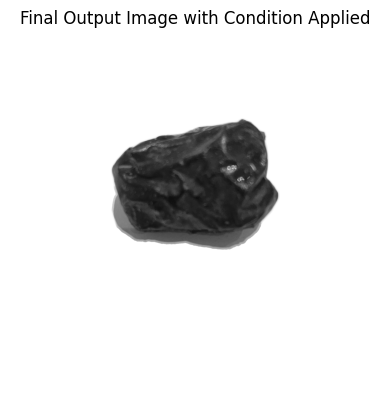

Processing: static/results/JD2032_2.png
Contour 1: 1132423 pixels
  Below threshold: 892258 (78.79%)
  Contour 1 meets the condition.


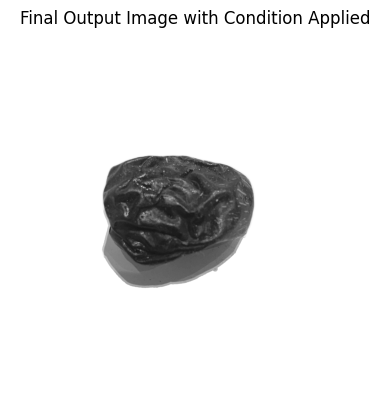

Processing: static/results/JD2013_4.png
Contour 1: 752016 pixels
  Below threshold: 612484 (81.45%)
  Contour 1 meets the condition.


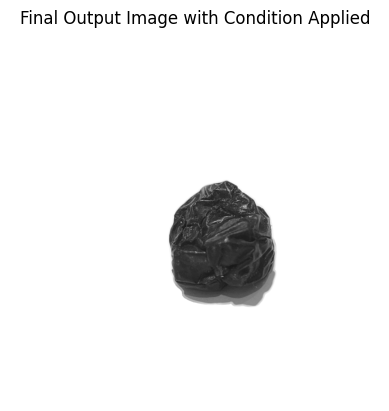

Processing: static/results/JD2003_1.png
Contour 1: 899528 pixels
  Below threshold: 730747 (81.24%)
  Contour 1 meets the condition.


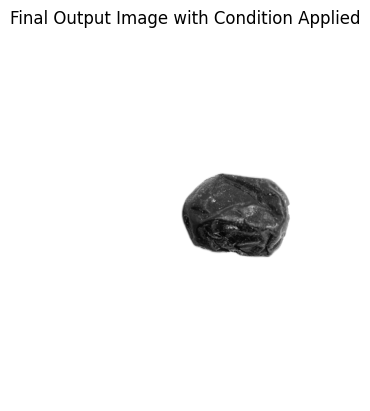

Processing: static/results/JD2015_1.png
Contour 1: 726105 pixels
  Below threshold: 637293 (87.77%)
  Contour 1 meets the condition.


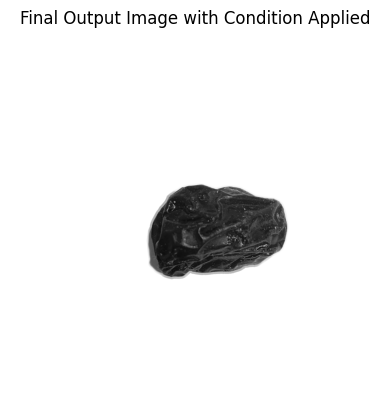

Processing: static/results/JD2026_1.png
Contour 1: 754522 pixels
  Below threshold: 661096 (87.62%)
  Contour 1 meets the condition.


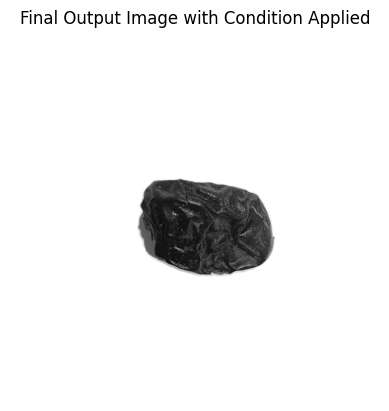

Processing: static/results/JD2005_6.png
Contour 1: 1191066 pixels
  Below threshold: 978527 (82.16%)
  Contour 1 meets the condition.


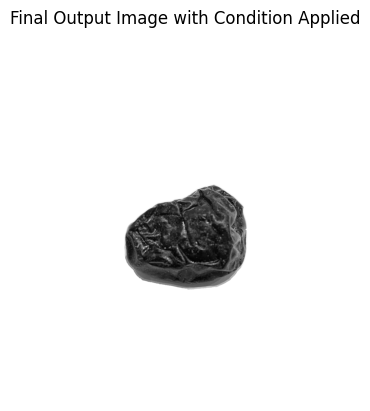

Processing: static/results/JD2037_2.png
Contour 1: 1146399 pixels
  Below threshold: 891275 (77.75%)
  Contour 1 meets the condition.


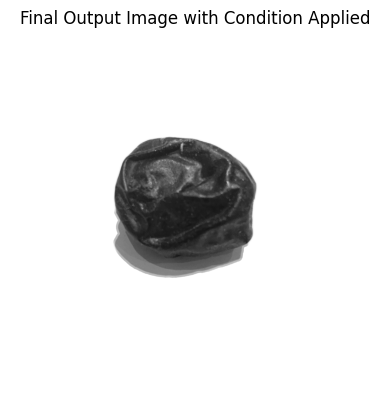

Processing: static/results/JD2020_4.png
Contour 1: 834562 pixels
  Below threshold: 670769 (80.37%)
  Contour 1 meets the condition.


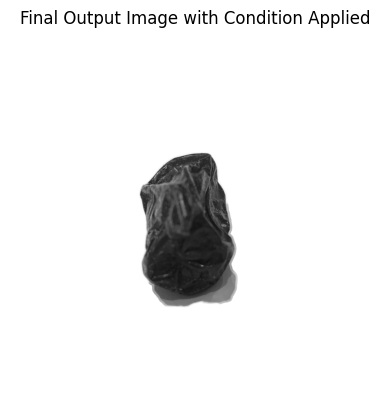

Processing: static/results/JD2012_3.png
Contour 1: 709824 pixels
  Below threshold: 604353 (85.14%)
  Contour 1 meets the condition.


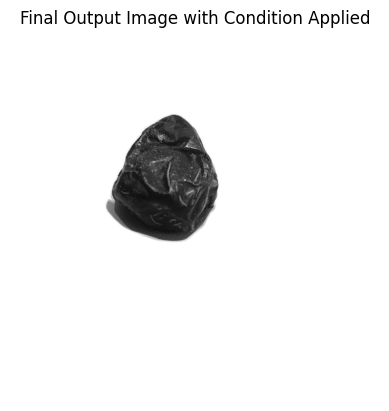

Processing: static/results/JD2040_5.png
Contour 1: 1239851 pixels
  Below threshold: 990852 (79.92%)
  Contour 1 meets the condition.


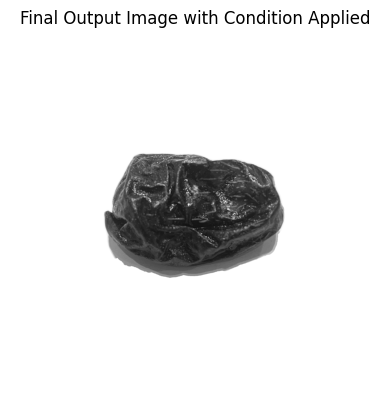

Processing: static/results/JD2010_5.png
Contour 1: 777729 pixels
  Below threshold: 677265 (87.08%)
  Contour 1 meets the condition.


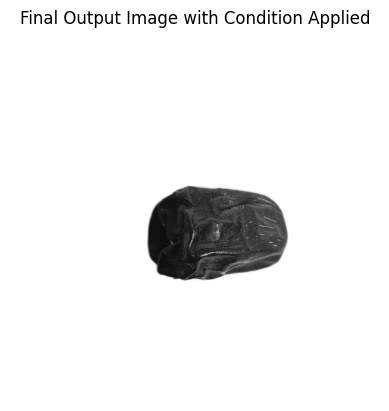

Processing: static/results/JD2016_7.png
Contour 1: 574526 pixels
  Below threshold: 495586 (86.26%)
  Contour 1 meets the condition.


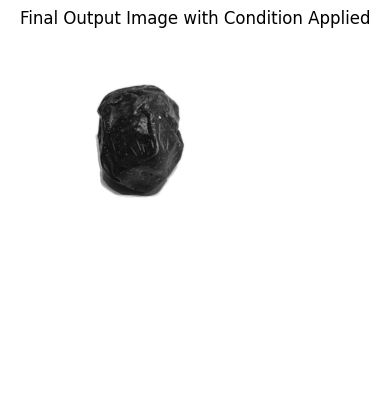

Processing: static/results/JD2011_2.png
Contour 1: 1034322 pixels
  Below threshold: 871868 (84.29%)
  Contour 1 meets the condition.


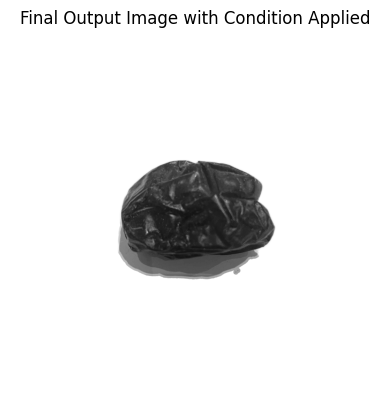

Processing: static/results/JD2002_1.png
Contour 1: 854996 pixels
  Below threshold: 711557 (83.22%)
  Contour 1 meets the condition.


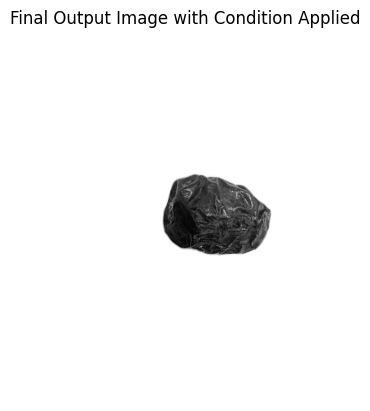

Processing: static/results/JD2020_3.png
Contour 1: 665258 pixels
  Below threshold: 549263 (82.56%)
  Contour 1 meets the condition.


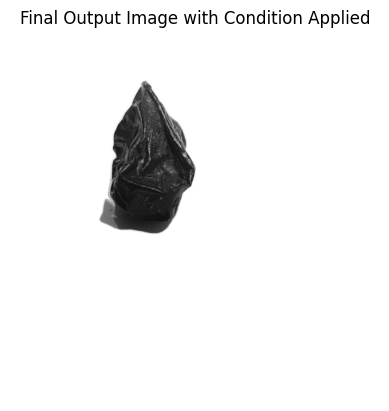

Processing: static/results/JD2013_3.png
Contour 1: 647332 pixels
  Below threshold: 556633 (85.99%)
  Contour 1 meets the condition.


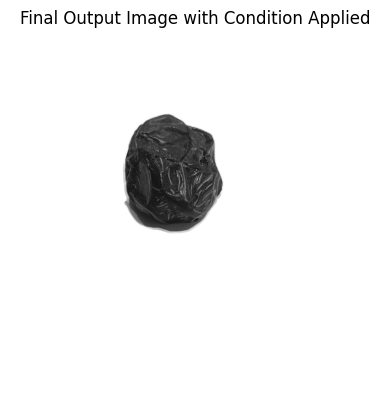

Processing: static/results/JD2033_1.png
Contour 1: 764424 pixels
  Below threshold: 683529 (89.42%)
  Contour 1 meets the condition.
Contour 2: 1444 pixels
  Below threshold: 17 (1.18%)
  Contour 2 does not meet the condition.
Contour 3: 1416 pixels
  Below threshold: 8 (0.56%)
  Contour 3 does not meet the condition.


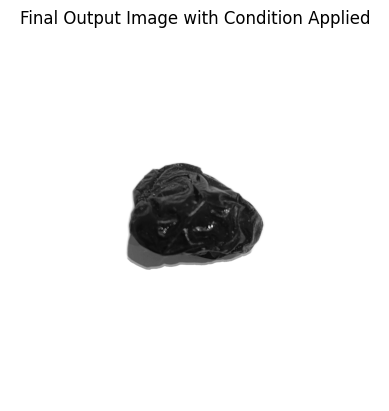

Processing: static/results/JD2038_8.png
Contour 1: 766339 pixels
  Below threshold: 630271 (82.24%)
  Contour 1 meets the condition.
Contour 2: 1614 pixels
  Below threshold: 14 (0.87%)
  Contour 2 does not meet the condition.


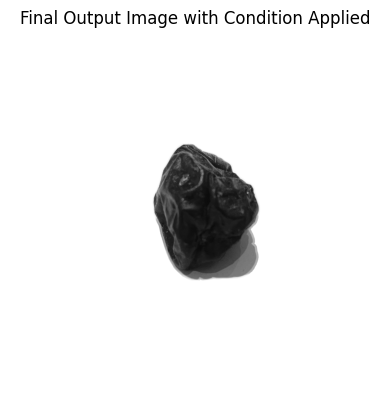

Processing: static/results/JD2026_3.png
Contour 1: 590516 pixels
  Below threshold: 508285 (86.07%)
  Contour 1 meets the condition.


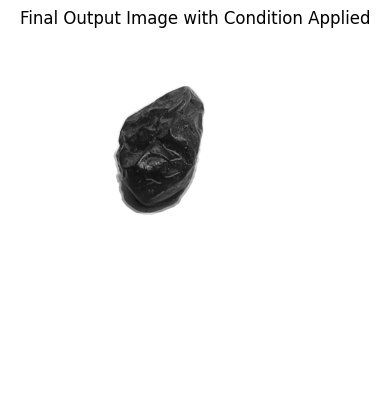

Processing: static/results/JD2019_7.png
Contour 1: 673764 pixels
  Below threshold: 547304 (81.23%)
  Contour 1 meets the condition.


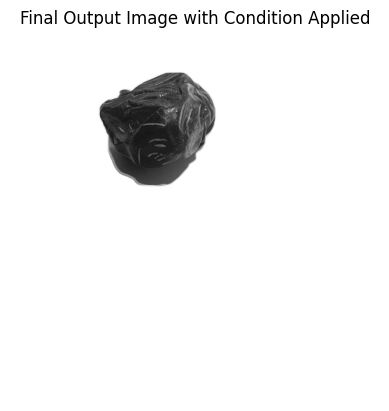

Processing: static/results/JD2005_1.png
Contour 1: 1220255 pixels
  Below threshold: 966817 (79.23%)
  Contour 1 meets the condition.


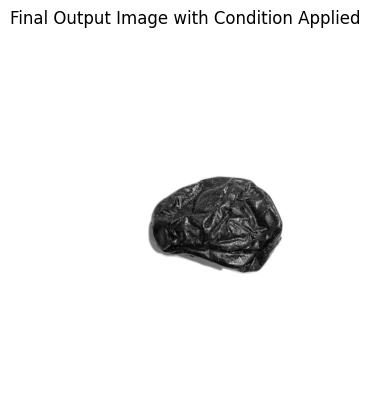

Processing: static/results/JD2019_2.png
Contour 1: 908989 pixels
  Below threshold: 769405 (84.64%)
  Contour 1 meets the condition.


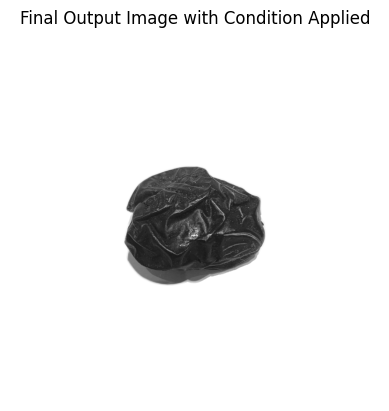

Processing: static/results/JD2028_4.png
Contour 1: 862571 pixels
  Below threshold: 722227 (83.73%)
  Contour 1 meets the condition.


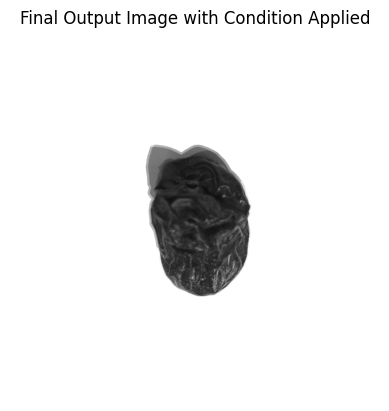

Processing: static/results/JD2014_7.png
Contour 1: 616875 pixels
  Below threshold: 518236 (84.01%)
  Contour 1 meets the condition.


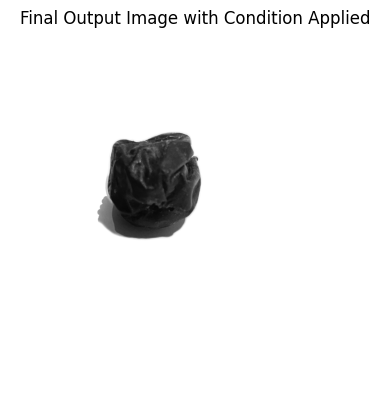

Processing: static/results/JD2039_7.png
Contour 1: 1010583 pixels
  Below threshold: 838094 (82.93%)
  Contour 1 meets the condition.


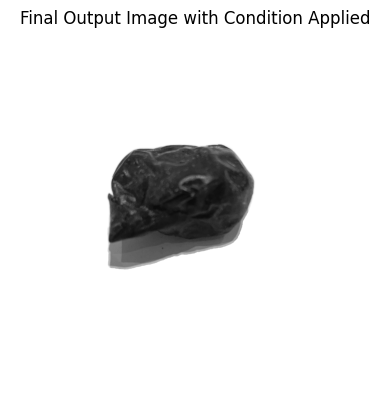

Processing: static/results/JD2023_5.png
Contour 1: 790046 pixels
  Below threshold: 651421 (82.45%)
  Contour 1 meets the condition.


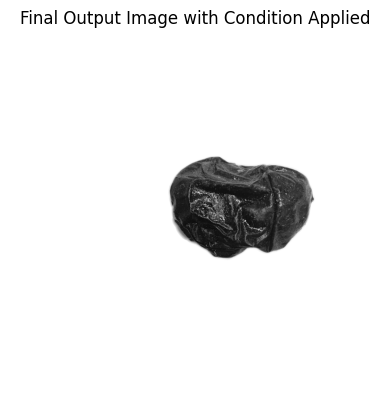

Processing: static/results/JD2010_3.png
Contour 1: 657422 pixels
  Below threshold: 572093 (87.02%)
  Contour 1 meets the condition.


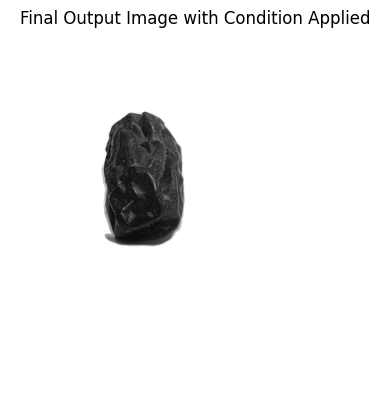

Processing: static/results/JD2028_5.png
Contour 1: 666270 pixels
  Below threshold: 568448 (85.32%)
  Contour 1 meets the condition.


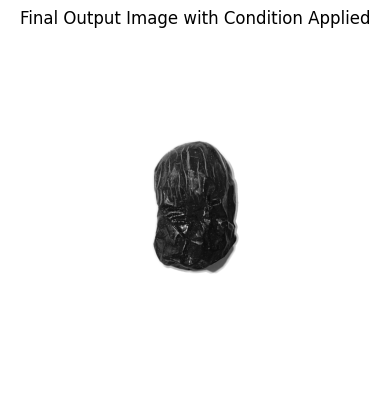

Processing: static/results/JD2005_7.png
Contour 1: 946676 pixels
  Below threshold: 804739 (85.01%)
  Contour 1 meets the condition.


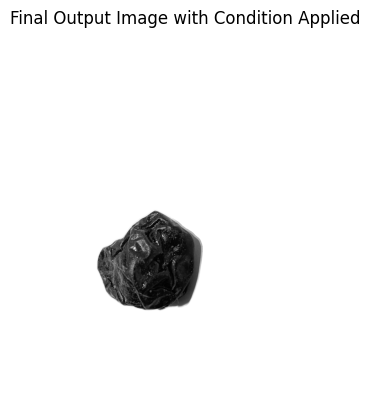

Processing: static/results/JD2031_1.png
Contour 1: 1027406 pixels
  Below threshold: 866709 (84.36%)
  Contour 1 meets the condition.


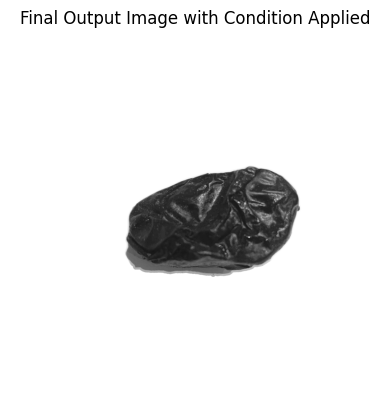

Processing: static/results/JD2019_5.png
Contour 1: 849749 pixels
  Below threshold: 738267 (86.88%)
  Contour 1 meets the condition.


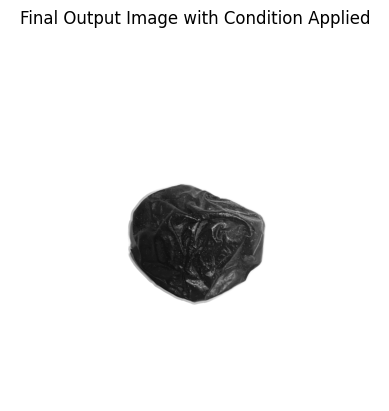

Processing: static/results/JD2023_6.png
Contour 1: 861438 pixels
  Below threshold: 692329 (80.37%)
  Contour 1 meets the condition.


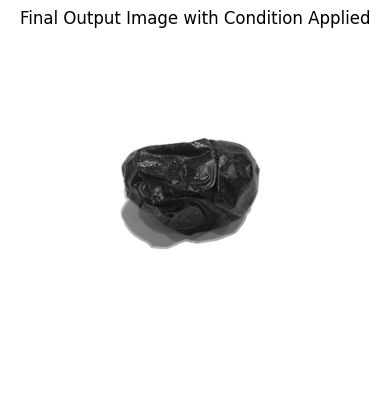

Processing: static/results/JD2030_8.png
Contour 1: 857204 pixels
  Below threshold: 731886 (85.38%)
  Contour 1 meets the condition.


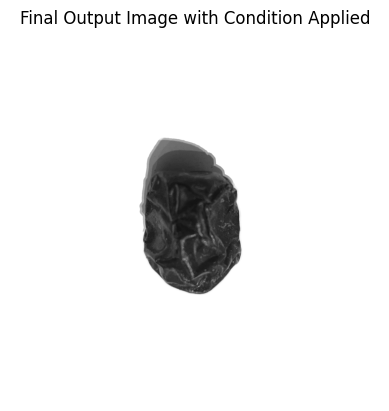

Processing: static/results/JD2039_4.png
Contour 1: 731194 pixels
  Below threshold: 620090 (84.81%)
  Contour 1 meets the condition.


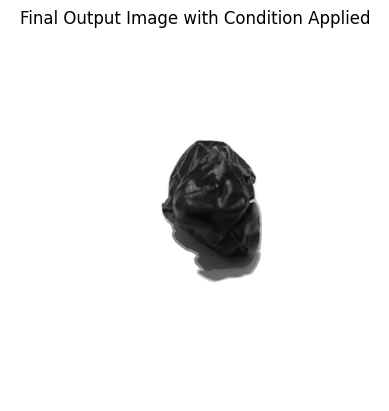

Processing: static/results/JD2040_1.png
Contour 1: 674908 pixels
  Below threshold: 581857 (86.21%)
  Contour 1 meets the condition.


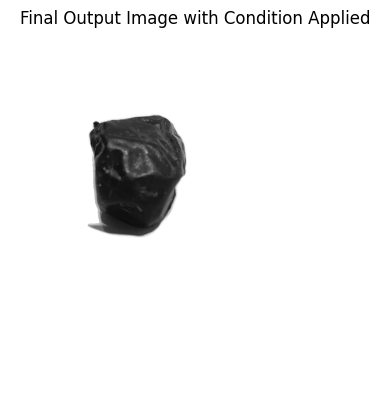

Processing: static/results/JD2008_8.png
Contour 1: 509394 pixels
  Below threshold: 412665 (81.01%)
  Contour 1 meets the condition.


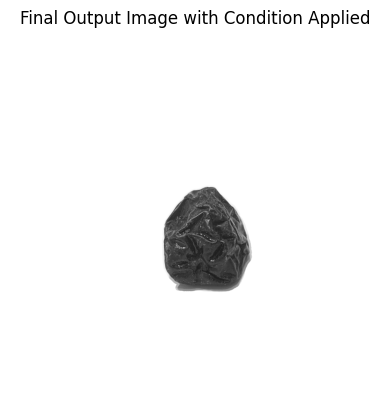

Processing: static/results/JD2003_4.png
Contour 1: 853660 pixels
  Below threshold: 709786 (83.15%)
  Contour 1 meets the condition.


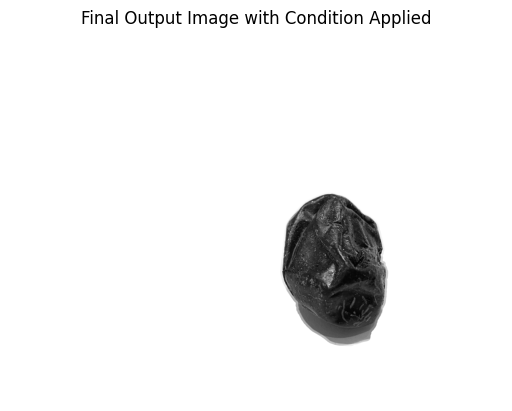

Processing: static/results/JD2007_1.png
Contour 1: 539812 pixels
  Below threshold: 454724 (84.24%)
  Contour 1 meets the condition.


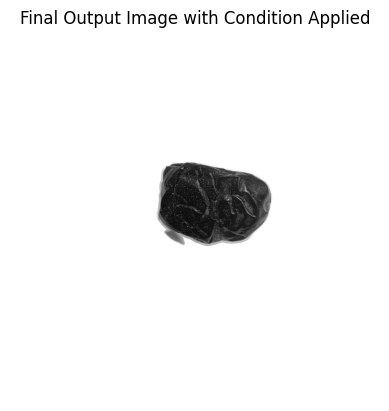

Processing: static/results/JD2039_5.png
Contour 1: 832611 pixels
  Below threshold: 721367 (86.64%)
  Contour 1 meets the condition.


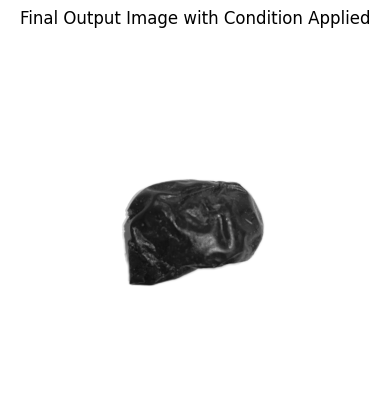

Processing: static/results/JD2036_3.png
Contour 1: 767671 pixels
  Below threshold: 650907 (84.79%)
  Contour 1 meets the condition.


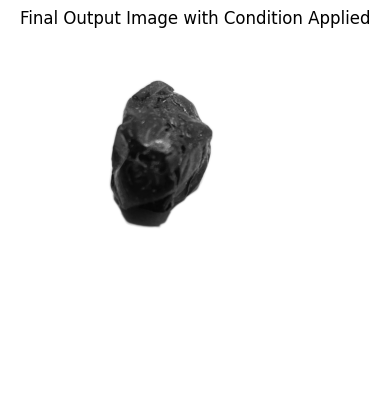

Processing: static/results/JD2004_8.png
Contour 1: 963651 pixels
  Below threshold: 827089 (85.83%)
  Contour 1 meets the condition.


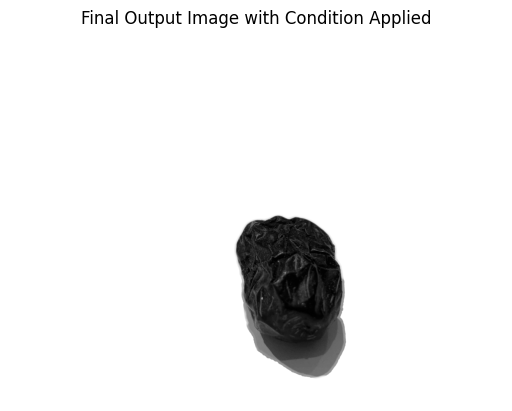

Processing: static/results/JD2007_6.png
Contour 1: 917255 pixels
  Below threshold: 758317 (82.67%)
  Contour 1 meets the condition.


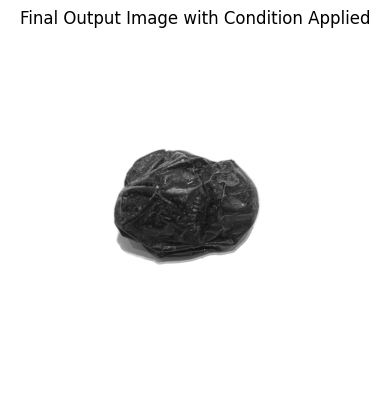

Processing: static/results/JD2024_6.png
Contour 1: 962362 pixels
  Below threshold: 806782 (83.83%)
  Contour 1 meets the condition.
Contour 2: 1429 pixels
  Below threshold: 3 (0.21%)
  Contour 2 does not meet the condition.


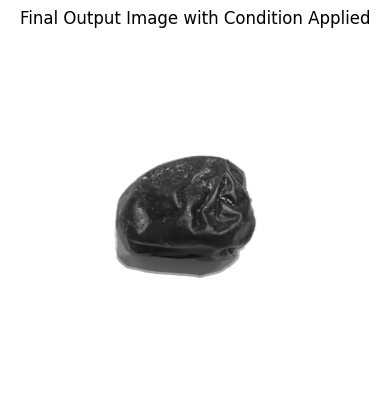

Processing: static/results/JD2035_6.png
Contour 1: 1205122 pixels
  Below threshold: 1019628 (84.61%)
  Contour 1 meets the condition.


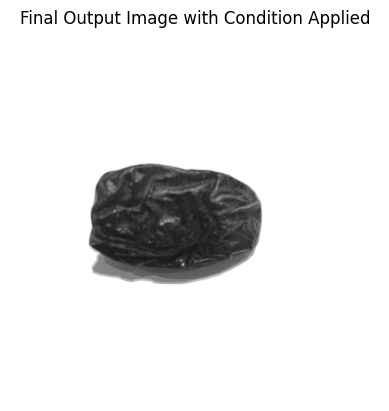

Processing: static/results/JD2013_7.png
Contour 1: 591006 pixels
  Below threshold: 499019 (84.44%)
  Contour 1 meets the condition.


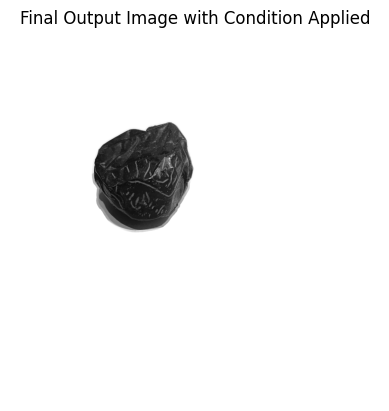

Processing: static/results/JD2032_3.png
Contour 1: 1105803 pixels
  Below threshold: 922196 (83.40%)
  Contour 1 meets the condition.


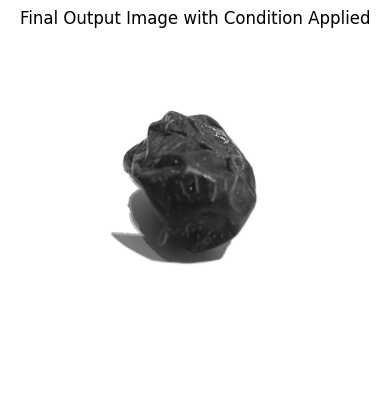

Processing: static/results/JD2026_5.png
Contour 1: 801851 pixels
  Below threshold: 706263 (88.08%)
  Contour 1 meets the condition.


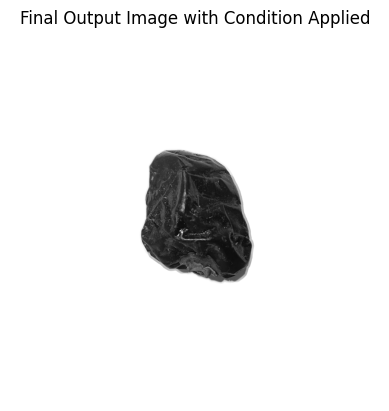

Processing: static/results/JD2020_6.png
Contour 1: 865373 pixels
  Below threshold: 723758 (83.64%)
  Contour 1 meets the condition.


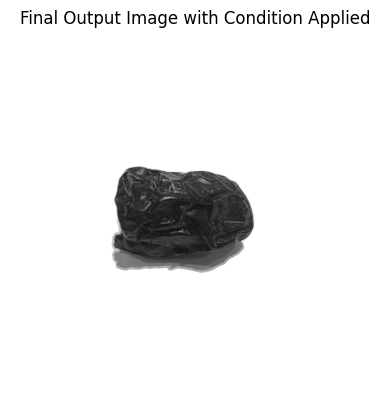

Processing: static/results/JD2037_5.png
Contour 1: 878669 pixels
  Below threshold: 763357 (86.88%)
  Contour 1 meets the condition.


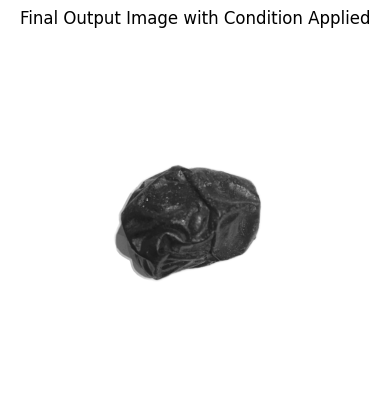

Processing: static/results/JD2021_4.png
Contour 1: 1083945 pixels
  Below threshold: 887960 (81.92%)
  Contour 1 meets the condition.


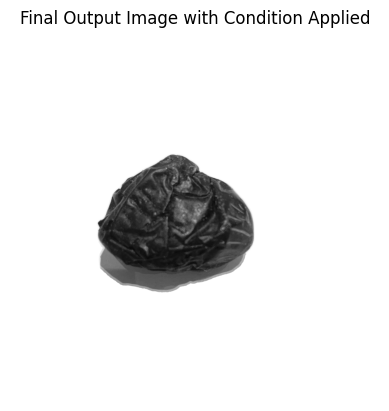

Processing: static/results/JD2007_3.png
Contour 1: 535783 pixels
  Below threshold: 425722 (79.46%)
  Contour 1 meets the condition.
Contour 2: 297140 pixels
  Below threshold: 0 (0.00%)
  Contour 2 does not meet the condition.
Contour 3: 1746 pixels
  Below threshold: 0 (0.00%)
  Contour 3 does not meet the condition.
Contour 4: 167887 pixels
  Below threshold: 327 (0.19%)
  Contour 4 does not meet the condition.


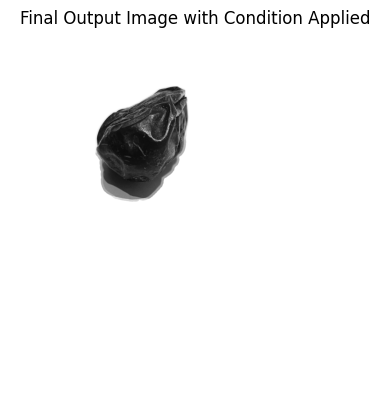

Processing: static/results/JD2013_5.png
Contour 1: 721513 pixels
  Below threshold: 614281 (85.14%)
  Contour 1 meets the condition.


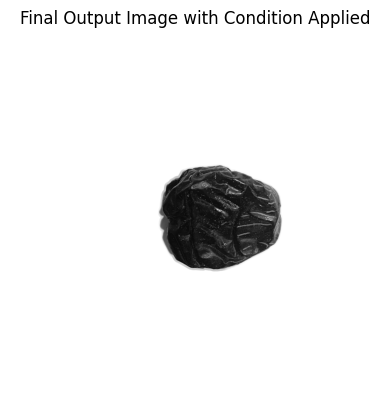

Processing: static/results/JD2040_8.png
Contour 1: 1162421 pixels
  Below threshold: 959879 (82.58%)
  Contour 1 meets the condition.


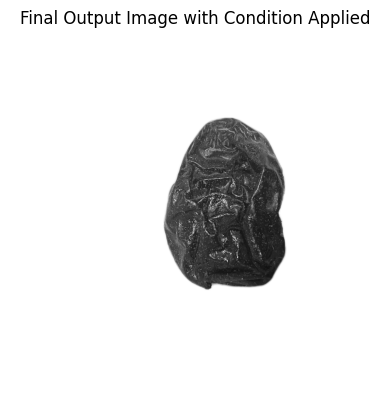

Processing: static/results/JD2016_4.png
Contour 1: 687635 pixels
  Below threshold: 498653 (72.52%)
  Contour 1 meets the condition.


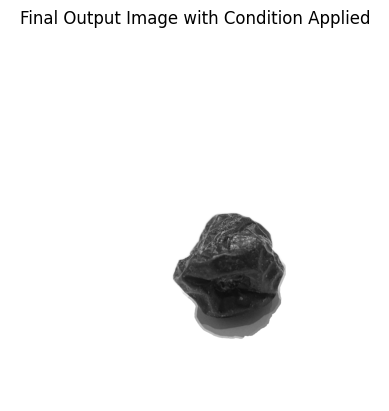

Processing: static/results/JD2014_1.png
Contour 1: 845192 pixels
  Below threshold: 716832 (84.81%)
  Contour 1 meets the condition.


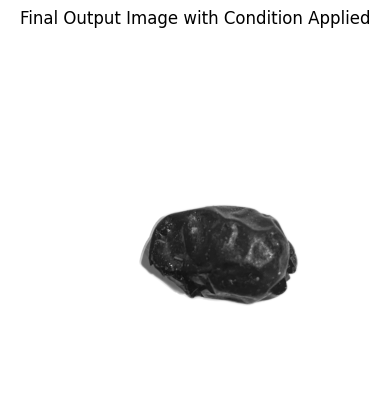

Processing: static/results/JD2016_1.png
Contour 1: 933677 pixels
  Below threshold: 793082 (84.94%)
  Contour 1 meets the condition.


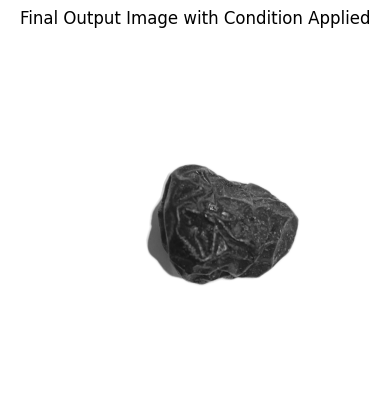

Processing: static/results/JD2039_1.png
Contour 1: 769432 pixels
  Below threshold: 669558 (87.02%)
  Contour 1 meets the condition.


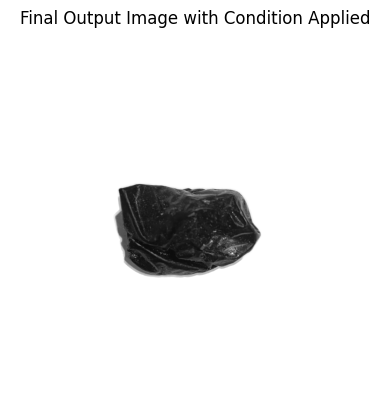

Processing: static/results/JD2041_4.png
Contour 1: 858331 pixels
  Below threshold: 719834 (83.86%)
  Contour 1 meets the condition.


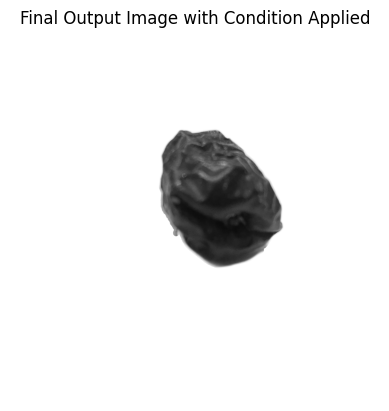

Processing: static/results/JD2019_1.png
Contour 1: 825333 pixels
  Below threshold: 714089 (86.52%)
  Contour 1 meets the condition.


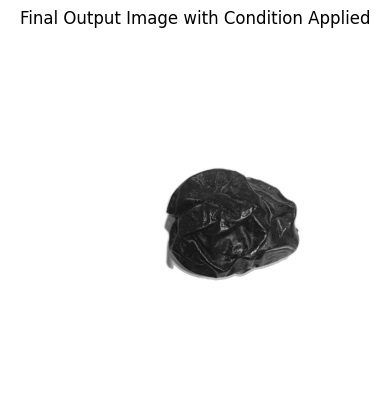

Processing: static/results/JD2036_1.png
Contour 1: 940233 pixels
  Below threshold: 808290 (85.97%)
  Contour 1 meets the condition.


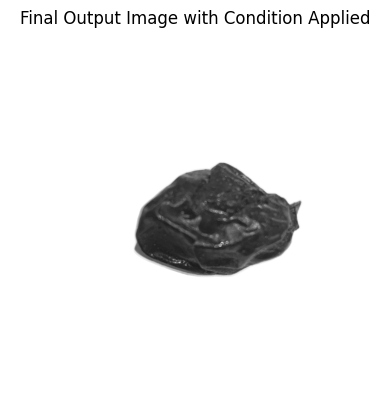

Processing: static/results/JD2024_2.png
Contour 1: 984168 pixels
  Below threshold: 814073 (82.72%)
  Contour 1 meets the condition.
Contour 2: 1373 pixels
  Below threshold: 3 (0.22%)
  Contour 2 does not meet the condition.


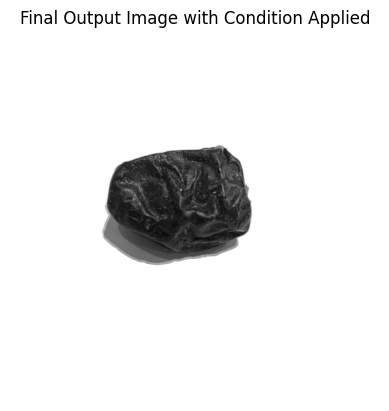

Processing: static/results/JD2017_1.png
Contour 1: 854070 pixels
  Below threshold: 762081 (89.23%)
  Contour 1 meets the condition.


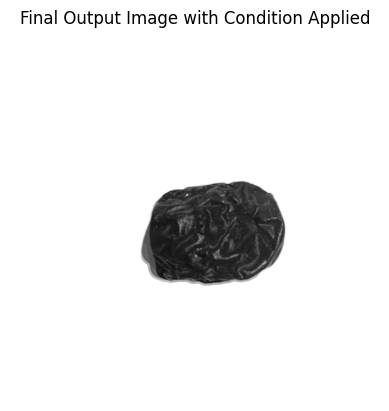

Processing: static/results/JD2040_6.png
Contour 1: 1165877 pixels
  Below threshold: 954409 (81.86%)
  Contour 1 meets the condition.


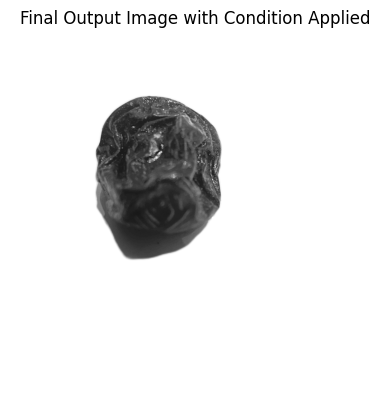

Processing: static/results/JD2029_3.png
Contour 1: 778829 pixels
  Below threshold: 658581 (84.56%)
  Contour 1 meets the condition.


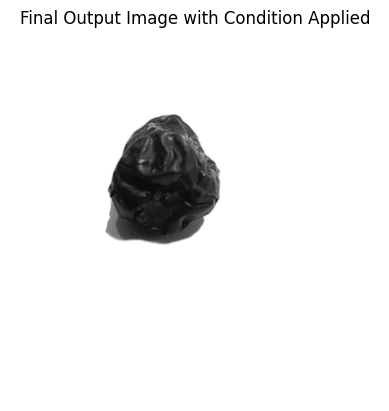

Processing: static/results/JD2034_7.png
Contour 1: 869860 pixels
  Below threshold: 756059 (86.92%)
  Contour 1 meets the condition.


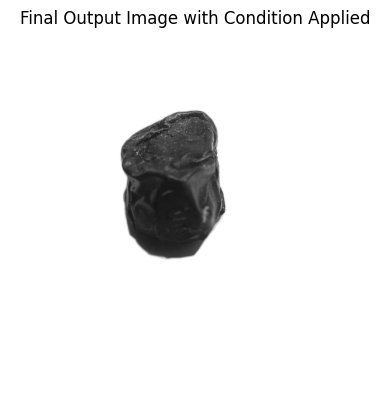

Processing: static/results/JD2037_8.png
Contour 1: 842897 pixels
  Below threshold: 727336 (86.29%)
  Contour 1 meets the condition.


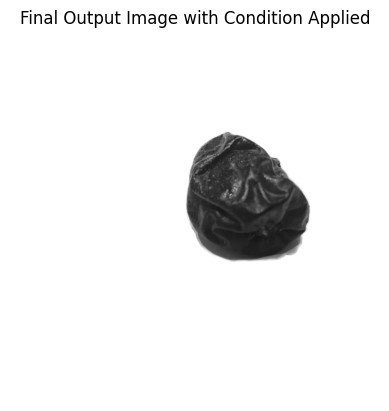

Processing: static/results/JD2035_8.png
Contour 1: 738366 pixels
  Below threshold: 624945 (84.64%)
  Contour 1 meets the condition.


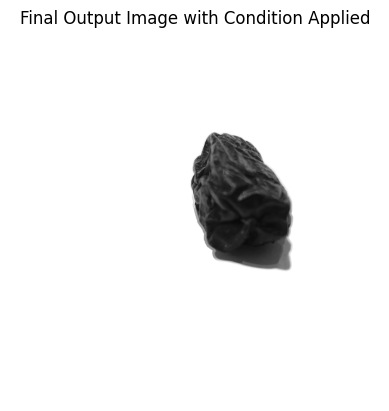

Processing: static/results/JD2009_1.png
Contour 1: 917711 pixels
  Below threshold: 752482 (82.00%)
  Contour 1 meets the condition.


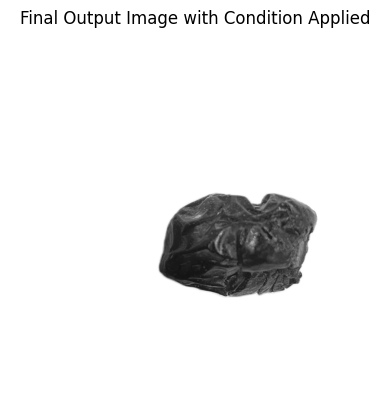

Processing: static/results/JD2024_3.png
Contour 1: 864840 pixels
  Below threshold: 691334 (79.94%)
  Contour 1 meets the condition.


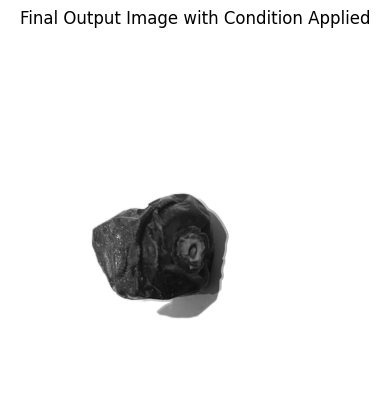

Processing: static/results/JD2026_7.png
Contour 1: 590186 pixels
  Below threshold: 512741 (86.88%)
  Contour 1 meets the condition.


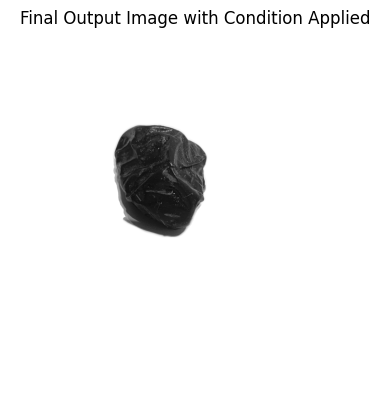

Processing: static/results/JD2024_5.png
Contour 1: 752506 pixels
  Below threshold: 641717 (85.28%)
  Contour 1 meets the condition.


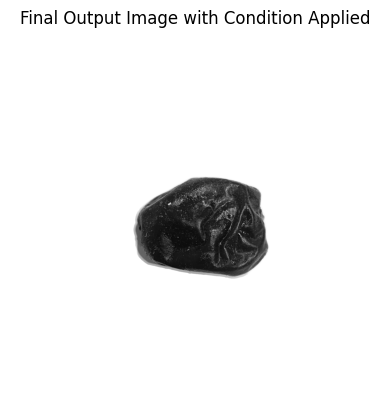

Processing: static/results/JD2027_8.png
Contour 1: 790340 pixels
  Below threshold: 665023 (84.14%)
  Contour 1 meets the condition.


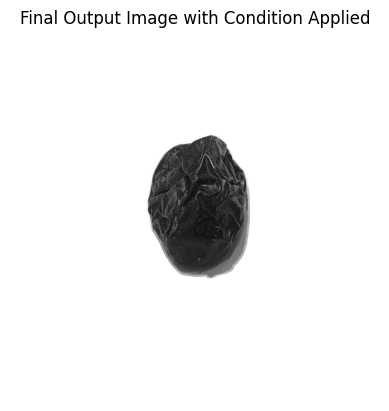

Processing: static/results/JD2011_5.png
Contour 1: 906572 pixels
  Below threshold: 768267 (84.74%)
  Contour 1 meets the condition.


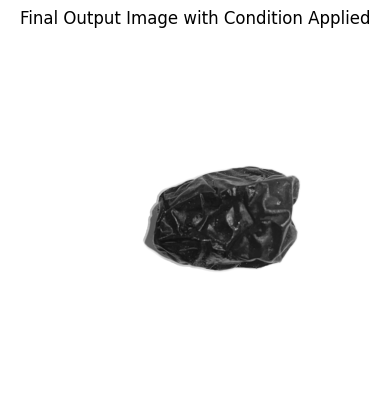

Processing: static/results/JD2021_7.png
Contour 1: 945029 pixels
  Below threshold: 786535 (83.23%)
  Contour 1 meets the condition.


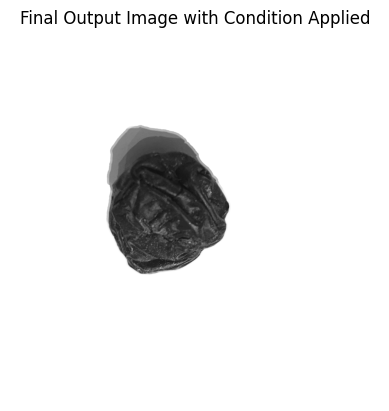

Processing: static/results/JD2004_6.png
Contour 1: 1075474 pixels
  Below threshold: 978347 (90.97%)
  Contour 1 meets the condition.


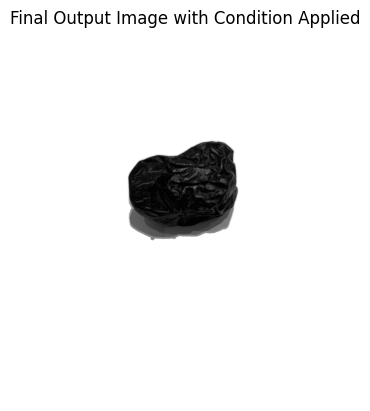

Processing: static/results/JD2032_4.png
Contour 1: 979805 pixels
  Below threshold: 786939 (80.32%)
  Contour 1 meets the condition.


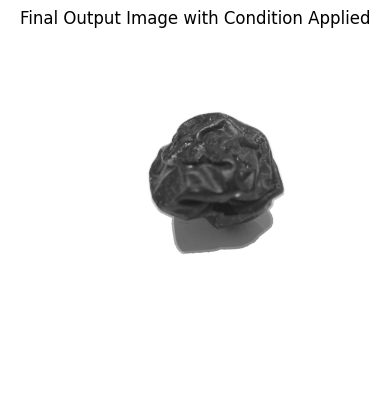

Processing: static/results/JD2031_8.png
Contour 1: 840563 pixels
  Below threshold: 676497 (80.48%)
  Contour 1 meets the condition.


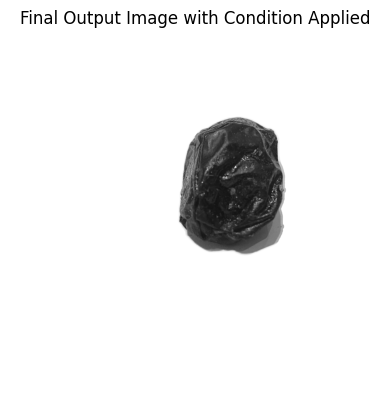

Processing: static/results/JD2031_2.png
Contour 1: 1128927 pixels
  Below threshold: 853572 (75.61%)
  Contour 1 meets the condition.


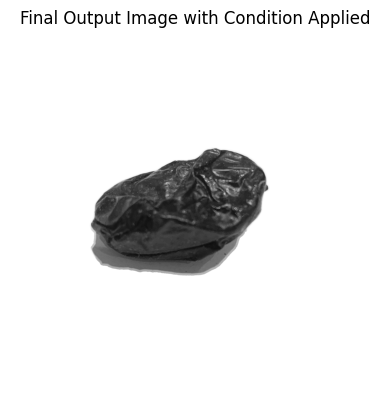

Processing: static/results/JD2002_5.png
Contour 1: 849260 pixels
  Below threshold: 693885 (81.70%)
  Contour 1 meets the condition.


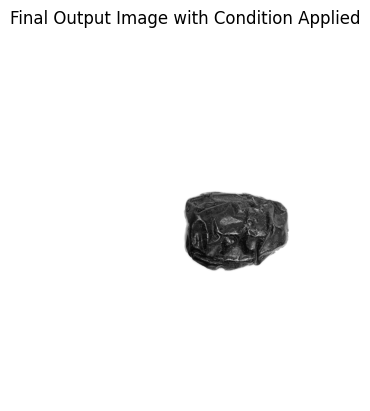

Processing: static/results/JD2004_2.png
Contour 1: 1093830 pixels
  Below threshold: 1011005 (92.43%)
  Contour 1 meets the condition.


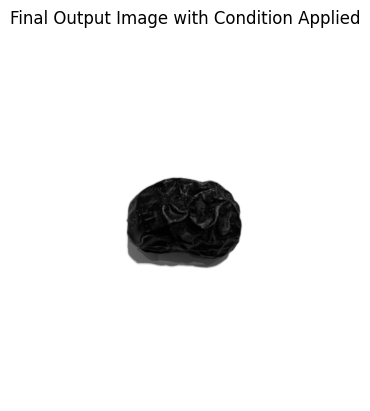

Processing: static/results/JD2021_2.png
Contour 1: 912810 pixels
  Below threshold: 776221 (85.04%)
  Contour 1 meets the condition.


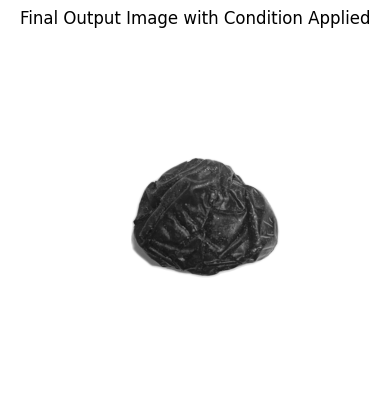

Processing: static/results/JD2032_5.png
Contour 1: 1095349 pixels
  Below threshold: 909484 (83.03%)
  Contour 1 meets the condition.


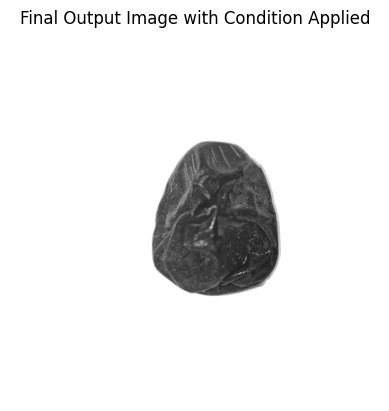

Processing: static/results/JD2019_6.png
Contour 1: 853949 pixels
  Below threshold: 718790 (84.17%)
  Contour 1 meets the condition.


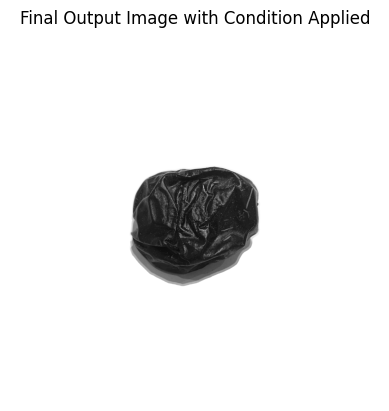

Processing: static/results/JD2002_3.png
Contour 1: 778897 pixels
  Below threshold: 656501 (84.29%)
  Contour 1 meets the condition.


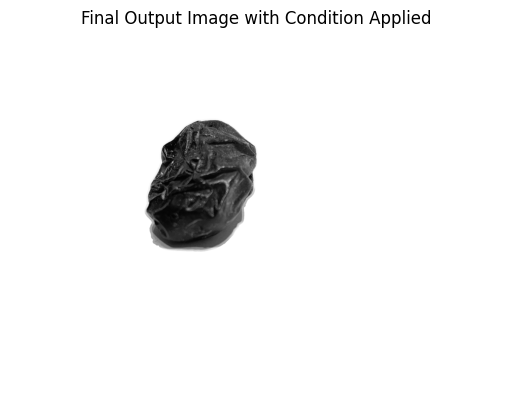

Processing: static/results/JD2038_6.png
Contour 1: 915457 pixels
  Below threshold: 743157 (81.18%)
  Contour 1 meets the condition.
Contour 2: 1792 pixels
  Below threshold: 19 (1.06%)
  Contour 2 does not meet the condition.


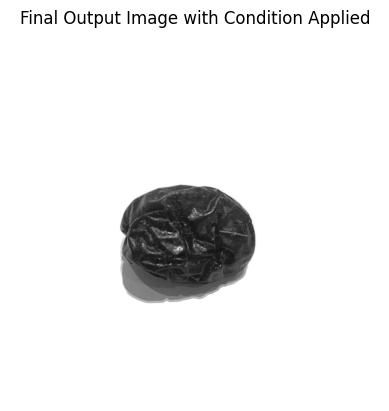

Processing: static/results/JD2036_2.png
Contour 1: 1159989 pixels
  Below threshold: 999652 (86.18%)
  Contour 1 meets the condition.


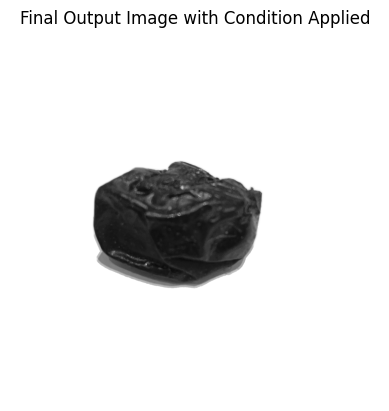

Processing: static/results/JD2010_2.png
Contour 1: 926642 pixels
  Below threshold: 799040 (86.23%)
  Contour 1 meets the condition.


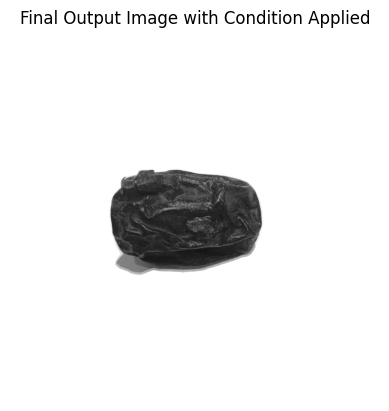

Processing: static/results/JD2007_7.png
Contour 1: 523217 pixels
  Below threshold: 440452 (84.18%)
  Contour 1 meets the condition.


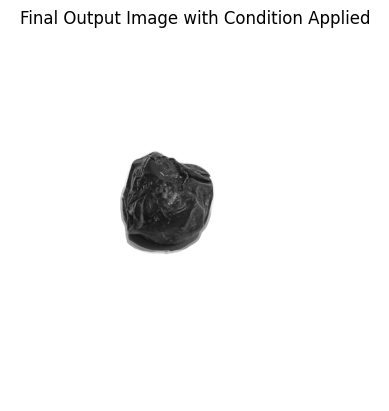

Processing: static/results/JD2038_3.png
Contour 1: 779298 pixels
  Below threshold: 666688 (85.55%)
  Contour 1 meets the condition.


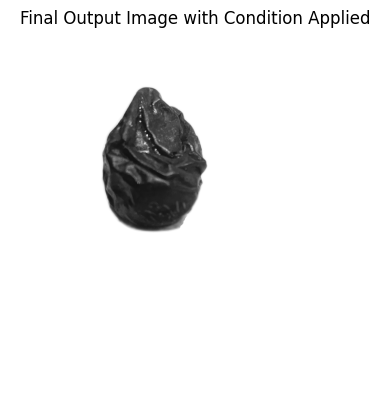

Processing: static/results/JD2022_2.png
Contour 1: 815660 pixels
  Below threshold: 700796 (85.92%)
  Contour 1 meets the condition.


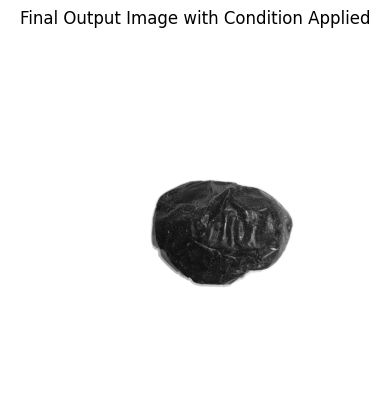

Processing: static/results/JD2012_7.png
Contour 1: 770870 pixels
  Below threshold: 669724 (86.88%)
  Contour 1 meets the condition.


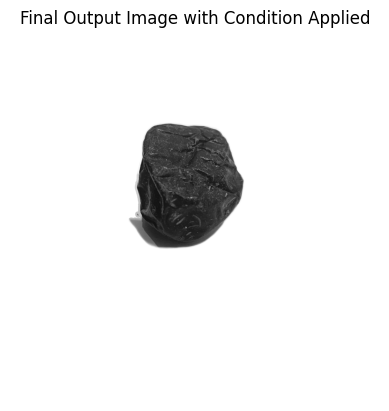

Processing: static/results/JD2005_4.png
Contour 1: 868216 pixels
  Below threshold: 704582 (81.15%)
  Contour 1 meets the condition.


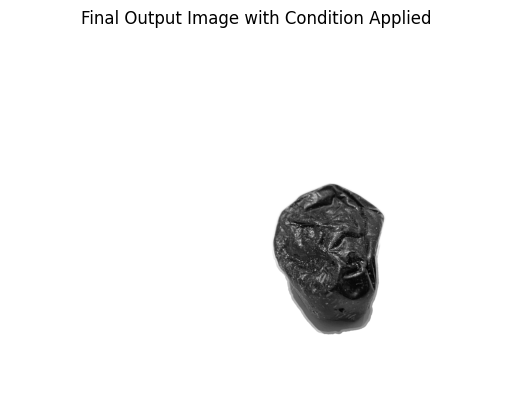

Processing: static/results/JD2020_7.png
Contour 1: 576309 pixels
  Below threshold: 482647 (83.75%)
  Contour 1 meets the condition.


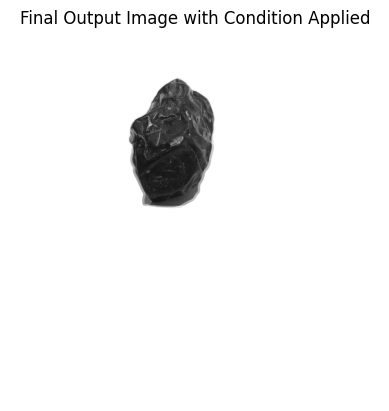

Processing: static/results/JD2001_7.png
Contour 1: 1193651 pixels
  Below threshold: 1000558 (83.82%)
  Contour 1 meets the condition.


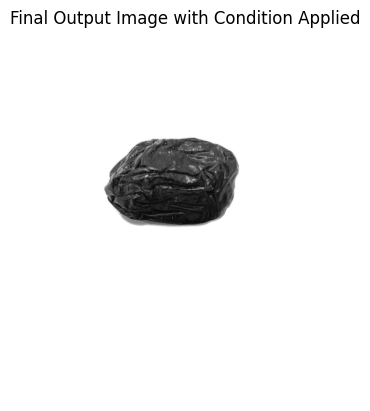

Processing: static/results/JD2009_5.png
Contour 1: 1037917 pixels
  Below threshold: 792338 (76.34%)
  Contour 1 meets the condition.
Contour 2: 52218 pixels
  Below threshold: 0 (0.00%)
  Contour 2 does not meet the condition.
Contour 3: 1356 pixels
  Below threshold: 10 (0.74%)
  Contour 3 does not meet the condition.


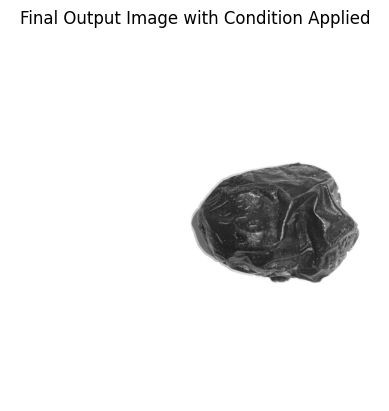

Processing: static/results/JD2031_6.png
Contour 1: 1113659 pixels
  Below threshold: 939078 (84.32%)
  Contour 1 meets the condition.


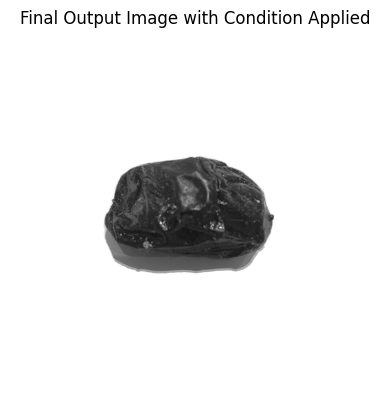

Processing: static/results/JD2002_2.png
Contour 1: 1053326 pixels
  Below threshold: 880421 (83.58%)
  Contour 1 meets the condition.


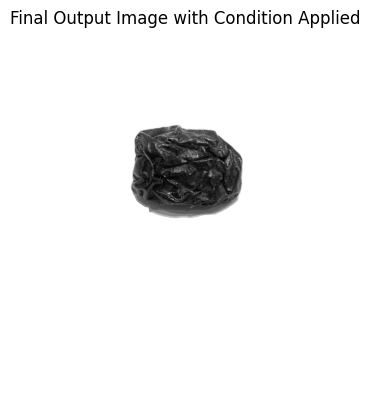

Processing: static/results/JD2013_1.png
Contour 1: 741466 pixels
  Below threshold: 636477 (85.84%)
  Contour 1 meets the condition.


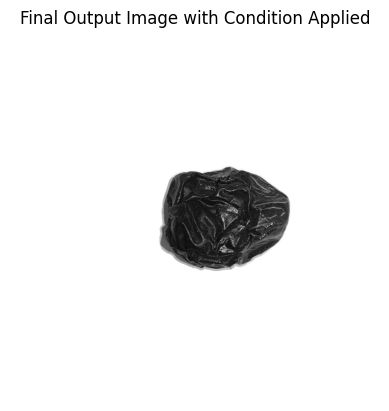

Processing: static/results/JD2013_2.png
Contour 1: 790929 pixels
  Below threshold: 672835 (85.07%)
  Contour 1 meets the condition.


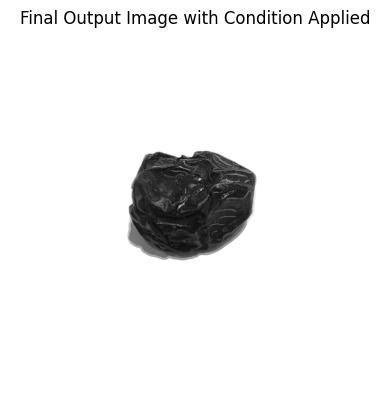

Processing: static/results/JD2006_8.png
Contour 1: 955945 pixels
  Below threshold: 788671 (82.50%)
  Contour 1 meets the condition.


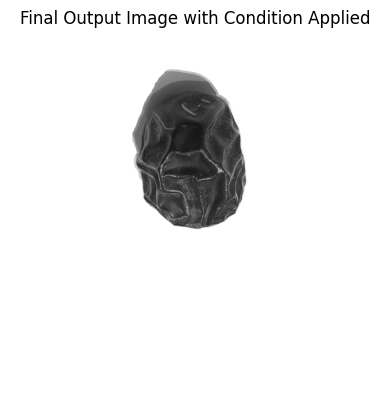

Processing: static/results/JD2029_7.png
Contour 1: 695936 pixels
  Below threshold: 594308 (85.40%)
  Contour 1 meets the condition.


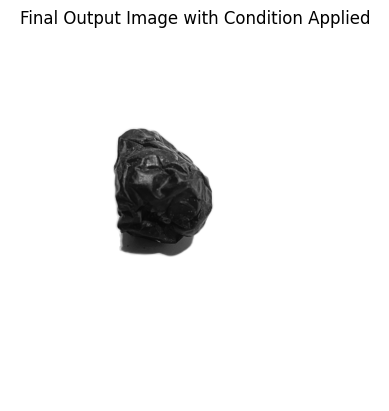

Processing: static/results/JD2007_4.png
Contour 1: 802859 pixels
  Below threshold: 648652 (80.79%)
  Contour 1 meets the condition.


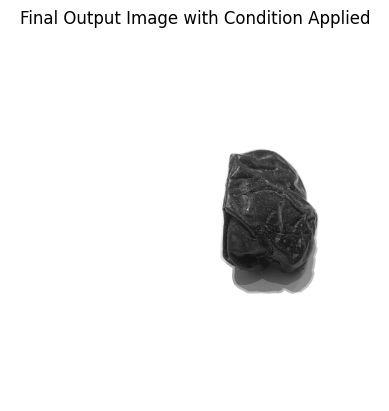

Processing: static/results/JD2033_2.png
Contour 1: 898271 pixels
  Below threshold: 693583 (77.21%)
  Contour 1 meets the condition.


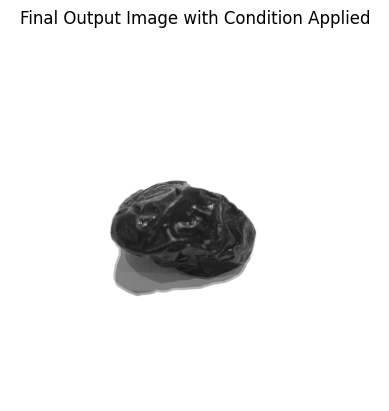

Processing: static/results/JD2036_6.png
Contour 1: 969091 pixels
  Below threshold: 729311 (75.26%)
  Contour 1 meets the condition.


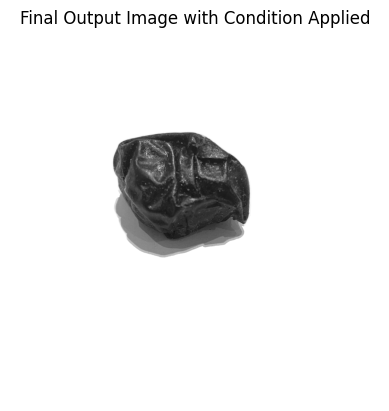

Processing: static/results/JD2014_6.png
Contour 1: 824085 pixels
  Below threshold: 707685 (85.88%)
  Contour 1 meets the condition.


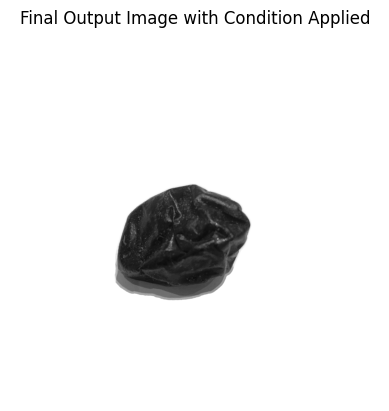

Processing: static/results/JD2002_4.png
Contour 1: 581624 pixels
  Below threshold: 488490 (83.99%)
  Contour 1 meets the condition.


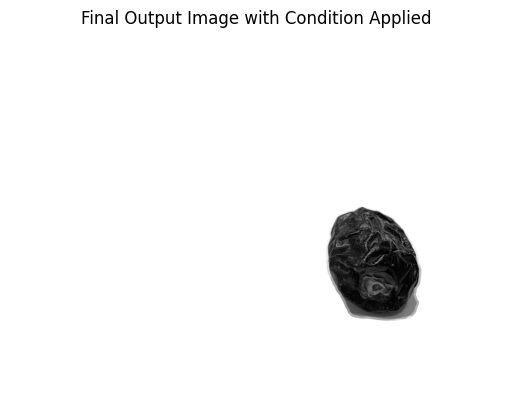

Processing: static/results/JD2031_3.png
Contour 1: 821950 pixels
  Below threshold: 703119 (85.54%)
  Contour 1 meets the condition.


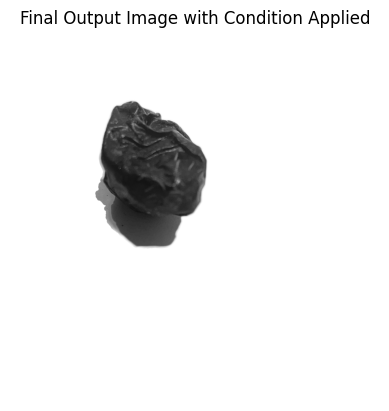

Processing: static/results/JD2012_5.png
Contour 1: 812900 pixels
  Below threshold: 672725 (82.76%)
  Contour 1 meets the condition.


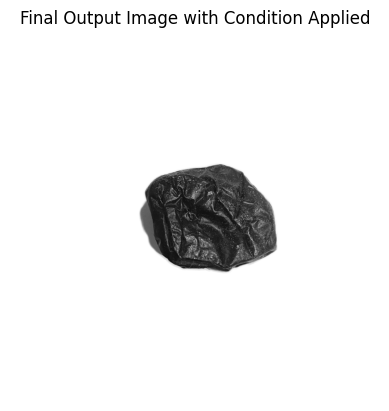

Processing: static/results/JD2006_7.png
Contour 1: 773683 pixels
  Below threshold: 661831 (85.54%)
  Contour 1 meets the condition.


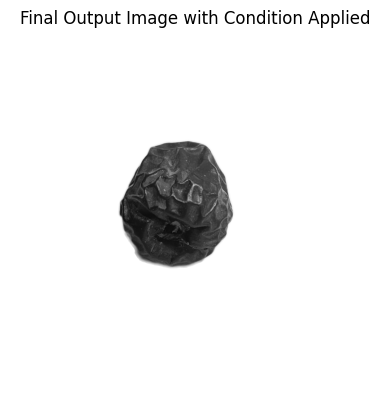

Processing: static/results/JD2006_2.png
Contour 1: 1212949 pixels
  Below threshold: 927840 (76.49%)
  Contour 1 meets the condition.
Contour 2: 1298 pixels
  Below threshold: 0 (0.00%)
  Contour 2 does not meet the condition.


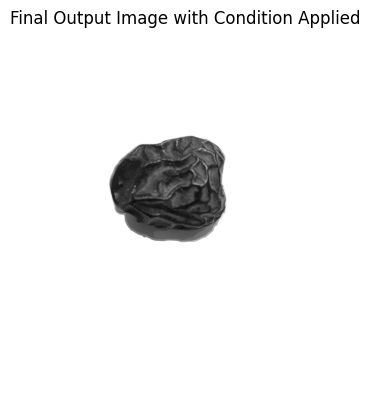

Processing: static/results/JD2017_6.png
Contour 1: 691596 pixels
  Below threshold: 587260 (84.91%)
  Contour 1 meets the condition.


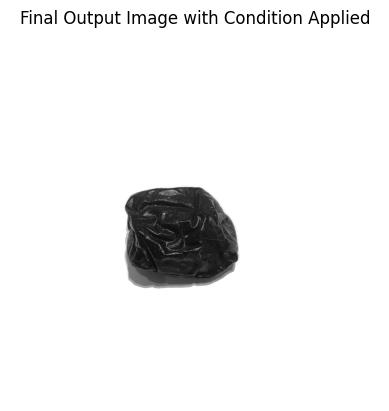

Processing: static/results/JD2004_1.png
Contour 1: 806394 pixels
  Below threshold: 735045 (91.15%)
  Contour 1 meets the condition.


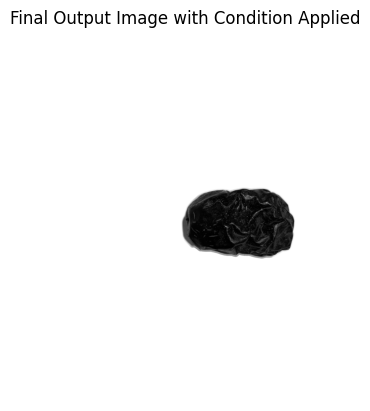

Processing: static/results/JD2001_5.png
Contour 1: 1019070 pixels
  Below threshold: 856239 (84.02%)
  Contour 1 meets the condition.


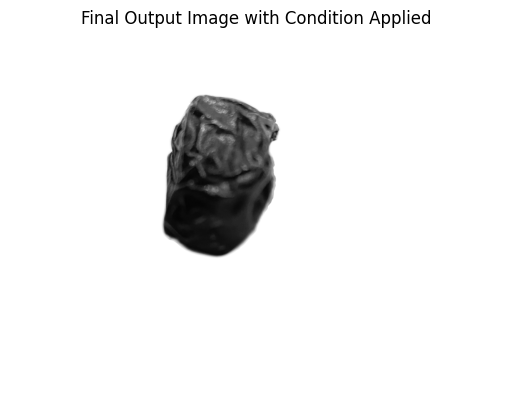

Processing: static/results/JD2011_1.png
Contour 1: 878829 pixels
  Below threshold: 763286 (86.85%)
  Contour 1 meets the condition.


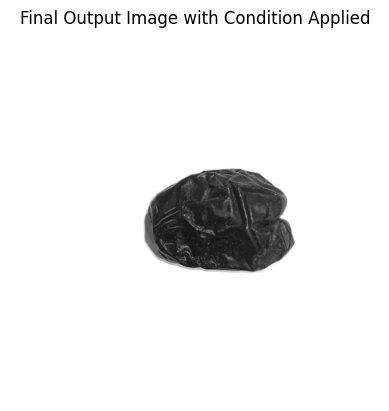

Processing: static/results/JD2041_3.png
Contour 1: 820612 pixels
  Below threshold: 693553 (84.52%)
  Contour 1 meets the condition.


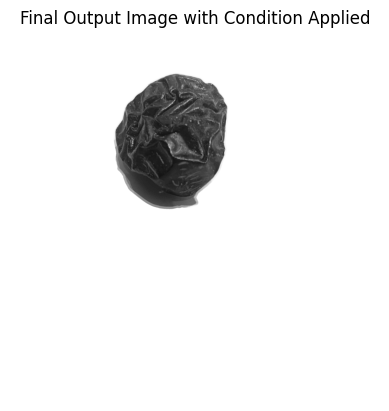

Processing: static/results/JD2016_2.png
Contour 1: 982526 pixels
  Below threshold: 813719 (82.82%)
  Contour 1 meets the condition.


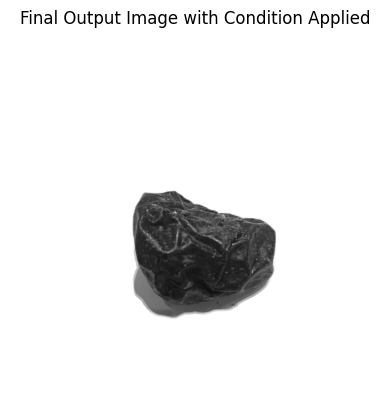

Processing: static/results/JD2029_4.png
Contour 1: 841070 pixels
  Below threshold: 692935 (82.39%)
  Contour 1 meets the condition.


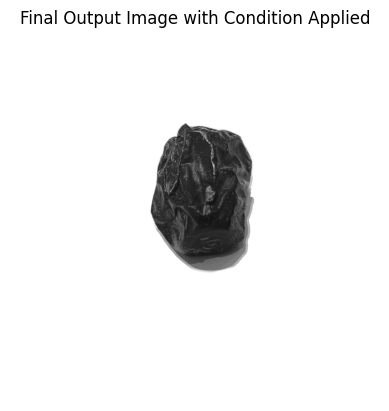

Processing: static/results/JD2038_5.png
Contour 1: 711550 pixels
  Below threshold: 602798 (84.72%)
  Contour 1 meets the condition.


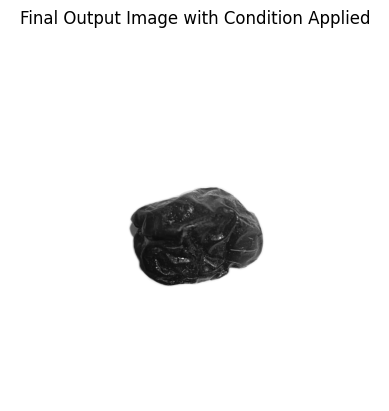

Processing: static/results/JD2020_2.png
Contour 1: 943911 pixels
  Below threshold: 809117 (85.72%)
  Contour 1 meets the condition.


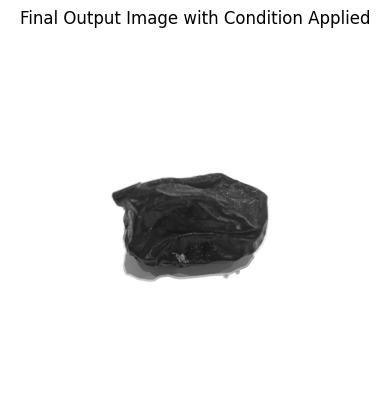

Processing: static/results/JD2006_1.png
Contour 1: 1079083 pixels
  Below threshold: 871585 (80.77%)
  Contour 1 meets the condition.


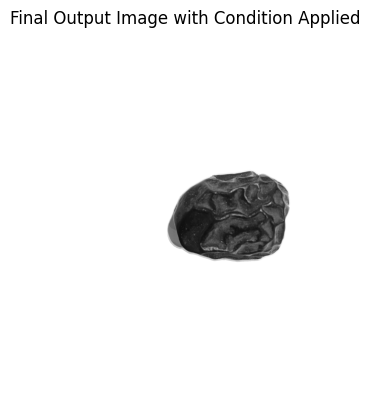

Processing: static/results/JD2005_2.png
Contour 1: 1065476 pixels
  Below threshold: 819648 (76.93%)
  Contour 1 meets the condition.


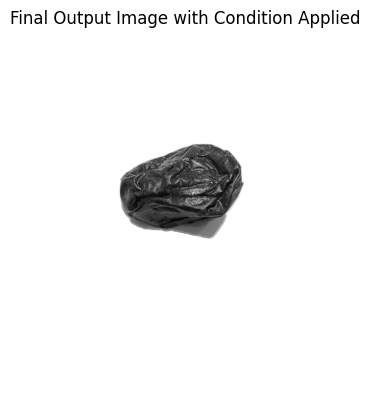

Processing: static/results/JD2022_5.png
Contour 1: 649404 pixels
  Below threshold: 525532 (80.93%)
  Contour 1 meets the condition.


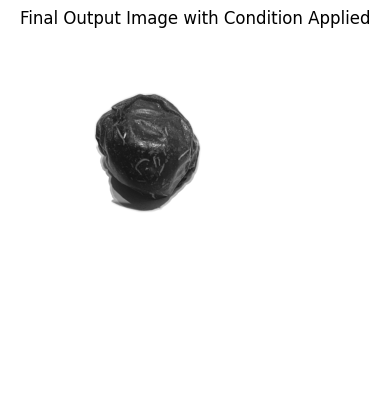

Processing: static/results/JD2036_7.png
Contour 1: 811188 pixels
  Below threshold: 658964 (81.23%)
  Contour 1 meets the condition.


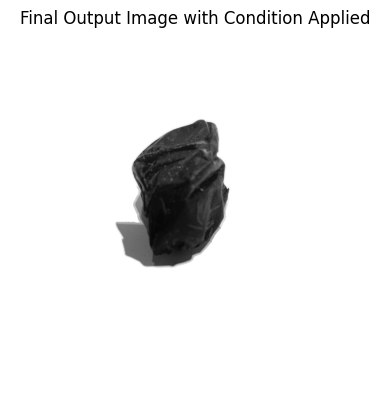

Processing: static/results/JD2036_8.png
Contour 1: 950512 pixels
  Below threshold: 772511 (81.27%)
  Contour 1 meets the condition.


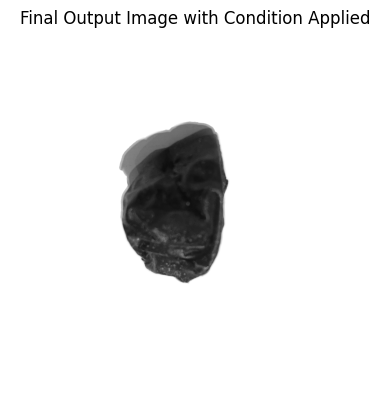

Processing: static/results/JD2033_7.png
Contour 1: 896645 pixels
  Below threshold: 755253 (84.23%)
  Contour 1 meets the condition.
Contour 2: 1399 pixels
  Below threshold: 11 (0.79%)
  Contour 2 does not meet the condition.
Contour 3: 1386 pixels
  Below threshold: 0 (0.00%)
  Contour 3 does not meet the condition.


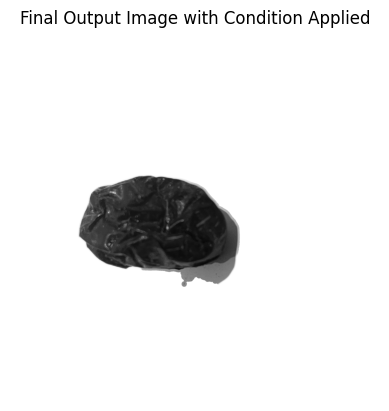

Processing: static/results/JD2016_3.png
Contour 1: 784920 pixels
  Below threshold: 656841 (83.68%)
  Contour 1 meets the condition.


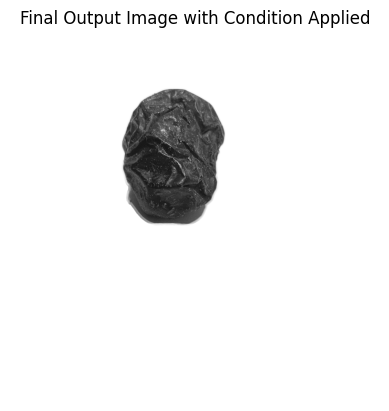

Processing: static/results/JD2025_4.png
Contour 1: 674111 pixels
  Below threshold: 556880 (82.61%)
  Contour 1 meets the condition.
Contour 2: 1447 pixels
  Below threshold: 12 (0.83%)
  Contour 2 does not meet the condition.


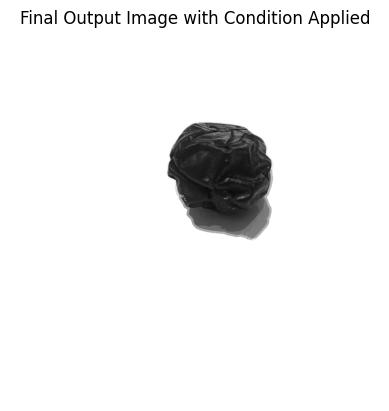

Processing: static/results/JD2008_2.png
Contour 1: 777816 pixels
  Below threshold: 666697 (85.71%)
  Contour 1 meets the condition.


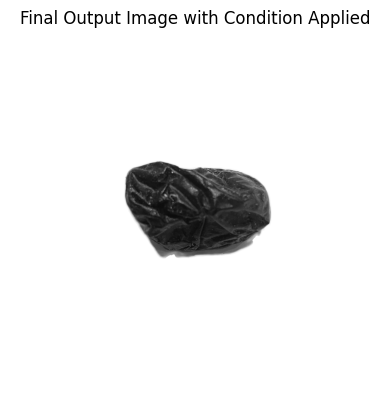

Processing: static/results/JD2012_2.png
Contour 1: 974169 pixels
  Below threshold: 821937 (84.37%)
  Contour 1 meets the condition.


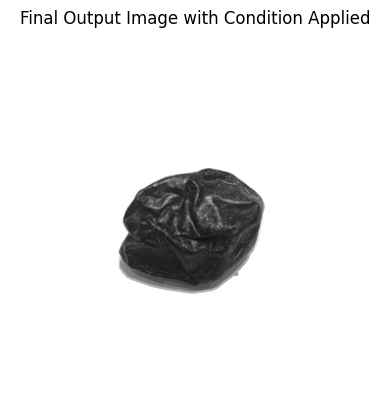

Processing: static/results/JD2008_3.png
Contour 1: 628720 pixels
  Below threshold: 536658 (85.36%)
  Contour 1 meets the condition.


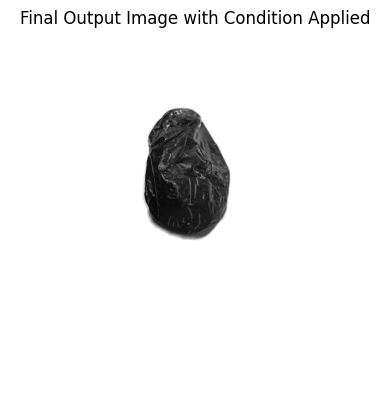

Processing: static/results/JD2034_4.png
Contour 1: 915201 pixels
  Below threshold: 746581 (81.58%)
  Contour 1 meets the condition.


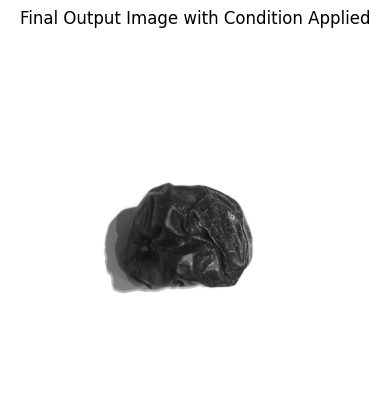

Processing: static/results/JD2031_4.png
Contour 1: 956662 pixels
  Below threshold: 810776 (84.75%)
  Contour 1 meets the condition.


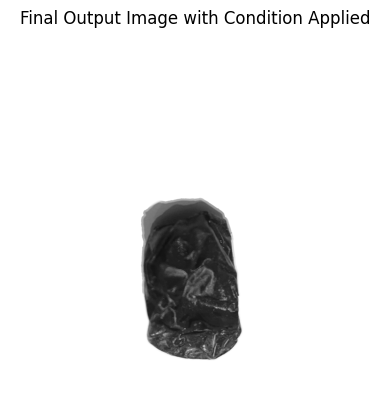

Processing: static/results/JD2022_8.png
Contour 1: 941104 pixels
  Below threshold: 745366 (79.20%)
  Contour 1 meets the condition.


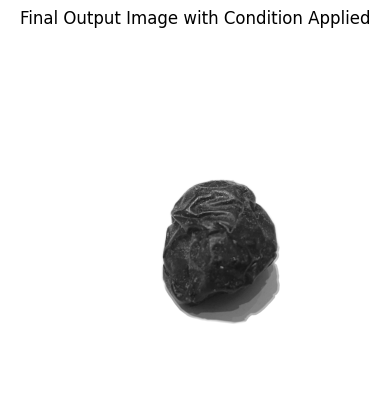

Processing: static/results/JD2001_8.png
Contour 1: 1304088 pixels
  Below threshold: 1054391 (80.85%)
  Contour 1 meets the condition.


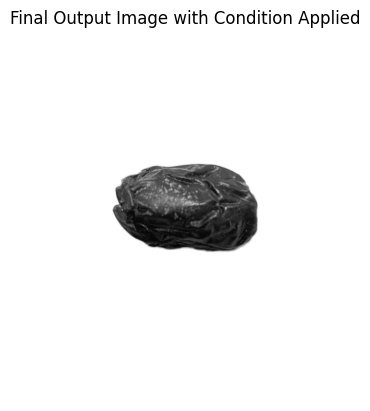

Processing: static/results/JD2033_4.png
Contour 1: 755082 pixels
  Below threshold: 623771 (82.61%)
  Contour 1 meets the condition.


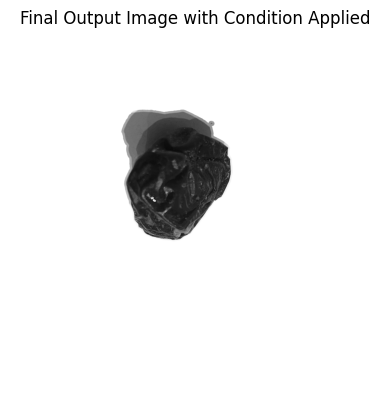

Processing: static/results/JD2040_4.png
Contour 1: 1355019 pixels
  Below threshold: 1125770 (83.08%)
  Contour 1 meets the condition.


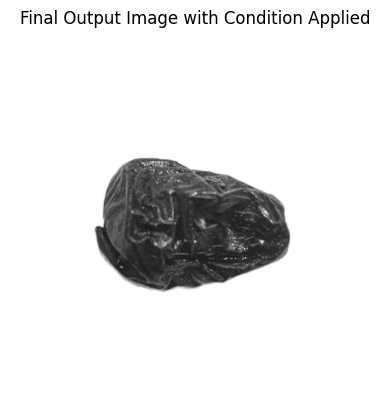

Processing: static/results/JD2010_4.png
Contour 1: 626552 pixels
  Below threshold: 504689 (80.55%)
  Contour 1 meets the condition.


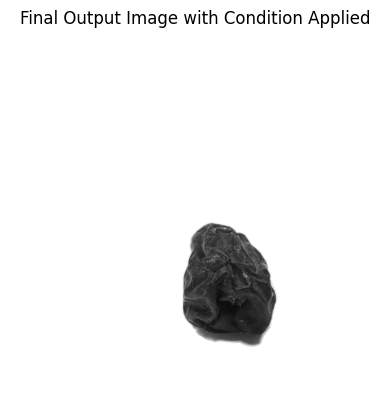

Processing: static/results/JD2035_2.png
Contour 1: 1123079 pixels
  Below threshold: 953536 (84.90%)
  Contour 1 meets the condition.


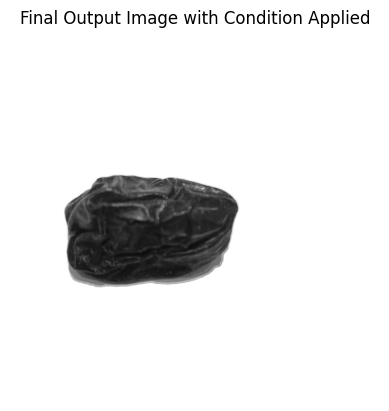

Processing: static/results/JD2030_6.png
Contour 1: 864476 pixels
  Below threshold: 739055 (85.49%)
  Contour 1 meets the condition.


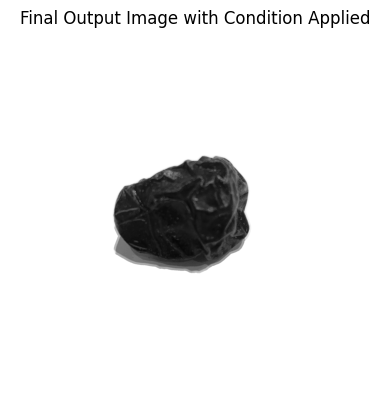

Processing: static/results/JD2015_7.png
Contour 1: 586217 pixels
  Below threshold: 494936 (84.43%)
  Contour 1 meets the condition.


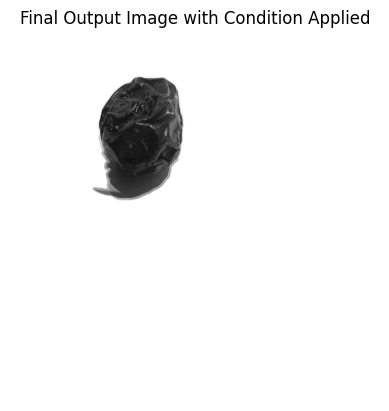

Processing: static/results/JD2014_5.png
Contour 1: 717940 pixels
  Below threshold: 629758 (87.72%)
  Contour 1 meets the condition.


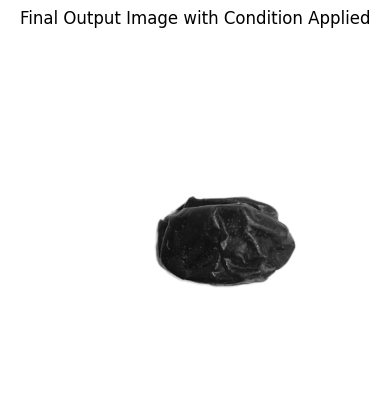

Processing: static/results/JD2028_8.png
Contour 1: 755143 pixels
  Below threshold: 613386 (81.23%)
  Contour 1 meets the condition.


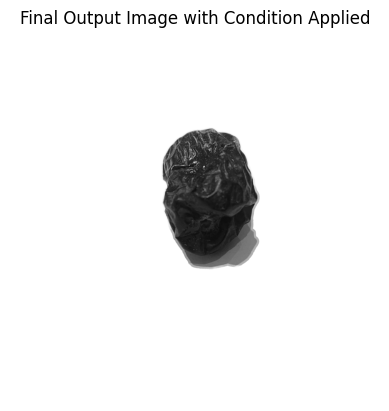

Processing: static/results/JD2038_4.png
Contour 1: 862624 pixels
  Below threshold: 734980 (85.20%)
  Contour 1 meets the condition.


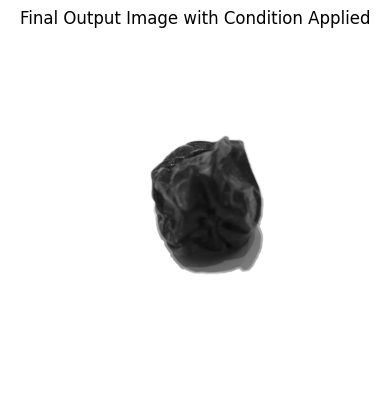

Processing: static/results/JD2020_1.png
Contour 1: 622328 pixels
  Below threshold: 545472 (87.65%)
  Contour 1 meets the condition.


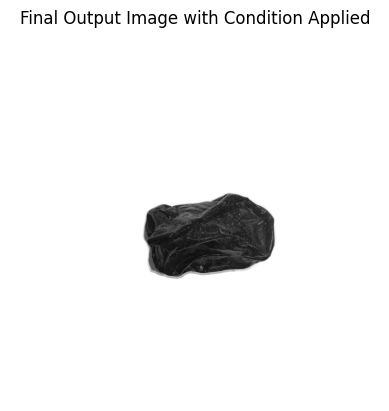

Processing: static/results/JD2028_6.png
Contour 1: 949082 pixels
  Below threshold: 784575 (82.67%)
  Contour 1 meets the condition.


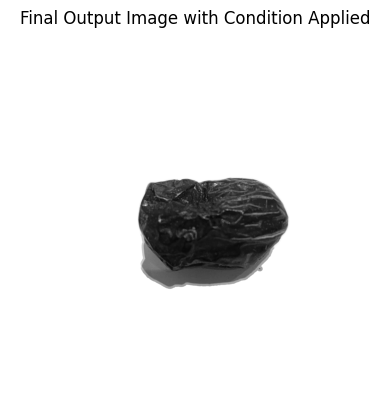

Processing: static/results/JD2035_7.png
Contour 1: 896692 pixels
  Below threshold: 764181 (85.22%)
  Contour 1 meets the condition.


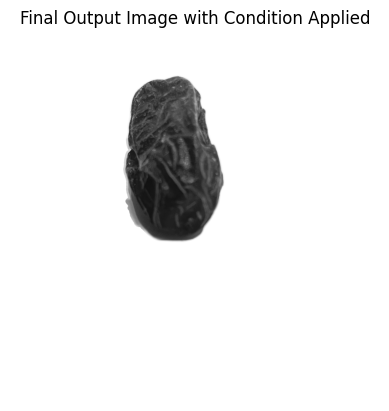

Processing: static/results/JD2037_6.png
Contour 1: 1205078 pixels
  Below threshold: 1012843 (84.05%)
  Contour 1 meets the condition.


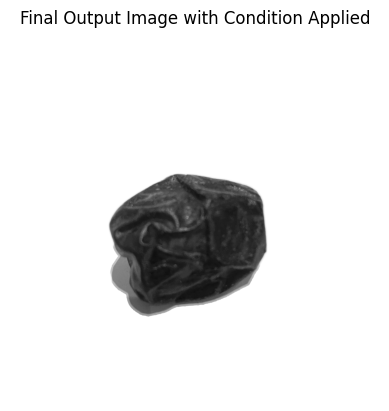

Processing: static/results/JD2021_5.png
Contour 1: 673040 pixels
  Below threshold: 553645 (82.26%)
  Contour 1 meets the condition.
Contour 2: 334184 pixels
  Below threshold: 0 (0.00%)
  Contour 2 does not meet the condition.
Contour 3: 3027 pixels
  Below threshold: 0 (0.00%)
  Contour 3 does not meet the condition.
Contour 4: 527682 pixels
  Below threshold: 56264 (10.66%)
  Contour 4 does not meet the condition.


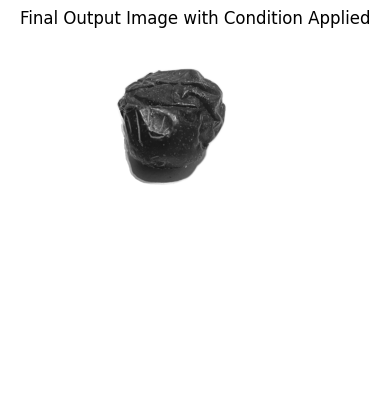

Processing: static/results/JD2018_2.png
Contour 1: 1144953 pixels
  Below threshold: 910828 (79.55%)
  Contour 1 meets the condition.


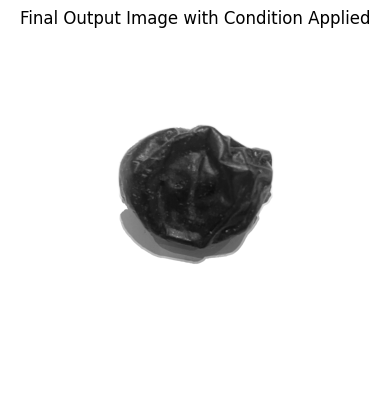

Processing: static/results/JD2029_6.png
Contour 1: 908967 pixels
  Below threshold: 757845 (83.37%)
  Contour 1 meets the condition.
Contour 2: 1369 pixels
  Below threshold: 14 (1.02%)
  Contour 2 does not meet the condition.


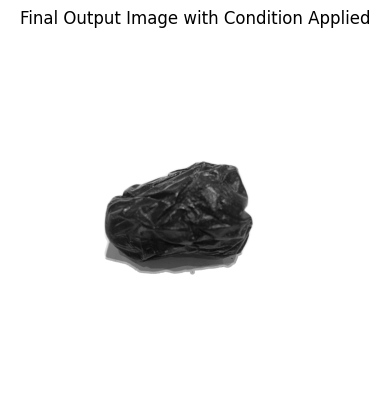

Processing: static/results/JD2039_6.png
Contour 1: 1010583 pixels
  Below threshold: 838094 (82.93%)
  Contour 1 meets the condition.


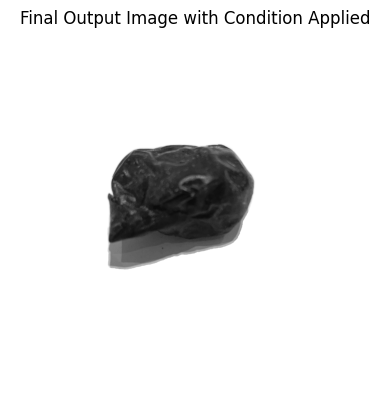

Processing: static/results/JD2029_8.png
Contour 1: 859242 pixels
  Below threshold: 709289 (82.55%)
  Contour 1 meets the condition.


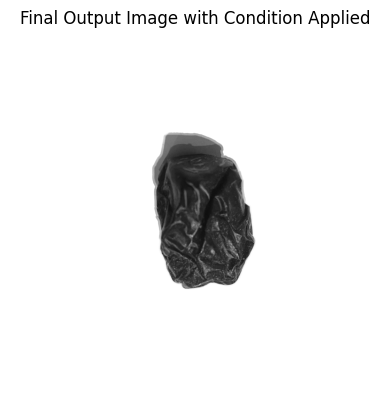

Processing: static/results/JD2040_2.png
Contour 1: 806709 pixels
  Below threshold: 674671 (83.63%)
  Contour 1 meets the condition.


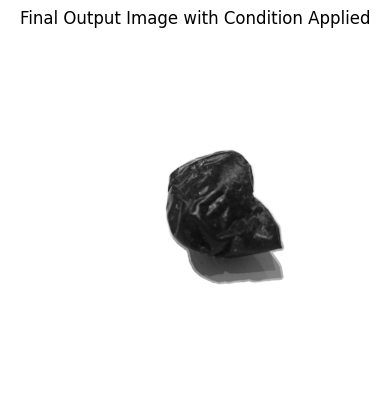

Processing: static/results/JD2014_3.png
Contour 1: 545916 pixels
  Below threshold: 440730 (80.73%)
  Contour 1 meets the condition.


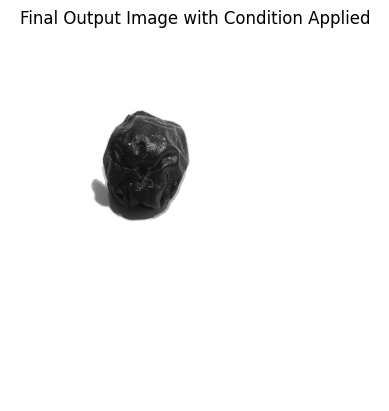

Processing: static/results/JD2041_7.png
Contour 1: 761733 pixels
  Below threshold: 652695 (85.69%)
  Contour 1 meets the condition.


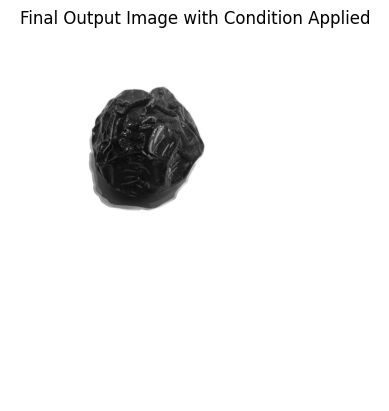

Processing: static/results/JD2021_6.png
Contour 1: 673040 pixels
  Below threshold: 553645 (82.26%)
  Contour 1 meets the condition.
Contour 2: 334184 pixels
  Below threshold: 0 (0.00%)
  Contour 2 does not meet the condition.
Contour 3: 3027 pixels
  Below threshold: 0 (0.00%)
  Contour 3 does not meet the condition.
Contour 4: 527682 pixels
  Below threshold: 56264 (10.66%)
  Contour 4 does not meet the condition.


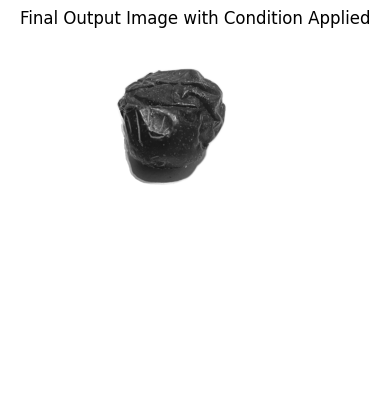

Processing: static/results/JD2030_2.png
Contour 1: 858517 pixels
  Below threshold: 706384 (82.28%)
  Contour 1 meets the condition.


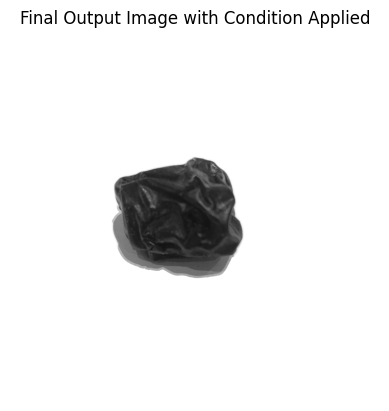

Processing: static/results/JD2015_4.png
Contour 1: 673420 pixels
  Below threshold: 556104 (82.58%)
  Contour 1 meets the condition.


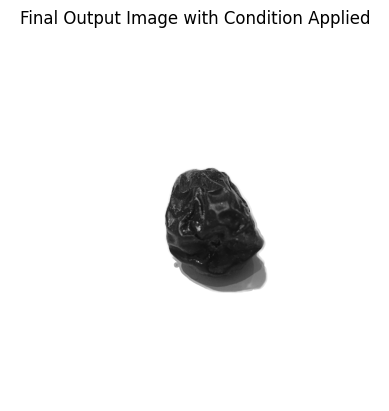

Processing: static/results/JD2007_5.png
Contour 1: 841848 pixels
  Below threshold: 715534 (85.00%)
  Contour 1 meets the condition.


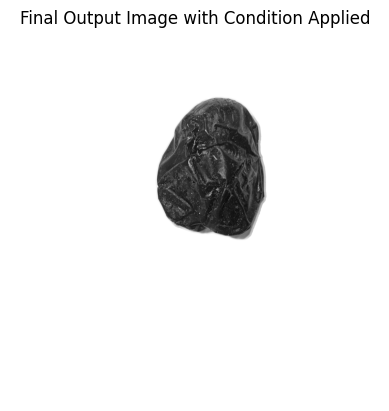

Processing: static/results/JD2001_4.png
Contour 1: 1172361 pixels
  Below threshold: 1062434 (90.62%)
  Contour 1 meets the condition.


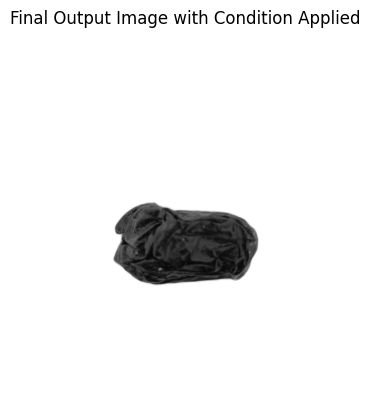

Processing: static/results/JD2001_1.png
Contour 1: 1217277 pixels
  Below threshold: 893142 (73.37%)
  Contour 1 meets the condition.


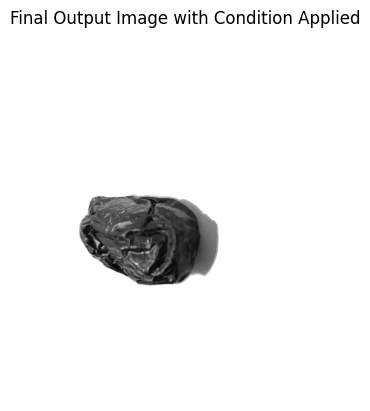

Processing: static/results/JD2024_8.png
Contour 1: 772210 pixels
  Below threshold: 635011 (82.23%)
  Contour 1 meets the condition.


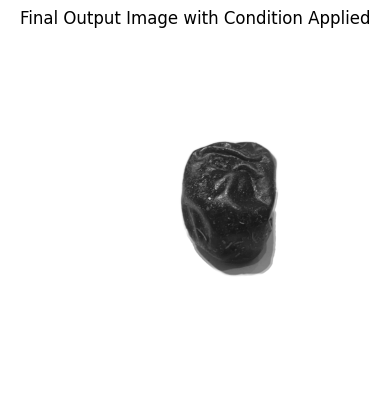

Processing: static/results/JD2003_2.png
Contour 1: 886206 pixels
  Below threshold: 713190 (80.48%)
  Contour 1 meets the condition.


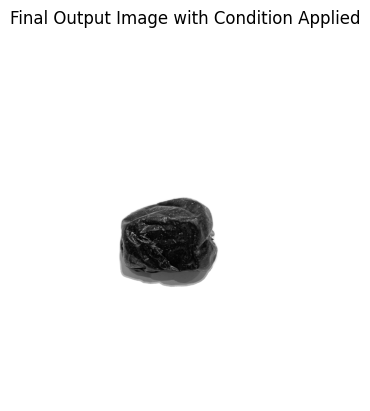

Processing: static/results/JD2018_3.png
Contour 1: 941670 pixels
  Below threshold: 817430 (86.81%)
  Contour 1 meets the condition.


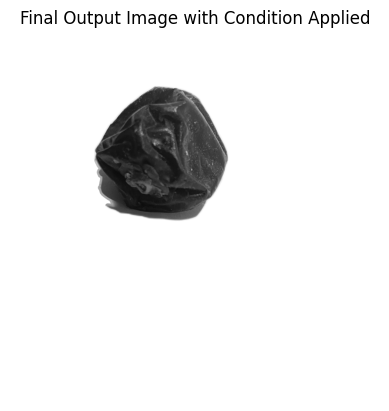

Processing: static/results/JD2035_4.png
Contour 1: 967396 pixels
  Below threshold: 848098 (87.67%)
  Contour 1 meets the condition.


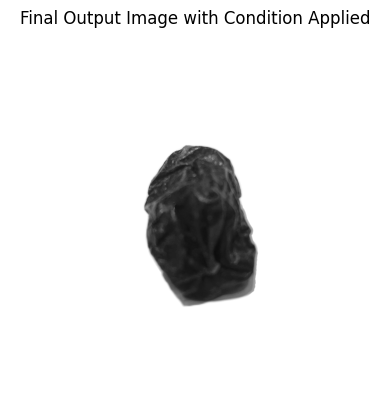

Processing: static/results/JD2015_6.png
Contour 1: 884826 pixels
  Below threshold: 722876 (81.70%)
  Contour 1 meets the condition.


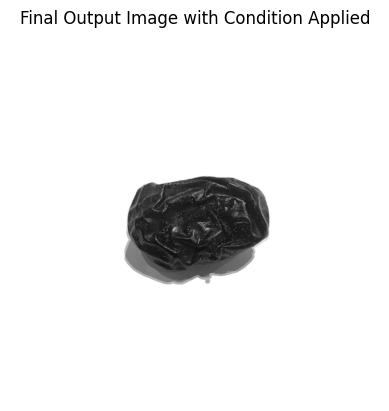

Processing: static/results/JD2017_3.png
Contour 1: 581758 pixels
  Below threshold: 493975 (84.91%)
  Contour 1 meets the condition.


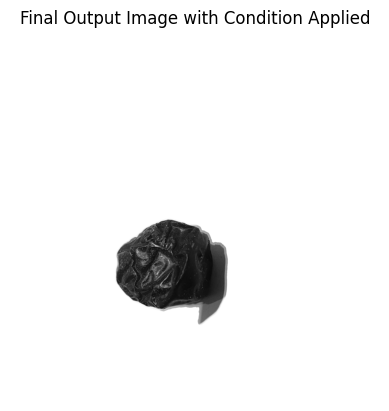

Processing: static/results/JD2010_6.png
Contour 1: 782193 pixels
  Below threshold: 648010 (82.85%)
  Contour 1 meets the condition.
Contour 2: 9000 pixels
  Below threshold: 0 (0.00%)
  Contour 2 does not meet the condition.


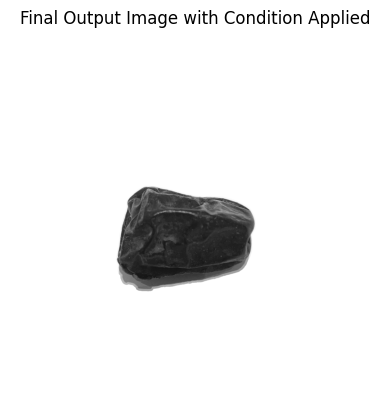

Processing: static/results/JD2016_8.png
Contour 1: 822969 pixels
  Below threshold: 685833 (83.34%)
  Contour 1 meets the condition.


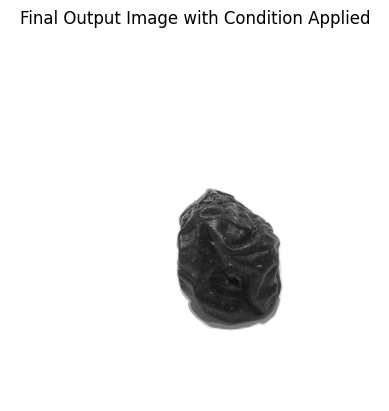

Processing: static/results/JD2006_4.png
Contour 1: 1054195 pixels
  Below threshold: 804381 (76.30%)
  Contour 1 meets the condition.


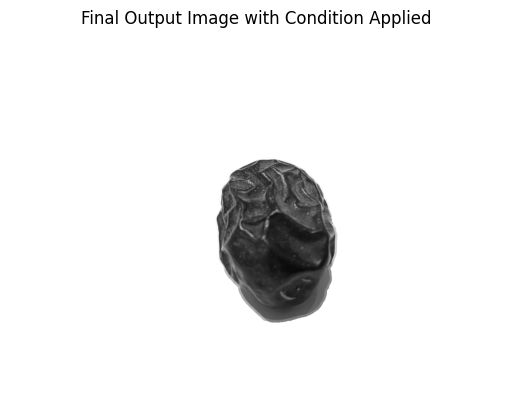

Processing: static/results/JD2005_3.png
Contour 1: 771711 pixels
  Below threshold: 658086 (85.28%)
  Contour 1 meets the condition.
Contour 2: 8422 pixels
  Below threshold: 867 (10.29%)
  Contour 2 does not meet the condition.


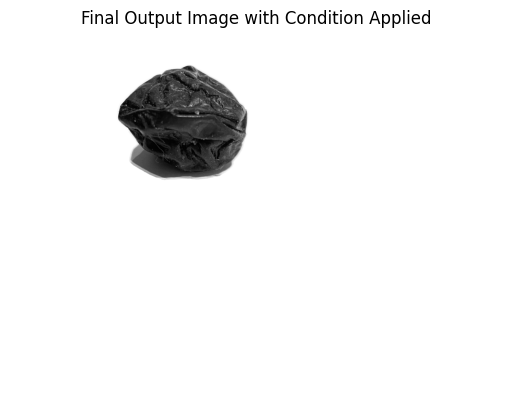

Processing: static/results/JD2004_4.png
Contour 1: 1016155 pixels
  Below threshold: 889009 (87.49%)
  Contour 1 meets the condition.


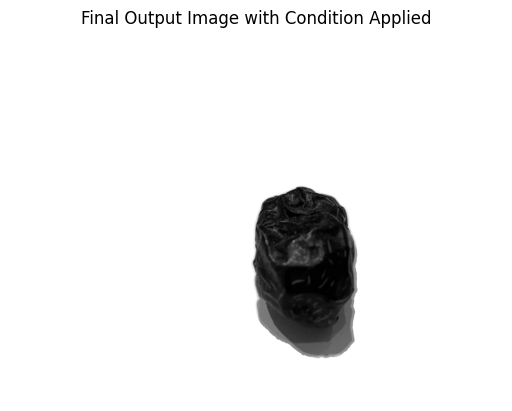

Processing: static/results/JD2026_2.png
Contour 1: 930103 pixels
  Below threshold: 764570 (82.20%)
  Contour 1 meets the condition.


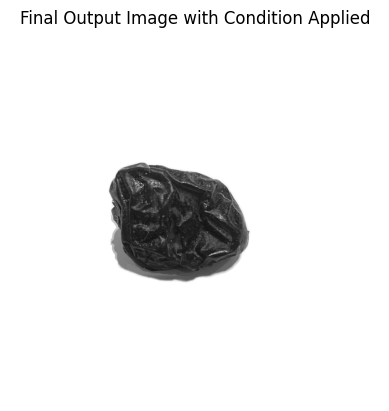

Processing: static/results/JD2025_3.png
Contour 1: 714874 pixels
  Below threshold: 617085 (86.32%)
  Contour 1 meets the condition.


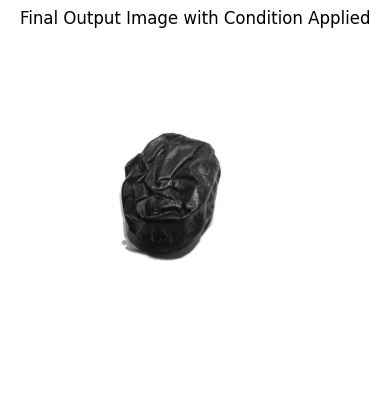

Processing: static/results/JD2003_3.png
Contour 1: 738274 pixels
  Below threshold: 581211 (78.73%)
  Contour 1 meets the condition.


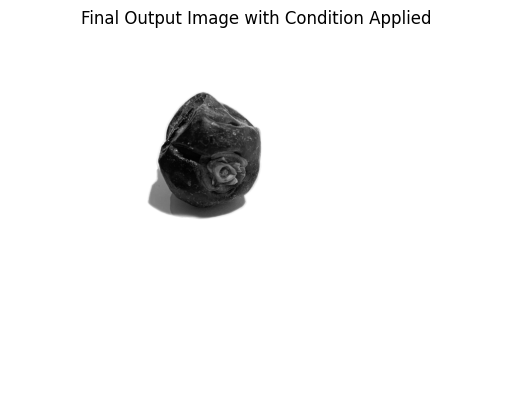

Processing: static/results/JD2010_8.png
Contour 1: 746067 pixels
  Below threshold: 623262 (83.54%)
  Contour 1 meets the condition.


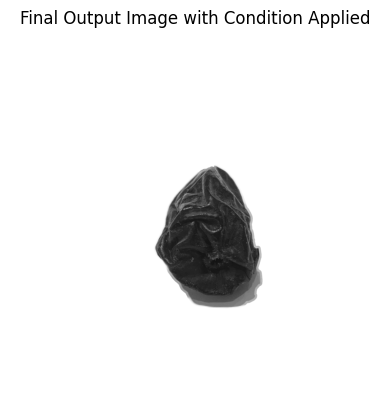

Processing: static/results/JD2015_2.png
Contour 1: 861134 pixels
  Below threshold: 736369 (85.51%)
  Contour 1 meets the condition.


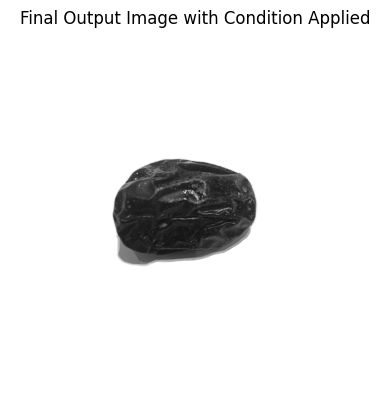

Processing: static/results/JD2025_7.png
Contour 1: 597824 pixels
  Below threshold: 498811 (83.44%)
  Contour 1 meets the condition.


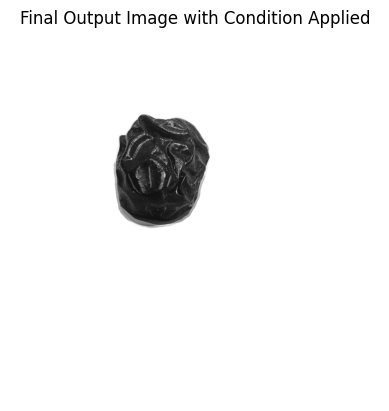

Processing: static/results/JD2038_7.png
Contour 1: 647528 pixels
  Below threshold: 558149 (86.20%)
  Contour 1 meets the condition.


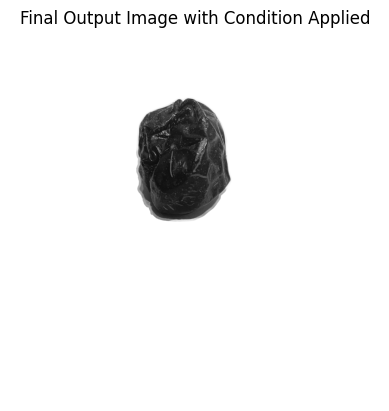

Processing: static/results/JD2037_7.png
Contour 1: 754281 pixels
  Below threshold: 645084 (85.52%)
  Contour 1 meets the condition.


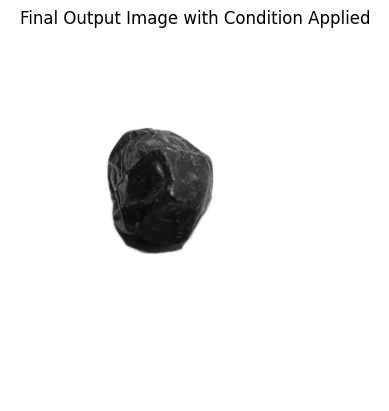

Processing: static/results/JD2001_6.png
Contour 1: 879593 pixels
  Below threshold: 710487 (80.77%)
  Contour 1 meets the condition.


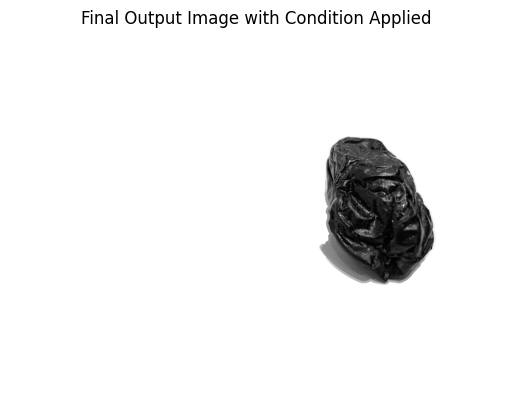

Processing: static/results/JD2019_3.png
Contour 1: 804969 pixels
  Below threshold: 682831 (84.83%)
  Contour 1 meets the condition.


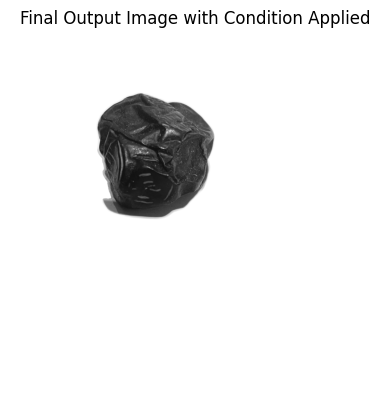

Processing: static/results/JD2027_7.png
Contour 1: 730703 pixels
  Below threshold: 609724 (83.44%)
  Contour 1 meets the condition.


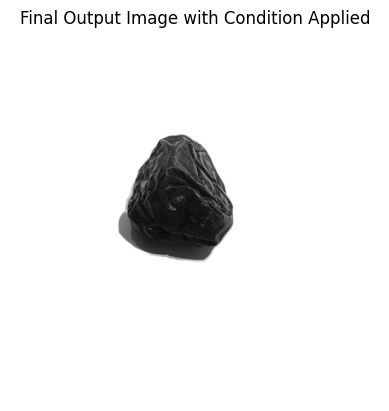

Processing: static/results/JD2012_4.png
Contour 1: 740756 pixels
  Below threshold: 585354 (79.02%)
  Contour 1 meets the condition.


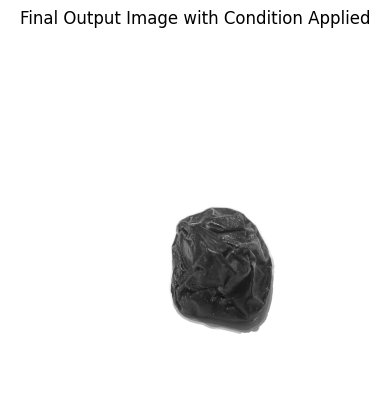

Processing: static/results/JD2003_8.png
Contour 1: 1029547 pixels
  Below threshold: 837459 (81.34%)
  Contour 1 meets the condition.
Contour 2: 2113 pixels
  Below threshold: 0 (0.00%)
  Contour 2 does not meet the condition.


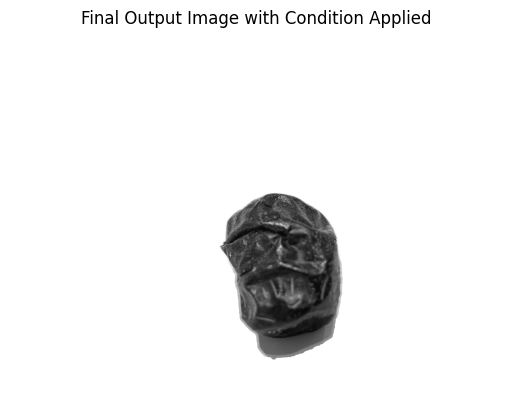

Processing: static/results/JD2012_1.png
Contour 1: 939620 pixels
  Below threshold: 780336 (83.05%)
  Contour 1 meets the condition.


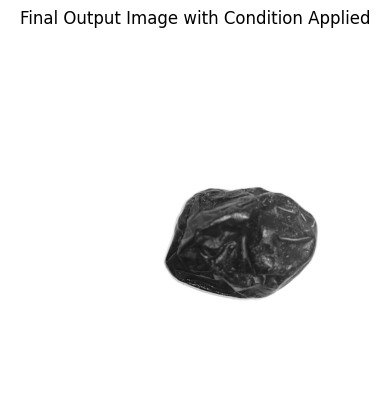

Processing: static/results/JD2022_1.png
Contour 1: 815660 pixels
  Below threshold: 700796 (85.92%)
  Contour 1 meets the condition.


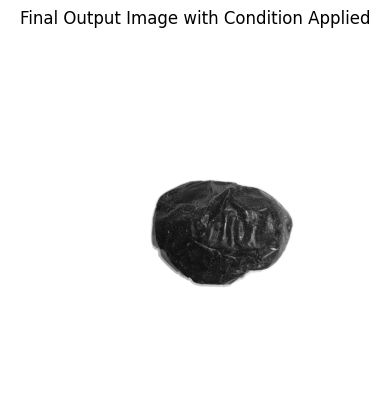

Processing: static/results/JD2009_6.png
Contour 1: 876152 pixels
  Below threshold: 714712 (81.57%)
  Contour 1 meets the condition.


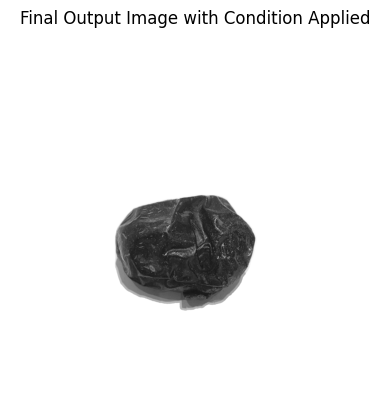

Processing: static/results/JD2030_5.png
Contour 1: 657176 pixels
  Below threshold: 577070 (87.81%)
  Contour 1 meets the condition.


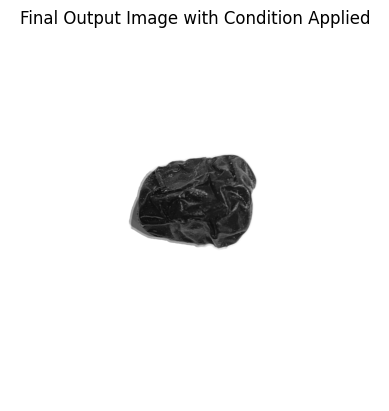

Processing: static/results/JD2011_8.png
Contour 1: 787842 pixels
  Below threshold: 614243 (77.97%)
  Contour 1 meets the condition.


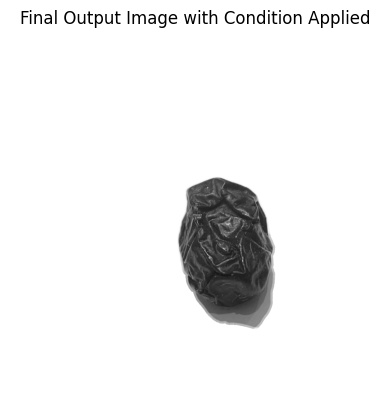

Processing: static/results/JD2037_1.png
Contour 1: 897314 pixels
  Below threshold: 796885 (88.81%)
  Contour 1 meets the condition.


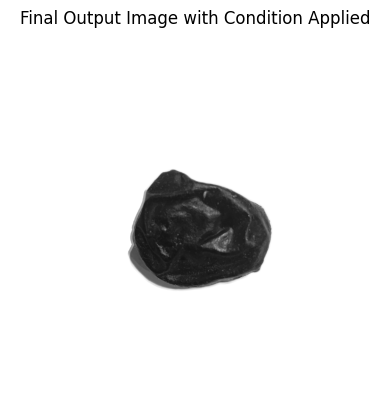

Processing: static/results/JD2023_2.png
Contour 1: 981176 pixels
  Below threshold: 798141 (81.35%)
  Contour 1 meets the condition.


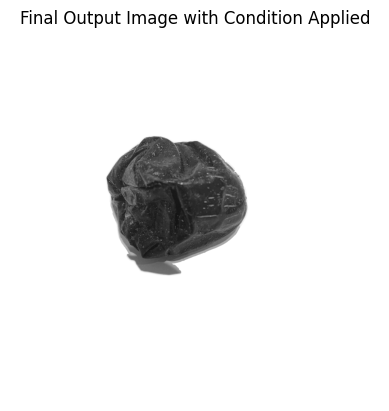

Processing: static/results/JD2034_6.png
Contour 1: 1224377 pixels
  Below threshold: 969636 (79.19%)
  Contour 1 meets the condition.


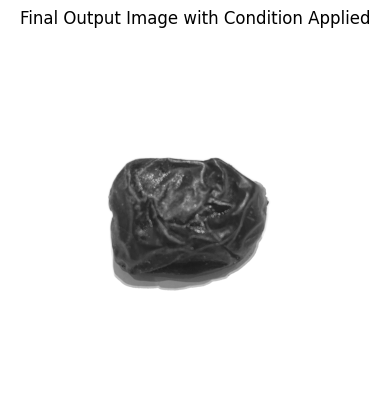

Processing: static/results/JD2008_7.png
Contour 1: 639891 pixels
  Below threshold: 549285 (85.84%)
  Contour 1 meets the condition.


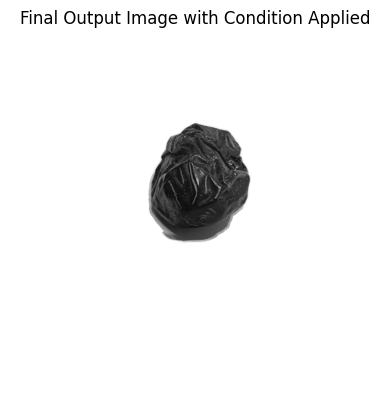

Processing: static/results/JD2004_5.png
Contour 1: 874496 pixels
  Below threshold: 799149 (91.38%)
  Contour 1 meets the condition.


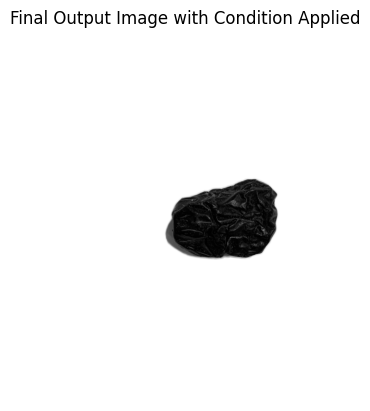

Processing: static/results/JD2036_4.png
Contour 1: 774674 pixels
  Below threshold: 663452 (85.64%)
  Contour 1 meets the condition.


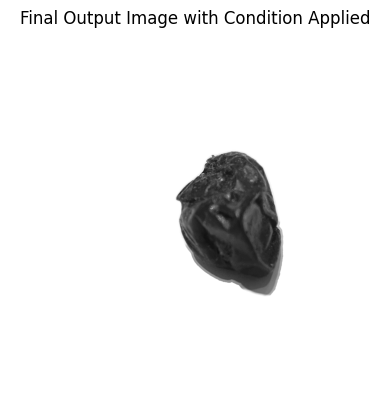

Processing: static/results/JD2013_6.png
Contour 1: 822496 pixels
  Below threshold: 670818 (81.56%)
  Contour 1 meets the condition.


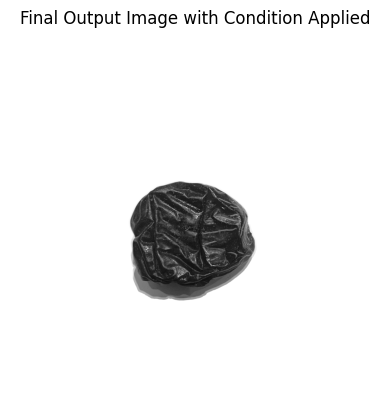

Processing: static/results/JD2038_1.png
Contour 1: 844300 pixels
  Below threshold: 730538 (86.53%)
  Contour 1 meets the condition.


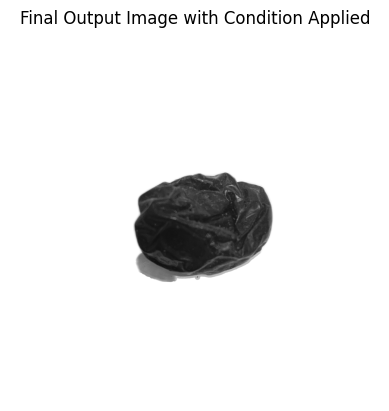

Processing: static/results/JD2025_5.png
Contour 1: 622345 pixels
  Below threshold: 537233 (86.32%)
  Contour 1 meets the condition.


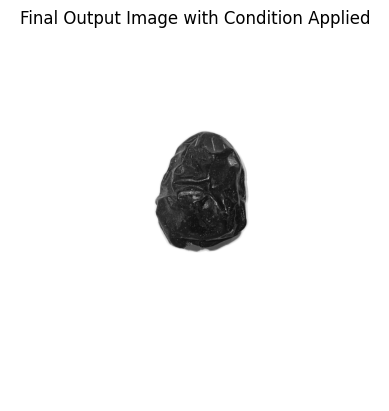

Processing: static/results/JD2030_7.png
Contour 1: 645997 pixels
  Below threshold: 562720 (87.11%)
  Contour 1 meets the condition.


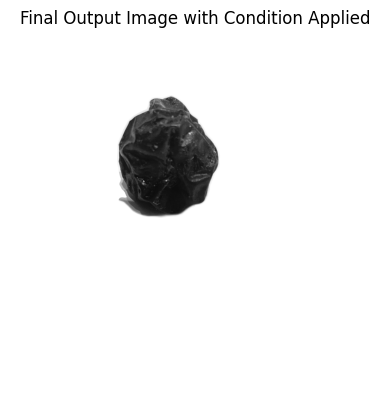

Processing: static/results/JD2008_4.png
Contour 1: 758182 pixels
  Below threshold: 568323 (74.96%)
  Contour 1 meets the condition.


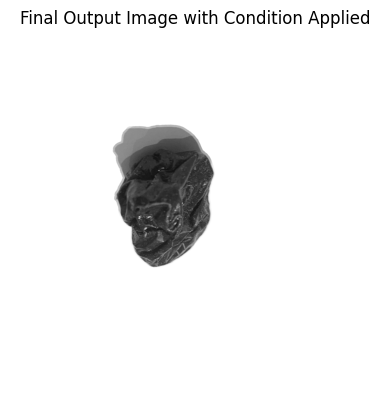

Processing: static/results/JD2001_3.png
Contour 1: 1279790 pixels
  Below threshold: 1077719 (84.21%)
  Contour 1 meets the condition.


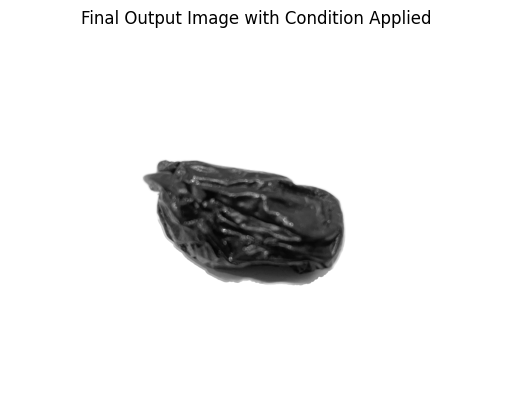

Processing: static/results/JD2019_8.png
Contour 1: 895463 pixels
  Below threshold: 751704 (83.95%)
  Contour 1 meets the condition.


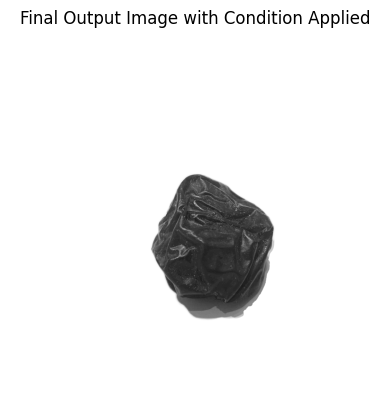

Processing: static/results/JD2035_1.png
Contour 1: 921590 pixels
  Below threshold: 795733 (86.34%)
  Contour 1 meets the condition.


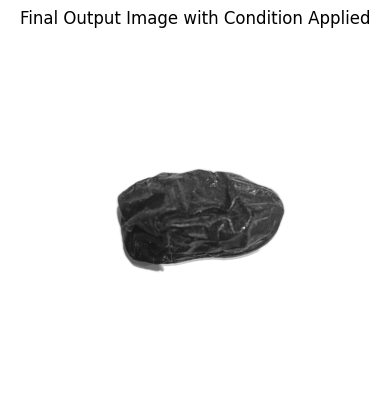

Processing: static/results/JD2027_5.png
Contour 1: 685033 pixels
  Below threshold: 603460 (88.09%)
  Contour 1 meets the condition.


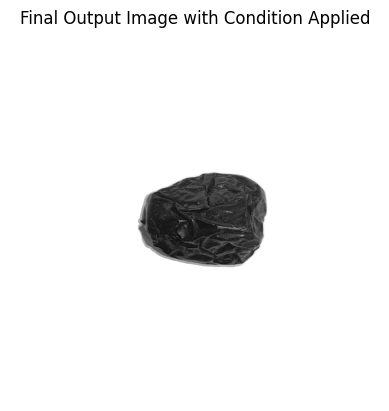

Processing: static/results/JD2016_5.png
Contour 1: 590975 pixels
  Below threshold: 501291 (84.82%)
  Contour 1 meets the condition.


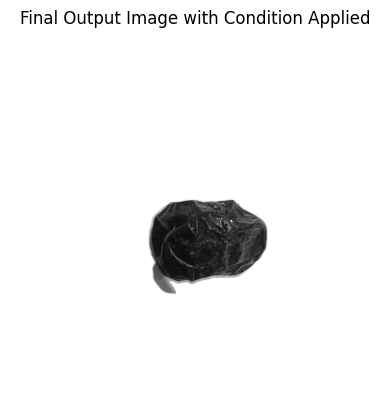

Processing: static/results/JD2006_5.png
Contour 1: 850339 pixels
  Below threshold: 724446 (85.19%)
  Contour 1 meets the condition.


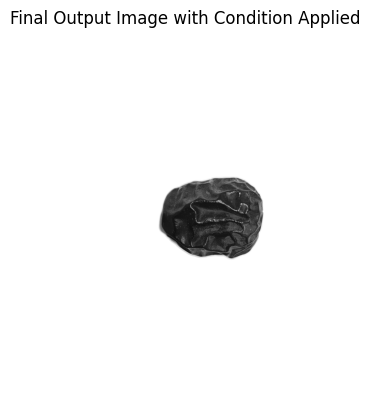

Processing: static/results/JD2014_8.png
Contour 1: 783054 pixels
  Below threshold: 641159 (81.88%)
  Contour 1 meets the condition.


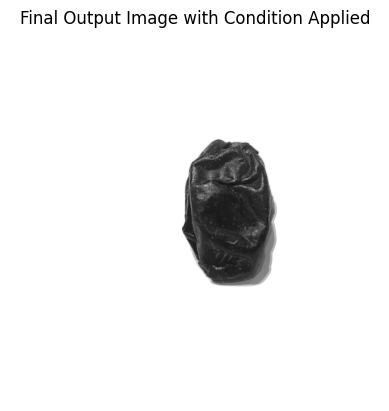

Processing: static/results/JD2003_5.png
Contour 1: 847474 pixels
  Below threshold: 682578 (80.54%)
  Contour 1 meets the condition.


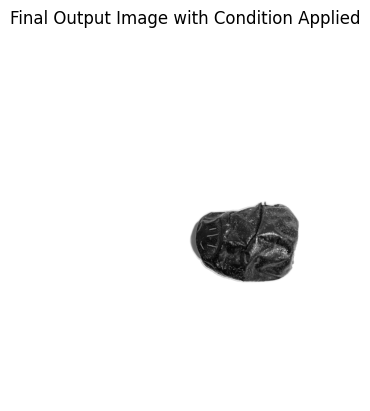

Processing: static/results/JD2041_6.png
Contour 1: 1068034 pixels
  Below threshold: 860974 (80.61%)
  Contour 1 meets the condition.


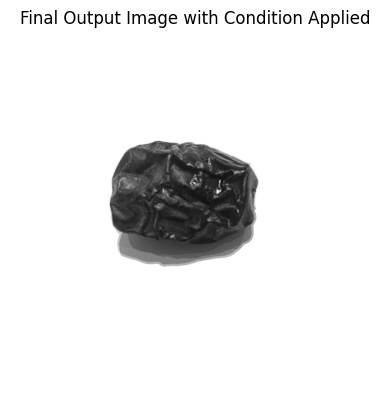

Processing: static/results/JD2017_5.png
Contour 1: 606364 pixels
  Below threshold: 503076 (82.97%)
  Contour 1 meets the condition.


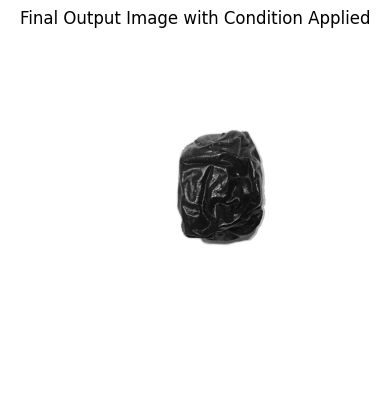

Processing: static/results/JD2007_8.png
Contour 1: 731573 pixels
  Below threshold: 598488 (81.81%)
  Contour 1 meets the condition.


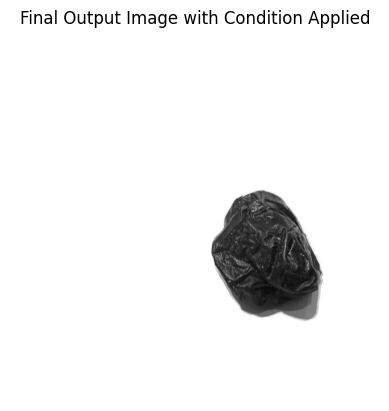

Processing: static/results/JD2041_8.png
Contour 1: 744097 pixels
  Below threshold: 632510 (85.00%)
  Contour 1 meets the condition.


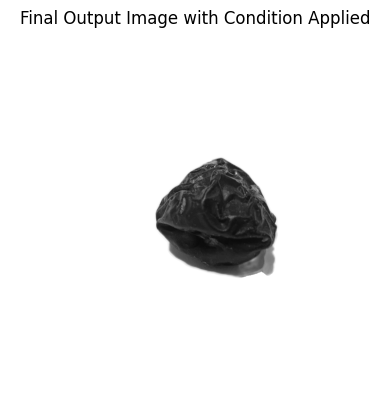

Processing: static/results/JD2009_3.png
Contour 1: 876183 pixels
  Below threshold: 723882 (82.62%)
  Contour 1 meets the condition.


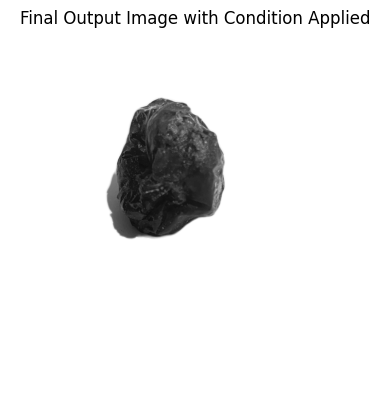

Processing: static/results/JD2018_5.png
Contour 1: 979096 pixels
  Below threshold: 856077 (87.44%)
  Contour 1 meets the condition.


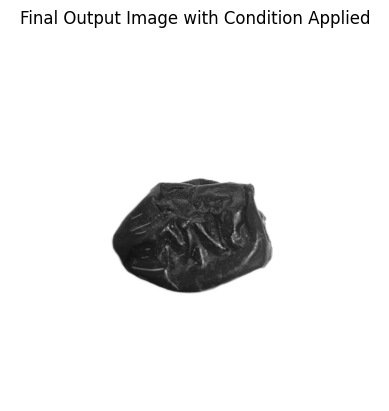

Processing: static/results/JD2008_6.png
Contour 1: 821770 pixels
  Below threshold: 696173 (84.72%)
  Contour 1 meets the condition.


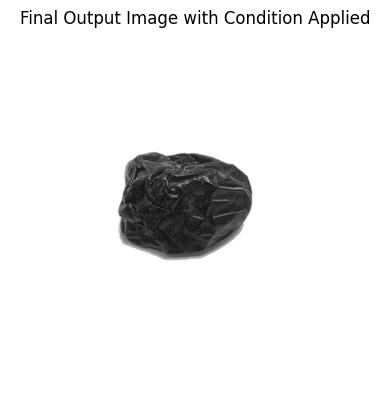

Processing: static/results/JD2010_1.png
Contour 1: 750989 pixels
  Below threshold: 648776 (86.39%)
  Contour 1 meets the condition.


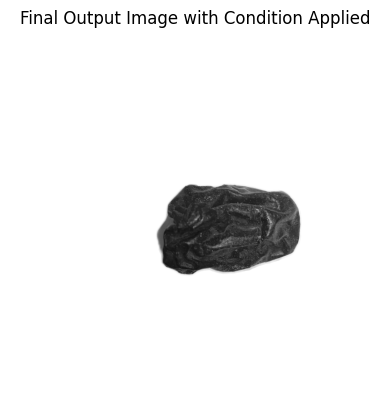

Processing: static/results/JD2032_8.png
Contour 1: 987195 pixels
  Below threshold: 825120 (83.58%)
  Contour 1 meets the condition.


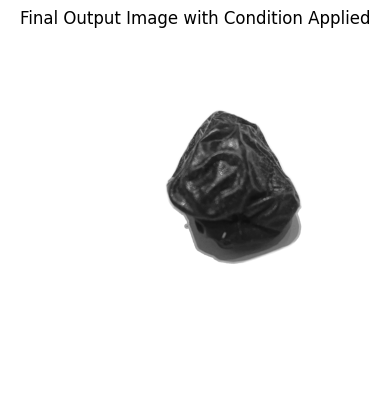

Processing: static/results/JD2009_4.png
Contour 1: 933005 pixels
  Below threshold: 746687 (80.03%)
  Contour 1 meets the condition.


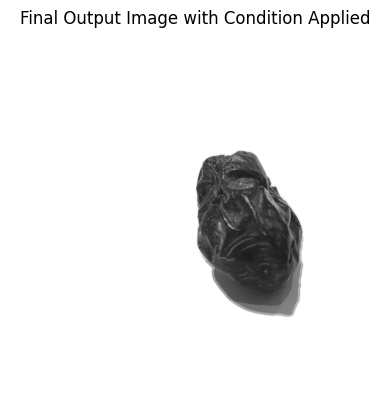

Processing: static/results/JD2028_3.png
Contour 1: 774937 pixels
  Below threshold: 662423 (85.48%)
  Contour 1 meets the condition.


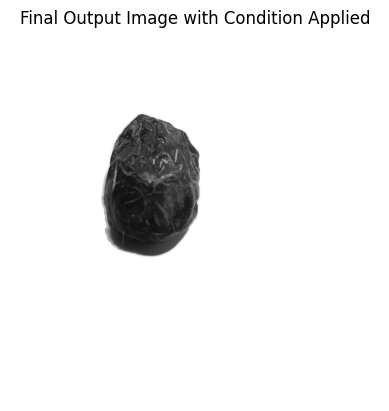

Processing: static/results/JD2033_6.png
Contour 1: 647167 pixels
  Below threshold: 521205 (80.54%)
  Contour 1 meets the condition.
Contour 2: 1515 pixels
  Below threshold: 1 (0.07%)
  Contour 2 does not meet the condition.


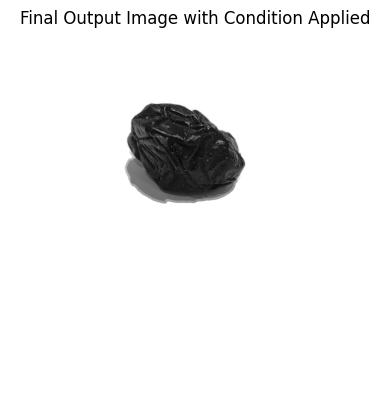

Processing: static/results/JD2030_3.png
Contour 1: 608222 pixels
  Below threshold: 525191 (86.35%)
  Contour 1 meets the condition.


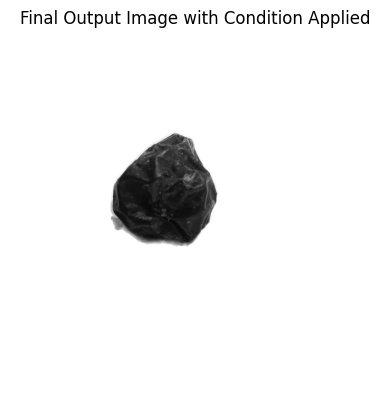

Processing: static/results/JD2015_8.png
Contour 1: 656161 pixels
  Below threshold: 513427 (78.25%)
  Contour 1 meets the condition.


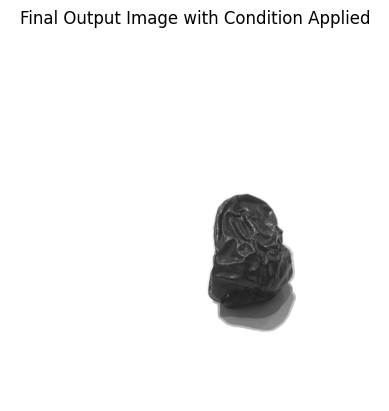

Processing: static/results/JD2021_1.png
Contour 1: 912810 pixels
  Below threshold: 776221 (85.04%)
  Contour 1 meets the condition.


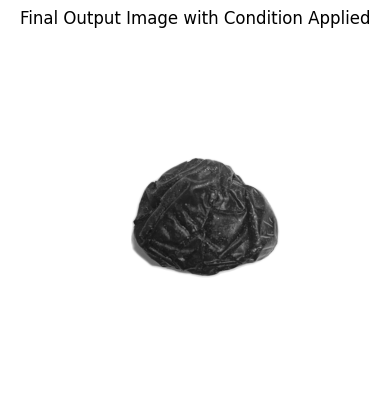

Processing: static/results/JD2034_1.png
Contour 1: 887323 pixels
  Below threshold: 757860 (85.41%)
  Contour 1 meets the condition.
Contour 2: 4181 pixels
  Below threshold: 0 (0.00%)
  Contour 2 does not meet the condition.


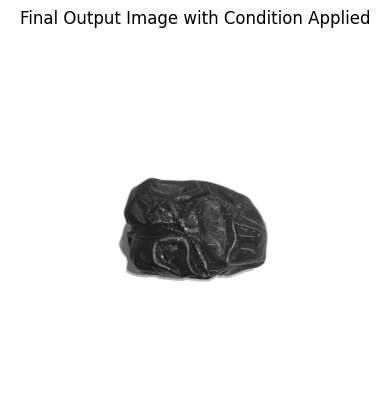

Processing: static/results/JD2007_2.png
Contour 1: 967999 pixels
  Below threshold: 800151 (82.66%)
  Contour 1 meets the condition.


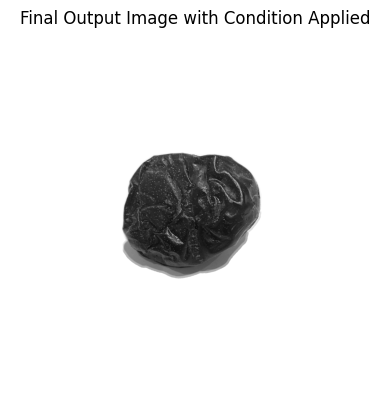

Processing: static/results/JD2038_2.png
Contour 1: 995684 pixels
  Below threshold: 803163 (80.66%)
  Contour 1 meets the condition.


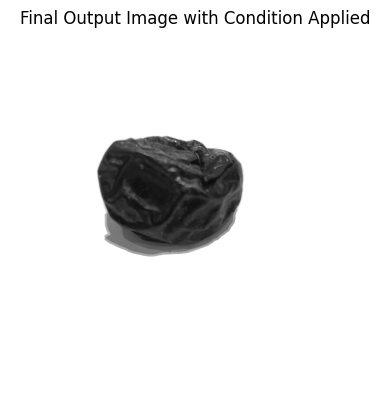

Processing: static/results/JD2017_7.png
Contour 1: 569527 pixels
  Below threshold: 502788 (88.28%)
  Contour 1 meets the condition.


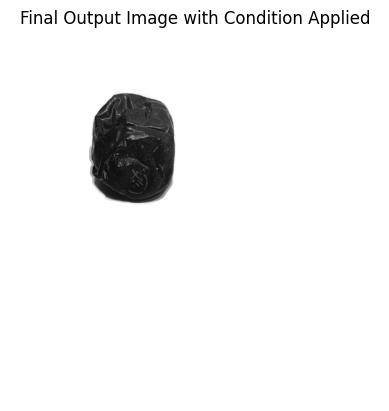

Processing: static/results/JD2032_7.png
Contour 1: 932385 pixels
  Below threshold: 742211 (79.60%)
  Contour 1 meets the condition.


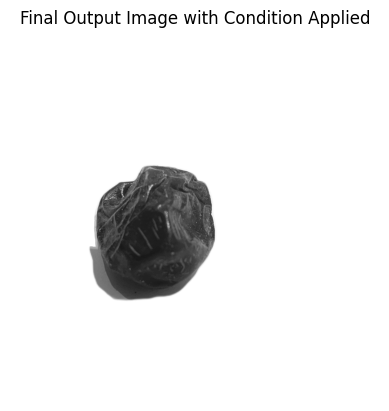

Processing: static/results/JD2028_2.png
Contour 1: 980883 pixels
  Below threshold: 828929 (84.51%)
  Contour 1 meets the condition.


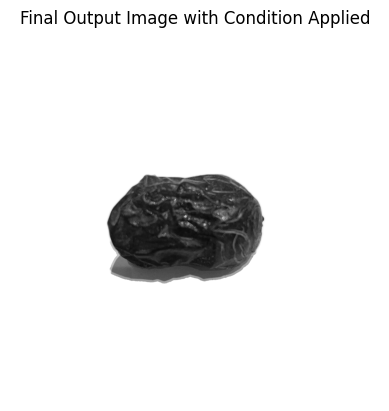

Processing: static/results/JD2037_4.png
Contour 1: 1009121 pixels
  Below threshold: 850265 (84.26%)
  Contour 1 meets the condition.


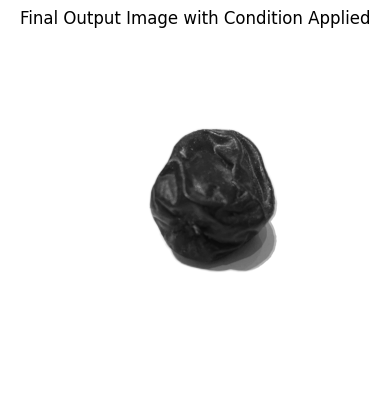

Processing: static/results/JD2011_7.png
Contour 1: 704106 pixels
  Below threshold: 607981 (86.35%)
  Contour 1 meets the condition.


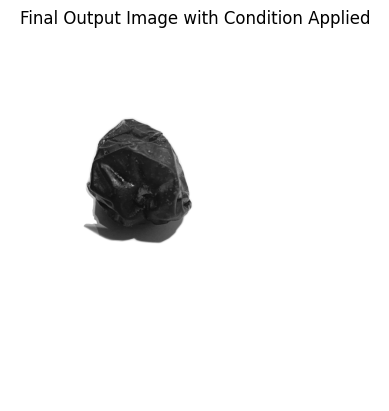

Processing: static/results/JD2011_6.png
Contour 1: 883446 pixels
  Below threshold: 729435 (82.57%)
  Contour 1 meets the condition.


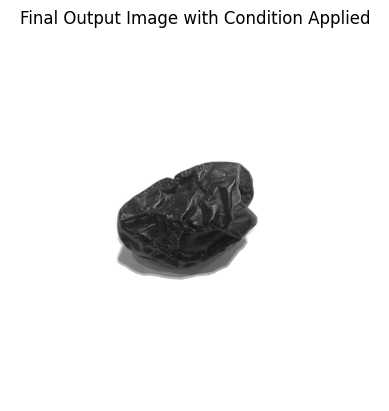

Processing: static/results/JD2019_4.png
Contour 1: 885505 pixels
  Below threshold: 719002 (81.20%)
  Contour 1 meets the condition.


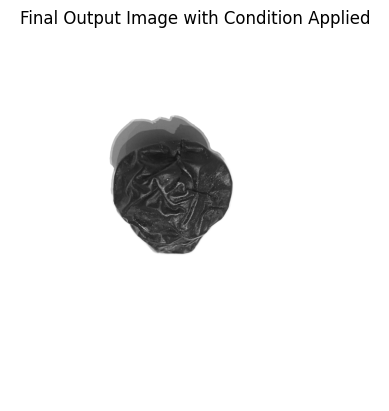

Processing: static/results/JD2023_1.png
Contour 1: 676949 pixels
  Below threshold: 596808 (88.16%)
  Contour 1 meets the condition.


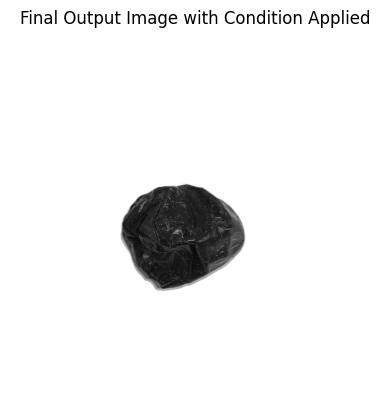

Processing: static/results/JD2032_6.png
Contour 1: 1382797 pixels
  Below threshold: 1099280 (79.50%)
  Contour 1 meets the condition.


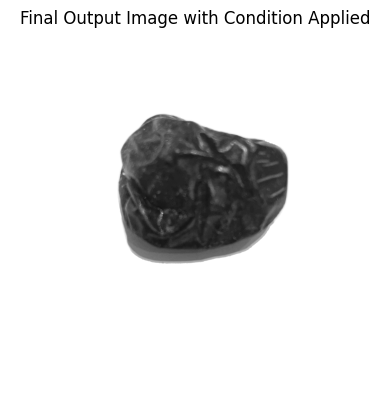

Processing: static/results/JD2040_3.png
Contour 1: 806709 pixels
  Below threshold: 674671 (83.63%)
  Contour 1 meets the condition.


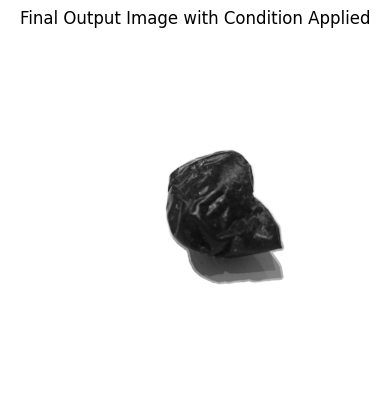

Processing: static/results/JD2013_8.png
Contour 1: 826425 pixels
  Below threshold: 659946 (79.86%)
  Contour 1 meets the condition.


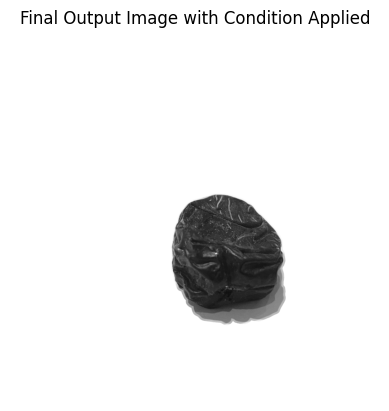

Processing: static/results/JD2034_2.png
Contour 1: 1293665 pixels
  Below threshold: 1049152 (81.10%)
  Contour 1 meets the condition.


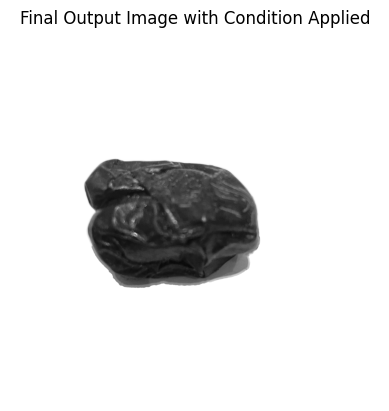

Processing: static/results/JD2027_1.png
Contour 1: 807764 pixels
  Below threshold: 697401 (86.34%)
  Contour 1 meets the condition.


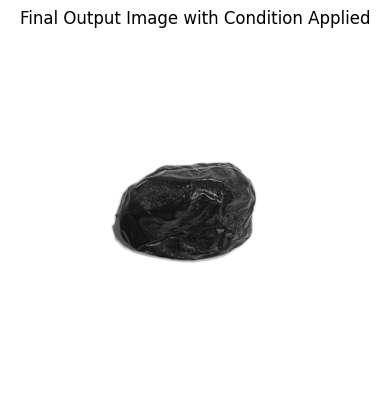

Processing: static/results/JD2032_1.png
Contour 1: 1110058 pixels
  Below threshold: 914947 (82.42%)
  Contour 1 meets the condition.


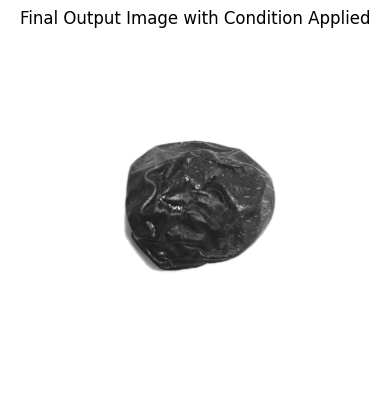

Processing: static/results/JD2014_2.png
Contour 1: 834368 pixels
  Below threshold: 686712 (82.30%)
  Contour 1 meets the condition.


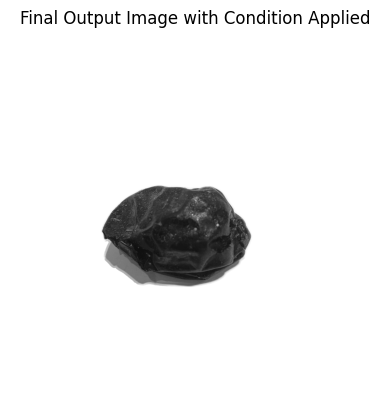

Processing: static/results/JD2027_6.png
Contour 1: 846819 pixels
  Below threshold: 700856 (82.76%)
  Contour 1 meets the condition.


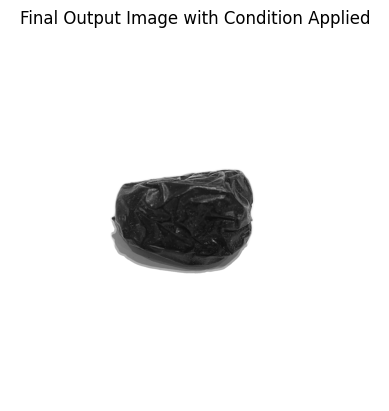

Processing: static/results/JD2018_6.png
Contour 1: 858695 pixels
  Below threshold: 742698 (86.49%)
  Contour 1 meets the condition.


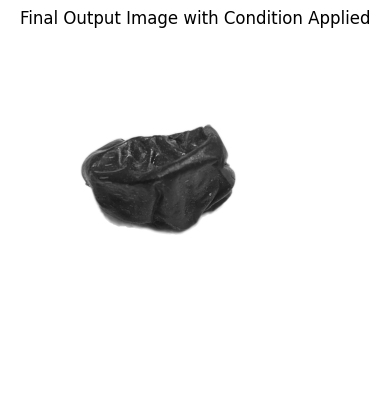

Processing: static/results/JD2002_8.png
Contour 1: 958440 pixels
  Below threshold: 741999 (77.42%)
  Contour 1 meets the condition.


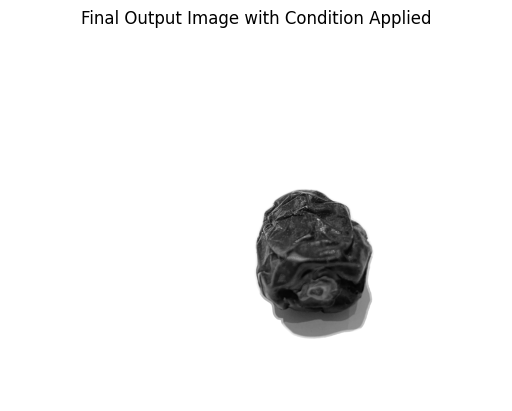

Processing: static/results/JD2008_5.png
Contour 1: 924953 pixels
  Below threshold: 752087 (81.31%)
  Contour 1 meets the condition.


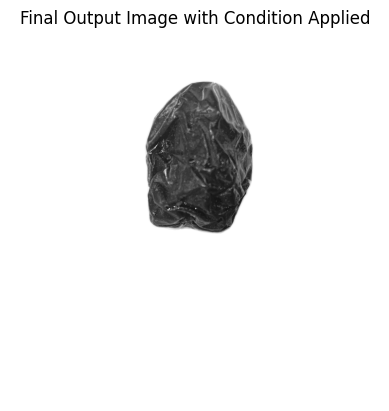

Processing: static/results/JD2016_6.png
Contour 1: 859955 pixels
  Below threshold: 737923 (85.81%)
  Contour 1 meets the condition.


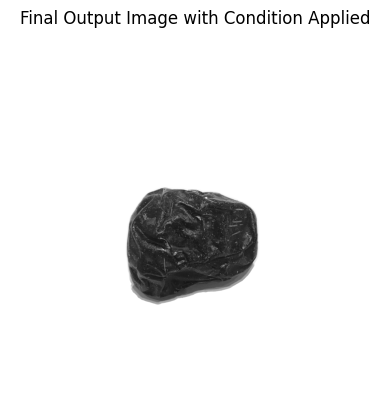

Processing: static/results/JD2033_5.png
Contour 1: 874255 pixels
  Below threshold: 766060 (87.62%)
  Contour 1 meets the condition.


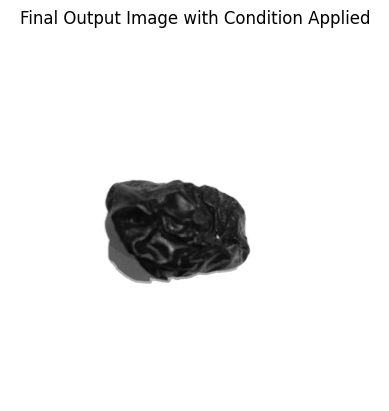

Processing: static/results/JD2020_5.png
Contour 1: 768506 pixels
  Below threshold: 655979 (85.36%)
  Contour 1 meets the condition.


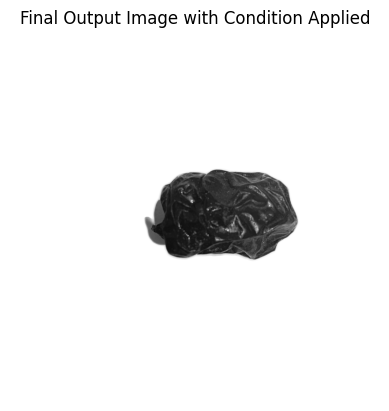

Processing: static/results/JD2041_2.png
Contour 1: 1048256 pixels
  Below threshold: 852235 (81.30%)
  Contour 1 meets the condition.


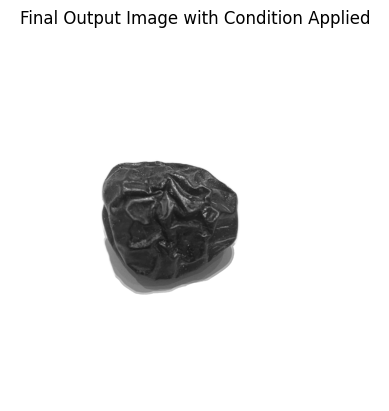

Processing: static/results/JD2035_3.png
Contour 1: 812363 pixels
  Below threshold: 668366 (82.27%)
  Contour 1 meets the condition.


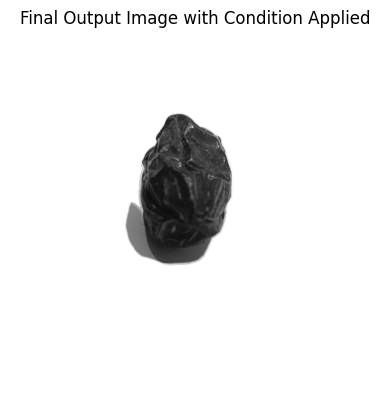

Processing: static/results/JD2041_5.png
Contour 1: 830388 pixels
  Below threshold: 724976 (87.31%)
  Contour 1 meets the condition.


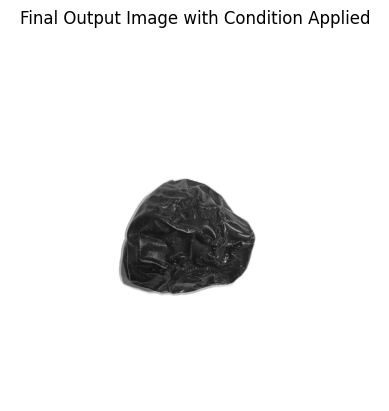

Processing: static/results/JD2006_3.png
Contour 1: 846293 pixels
  Below threshold: 711106 (84.03%)
  Contour 1 meets the condition.


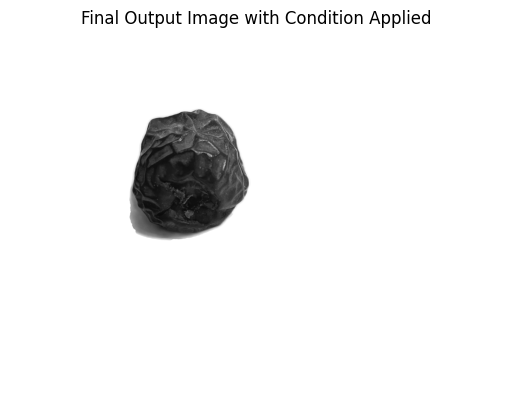

Processing: static/results/JD2031_5.png
Contour 1: 949247 pixels
  Below threshold: 783590 (82.55%)
  Contour 1 meets the condition.


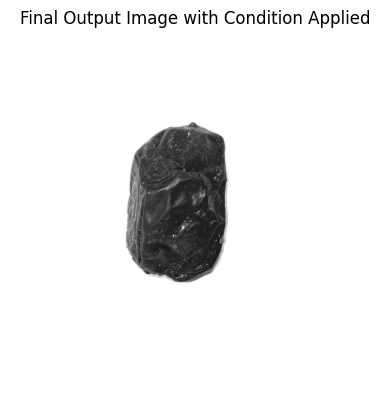

Processing: static/results/JD2022_7.png
Contour 1: 941104 pixels
  Below threshold: 745366 (79.20%)
  Contour 1 meets the condition.


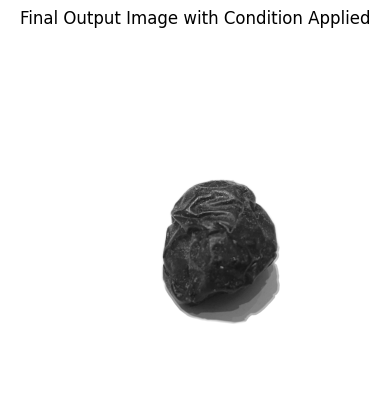

Processing: static/results/JD2029_1.png
Contour 1: 929789 pixels
  Below threshold: 813498 (87.49%)
  Contour 1 meets the condition.


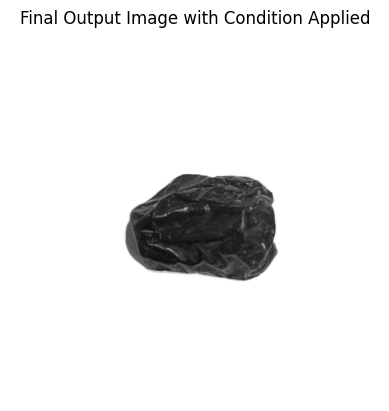

Processing: static/results/JD2029_5.png
Contour 1: 902404 pixels
  Below threshold: 795935 (88.20%)
  Contour 1 meets the condition.


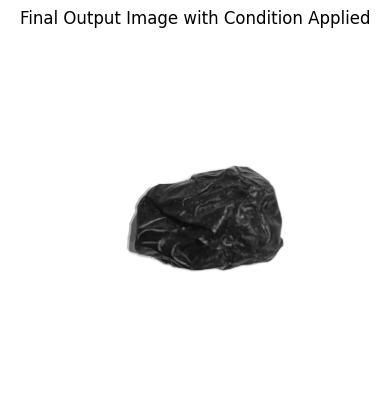

Processing: static/results/JD2005_8.png
Contour 1: 1227953 pixels
  Below threshold: 992597 (80.83%)
  Contour 1 meets the condition.


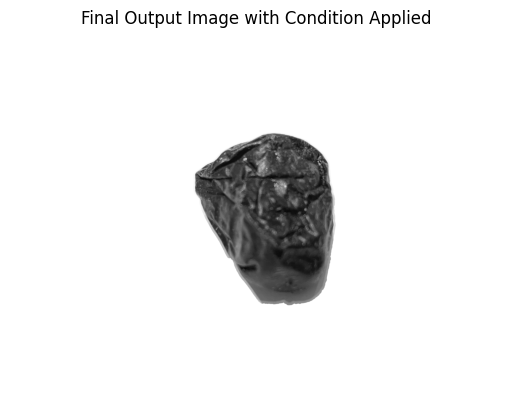

Processing: static/results/JD2022_3.png
Contour 1: 926972 pixels
  Below threshold: 786612 (84.86%)
  Contour 1 meets the condition.


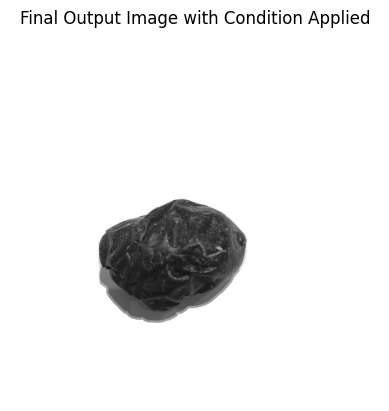

Processing: static/results/JD2012_6.png
Contour 1: 858138 pixels
  Below threshold: 694249 (80.90%)
  Contour 1 meets the condition.


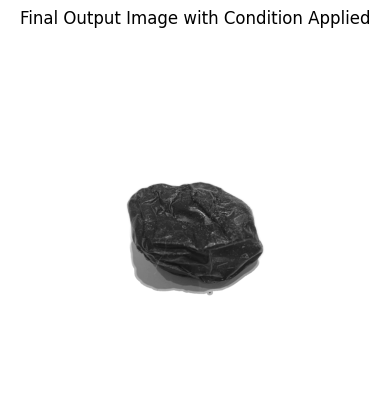

Processing: static/results/JD2023_8.png
Contour 1: 817133 pixels
  Below threshold: 662531 (81.08%)
  Contour 1 meets the condition.


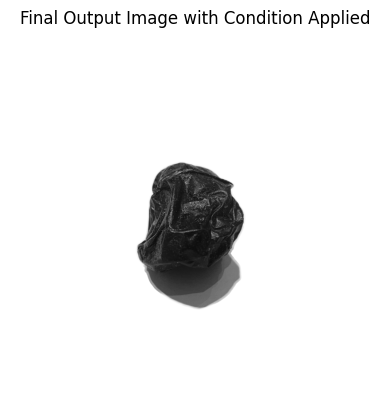

Processing: static/results/JD2024_1.png
Contour 1: 940097 pixels
  Below threshold: 827472 (88.02%)
  Contour 1 meets the condition.


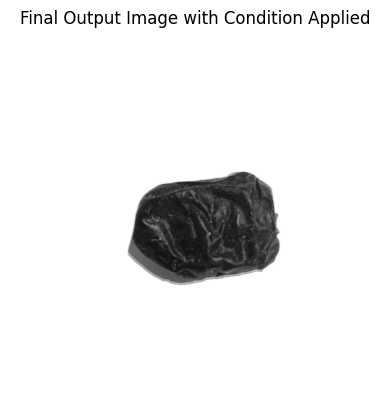

Processing: static/results/JD2031_7.png
Contour 1: 992149 pixels
  Below threshold: 757320 (76.33%)
  Contour 1 meets the condition.


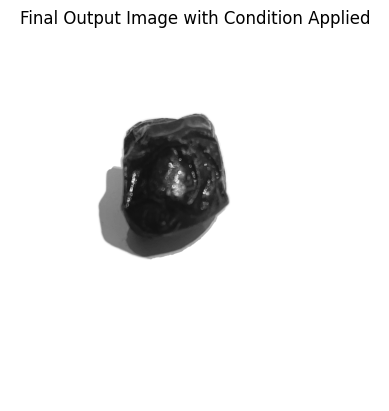

Processing: static/results/JD2011_3.png
Contour 1: 575951 pixels
  Below threshold: 490143 (85.10%)
  Contour 1 meets the condition.


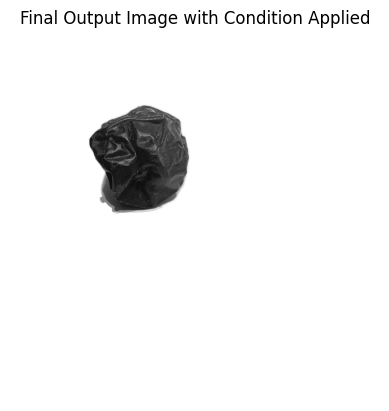

Processing: static/results/JD2018_4.png
Contour 1: 947557 pixels
  Below threshold: 775489 (81.84%)
  Contour 1 meets the condition.


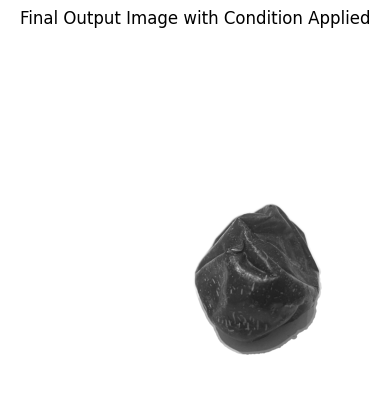

Processing: static/results/JD2002_6.png
Contour 1: 1233729 pixels
  Below threshold: 905819 (73.42%)
  Contour 1 meets the condition.


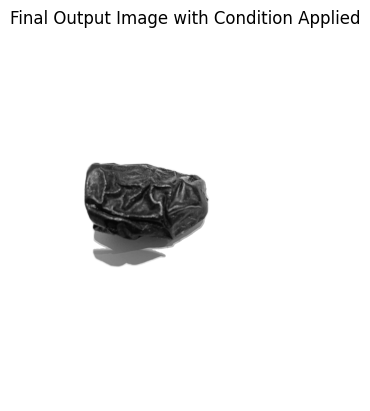

Processing: static/results/JD2008_1.png
Contour 1: 891242 pixels
  Below threshold: 719080 (80.68%)
  Contour 1 meets the condition.


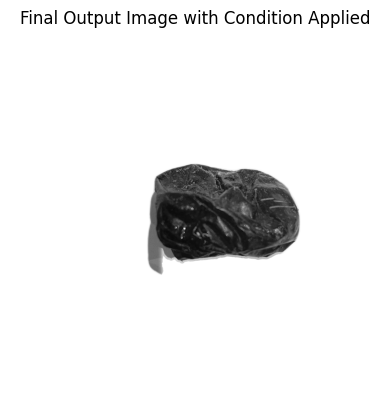

Processing: static/results/JD2039_2.png
Contour 1: 1072299 pixels
  Below threshold: 886945 (82.71%)
  Contour 1 meets the condition.


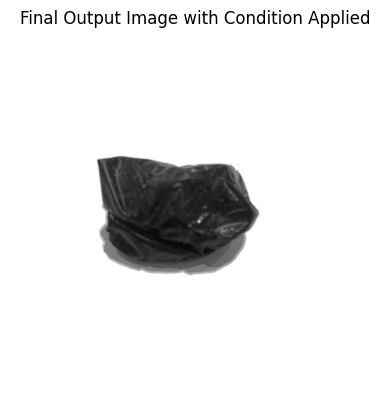

Processing: static/results/JD2004_3.png
Contour 1: 933241 pixels
  Below threshold: 835491 (89.53%)
  Contour 1 meets the condition.


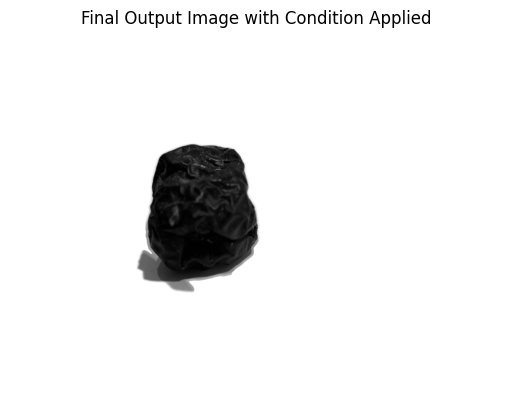

Processing: static/results/JD2020_8.png
Contour 1: 850950 pixels
  Below threshold: 711458 (83.61%)
  Contour 1 meets the condition.


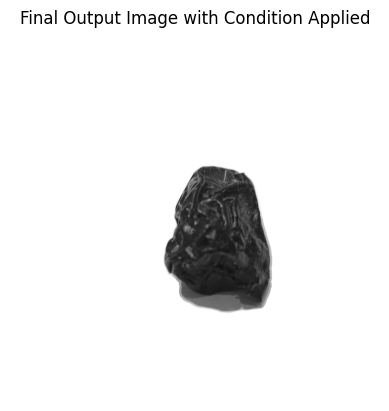

Processing: static/results/JD2017_8.png
Contour 1: 631608 pixels
  Below threshold: 516211 (81.73%)
  Contour 1 meets the condition.


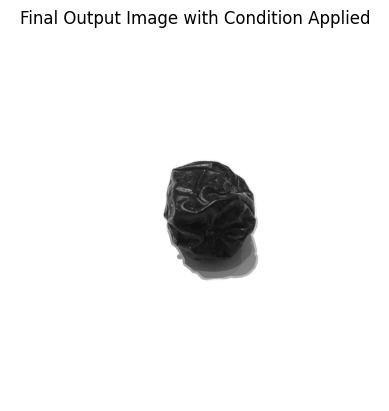

Processing: static/results/JD2026_4.png
Contour 1: 653588 pixels
  Below threshold: 519321 (79.46%)
  Contour 1 meets the condition.


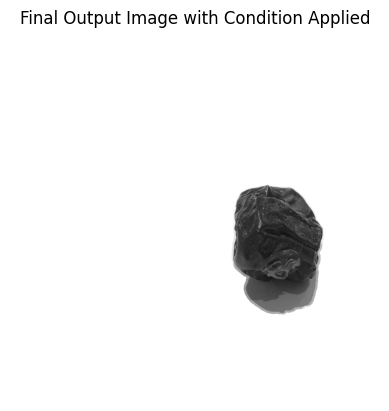

Processing: static/results/JD2018_8.png
Contour 1: 1210131 pixels
  Below threshold: 926051 (76.52%)
  Contour 1 meets the condition.


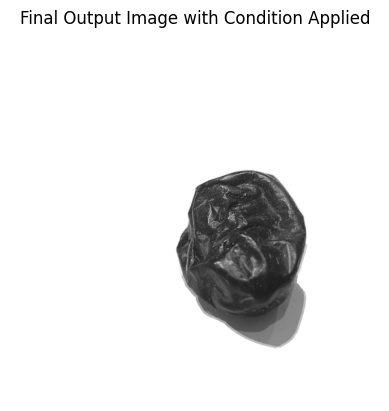

Processing: static/results/JD2028_1.png
Contour 1: 777489 pixels
  Below threshold: 671614 (86.38%)
  Contour 1 meets the condition.


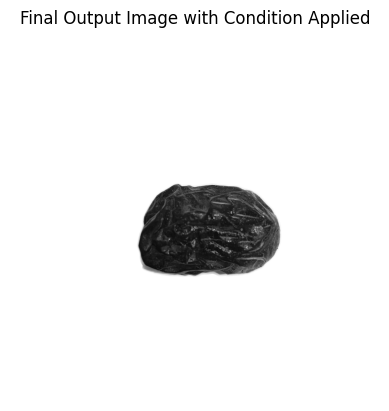

Processing: static/results/JD2028_7.png
Contour 1: 746533 pixels
  Below threshold: 621396 (83.24%)
  Contour 1 meets the condition.


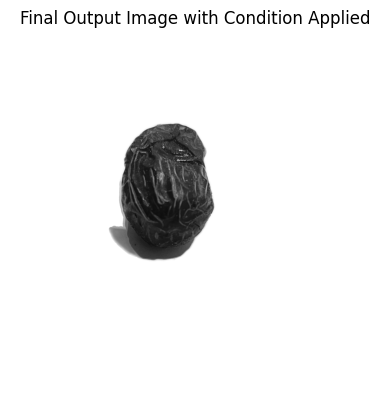

Processing: static/results/JD2025_6.png
Contour 1: 789197 pixels
  Below threshold: 687538 (87.12%)
  Contour 1 meets the condition.


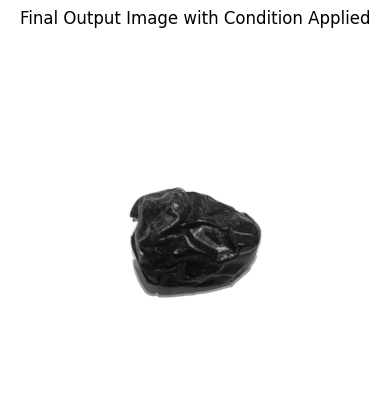

Processing: static/results/JD2009_8.png
Contour 1: 1052491 pixels
  Below threshold: 822091 (78.11%)
  Contour 1 meets the condition.


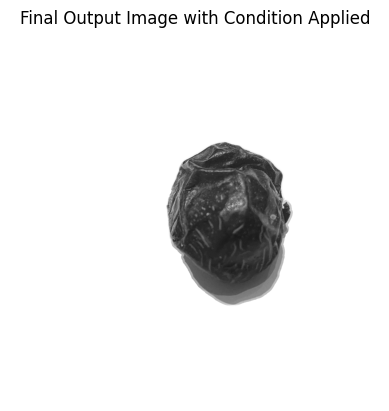

Processing: static/results/JD2017_2.png
Contour 1: 776679 pixels
  Below threshold: 659096 (84.86%)
  Contour 1 meets the condition.
Contour 2: 1340 pixels
  Below threshold: 15 (1.12%)
  Contour 2 does not meet the condition.


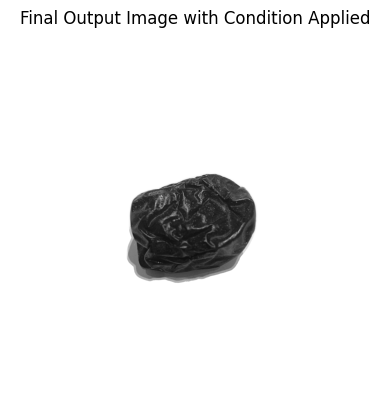

Processing: static/results/JD2039_8.png
Contour 1: 666159 pixels
  Below threshold: 579301 (86.96%)
  Contour 1 meets the condition.


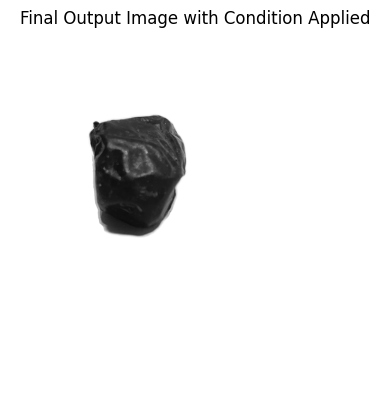

Processing: static/results/JD2037_3.png
Contour 1: 704458 pixels
  Below threshold: 593368 (84.23%)
  Contour 1 meets the condition.


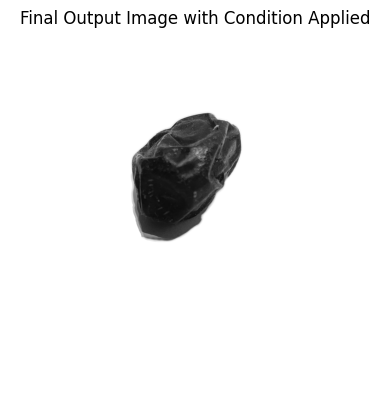

Processing: static/results/JD2009_7.png
Contour 1: 734699 pixels
  Below threshold: 625571 (85.15%)
  Contour 1 meets the condition.


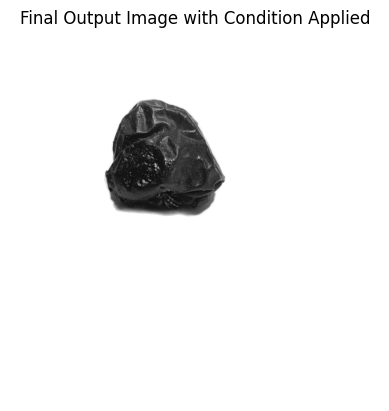

Processing: static/results/JD2034_8.png
Contour 1: 874209 pixels
  Below threshold: 759197 (86.84%)
  Contour 1 meets the condition.


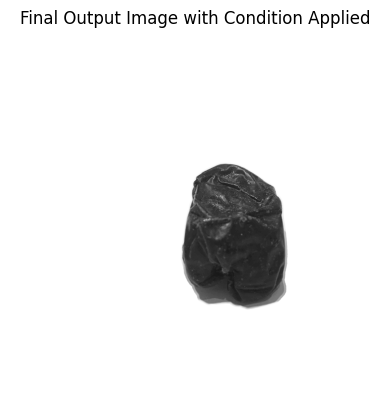

Processing: static/results/JD2023_7.png
Contour 1: 759298 pixels
  Below threshold: 647742 (85.31%)
  Contour 1 meets the condition.
Contour 2: 18513 pixels
  Below threshold: 0 (0.00%)
  Contour 2 does not meet the condition.
Contour 3: 164218 pixels
  Below threshold: 35 (0.02%)
  Contour 3 does not meet the condition.
Contour 4: 50645 pixels
  Below threshold: 0 (0.00%)
  Contour 4 does not meet the condition.
Contour 5: 15089 pixels
  Below threshold: 0 (0.00%)
  Contour 5 does not meet the condition.


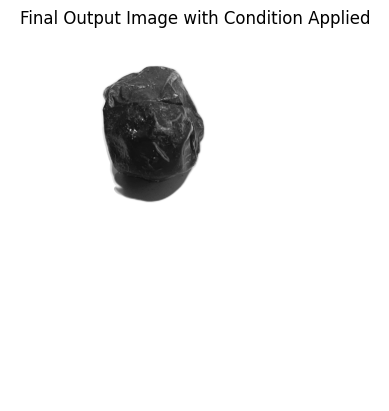

Processing: static/results/JD2018_1.png
Contour 1: 960466 pixels
  Below threshold: 803786 (83.69%)
  Contour 1 meets the condition.


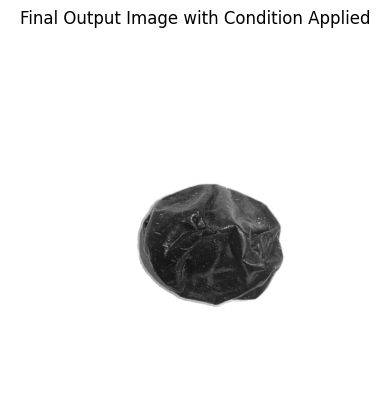

Processing: static/results/JD2017_4.png
Contour 1: 596348 pixels
  Below threshold: 465352 (78.03%)
  Contour 1 meets the condition.


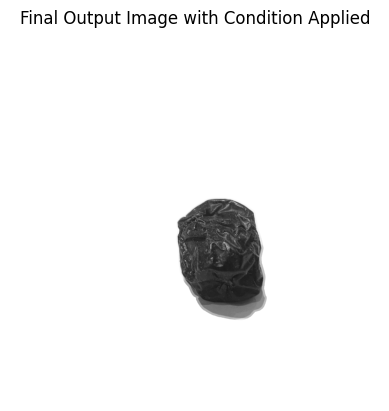

Processing: static/results/JD2023_3.png
Contour 1: 615585 pixels
  Below threshold: 538638 (87.50%)
  Contour 1 meets the condition.


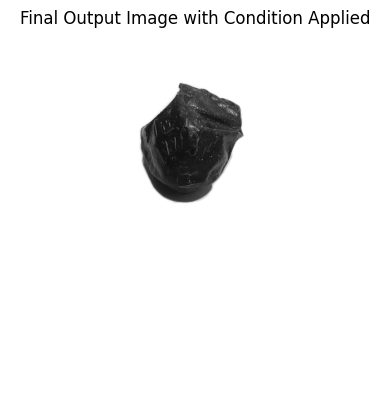

Processing: static/results/JD2024_4.png
Contour 1: 788438 pixels
  Below threshold: 639304 (81.08%)
  Contour 1 meets the condition.


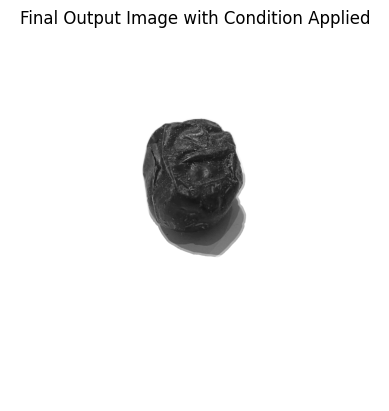

Processing: static/results/JD2033_8.png
Contour 1: 803079 pixels
  Below threshold: 650230 (80.97%)
  Contour 1 meets the condition.


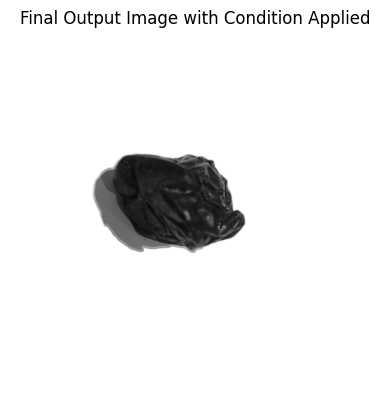

Processing: static/results/JD2009_2.png
Contour 1: 1147177 pixels
  Below threshold: 943606 (82.25%)
  Contour 1 meets the condition.


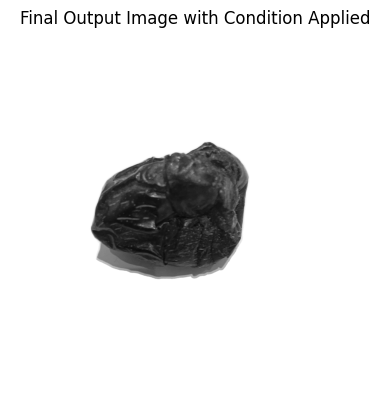

Processing: static/results/JD2036_5.png
Contour 1: 728182 pixels
  Below threshold: 643780 (88.41%)
  Contour 1 meets the condition.
Contour 2: 23256 pixels
  Below threshold: 268 (1.15%)
  Contour 2 does not meet the condition.


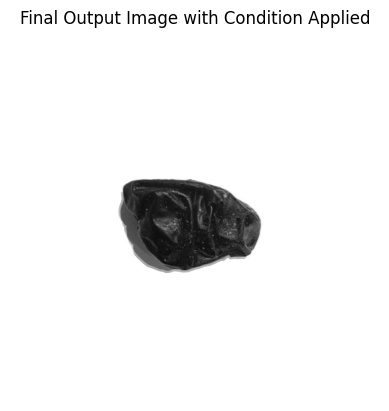

Processing: static/results/JD2026_8.png
Contour 1: 741684 pixels
  Below threshold: 614681 (82.88%)
  Contour 1 meets the condition.


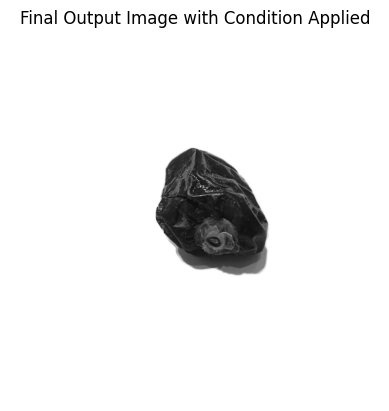

Processing: static/results/JD2018_7.png
Contour 1: 624909 pixels
  Below threshold: 531465 (85.05%)
  Contour 1 meets the condition.


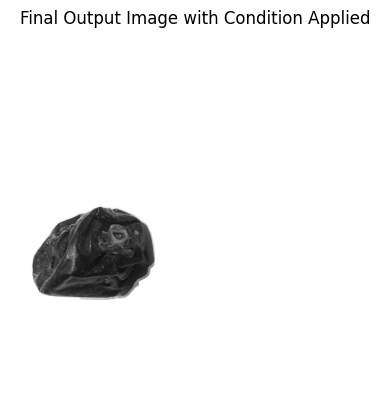

Processing: static/results/JD2025_8.png
Contour 1: 694201 pixels
  Below threshold: 572919 (82.53%)
  Contour 1 meets the condition.


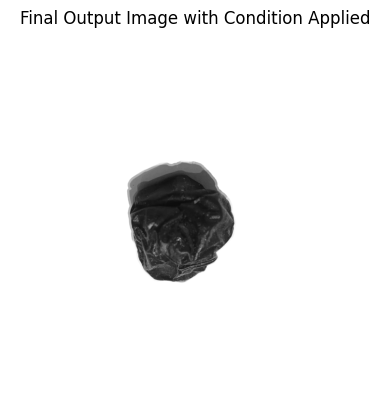

Processing: static/results/JD2004_7.png
Contour 1: 740077 pixels
  Below threshold: 675778 (91.31%)
  Contour 1 meets the condition.


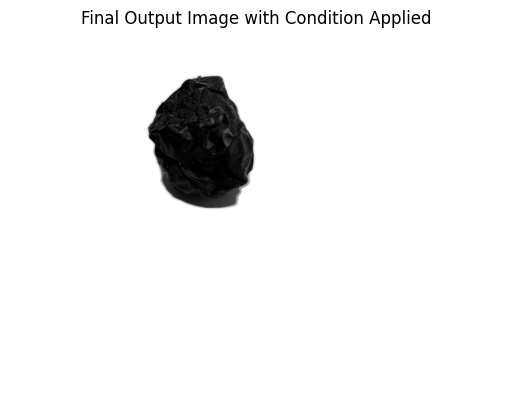

Processing: static/results/JD2025_2.png
Contour 1: 899070 pixels
  Below threshold: 739280 (82.23%)
  Contour 1 meets the condition.


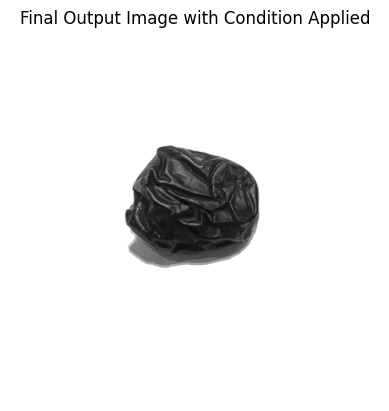

Processing: static/results/JD2039_3.png
Contour 1: 716921 pixels
  Below threshold: 578456 (80.69%)
  Contour 1 meets the condition.


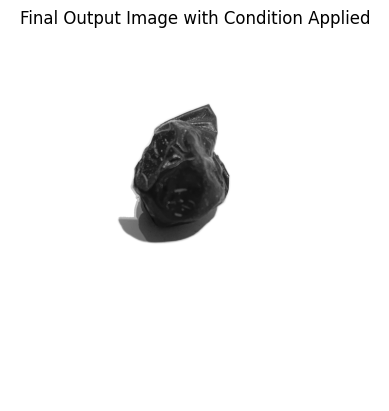

Processing: static/results/JD2010_7.png
Contour 1: 684427 pixels
  Below threshold: 604504 (88.32%)
  Contour 1 meets the condition.


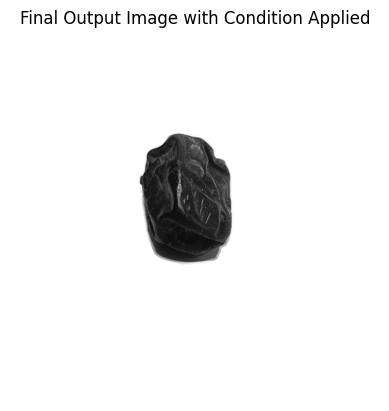

Processing: static/results/JD2024_7.png
Contour 1: 715862 pixels
  Below threshold: 610908 (85.34%)
  Contour 1 meets the condition.


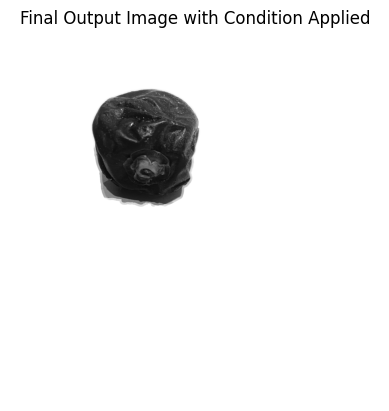

Processing: static/results/JD2034_5.png
Contour 1: 733328 pixels
  Below threshold: 639577 (87.22%)
  Contour 1 meets the condition.


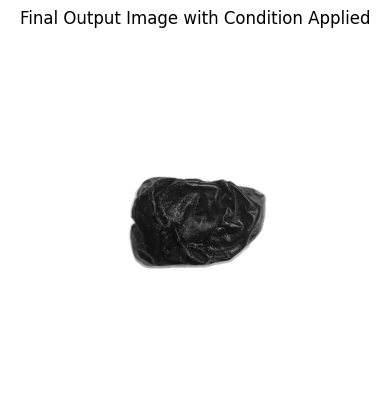

Processing: static/results/JD2027_3.png
Contour 1: 620766 pixels
  Below threshold: 502834 (81.00%)
  Contour 1 meets the condition.


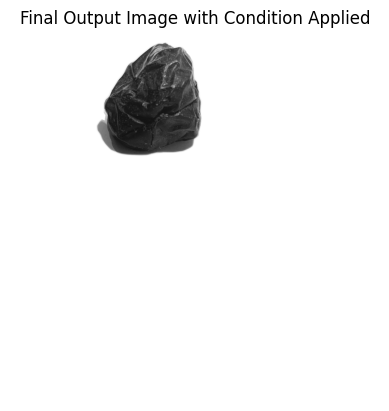

Processing: static/results/JD2035_5.png
Contour 1: 767872 pixels
  Below threshold: 672737 (87.61%)
  Contour 1 meets the condition.


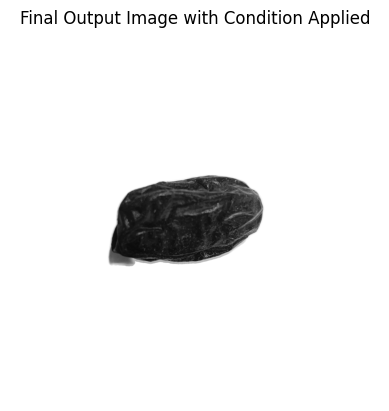

Processing: static/results/JD2033_3.png
Contour 1: 738447 pixels
  Below threshold: 637256 (86.30%)
  Contour 1 meets the condition.


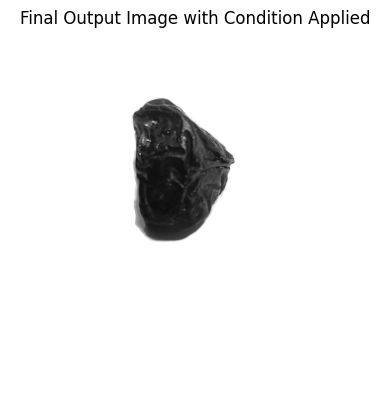

Processing: static/results/JD2022_6.png
Contour 1: 649404 pixels
  Below threshold: 525532 (80.93%)
  Contour 1 meets the condition.


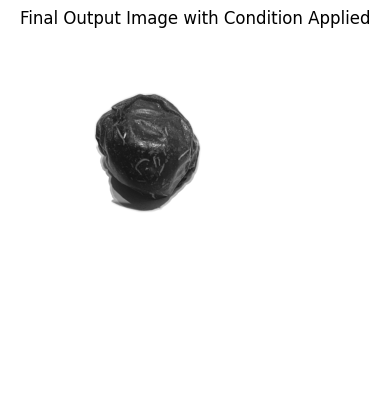

Processing: static/results/JD2027_4.png
Contour 1: 818774 pixels
  Below threshold: 664995 (81.22%)
  Contour 1 meets the condition.


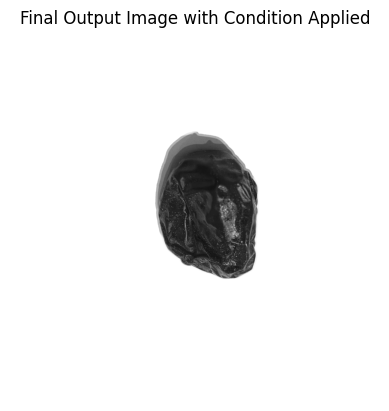

Processing: static/results/JD2041_1.png
Contour 1: 992529 pixels
  Below threshold: 855456 (86.19%)
  Contour 1 meets the condition.


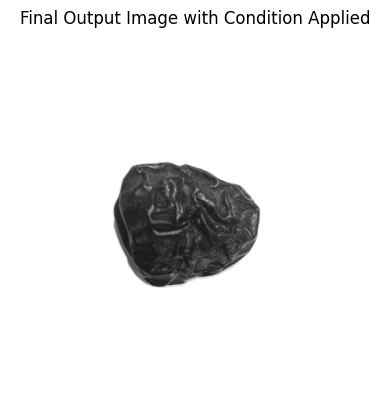

Processing: static/results/JD2015_3.png
Contour 1: 544440 pixels
  Below threshold: 454708 (83.52%)
  Contour 1 meets the condition.


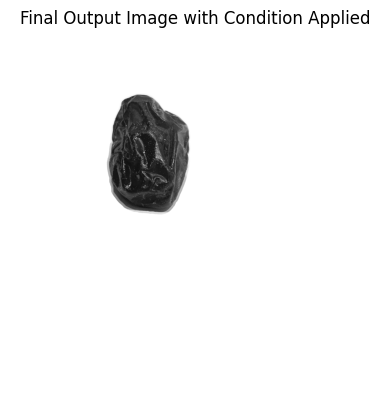

Processing: static/results/JD2025_1.png
Contour 1: 756731 pixels
  Below threshold: 678214 (89.62%)
  Contour 1 meets the condition.


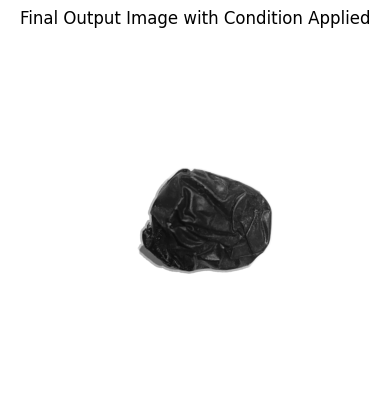

In [56]:
# # Specify the paths
# output_directory = "static/processed_results/"  # Specify your output directory here
# if not os.path.exists(output_directory):
#     os.makedirs(output_directory)




# # ------- Loop through all PNG files in the directory --------
# img_directory = "static/results/"
# i=1
# for imgPath in glob.glob(os.path.join(img_directory, "*.png")):
#     print(f"Processing ({i}/328): {imgPath}")

#     # ------- Call The Cleaning & Processing Function --------
#     cleaned_processed_image = edge_detect_and_noise_remover(imread(imgPath))

#     # Construct output file path
#     original_filename = os.path.basename(imgPath)  # Get the original image name
#     output_path = os.path.join(output_directory, original_filename)
#     imsave(output_path, cleaned_processed_image)

#     i+=1

In [8]:
from skimage import color, filters, feature, segmentation, morphology
from skimage.morphology import disk, dilation
from skimage.color import label2rgb
from skimage import measure
import numpy as np
import scipy.ndimage as nd
import matplotlib.pyplot as plt
from skimage.io import imsave

def edge_detect_and_noise_remover_colored(image, save_path=None):
    # Convert image to grayscale for processing
    grayscale_image = color.rgb2gray(image)
    
    # Step 1: Edge detection and hole filling on grayscale
    canny_edge = feature.canny(grayscale_image)
    fill_im = nd.binary_fill_holes(canny_edge)

    # Step 2: Elevation map and watershed segmentation on grayscale
    elevation_map = filters.sobel(grayscale_image)
    image_dilated = dilation(grayscale_image, disk(2))
    elevation_map = filters.sobel(image_dilated)

    # Update markers based on dilated image
    markers = np.zeros_like(image_dilated, dtype=int)
    markers[image_dilated < 0.5] = 2
    markers[image_dilated > 0.6] = 1

    # Perform watershed region segmentation on grayscale
    segmentation_result = segmentation.watershed(elevation_map, markers)
    segmentation_filled = nd.binary_fill_holes(segmentation_result - 1)

    # Step 3: Create a 20-pixel padded contour mask
    padded_segmentation = dilation(segmentation_filled, disk(20))

    # Step 4: Initialize the output image in color and apply the contour condition
    output_image = np.copy(image)  # Start with the original color image

    threshold = 0.4
    percentage_threshold = 0.7

    # Label the padded contours for each unique region
    labeled_contours, num_contours = measure.label(padded_segmentation, return_num=True)

    # Iterate over each contour
    for contour_label in range(1, num_contours + 1):
        # Mask for the current contour
        contour_mask = (labeled_contours == contour_label)

        # Calculate intensities within the contour on grayscale image
        contour_intensities = grayscale_image[contour_mask]
        below_threshold = np.sum(contour_intensities < threshold)
        percentage_below_threshold = below_threshold / len(contour_intensities) if len(contour_intensities) > 0 else 0

        # Apply condition: If 70% of pixels are below threshold, set outside contour to white
        if percentage_below_threshold >= percentage_threshold:
            output_image[~contour_mask] = [255, 255, 255]  # Set outside to white for color

    # Display the final output image
    plt.imshow(output_image)
    plt.title("Final Output Image with Condition Applied")
    plt.axis('off')
    plt.show()

    # Save the image if save_path is specified
    if save_path:
        imsave(save_path, output_image)

    return output_image


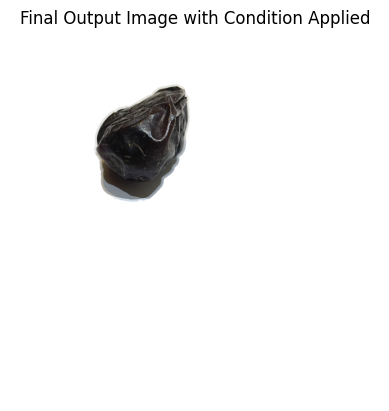

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [11]:
edge_detect_and_noise_remover_colored(imread("static/inputs/JD2007_3.jpg"), "/home/mohammed/Pictures/JD2007_3_cleaned.jpg")

Processing (1/328)0.30%: static/inputs/JD2029_7.jpg


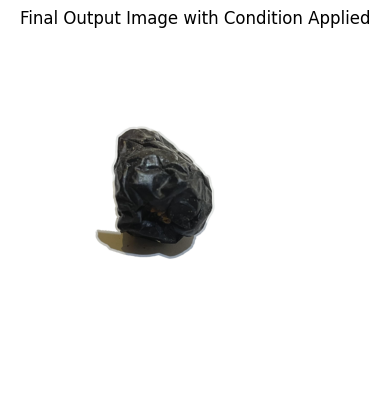

Processing (2/328)0.61%: static/inputs/JD2024_5.jpg


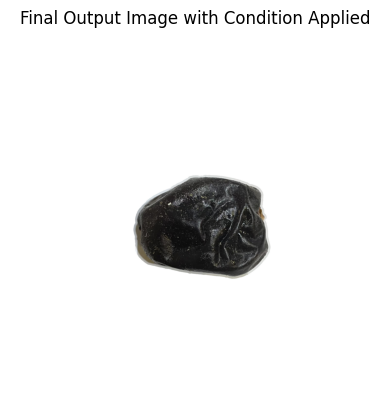

Processing (3/328)0.91%: static/inputs/JD2001_1.jpg


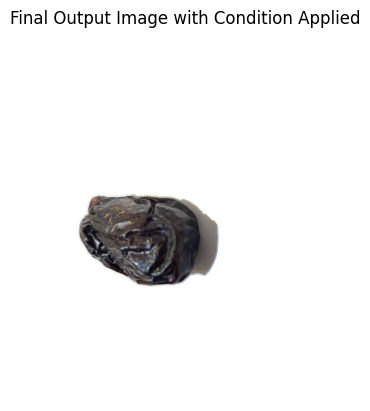

Processing (4/328)1.22%: static/inputs/JD2014_5.jpg


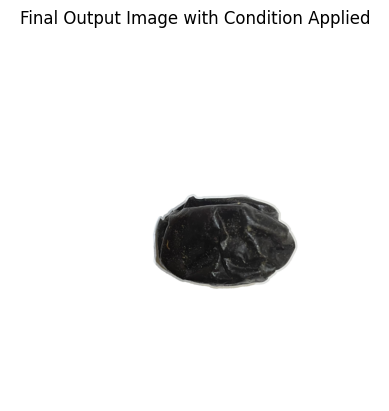

Processing (5/328)1.52%: static/inputs/JD2011_5.jpg


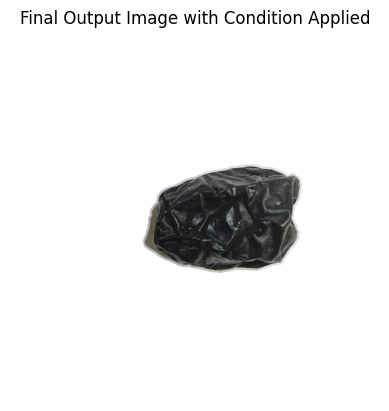

Processing (6/328)1.83%: static/inputs/JD2007_3.jpg


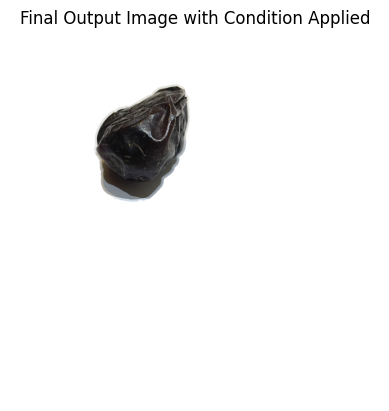

Processing (7/328)2.13%: static/inputs/JD2012_1.jpg


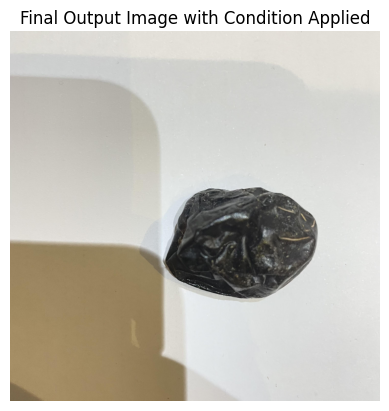

Processing (8/328)2.44%: static/inputs/JD2019_8.jpg


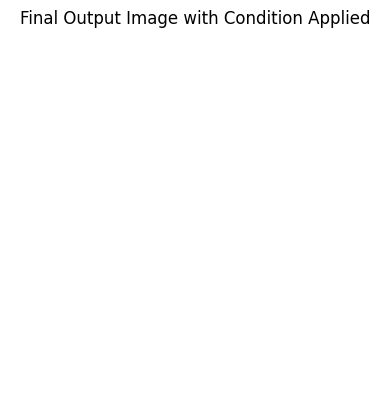

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2019_8.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (9/328)2.74%: static/inputs/JD2010_4.jpg


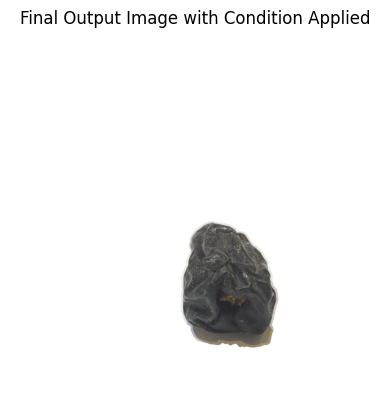

Processing (10/328)3.05%: static/inputs/JD2021_4.jpg


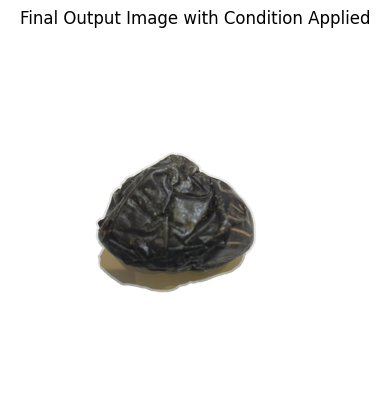

Processing (11/328)3.35%: static/inputs/JD2037_7.jpg


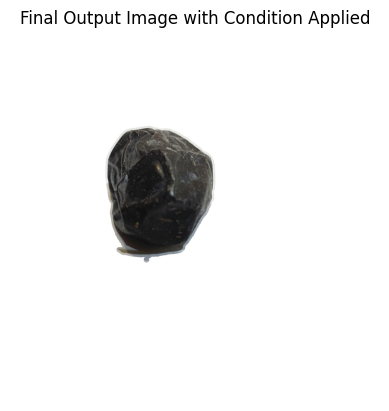

Processing (12/328)3.66%: static/inputs/JD2008_1.jpg


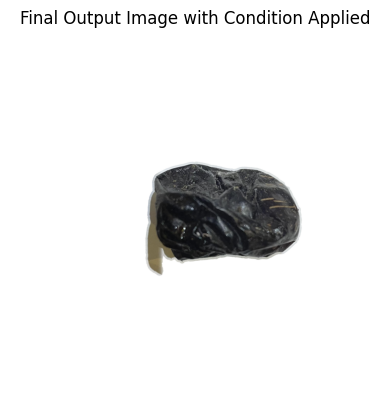

Processing (13/328)3.96%: static/inputs/JD2033_6.jpg


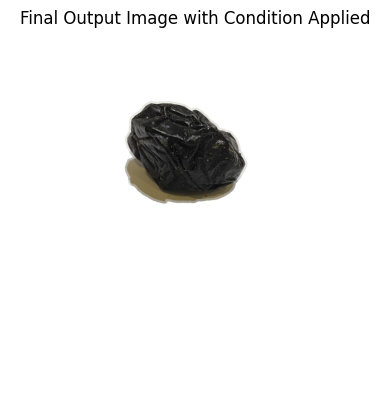

Processing (14/328)4.27%: static/inputs/JD2003_2.jpg


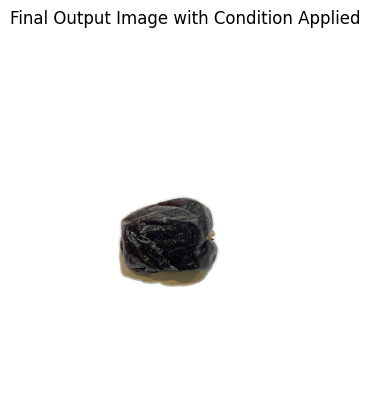

Processing (15/328)4.57%: static/inputs/JD2038_3.jpg


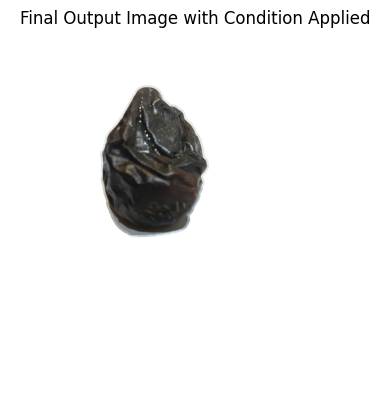

Processing (16/328)4.88%: static/inputs/JD2032_6.jpg


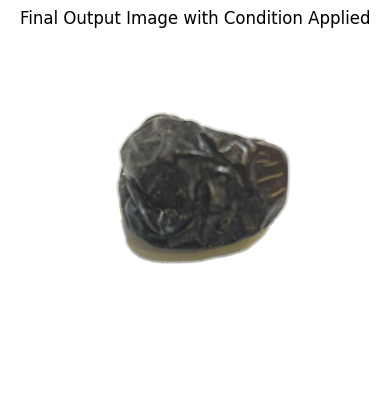

Processing (17/328)5.18%: static/inputs/JD2004_2.jpg


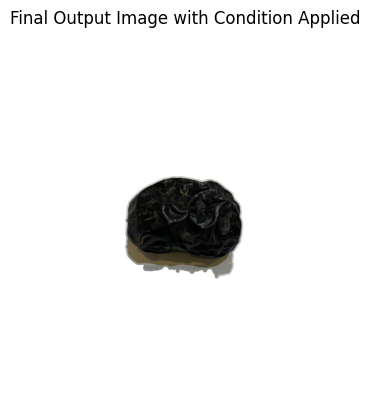

Processing (18/328)5.49%: static/inputs/JD2031_6.jpg


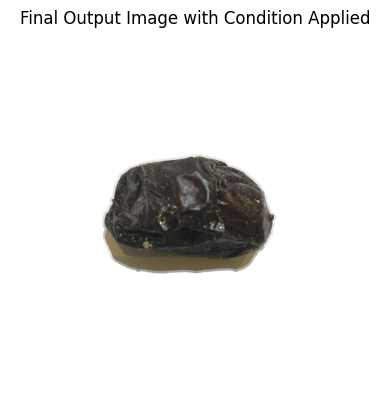

Processing (19/328)5.79%: static/inputs/JD2026_8.jpg


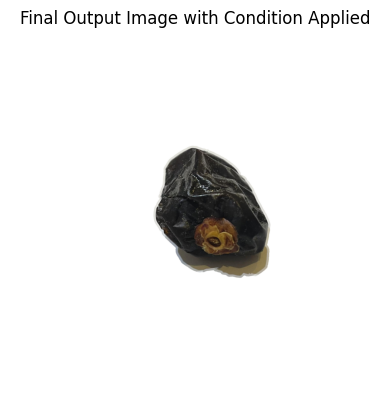

Processing (20/328)6.10%: static/inputs/JD2001_8.jpg


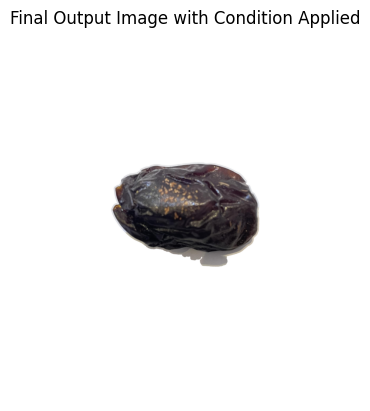

Processing (21/328)6.40%: static/inputs/JD2006_8.jpg


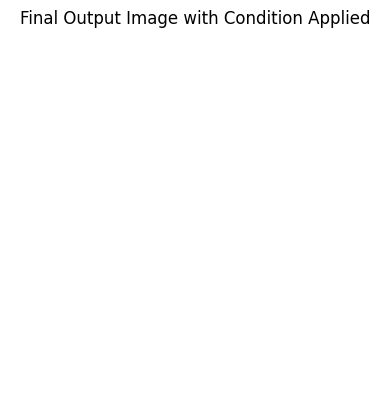

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2006_8.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (22/328)6.71%: static/inputs/JD2012_7.jpg


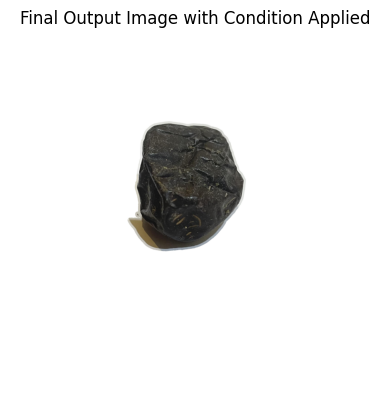

Processing (23/328)7.01%: static/inputs/JD2041_8.jpg


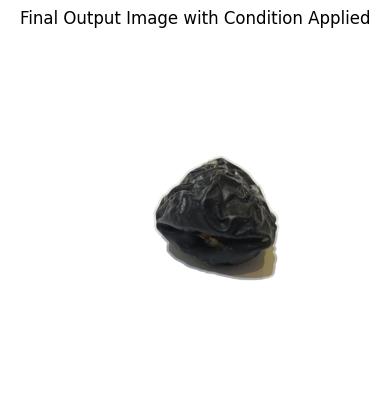

Processing (24/328)7.32%: static/inputs/JD2009_3.jpg


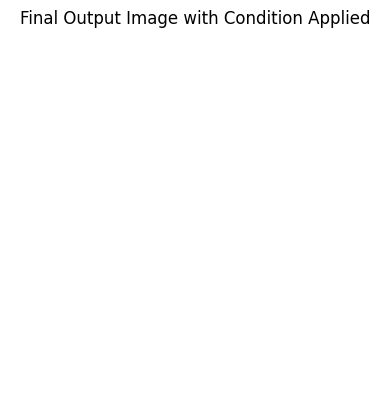

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2009_3.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (25/328)7.62%: static/inputs/JD2040_1.jpg


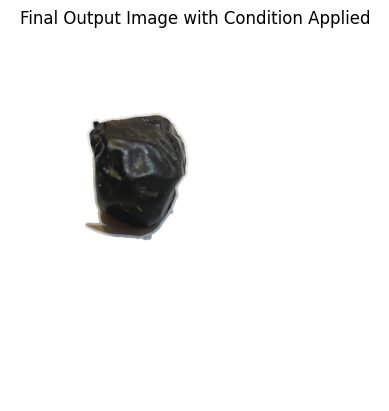

Processing (26/328)7.93%: static/inputs/JD2019_4.jpg


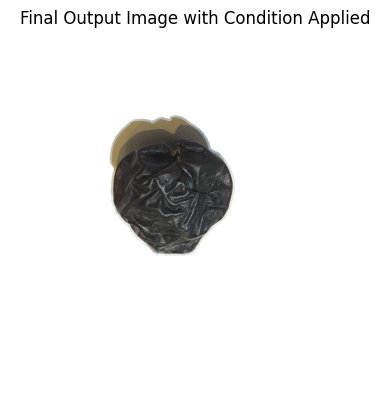

Processing (27/328)8.23%: static/inputs/JD2020_2.jpg


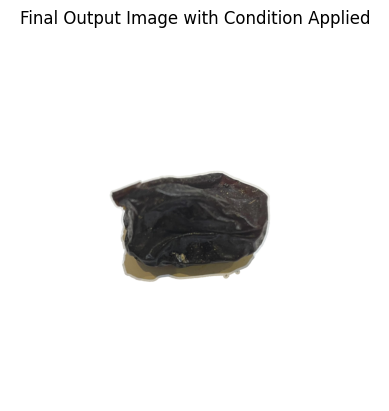

Processing (28/328)8.54%: static/inputs/JD2002_5.jpg


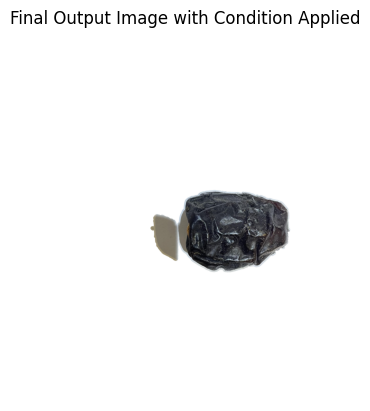

Processing (29/328)8.84%: static/inputs/JD2034_6.jpg


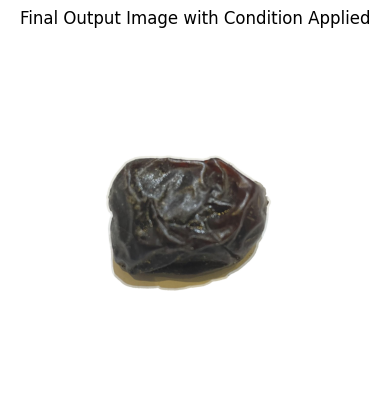

Processing (30/328)9.15%: static/inputs/JD2035_8.jpg


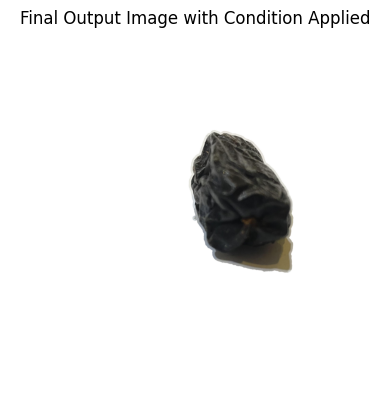

Processing (31/328)9.45%: static/inputs/JD2030_7.jpg


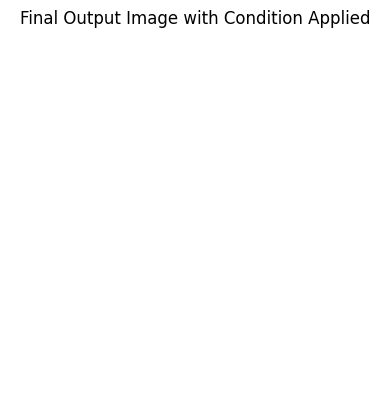

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2030_7.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (32/328)9.76%: static/inputs/JD2010_2.jpg


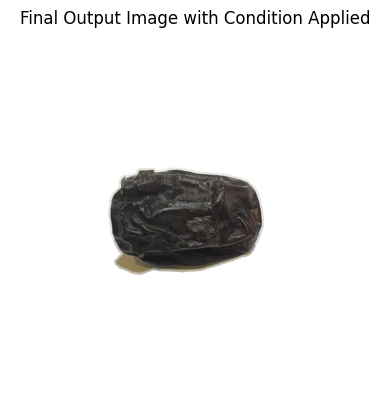

Processing (33/328)10.06%: static/inputs/JD2038_6.jpg


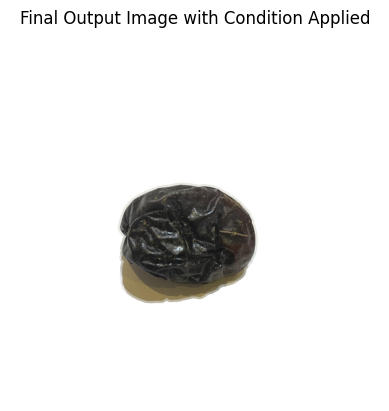

Processing (34/328)10.37%: static/inputs/JD2040_3.jpg


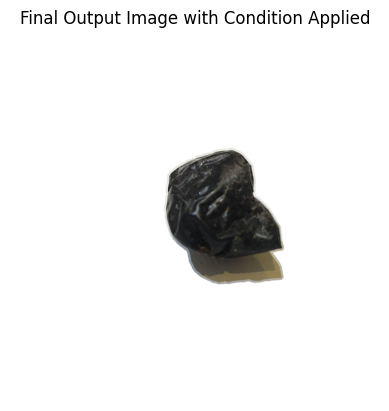

Processing (35/328)10.67%: static/inputs/JD2005_3.jpg


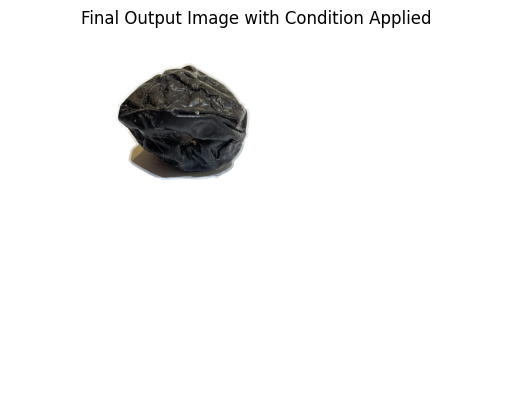

Processing (36/328)10.98%: static/inputs/JD2039_5.jpg


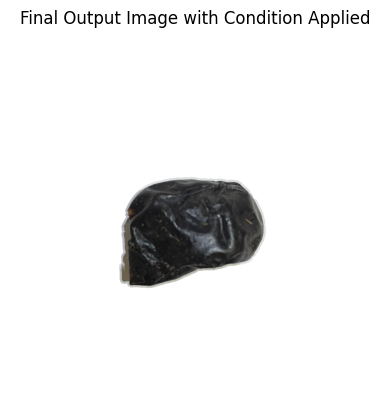

Processing (37/328)11.28%: static/inputs/JD2038_2.jpg


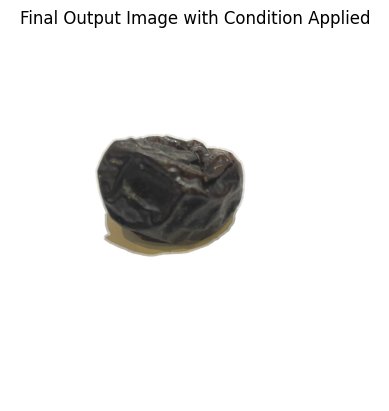

Processing (38/328)11.59%: static/inputs/JD2035_1.jpg


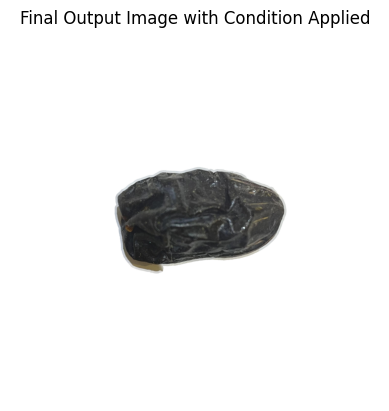

Processing (39/328)11.89%: static/inputs/JD2017_7.jpg


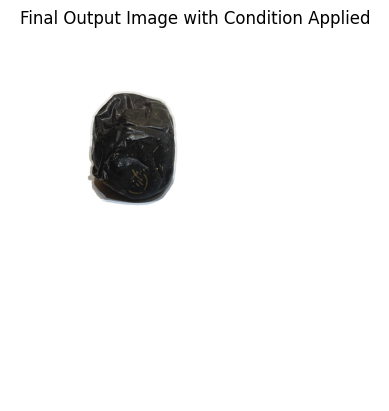

Processing (40/328)12.20%: static/inputs/JD2021_1.jpg


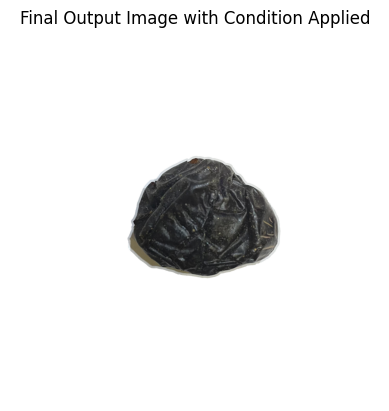

Processing (41/328)12.50%: static/inputs/JD2002_6.jpg


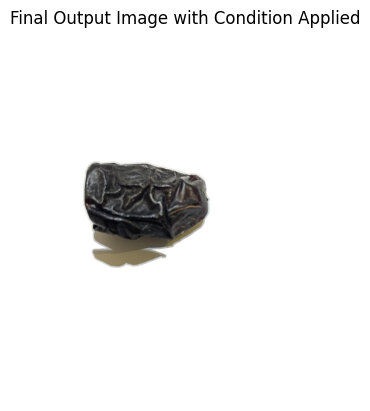

Processing (42/328)12.80%: static/inputs/JD2027_8.jpg


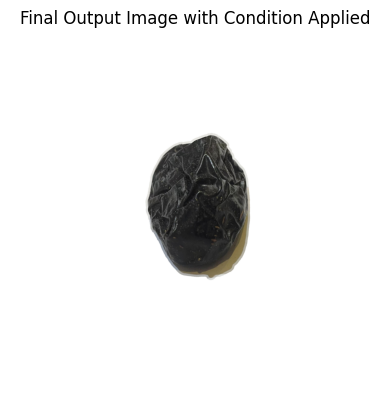

Processing (43/328)13.11%: static/inputs/JD2017_3.jpg


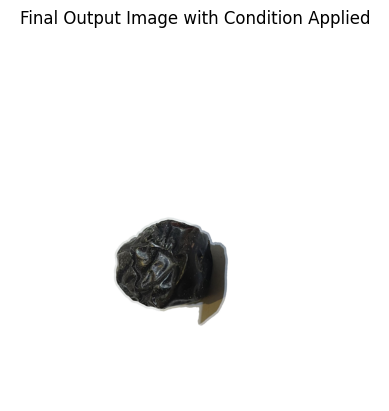

Processing (44/328)13.41%: static/inputs/JD2002_7.jpg


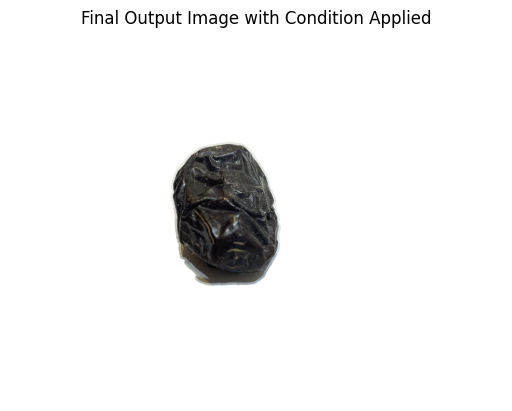

Processing (45/328)13.72%: static/inputs/JD2008_3.jpg


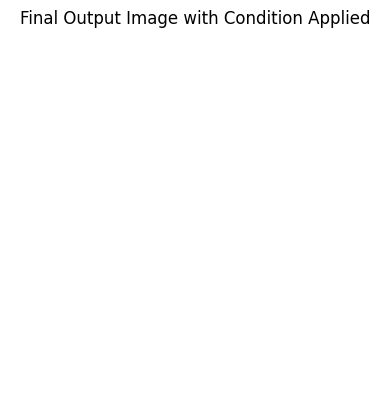

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2008_3.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (46/328)14.02%: static/inputs/JD2007_5.jpg


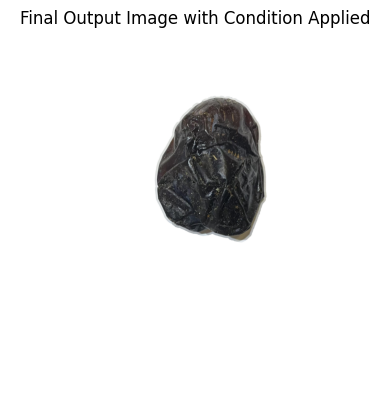

Processing (47/328)14.33%: static/inputs/JD2006_5.jpg


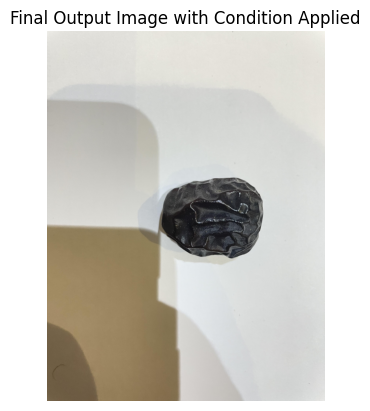

Processing (48/328)14.63%: static/inputs/JD2020_7.jpg


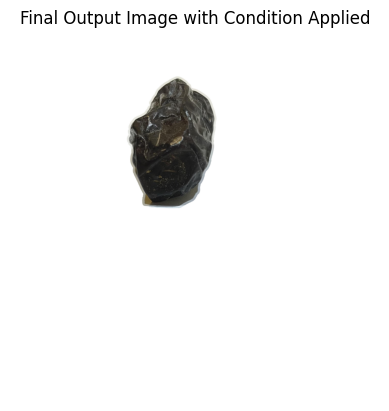

Processing (49/328)14.94%: static/inputs/JD2004_8.jpg


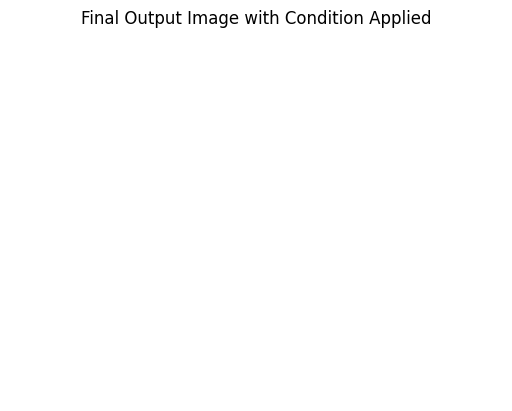

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2004_8.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (50/328)15.24%: static/inputs/JD2014_7.jpg


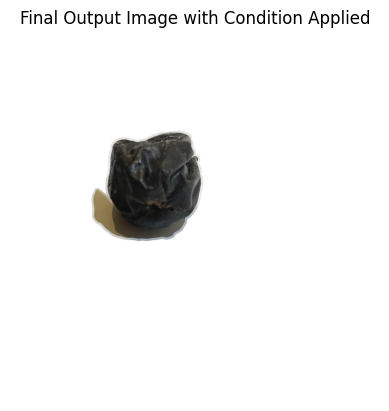

Processing (51/328)15.55%: static/inputs/JD2035_3.jpg


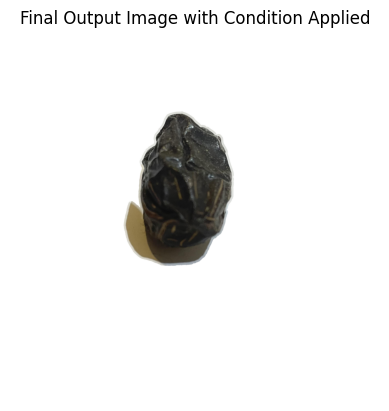

Processing (52/328)15.85%: static/inputs/JD2039_3.jpg


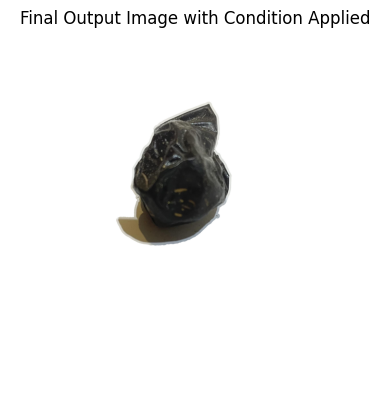

Processing (53/328)16.16%: static/inputs/JD2029_4.jpg


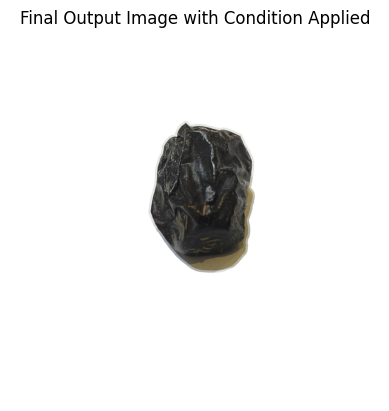

Processing (54/328)16.46%: static/inputs/JD2024_2.jpg


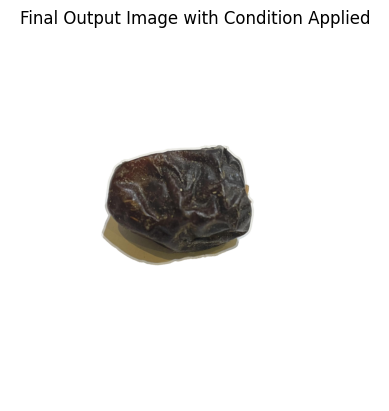

Processing (55/328)16.77%: static/inputs/JD2001_5.jpg


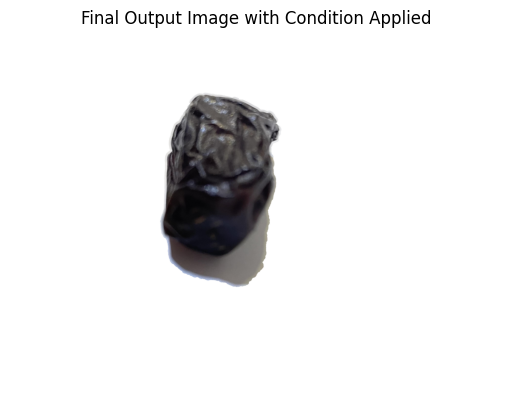

Processing (56/328)17.07%: static/inputs/JD2017_1.jpg


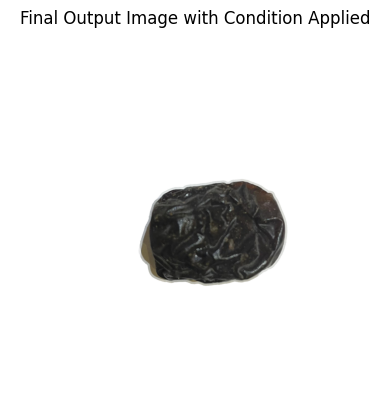

Processing (57/328)17.38%: static/inputs/JD2004_7.jpg


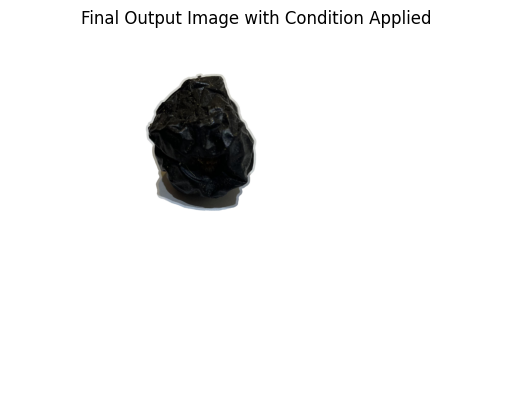

Processing (58/328)17.68%: static/inputs/JD2011_1.jpg


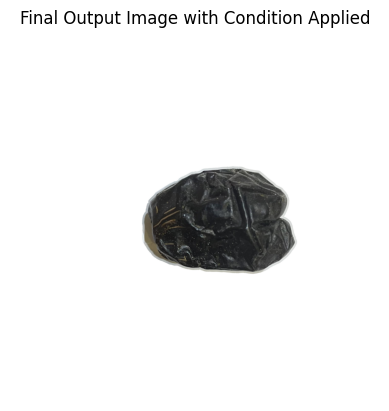

Processing (59/328)17.99%: static/inputs/JD2013_7.jpg


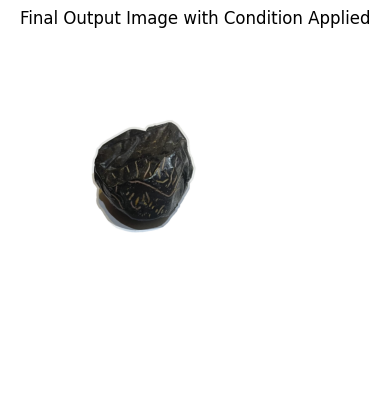

Processing (60/328)18.29%: static/inputs/JD2011_8.jpg


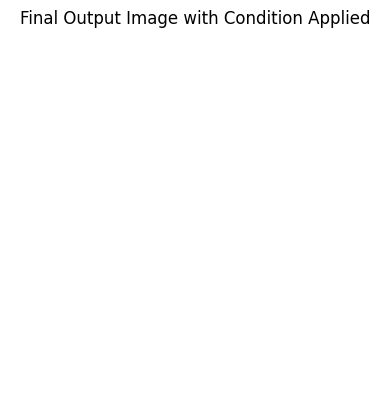

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2011_8.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (61/328)18.60%: static/inputs/JD2013_3.jpg


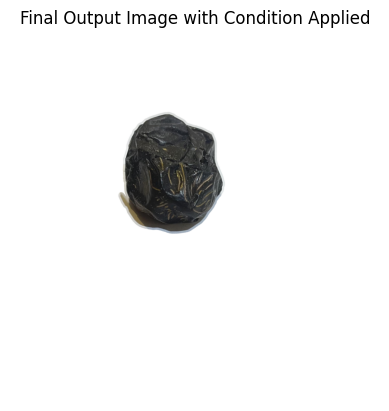

Processing (62/328)18.90%: static/inputs/JD2015_3.jpg


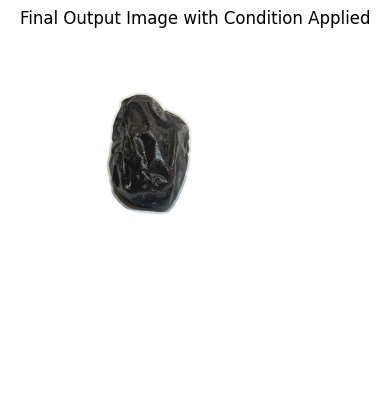

Processing (63/328)19.21%: static/inputs/JD2030_8.jpg


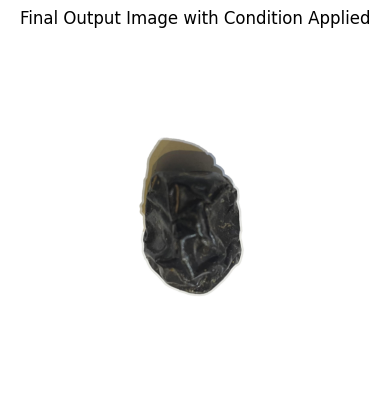

Processing (64/328)19.51%: static/inputs/JD2012_4.jpg


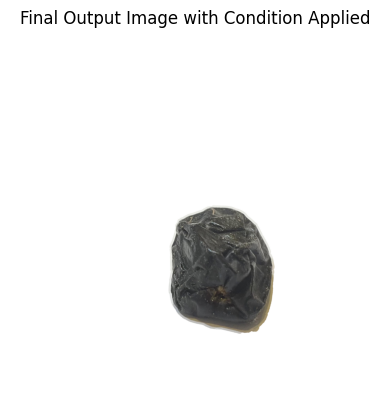

Processing (65/328)19.82%: static/inputs/JD2029_5.jpg


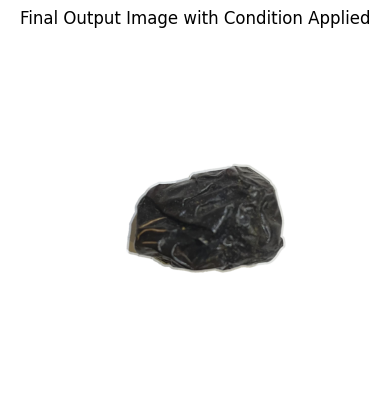

Processing (66/328)20.12%: static/inputs/JD2025_5.jpg


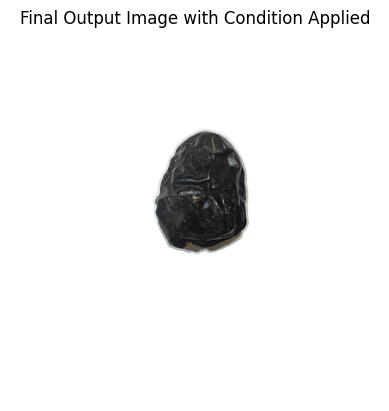

Processing (67/328)20.43%: static/inputs/JD2020_8.jpg


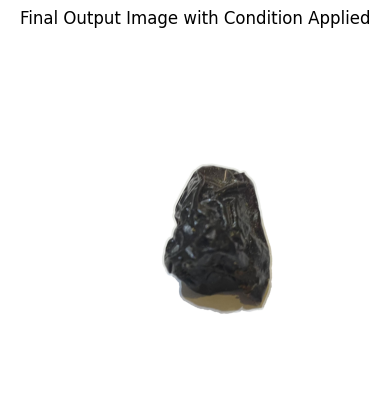

Processing (68/328)20.73%: static/inputs/JD2003_6.jpg


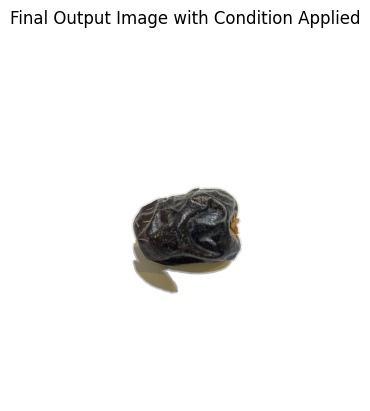

Processing (69/328)21.04%: static/inputs/JD2033_4.jpg


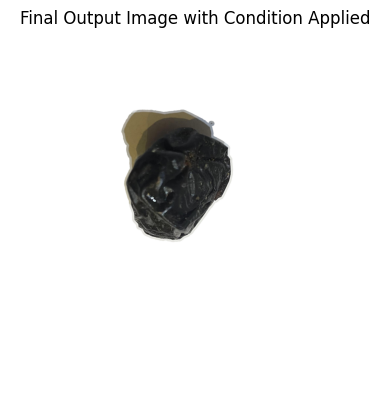

Processing (70/328)21.34%: static/inputs/JD2025_1.jpg


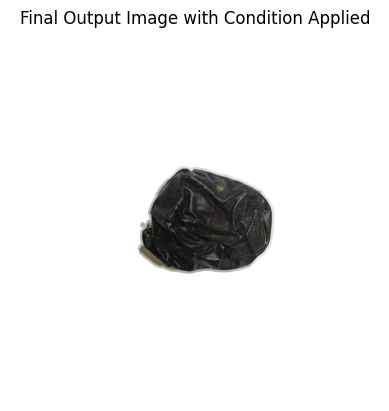

Processing (71/328)21.65%: static/inputs/JD2026_1.jpg


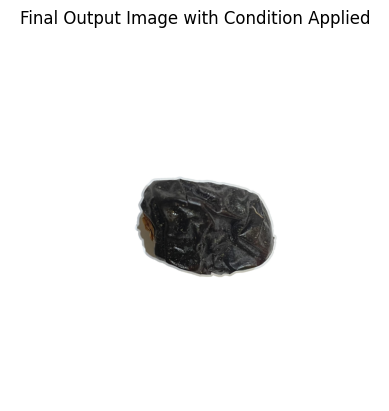

Processing (72/328)21.95%: static/inputs/JD2016_7.jpg


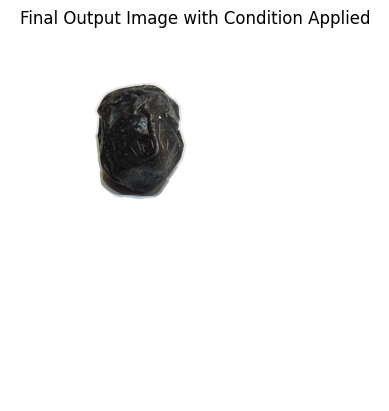

Processing (73/328)22.26%: static/inputs/JD2027_5.jpg


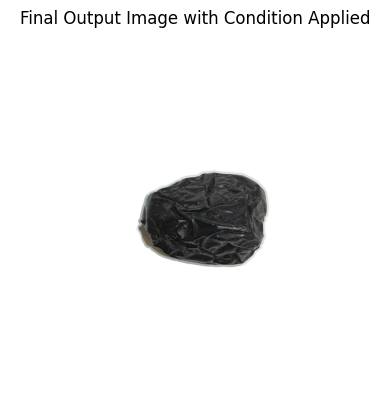

Processing (74/328)22.56%: static/inputs/JD2011_6.jpg


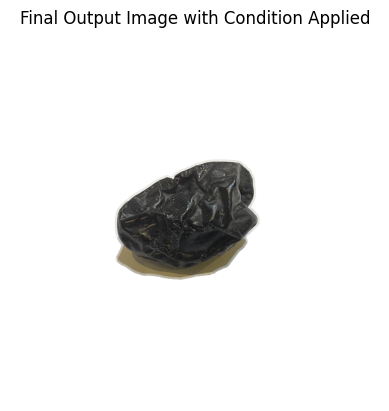

Processing (75/328)22.87%: static/inputs/JD2016_1.jpg


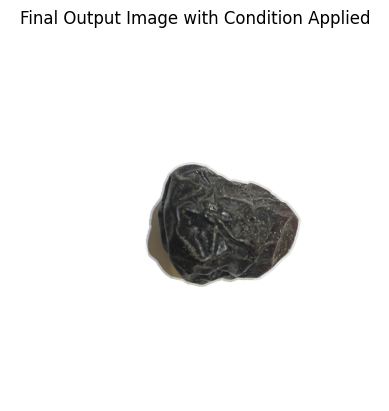

Processing (76/328)23.17%: static/inputs/JD2007_7.jpg


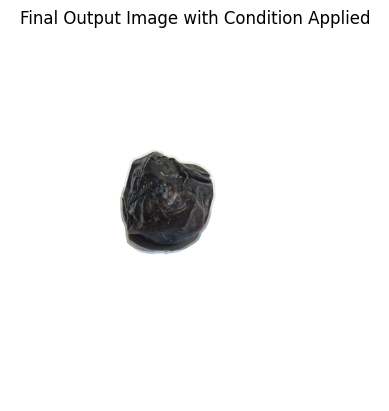

Processing (77/328)23.48%: static/inputs/JD2024_6.jpg


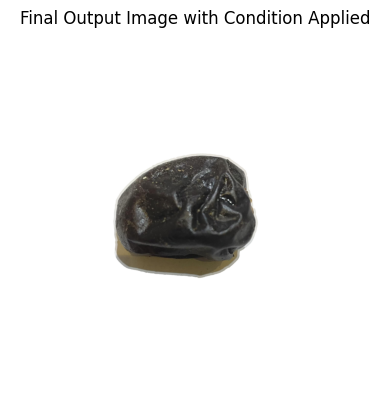

Processing (78/328)23.78%: static/inputs/JD2034_7.jpg


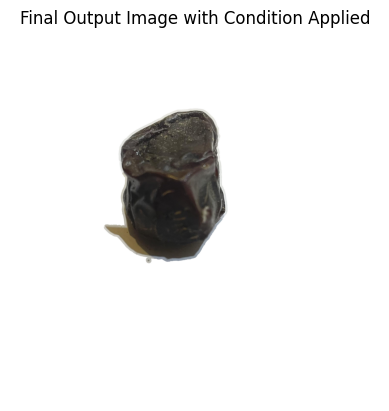

Processing (79/328)24.09%: static/inputs/JD2033_5.jpg


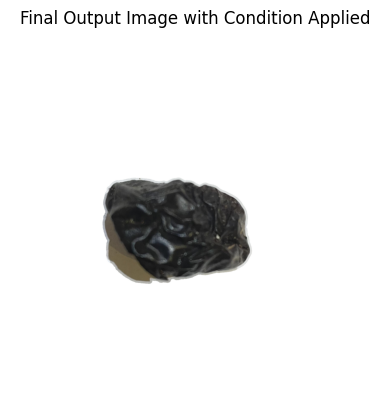

Processing (80/328)24.39%: static/inputs/JD2040_4.jpg


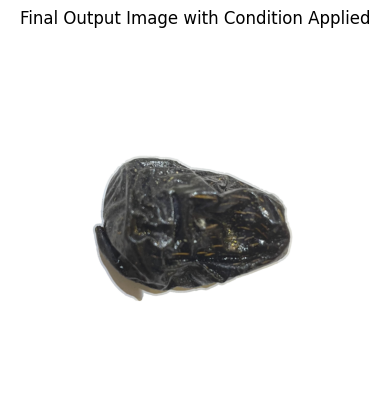

Processing (81/328)24.70%: static/inputs/JD2002_2.jpg


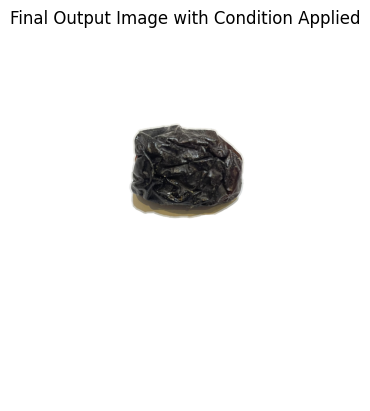

Processing (82/328)25.00%: static/inputs/JD2026_4.jpg


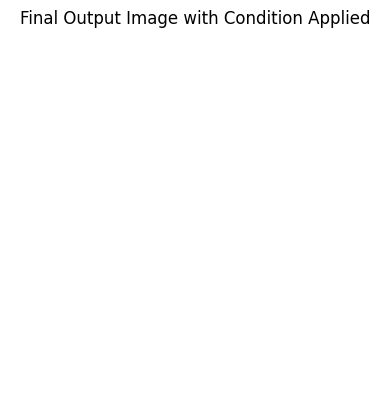

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2026_4.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (83/328)25.30%: static/inputs/JD2029_3.jpg


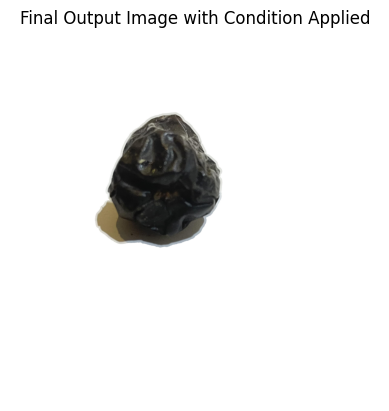

Processing (84/328)25.61%: static/inputs/JD2004_3.jpg


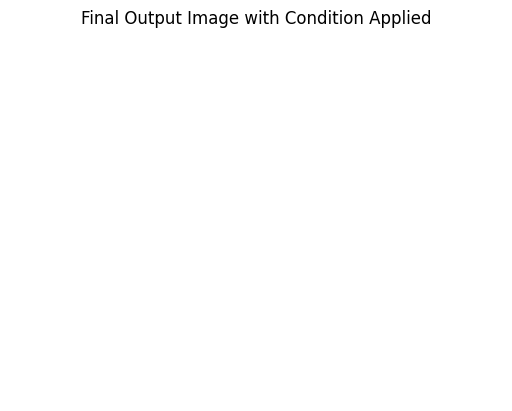

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2004_3.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (85/328)25.91%: static/inputs/JD2009_7.jpg


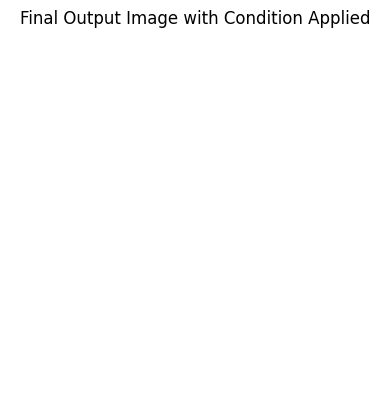

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2009_7.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (86/328)26.22%: static/inputs/JD2002_3.jpg


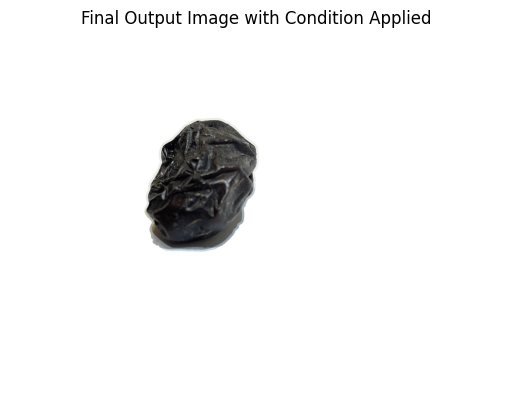

Processing (87/328)26.52%: static/inputs/JD2036_8.jpg


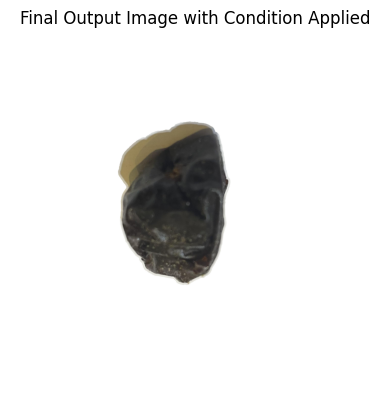

Processing (88/328)26.83%: static/inputs/JD2010_6.jpg


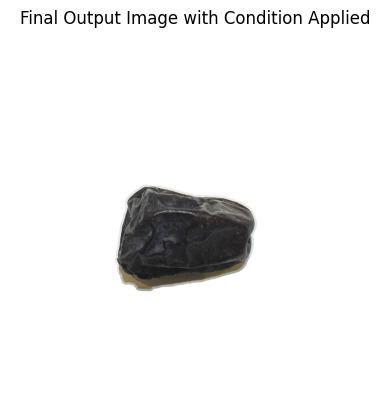

Processing (89/328)27.13%: static/inputs/JD2036_3.jpg


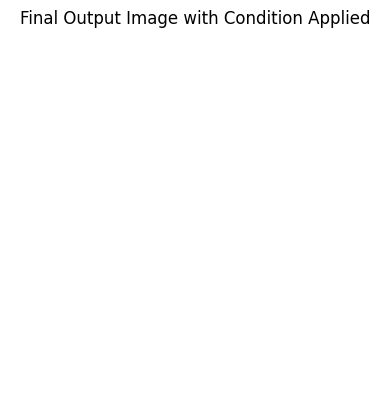

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2036_3.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (90/328)27.44%: static/inputs/JD2013_5.jpg


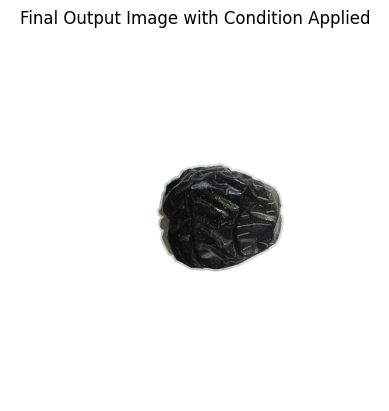

Processing (91/328)27.74%: static/inputs/JD2041_6.jpg


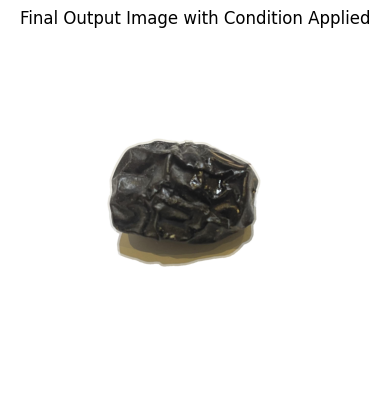

Processing (92/328)28.05%: static/inputs/JD2016_8.jpg


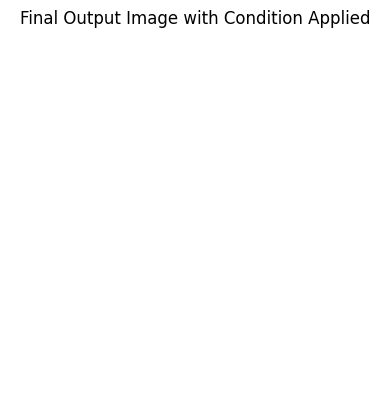

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2016_8.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (93/328)28.35%: static/inputs/JD2031_7.jpg


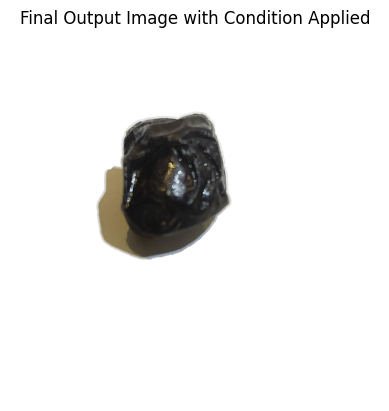

Processing (94/328)28.66%: static/inputs/JD2036_2.jpg


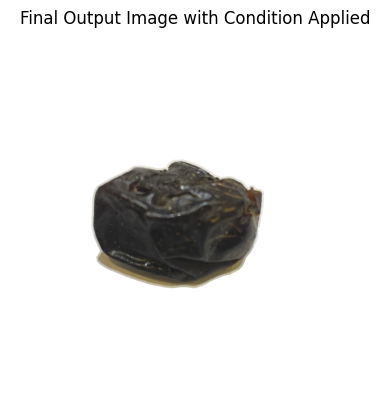

Processing (95/328)28.96%: static/inputs/JD2015_7.jpg


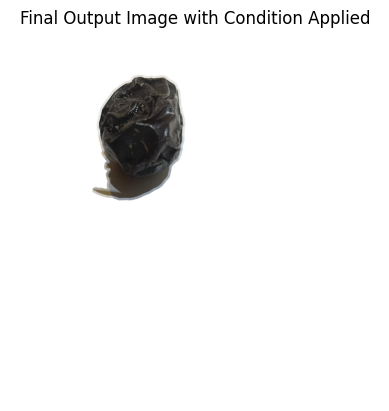

Processing (96/328)29.27%: static/inputs/JD2018_2.jpg


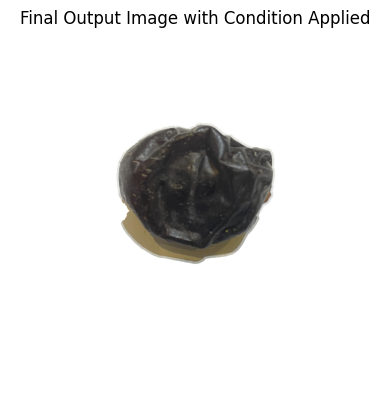

Processing (97/328)29.57%: static/inputs/JD2033_1.jpg


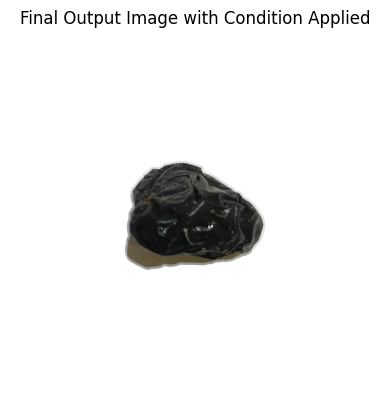

Processing (98/328)29.88%: static/inputs/JD2027_2.jpg


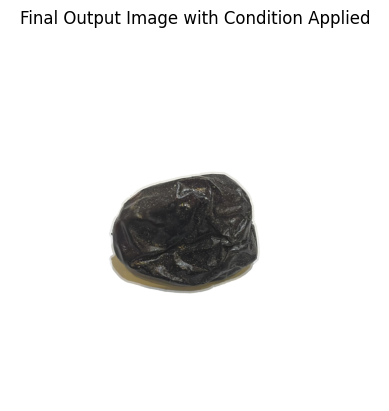

Processing (99/328)30.18%: static/inputs/JD2036_1.jpg


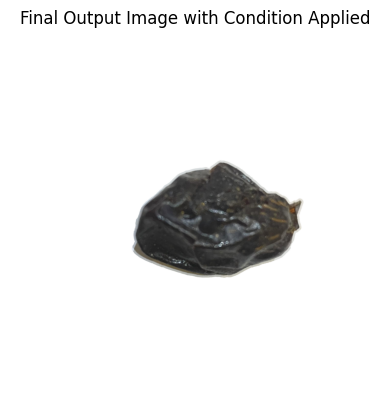

Processing (100/328)30.49%: static/inputs/JD2020_1.jpg


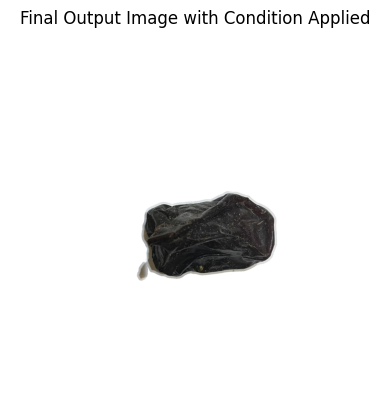

Processing (101/328)30.79%: static/inputs/JD2031_5.jpg


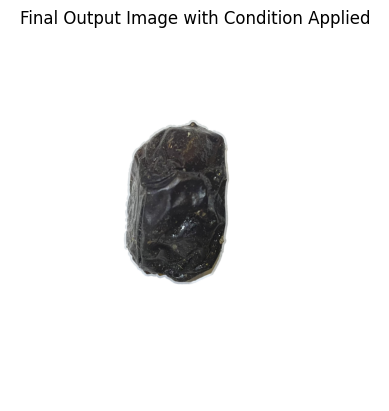

Processing (102/328)31.10%: static/inputs/JD2007_2.jpg


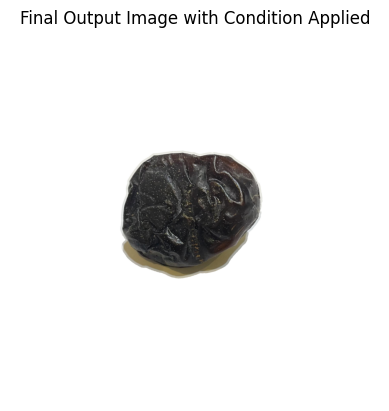

Processing (103/328)31.40%: static/inputs/JD2018_3.jpg


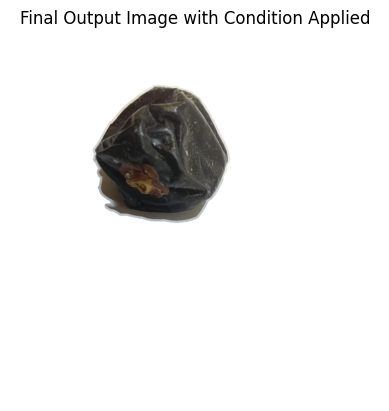

Processing (104/328)31.71%: static/inputs/JD2036_4.jpg


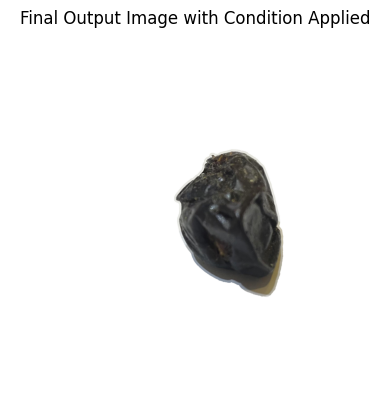

Processing (105/328)32.01%: static/inputs/JD2023_2.jpg


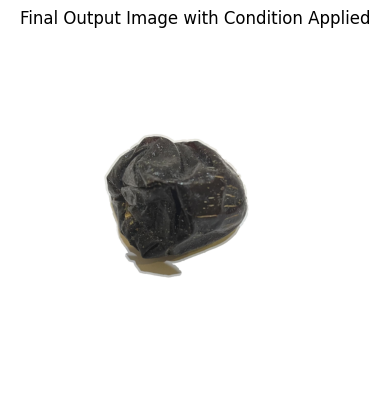

Processing (106/328)32.32%: static/inputs/JD2029_6.jpg


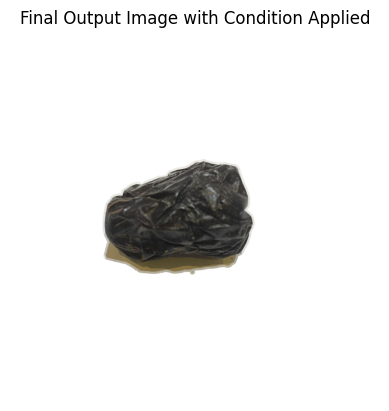

Processing (107/328)32.62%: static/inputs/JD2022_1.jpg


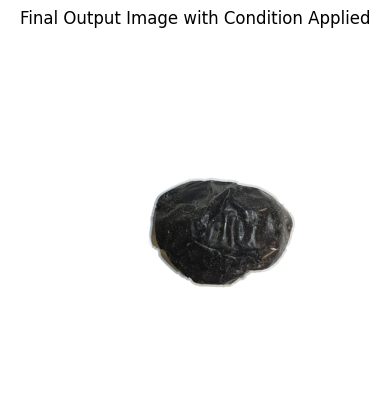

Processing (108/328)32.93%: static/inputs/JD2033_7.jpg


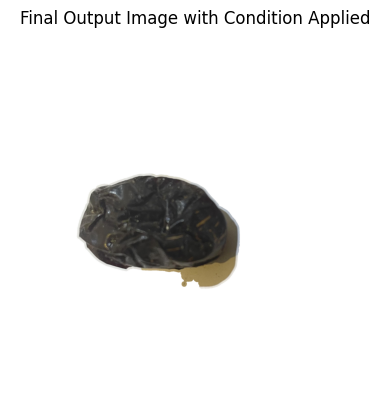

Processing (109/328)33.23%: static/inputs/JD2039_7.jpg


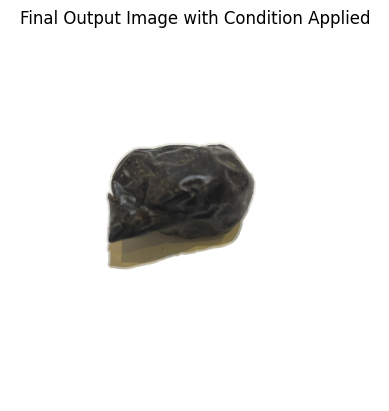

Processing (110/328)33.54%: static/inputs/JD2003_5.jpg


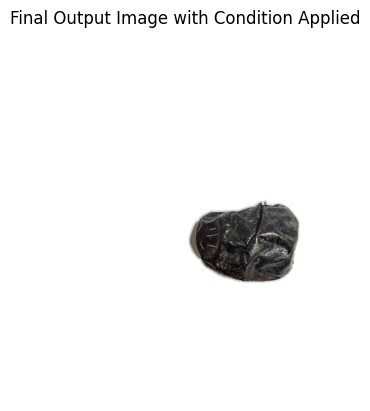

Processing (111/328)33.84%: static/inputs/JD2027_7.jpg


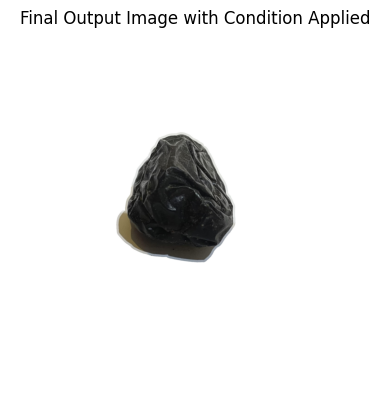

Processing (112/328)34.15%: static/inputs/JD2010_5.jpg


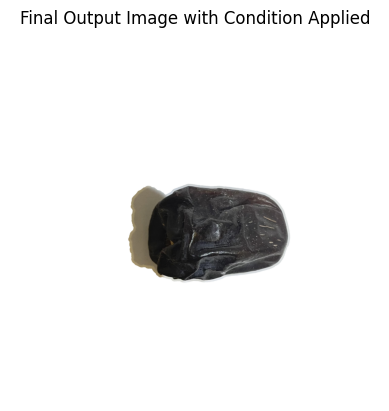

Processing (113/328)34.45%: static/inputs/JD2022_5.jpg


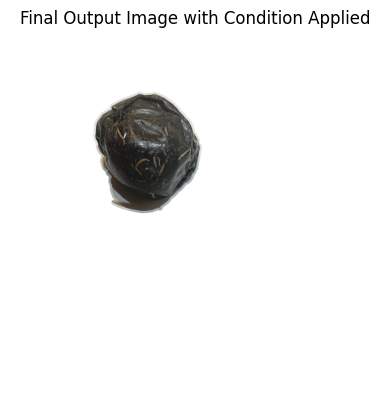

Processing (114/328)34.76%: static/inputs/JD2019_3.jpg


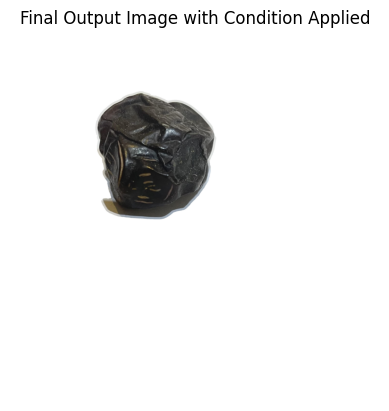

Processing (115/328)35.06%: static/inputs/JD2036_6.jpg


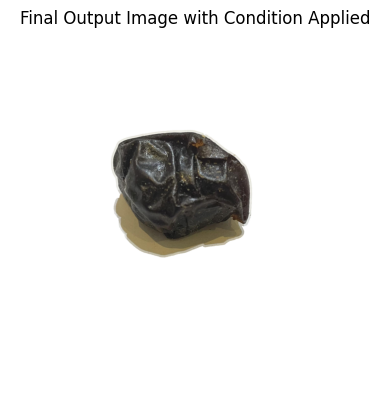

Processing (116/328)35.37%: static/inputs/JD2018_8.jpg


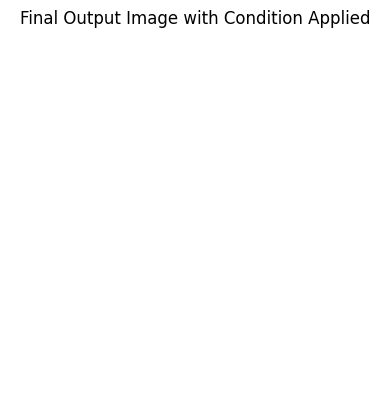

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2018_8.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (117/328)35.67%: static/inputs/JD2037_8.jpg


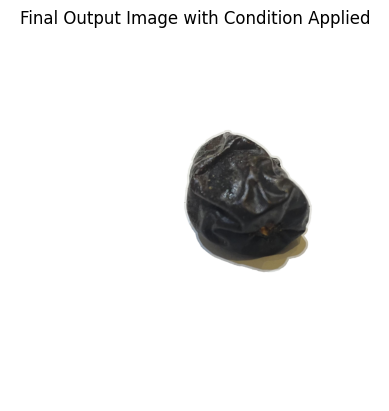

Processing (118/328)35.98%: static/inputs/JD2024_3.jpg


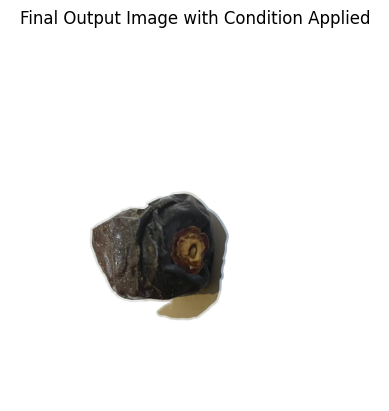

Processing (119/328)36.28%: static/inputs/JD2019_1.jpg


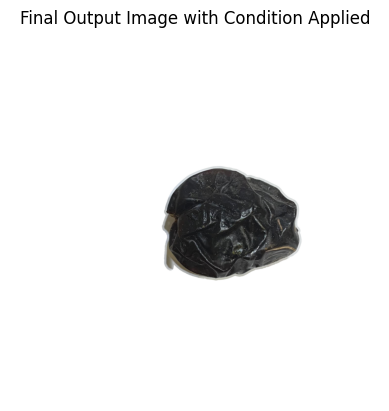

Processing (120/328)36.59%: static/inputs/JD2017_5.jpg


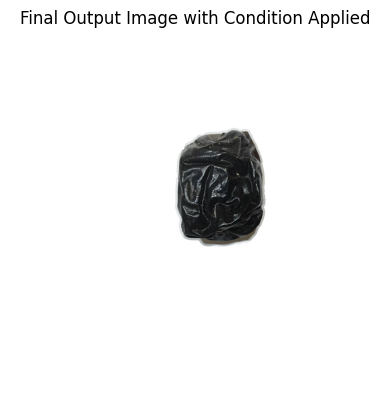

Processing (121/328)36.89%: static/inputs/JD2003_4.jpg


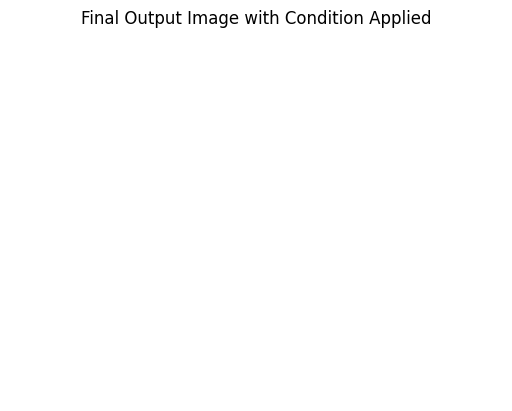

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2003_4.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (122/328)37.20%: static/inputs/JD2024_7.jpg


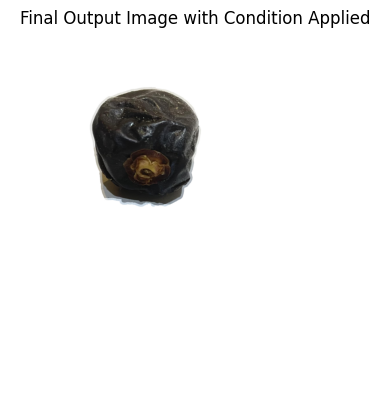

Processing (123/328)37.50%: static/inputs/JD2038_4.jpg


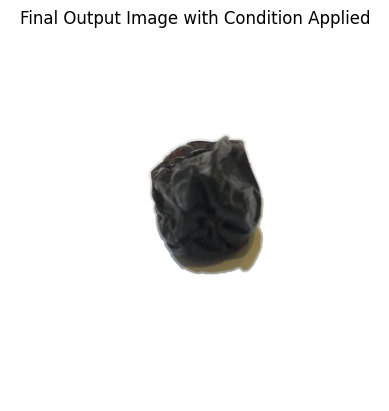

Processing (124/328)37.80%: static/inputs/JD2005_1.jpg


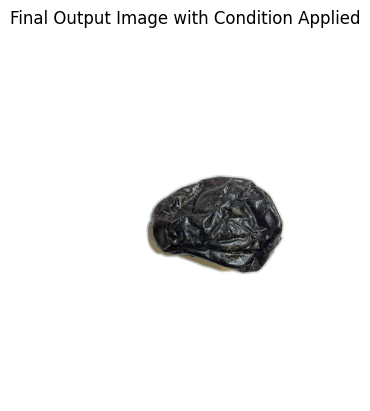

Processing (125/328)38.11%: static/inputs/JD2037_5.jpg


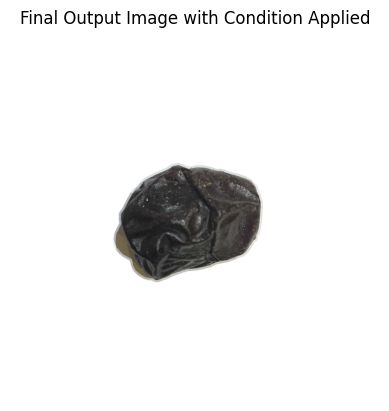

Processing (126/328)38.41%: static/inputs/JD2014_2.jpg


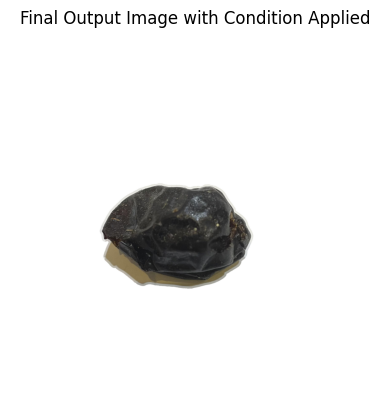

Processing (127/328)38.72%: static/inputs/JD2031_1.jpg


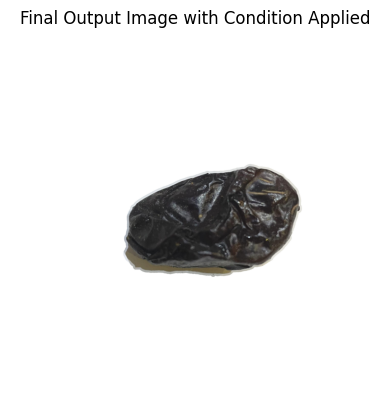

Processing (128/328)39.02%: static/inputs/JD2037_3.jpg


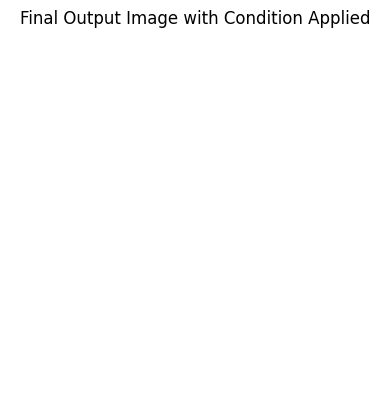

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2037_3.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (129/328)39.33%: static/inputs/JD2035_4.jpg


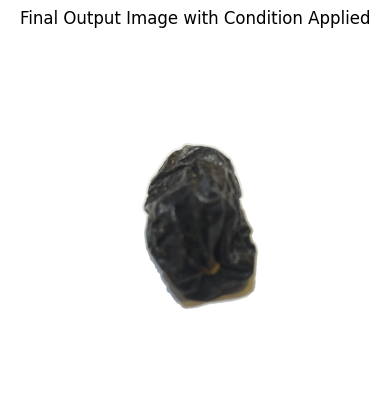

Processing (130/328)39.63%: static/inputs/JD2023_6.jpg


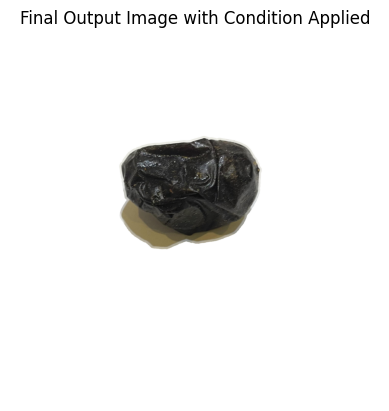

Processing (131/328)39.94%: static/inputs/JD2041_5.jpg


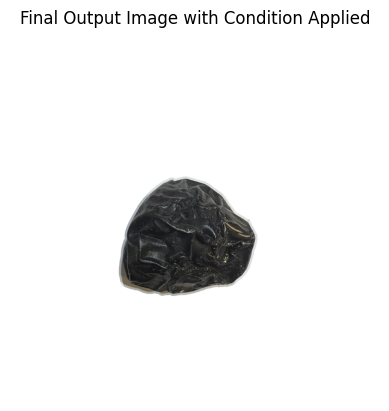

Processing (132/328)40.24%: static/inputs/JD2039_8.jpg


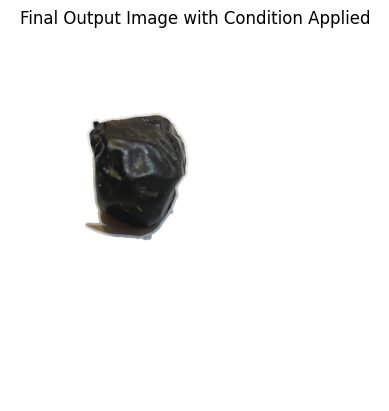

Processing (133/328)40.55%: static/inputs/JD2022_4.jpg


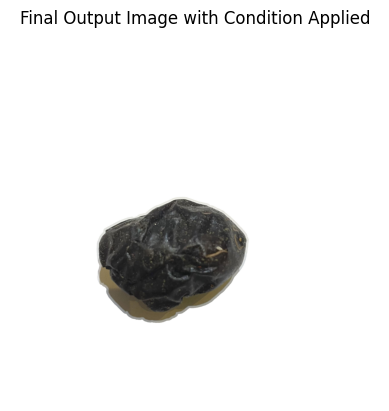

Processing (134/328)40.85%: static/inputs/JD2031_3.jpg


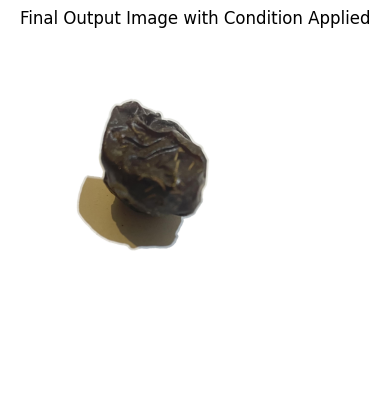

Processing (135/328)41.16%: static/inputs/JD2014_6.jpg


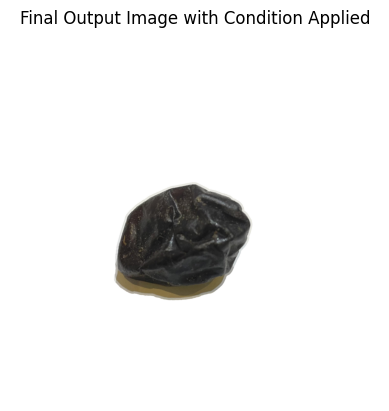

Processing (136/328)41.46%: static/inputs/JD2032_7.jpg


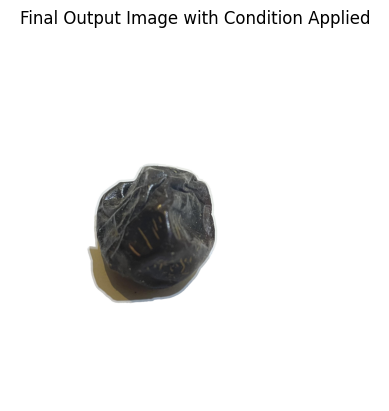

Processing (137/328)41.77%: static/inputs/JD2009_6.jpg


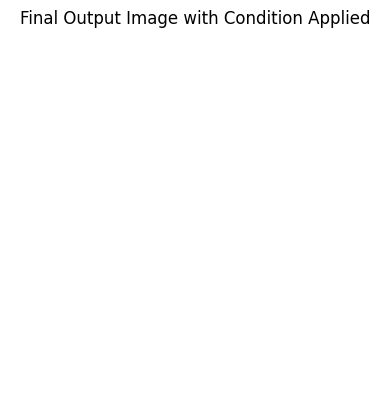

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2009_6.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (138/328)42.07%: static/inputs/JD2016_3.jpg


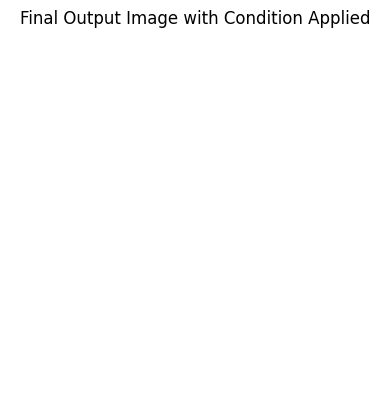

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2016_3.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (139/328)42.38%: static/inputs/JD2014_4.jpg


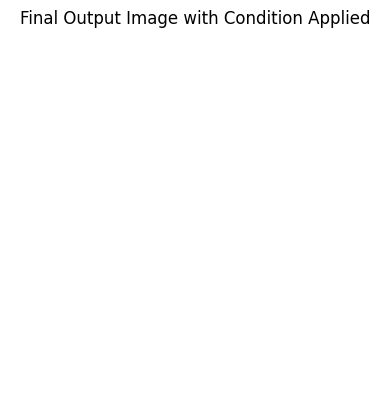

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2014_4.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (140/328)42.68%: static/inputs/JD2027_6.jpg


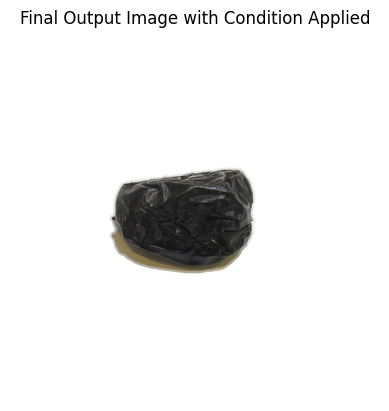

Processing (141/328)42.99%: static/inputs/JD2025_6.jpg


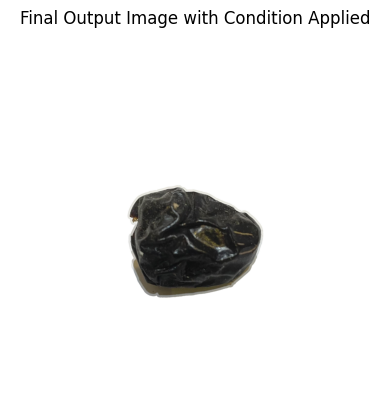

Processing (142/328)43.29%: static/inputs/JD2015_2.jpg


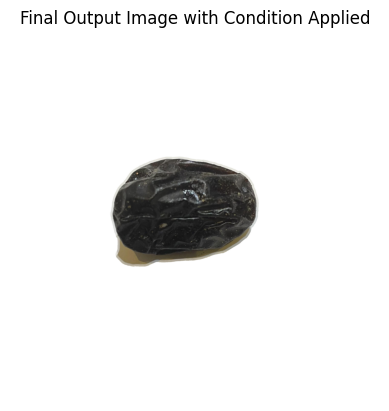

Processing (143/328)43.60%: static/inputs/JD2024_4.jpg


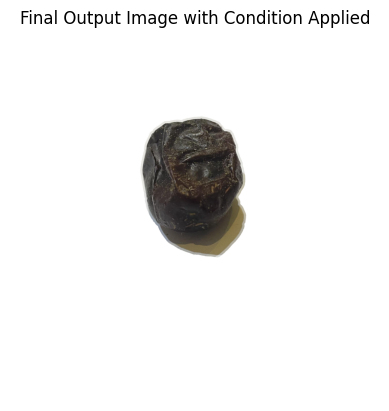

Processing (144/328)43.90%: static/inputs/JD2015_8.jpg


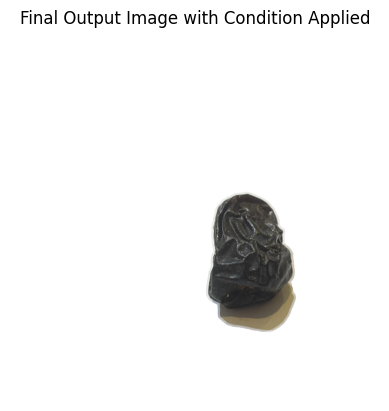

Processing (145/328)44.21%: static/inputs/JD2022_8.jpg


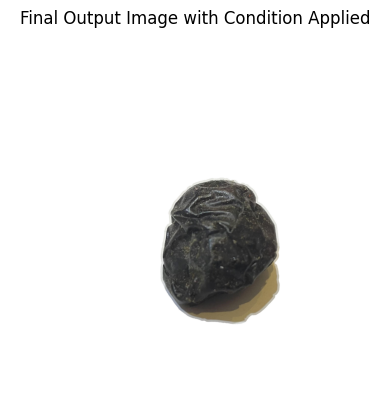

Processing (146/328)44.51%: static/inputs/JD2029_1.jpg


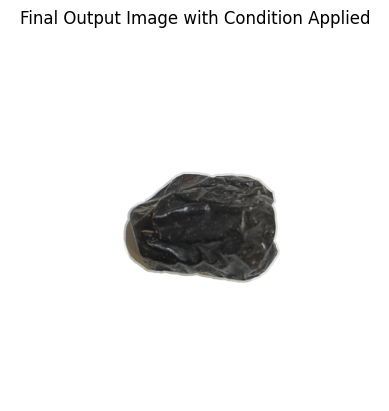

Processing (147/328)44.82%: static/inputs/JD2012_3.jpg


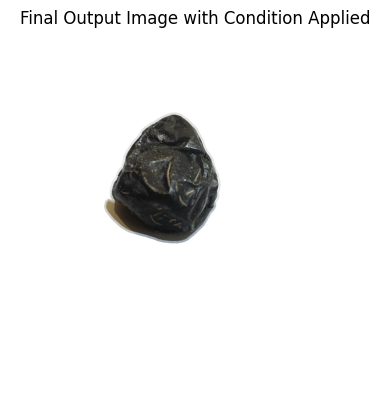

Processing (148/328)45.12%: static/inputs/JD2015_6.jpg


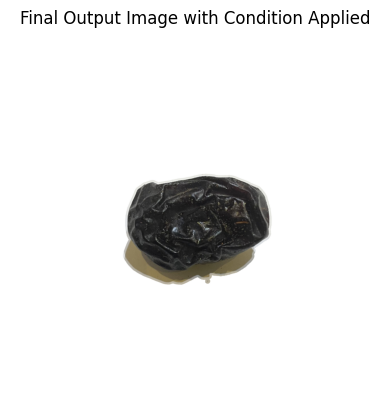

Processing (149/328)45.43%: static/inputs/JD2011_3.jpg


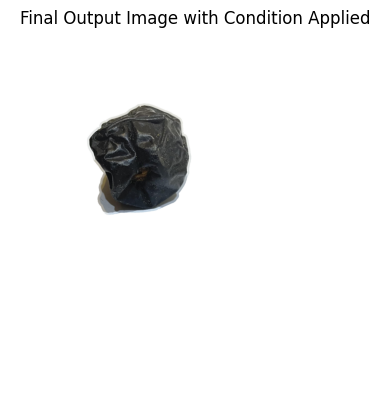

Processing (150/328)45.73%: static/inputs/JD2030_4.jpg


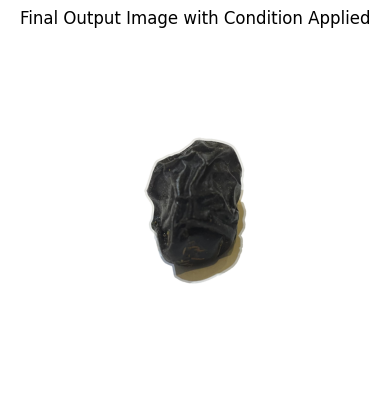

Processing (151/328)46.04%: static/inputs/JD2016_6.jpg


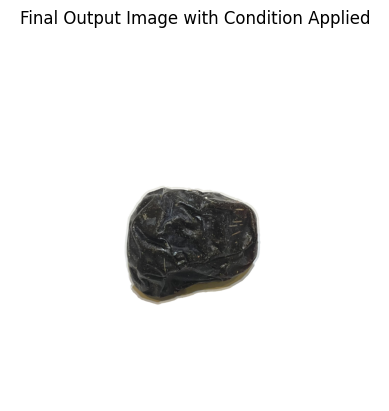

Processing (152/328)46.34%: static/inputs/JD2003_8.jpg


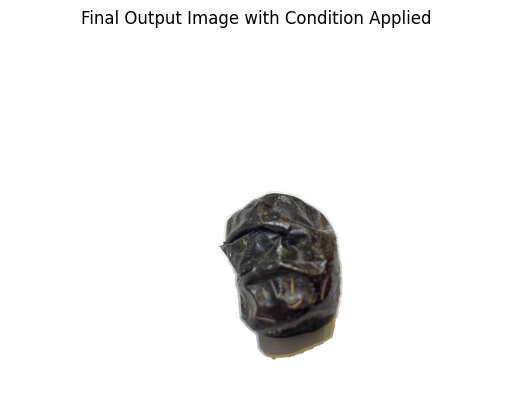

Processing (153/328)46.65%: static/inputs/JD2030_5.jpg


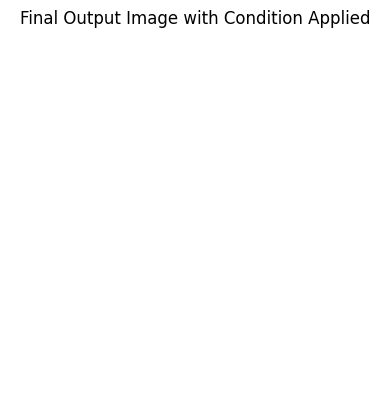

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2030_5.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (154/328)46.95%: static/inputs/JD2006_2.jpg


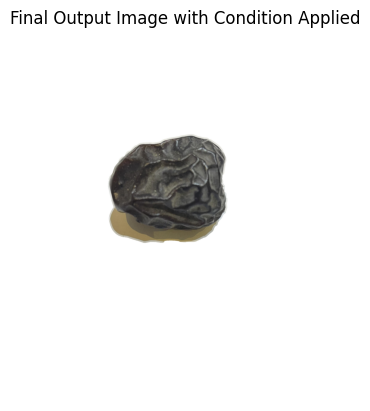

Processing (155/328)47.26%: static/inputs/JD2025_4.jpg


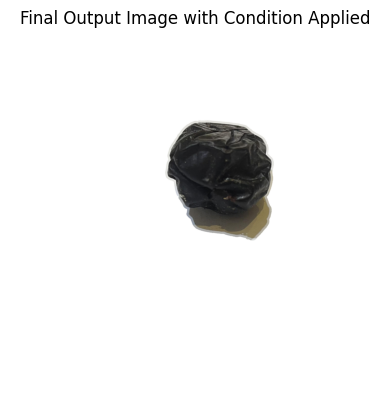

Processing (156/328)47.56%: static/inputs/JD2024_1.jpg


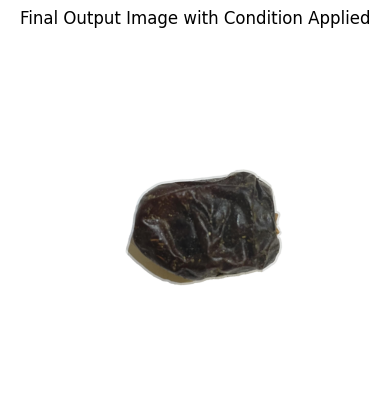

Processing (157/328)47.87%: static/inputs/JD2035_6.jpg


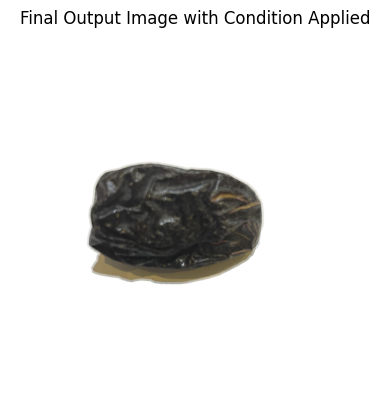

Processing (158/328)48.17%: static/inputs/JD2025_8.jpg


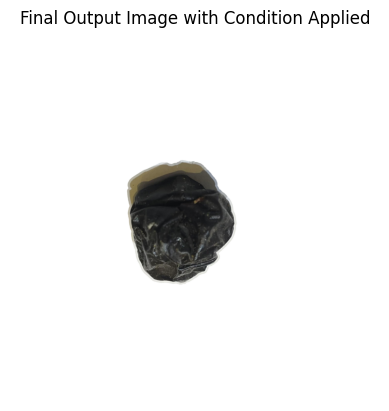

Processing (159/328)48.48%: static/inputs/JD2027_3.jpg


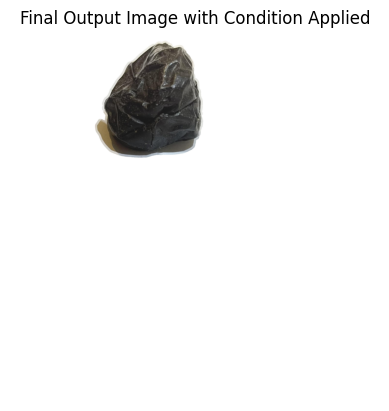

Processing (160/328)48.78%: static/inputs/JD2017_4.jpg


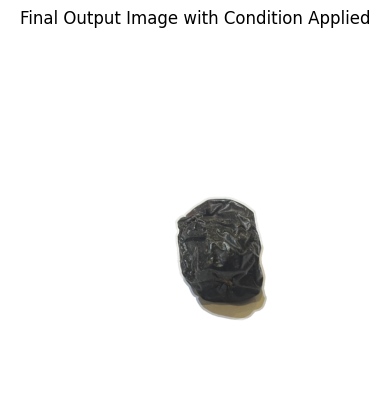

Processing (161/328)49.09%: static/inputs/JD2001_4.jpg


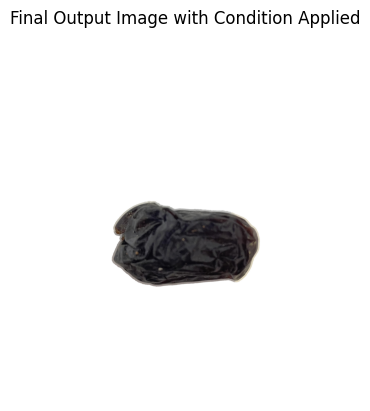

Processing (162/328)49.39%: static/inputs/JD2006_4.jpg


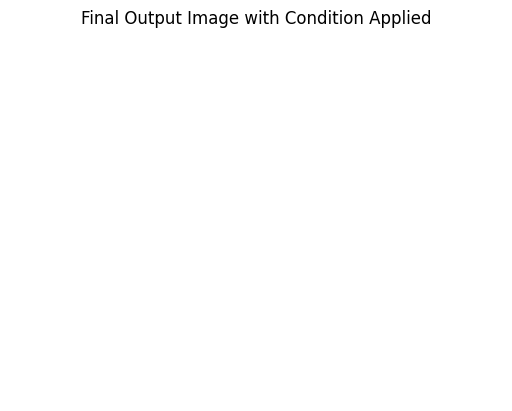

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2006_4.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (163/328)49.70%: static/inputs/JD2012_5.jpg


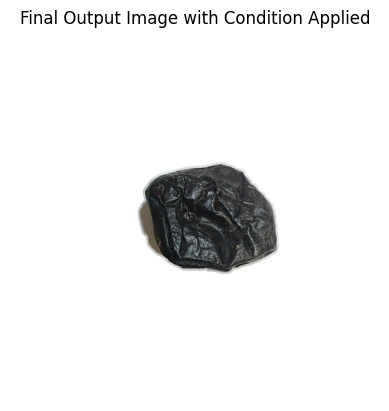

Processing (164/328)50.00%: static/inputs/JD2026_3.jpg


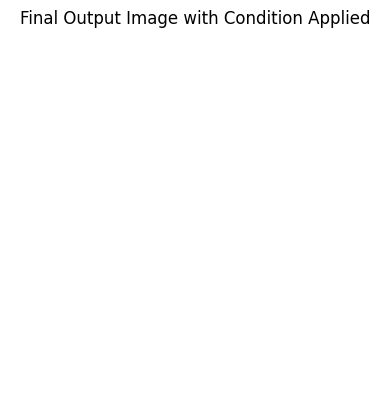

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2026_3.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (165/328)50.30%: static/inputs/JD2022_3.jpg


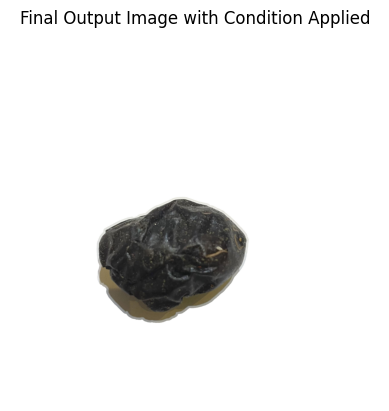

Processing (166/328)50.61%: static/inputs/JD2026_6.jpg


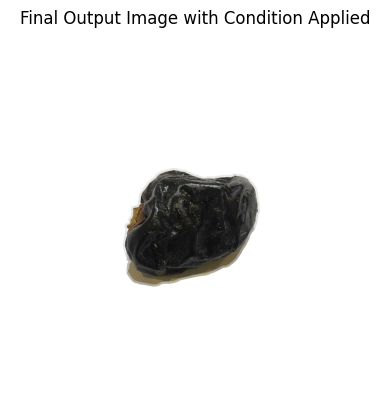

Processing (167/328)50.91%: static/inputs/JD2017_8.jpg


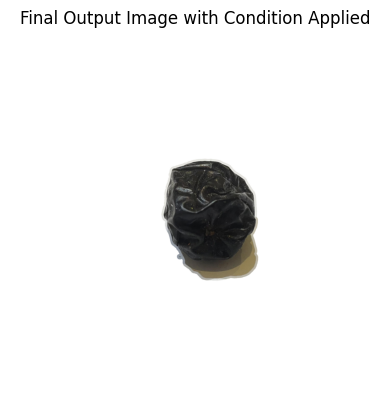

Processing (168/328)51.22%: static/inputs/JD2021_6.jpg


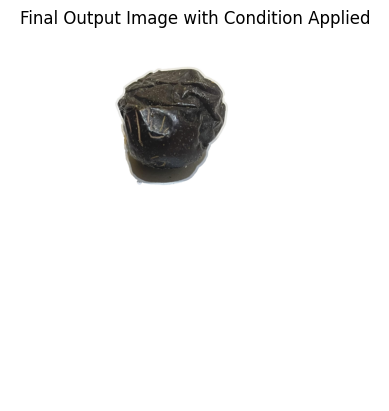

Processing (169/328)51.52%: static/inputs/JD2039_1.jpg


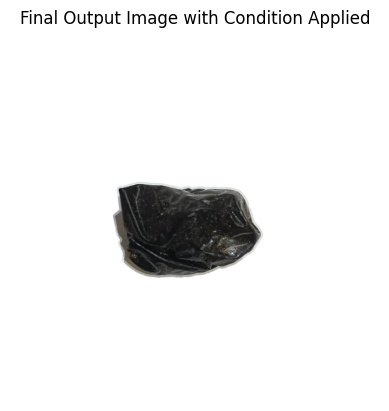

Processing (170/328)51.83%: static/inputs/JD2005_7.jpg


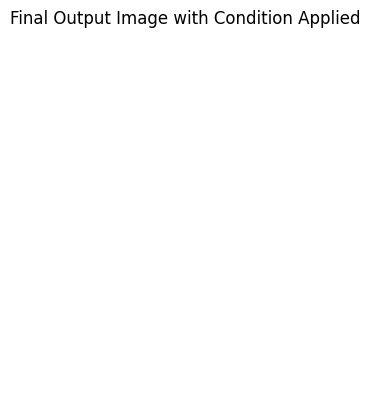

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2005_7.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (171/328)52.13%: static/inputs/JD2004_1.jpg


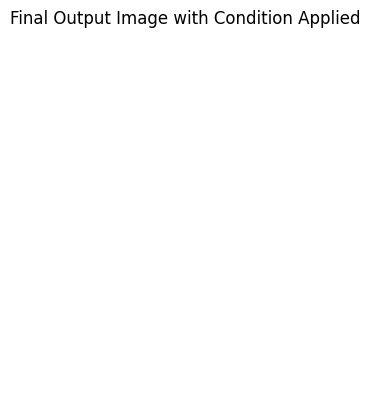

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2004_1.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (172/328)52.44%: static/inputs/JD2031_4.jpg


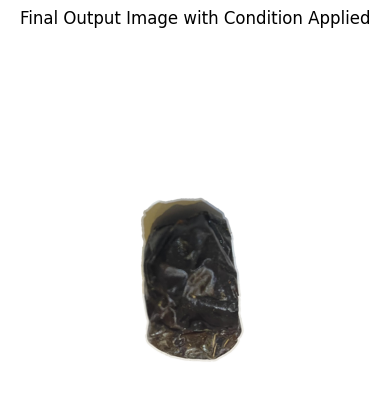

Processing (173/328)52.74%: static/inputs/JD2037_1.jpg


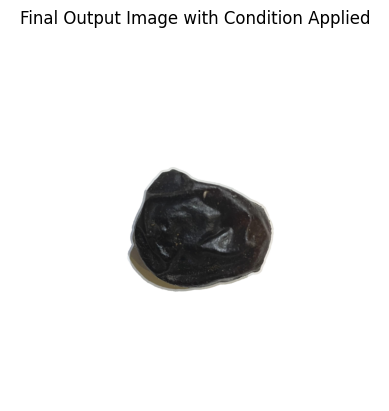

Processing (174/328)53.05%: static/inputs/JD2034_3.jpg


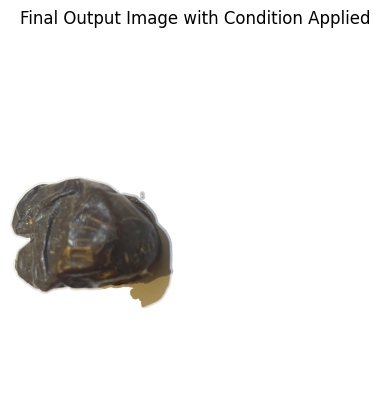

Processing (175/328)53.35%: static/inputs/JD2010_1.jpg


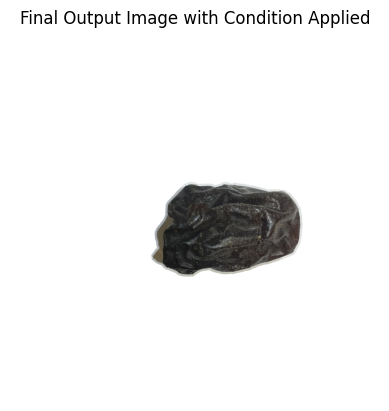

Processing (176/328)53.66%: static/inputs/JD2032_4.jpg


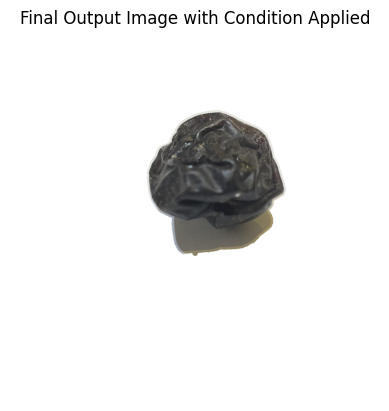

Processing (177/328)53.96%: static/inputs/JD2021_3.jpg


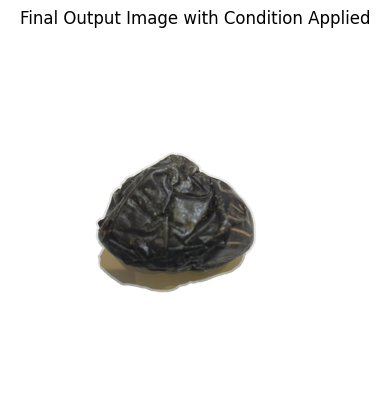

Processing (178/328)54.27%: static/inputs/JD2021_2.jpg


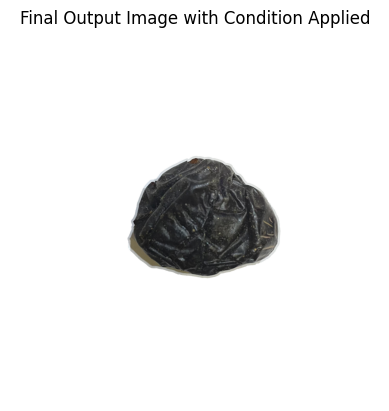

Processing (179/328)54.57%: static/inputs/JD2026_5.jpg


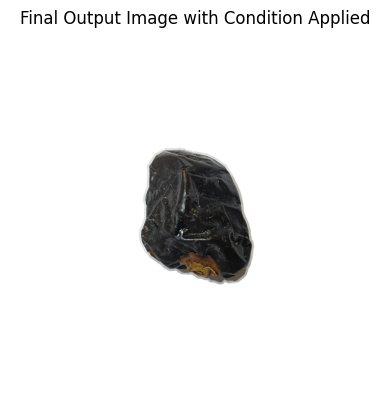

Processing (180/328)54.88%: static/inputs/JD2011_7.jpg


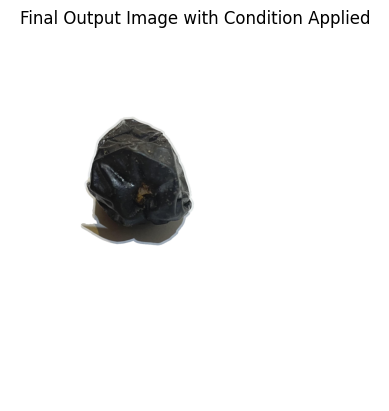

Processing (181/328)55.18%: static/inputs/JD2016_5.jpg


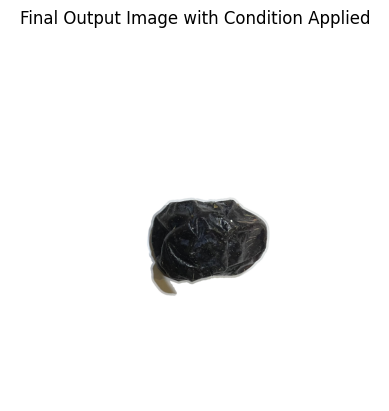

Processing (182/328)55.49%: static/inputs/JD2038_8.jpg


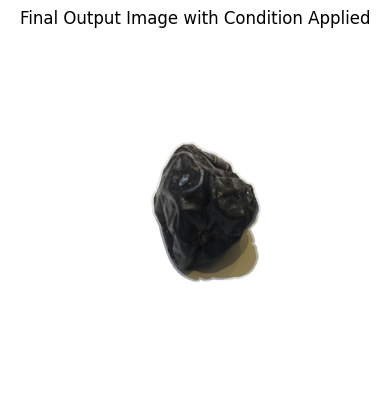

Processing (183/328)55.79%: static/inputs/JD2009_1.jpg


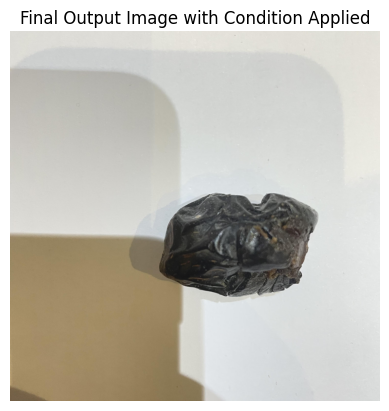

Processing (184/328)56.10%: static/inputs/JD2021_8.jpg


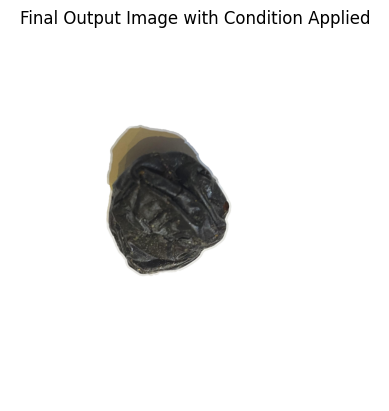

Processing (185/328)56.40%: static/inputs/JD2036_7.jpg


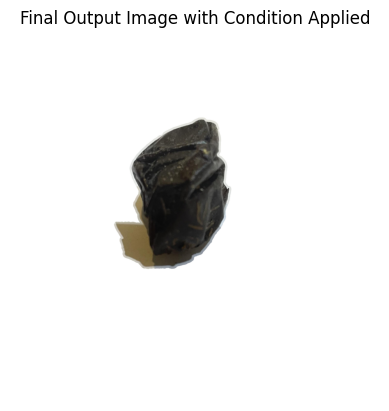

Processing (186/328)56.71%: static/inputs/JD2033_3.jpg


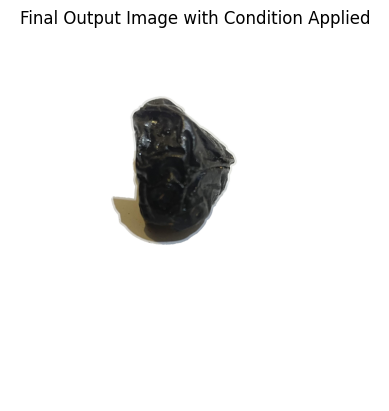

Processing (187/328)57.01%: static/inputs/JD2018_6.jpg


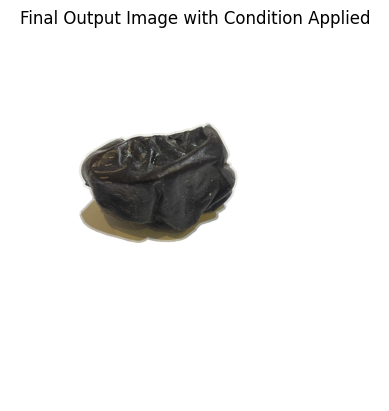

Processing (188/328)57.32%: static/inputs/JD2038_5.jpg


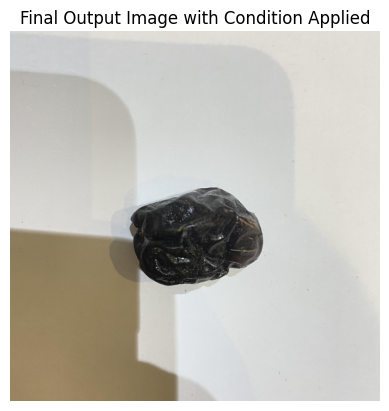

Processing (189/328)57.62%: static/inputs/JD2025_3.jpg


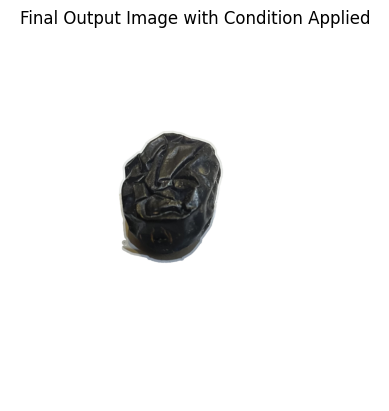

Processing (190/328)57.93%: static/inputs/JD2040_6.jpg


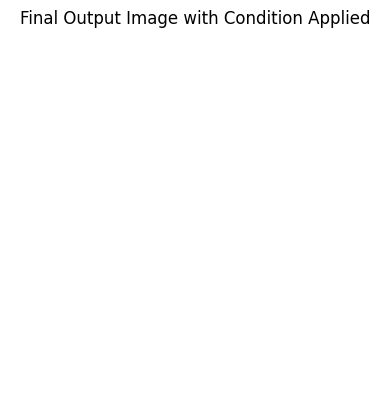

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2040_6.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (191/328)58.23%: static/inputs/JD2031_8.jpg


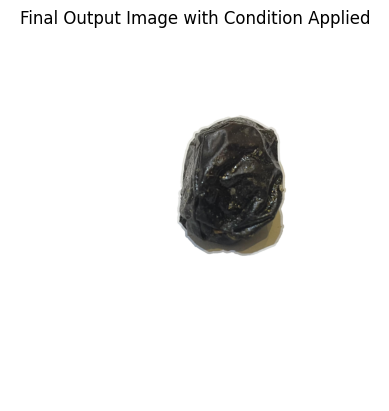

Processing (192/328)58.54%: static/inputs/JD2002_4.jpg


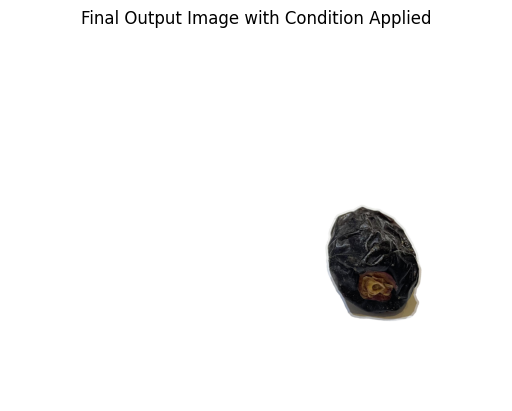

Processing (193/328)58.84%: static/inputs/JD2018_7.jpg


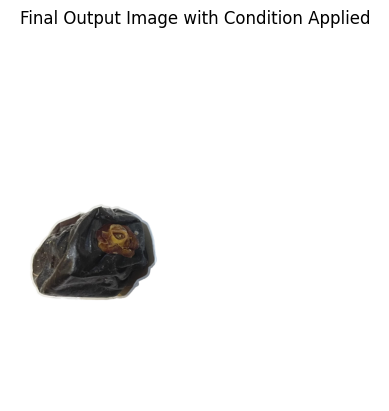

Processing (194/328)59.15%: static/inputs/JD2032_2.jpg


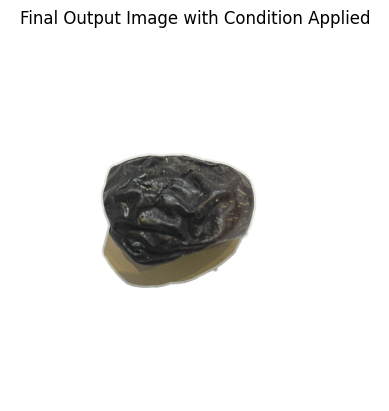

Processing (195/328)59.45%: static/inputs/JD2001_7.jpg


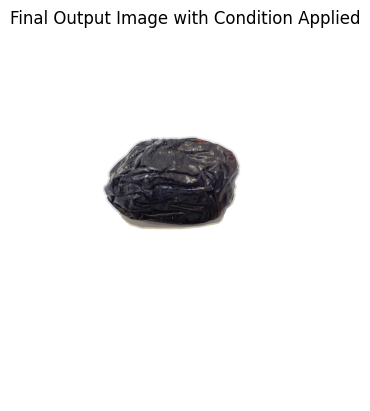

Processing (196/328)59.76%: static/inputs/JD2020_3.jpg


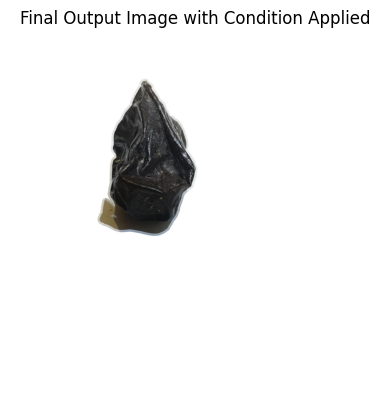

Processing (197/328)60.06%: static/inputs/JD2017_6.jpg


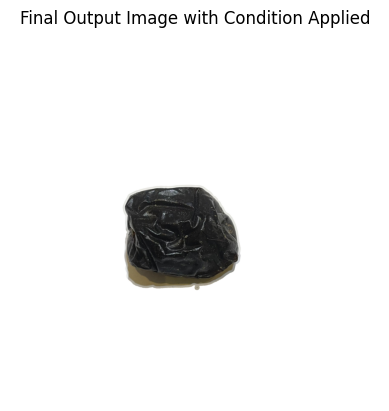

Processing (198/328)60.37%: static/inputs/JD2009_4.jpg


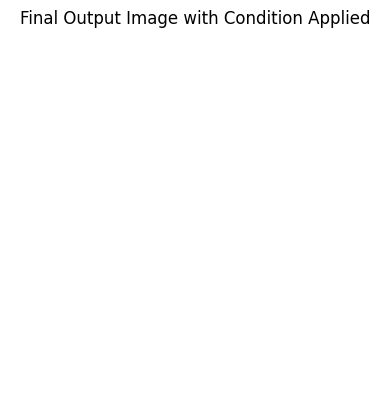

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2009_4.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (199/328)60.67%: static/inputs/JD2035_5.jpg


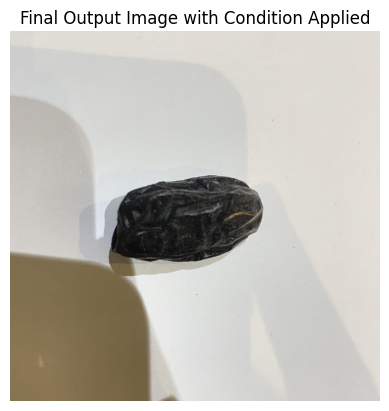

Processing (200/328)60.98%: static/inputs/JD2028_8.jpg


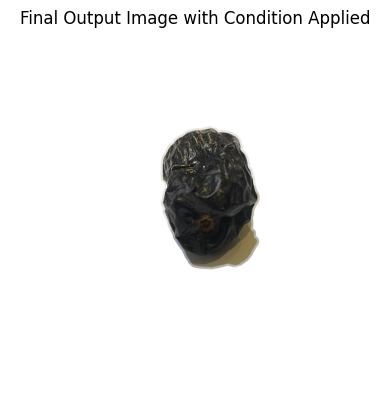

Processing (201/328)61.28%: static/inputs/JD2008_5.jpg


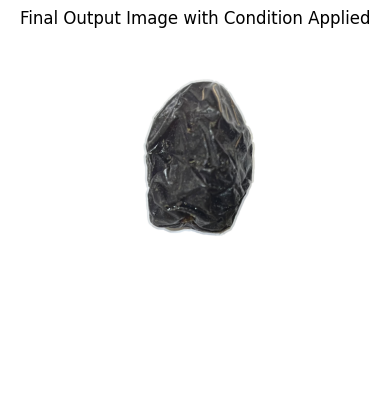

Processing (202/328)61.59%: static/inputs/JD2032_3.jpg


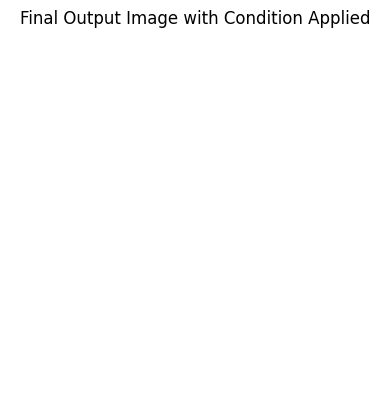

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2032_3.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (203/328)61.89%: static/inputs/JD2009_8.jpg


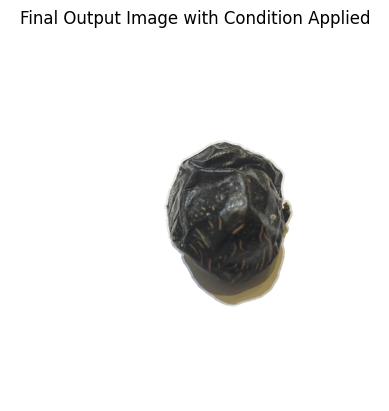

Processing (204/328)62.20%: static/inputs/JD2006_1.jpg


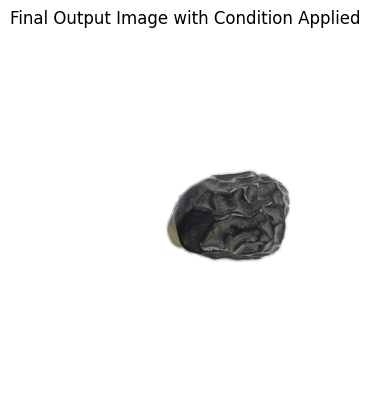

Processing (205/328)62.50%: static/inputs/JD2033_2.jpg


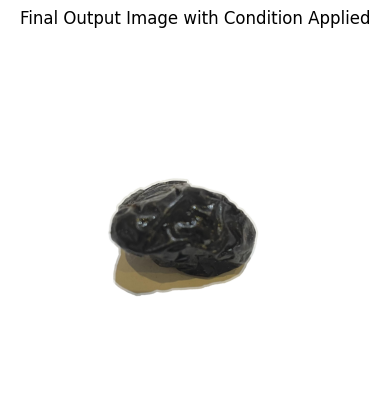

Processing (206/328)62.80%: static/inputs/JD2019_6.jpg


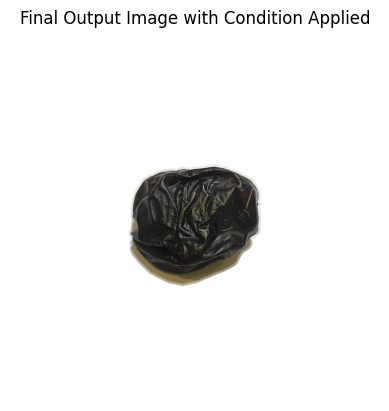

Processing (207/328)63.11%: static/inputs/JD2040_2.jpg


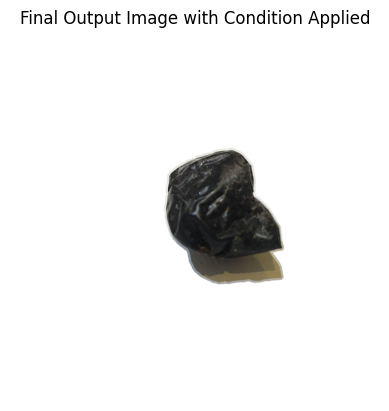

Processing (208/328)63.41%: static/inputs/JD2001_2.jpg


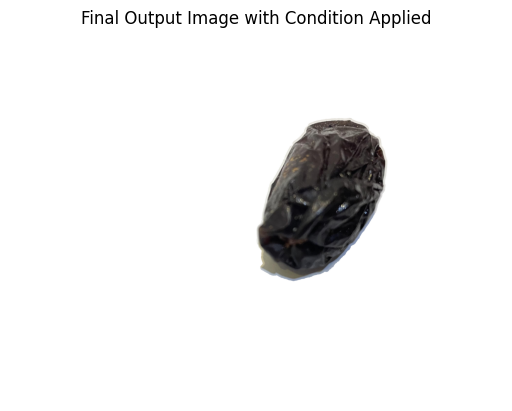

Processing (209/328)63.72%: static/inputs/JD2041_7.jpg


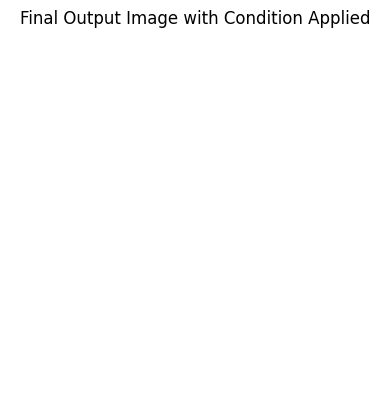

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2041_7.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (210/328)64.02%: static/inputs/JD2003_7.jpg


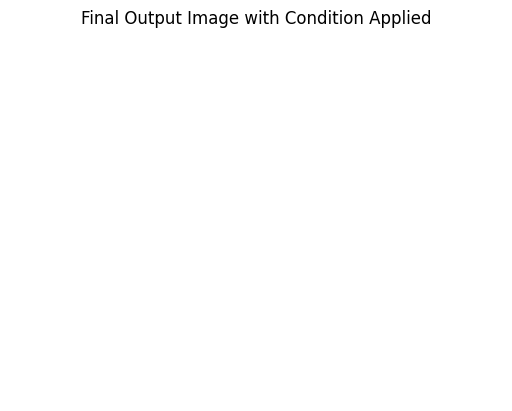

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2003_7.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (211/328)64.33%: static/inputs/JD2028_3.jpg


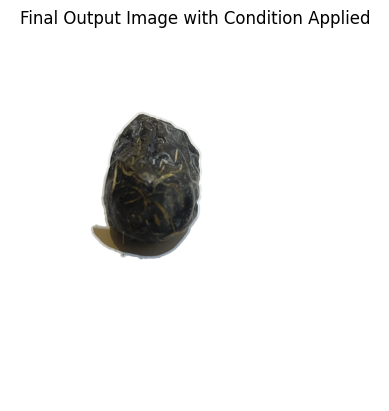

Processing (212/328)64.63%: static/inputs/JD2019_5.jpg


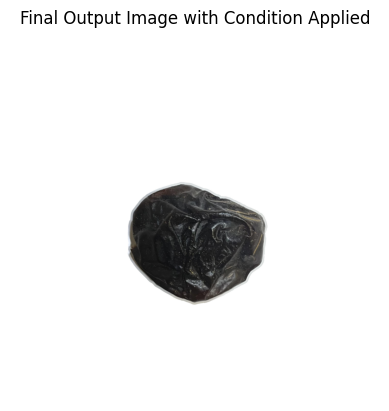

Processing (213/328)64.94%: static/inputs/JD2025_2.jpg


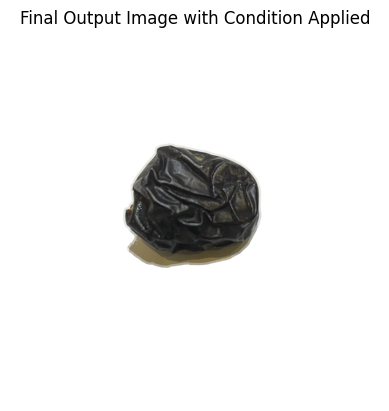

Processing (214/328)65.24%: static/inputs/JD2015_4.jpg


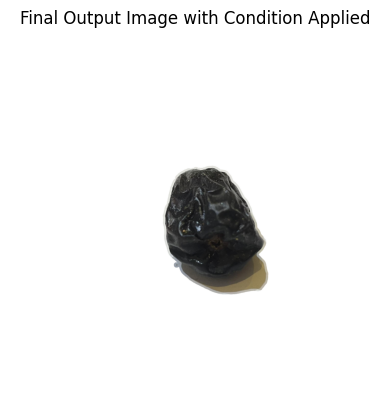

Processing (215/328)65.55%: static/inputs/JD2006_7.jpg


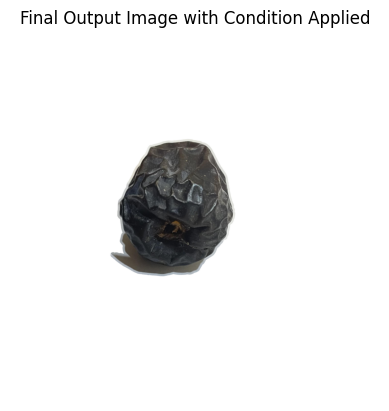

Processing (216/328)65.85%: static/inputs/JD2034_1.jpg


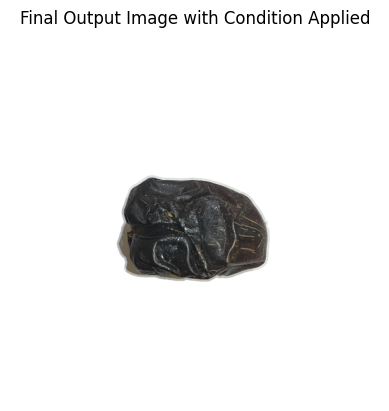

Processing (217/328)66.16%: static/inputs/JD2002_1.jpg


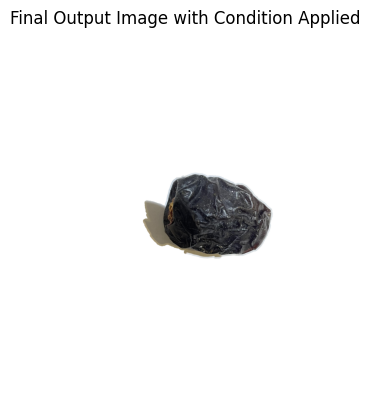

Processing (218/328)66.46%: static/inputs/JD2035_2.jpg


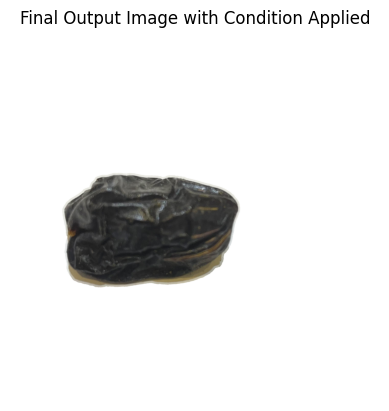

Processing (219/328)66.77%: static/inputs/JD2007_8.jpg


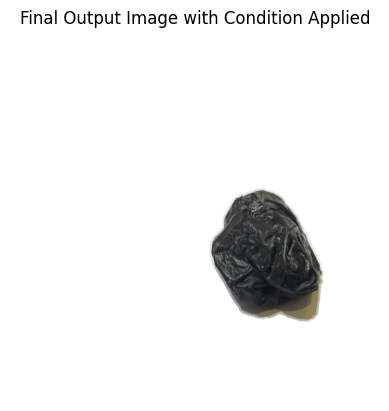

Processing (220/328)67.07%: static/inputs/JD2005_6.jpg


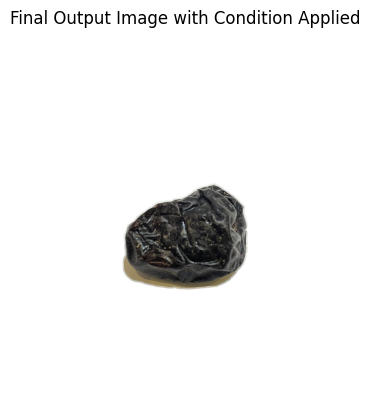

Processing (221/328)67.38%: static/inputs/JD2030_1.jpg


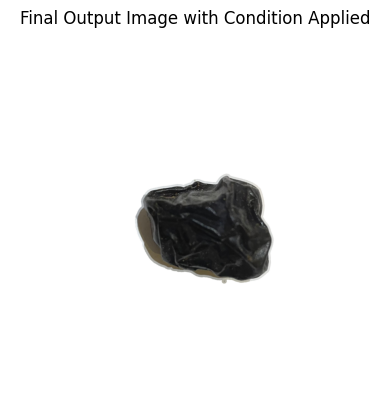

Processing (222/328)67.68%: static/inputs/JD2022_6.jpg


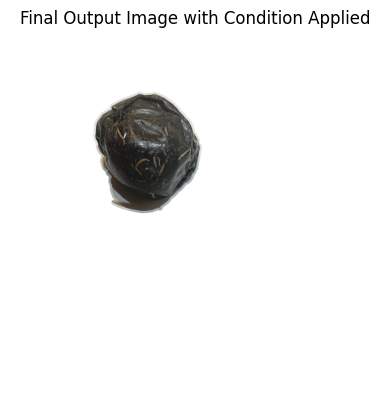

Processing (223/328)67.99%: static/inputs/JD2011_2.jpg


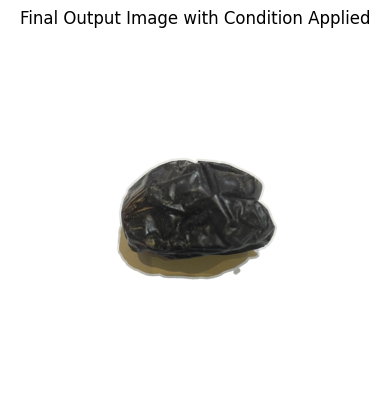

Processing (224/328)68.29%: static/inputs/JD2008_4.jpg


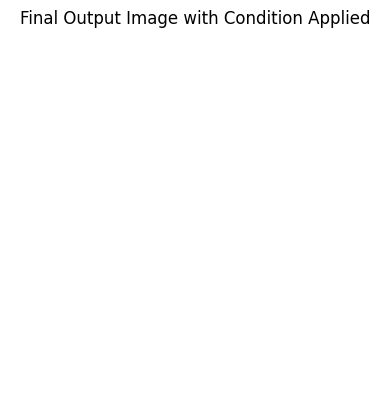

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2008_4.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (225/328)68.60%: static/inputs/JD2008_7.jpg


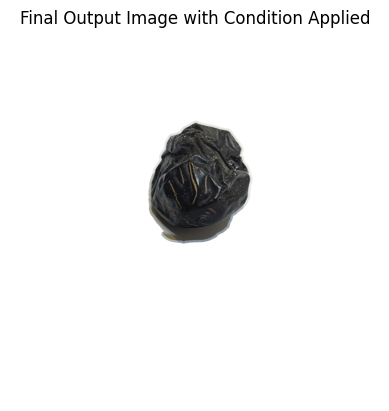

Processing (226/328)68.90%: static/inputs/JD2023_7.jpg


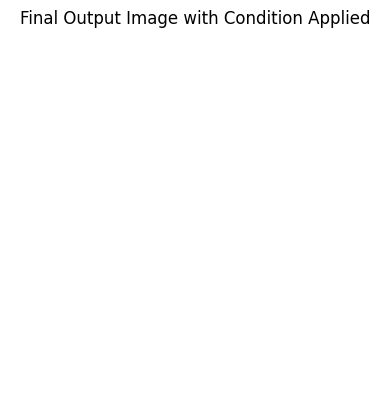

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2023_7.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (227/328)69.21%: static/inputs/JD2018_5.jpg


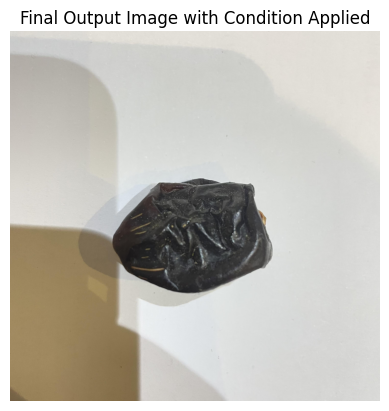

Processing (228/328)69.51%: static/inputs/JD2028_6.jpg


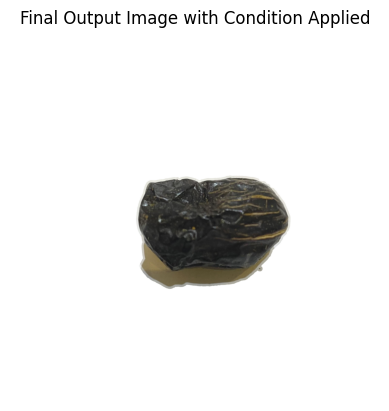

Processing (229/328)69.82%: static/inputs/JD2010_8.jpg


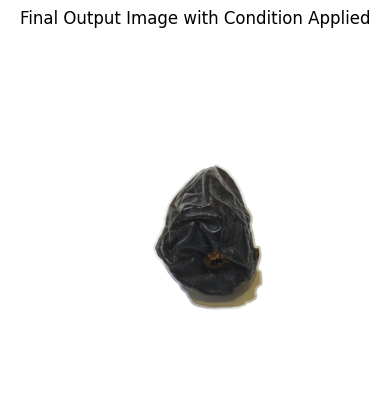

Processing (230/328)70.12%: static/inputs/JD2028_2.jpg


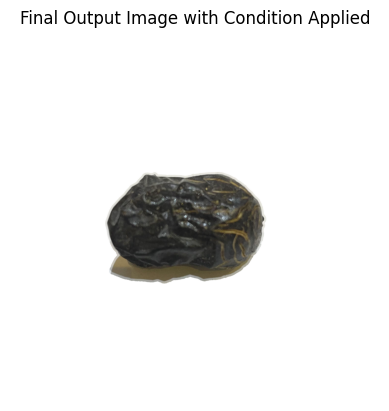

Processing (231/328)70.43%: static/inputs/JD2027_4.jpg


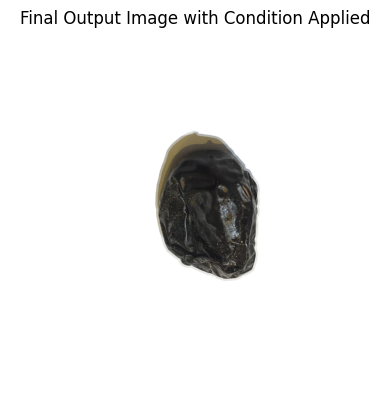

Processing (232/328)70.73%: static/inputs/JD2038_1.jpg


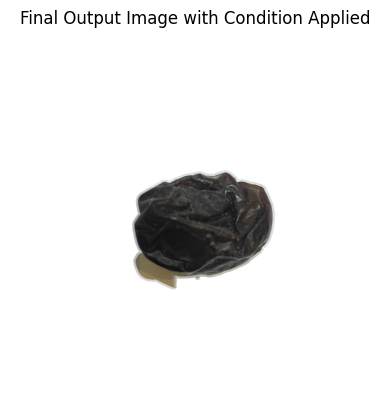

Processing (233/328)71.04%: static/inputs/JD2010_3.jpg


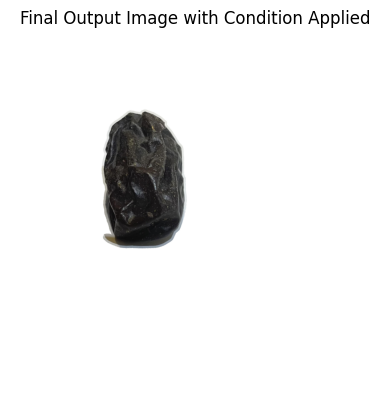

Processing (234/328)71.34%: static/inputs/JD2013_6.jpg


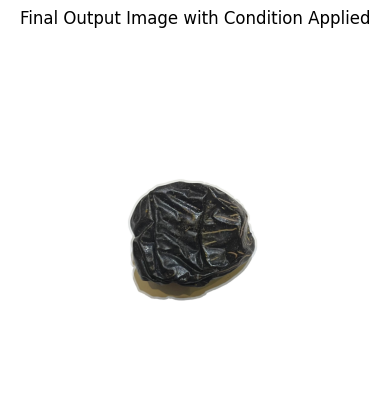

Processing (235/328)71.65%: static/inputs/JD2003_3.jpg


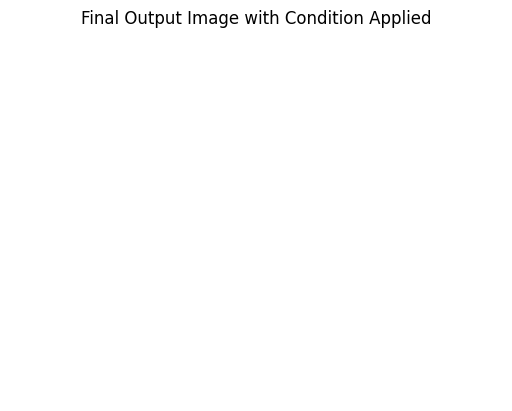

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2003_3.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (236/328)71.95%: static/inputs/JD2028_5.jpg


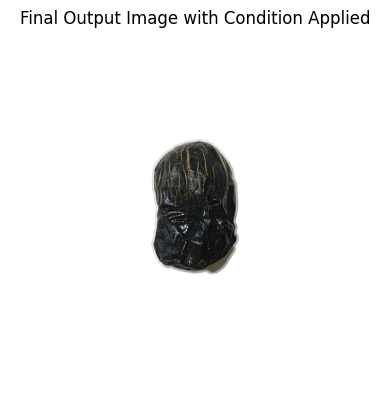

Processing (237/328)72.26%: static/inputs/JD2023_3.jpg


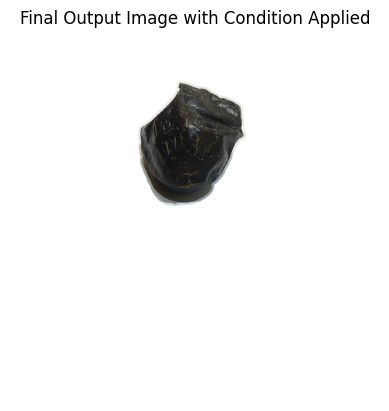

Processing (238/328)72.56%: static/inputs/JD2015_5.jpg


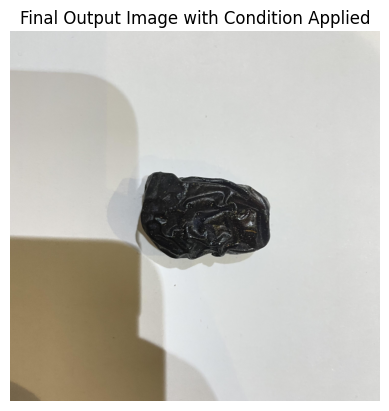

Processing (239/328)72.87%: static/inputs/JD2004_5.jpg


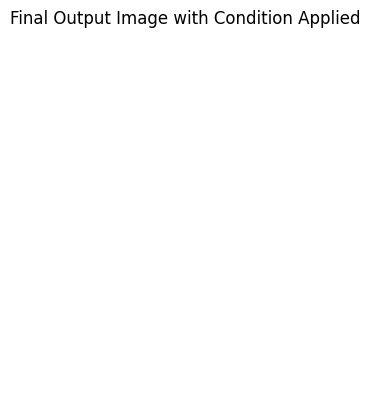

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2004_5.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (240/328)73.17%: static/inputs/JD2028_4.jpg


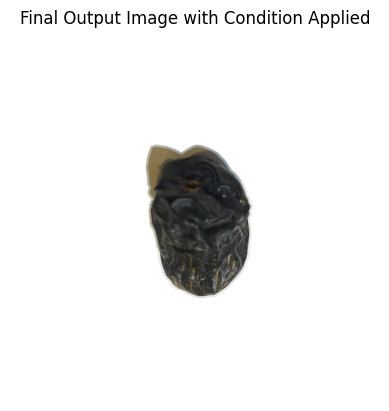

Processing (241/328)73.48%: static/inputs/JD2020_6.jpg


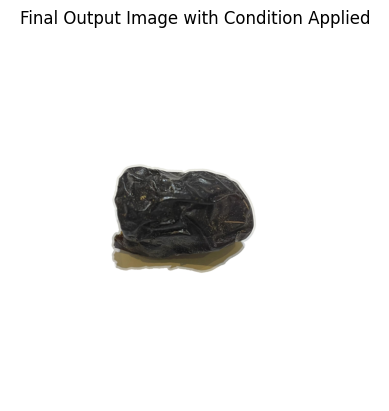

Processing (242/328)73.78%: static/inputs/JD2035_7.jpg


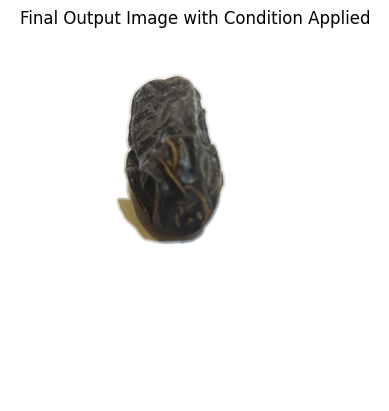

Processing (243/328)74.09%: static/inputs/JD2015_1.jpg


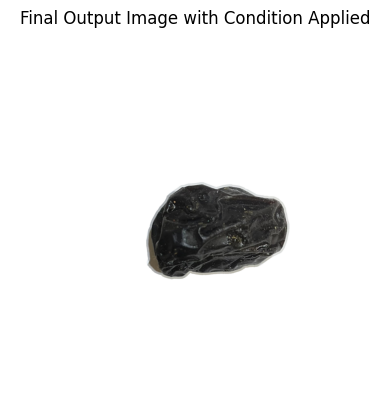

Processing (244/328)74.39%: static/inputs/JD2039_4.jpg


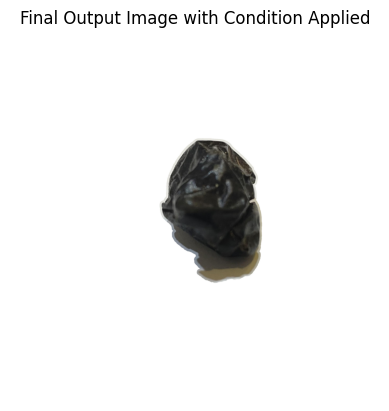

Processing (245/328)74.70%: static/inputs/JD2032_1.jpg


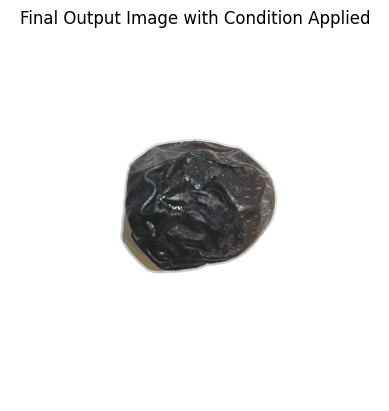

Processing (246/328)75.00%: static/inputs/JD2020_5.jpg


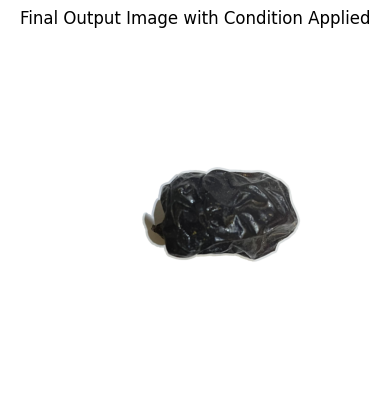

Processing (247/328)75.30%: static/inputs/JD2012_6.jpg


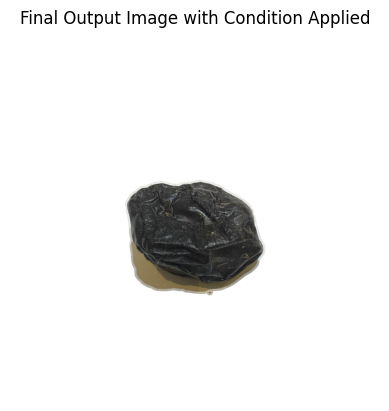

Processing (248/328)75.61%: static/inputs/JD2008_6.jpg


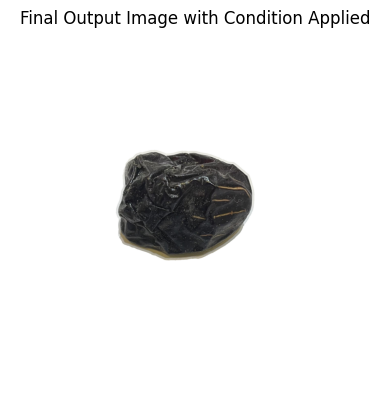

Processing (249/328)75.91%: static/inputs/JD2021_7.jpg


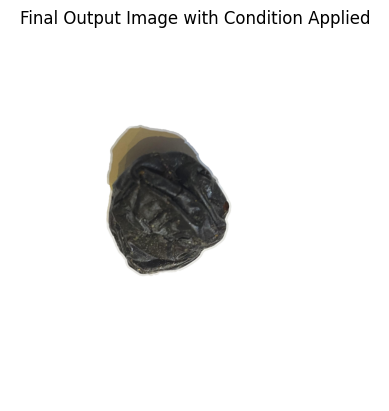

Processing (250/328)76.22%: static/inputs/JD2002_8.jpg


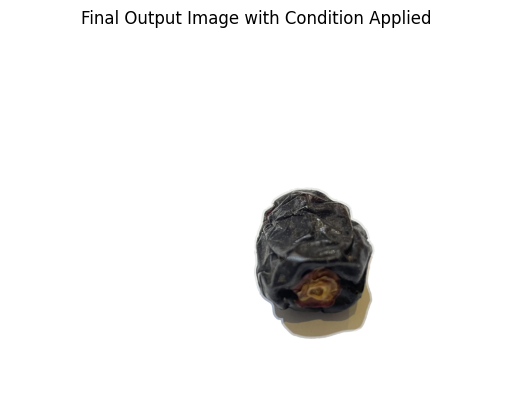

Processing (251/328)76.52%: static/inputs/JD2023_4.jpg


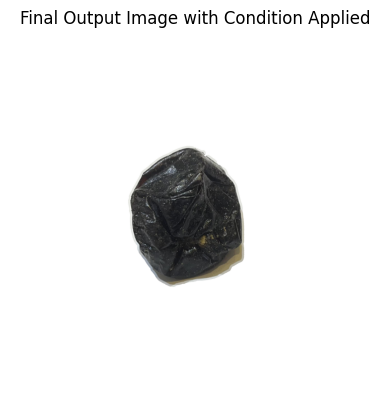

Processing (252/328)76.83%: static/inputs/JD2014_3.jpg


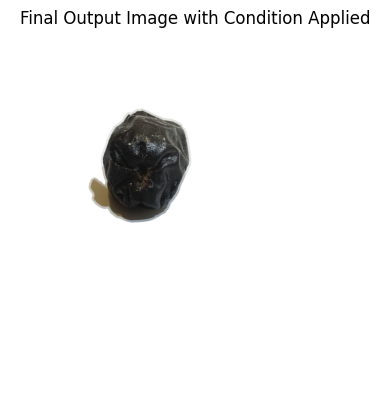

Processing (253/328)77.13%: static/inputs/JD2005_2.jpg


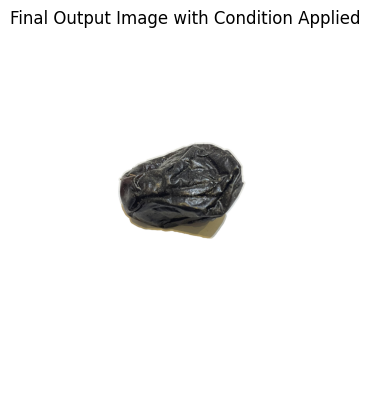

Processing (254/328)77.44%: static/inputs/JD2001_6.jpg


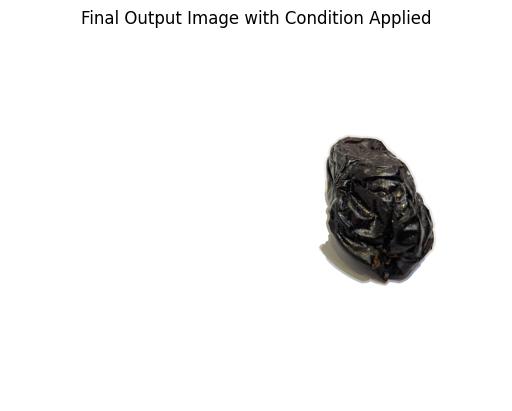

Processing (255/328)77.74%: static/inputs/JD2041_1.jpg


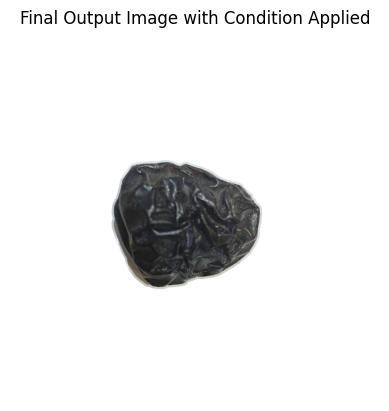

Processing (256/328)78.05%: static/inputs/JD2007_4.jpg


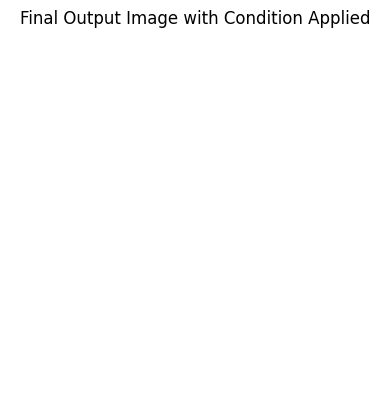

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2007_4.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (257/328)78.35%: static/inputs/JD2004_4.jpg


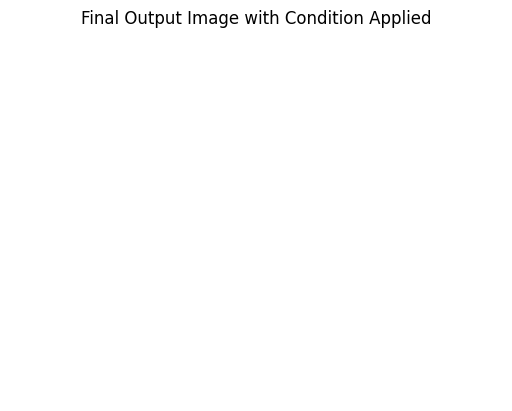

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2004_4.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (258/328)78.66%: static/inputs/JD2023_8.jpg


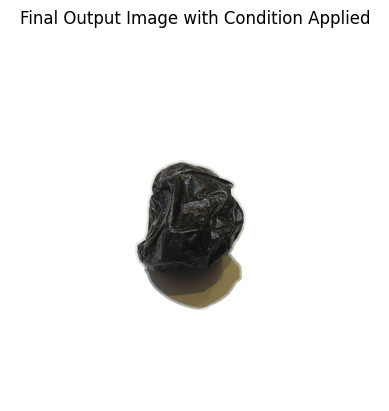

Processing (259/328)78.96%: static/inputs/JD2003_1.jpg


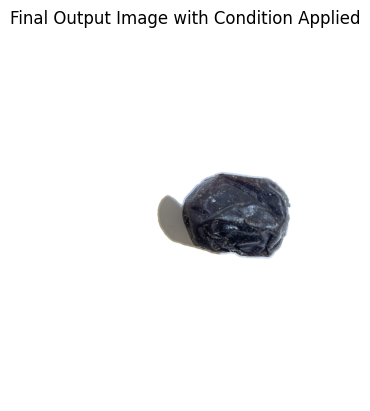

Processing (260/328)79.27%: static/inputs/JD2014_1.jpg


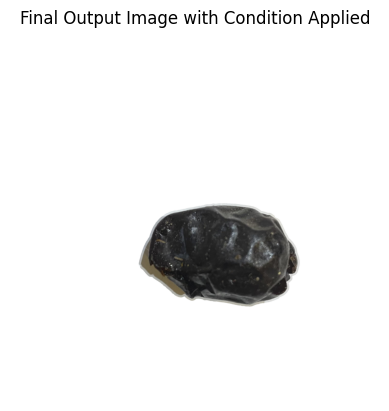

Processing (261/328)79.57%: static/inputs/JD2010_7.jpg


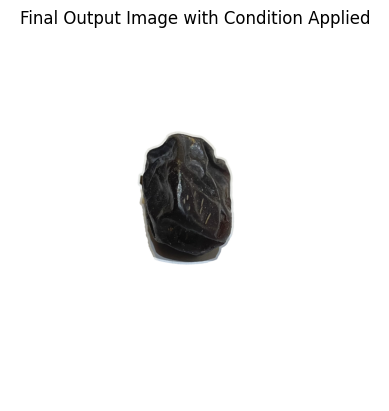

Processing (262/328)79.88%: static/inputs/JD2034_8.jpg


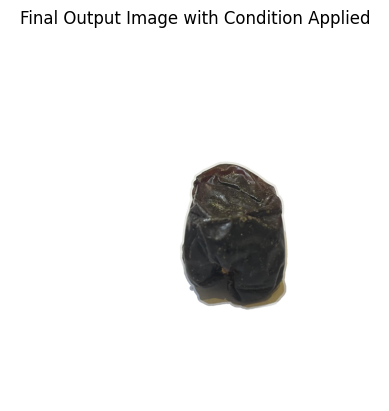

Processing (263/328)80.18%: static/inputs/JD2023_1.jpg


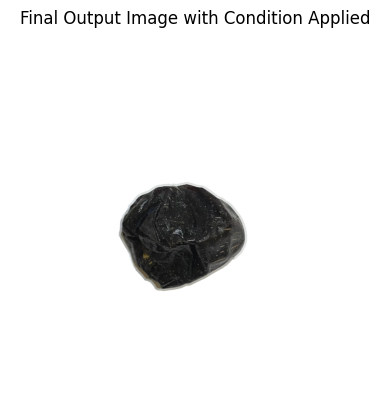

Processing (264/328)80.49%: static/inputs/JD2005_8.jpg


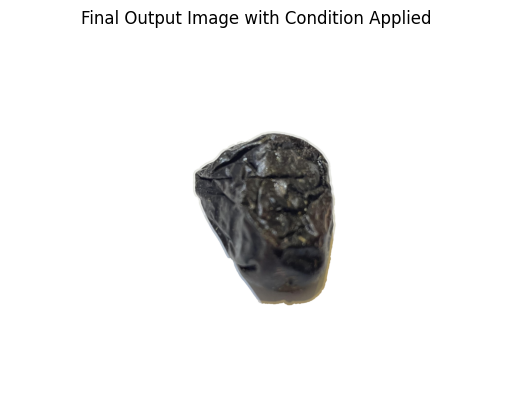

Processing (265/328)80.79%: static/inputs/JD2013_4.jpg


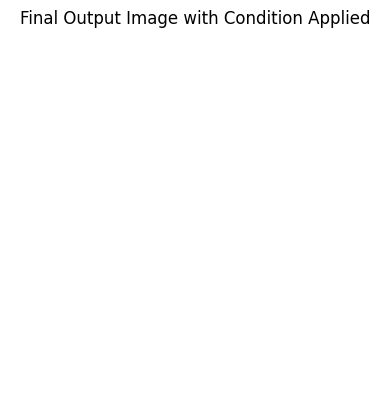

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2013_4.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (266/328)81.10%: static/inputs/JD2020_4.jpg


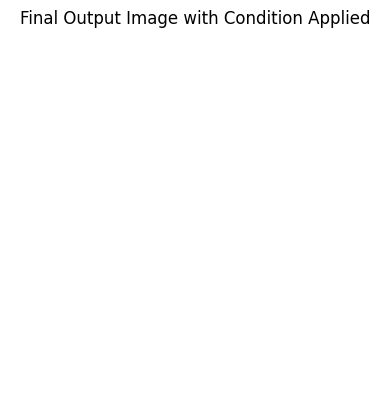

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2020_4.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (267/328)81.40%: static/inputs/JD2011_4.jpg


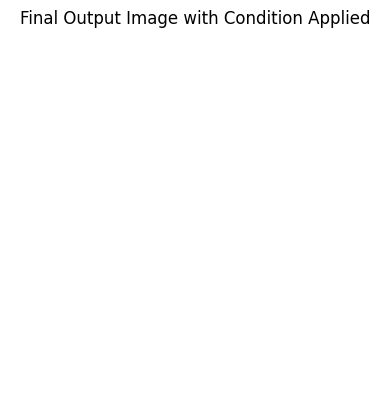

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2011_4.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (268/328)81.71%: static/inputs/JD2026_7.jpg


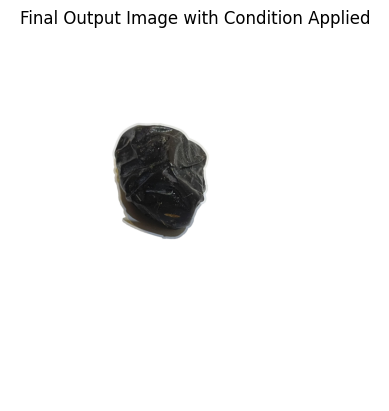

Processing (269/328)82.01%: static/inputs/JD2023_5.jpg


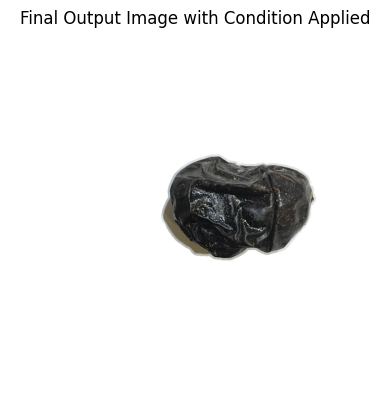

Processing (270/328)82.32%: static/inputs/JD2041_4.jpg


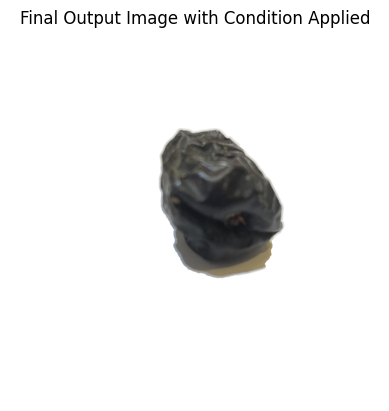

Processing (271/328)82.62%: static/inputs/JD2030_6.jpg


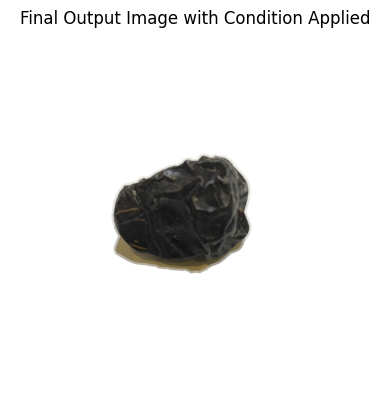

Processing (272/328)82.93%: static/inputs/JD2006_6.jpg


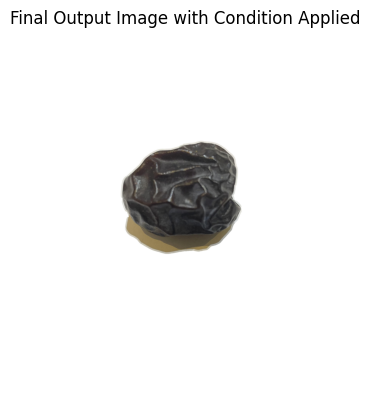

Processing (273/328)83.23%: static/inputs/JD2009_5.jpg


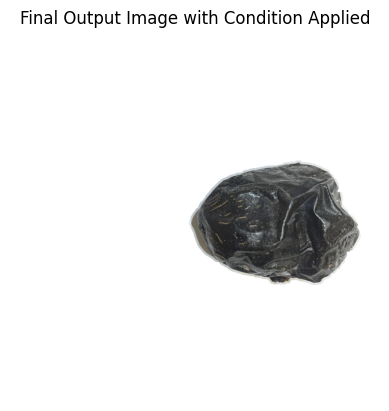

Processing (274/328)83.54%: static/inputs/JD2039_2.jpg


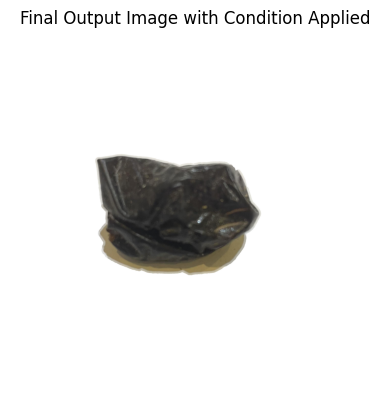

Processing (275/328)83.84%: static/inputs/JD2012_2.jpg


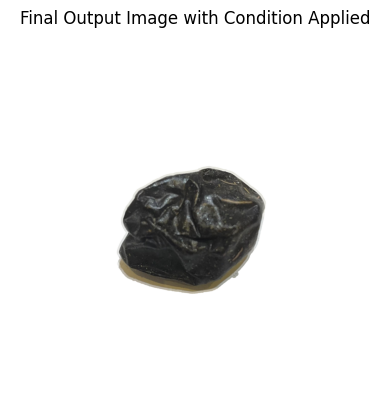

Processing (276/328)84.15%: static/inputs/JD2037_2.jpg


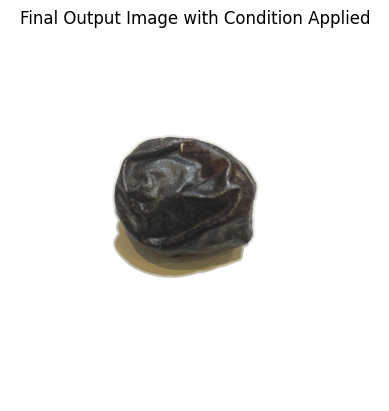

Processing (277/328)84.45%: static/inputs/JD2022_7.jpg


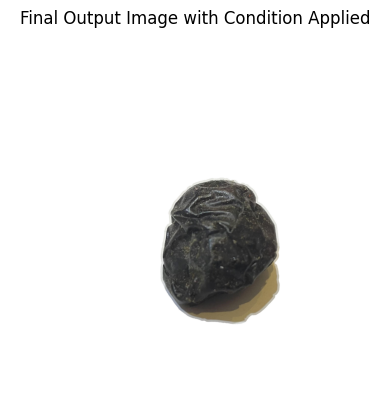

Processing (278/328)84.76%: static/inputs/JD2033_8.jpg


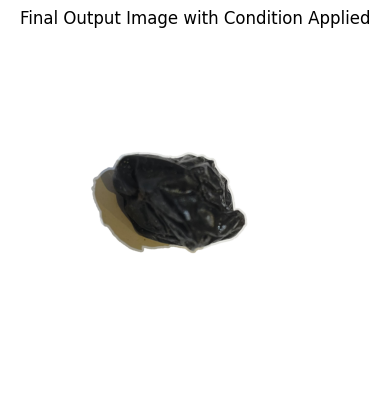

Processing (279/328)85.06%: static/inputs/JD2001_3.jpg


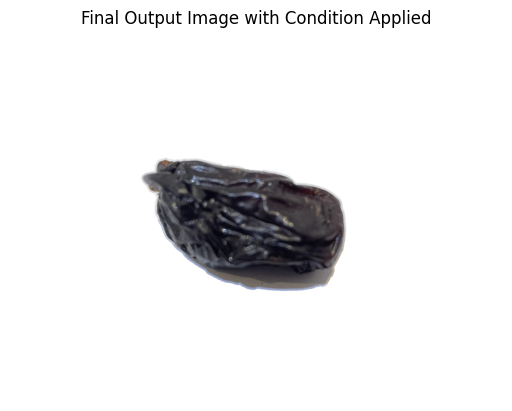

Processing (280/328)85.37%: static/inputs/JD2022_2.jpg


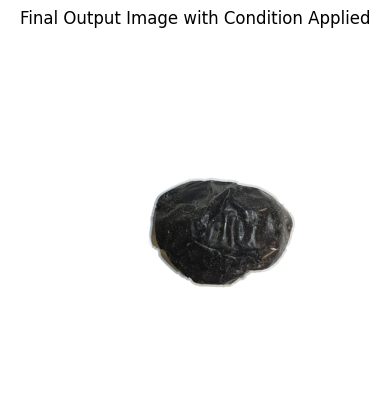

Processing (281/328)85.67%: static/inputs/JD2032_8.jpg


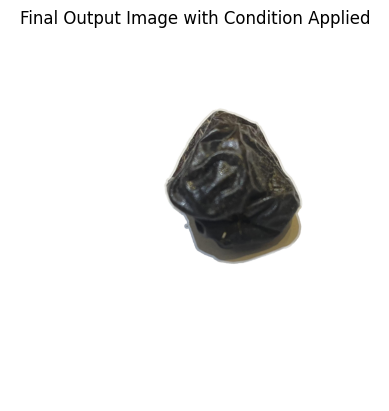

Processing (282/328)85.98%: static/inputs/JD2030_3.jpg


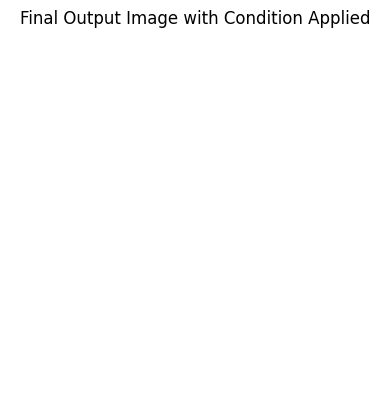

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2030_3.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (283/328)86.28%: static/inputs/JD2040_7.jpg


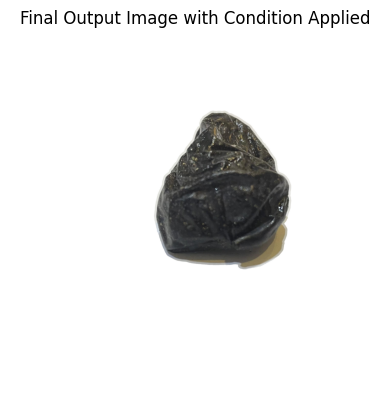

Processing (284/328)86.59%: static/inputs/JD2038_7.jpg


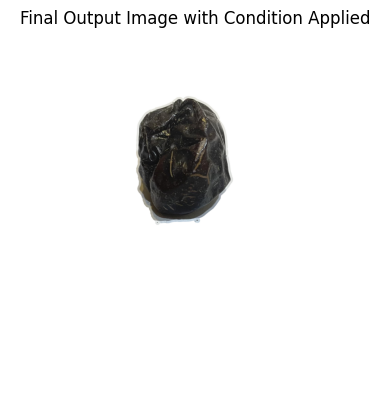

Processing (285/328)86.89%: static/inputs/JD2041_2.jpg


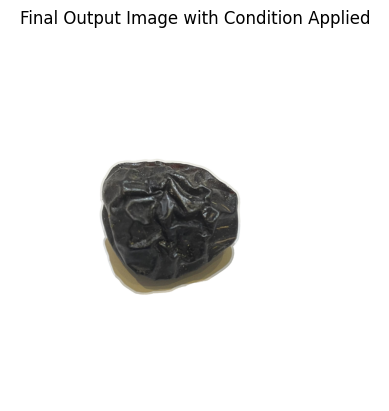

Processing (286/328)87.20%: static/inputs/JD2028_1.jpg


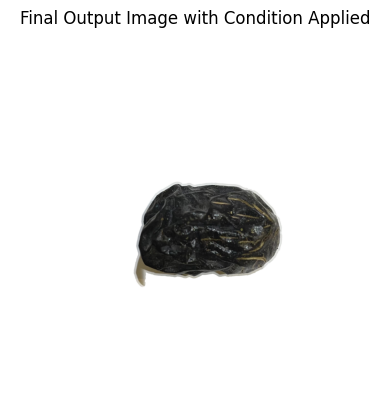

Processing (287/328)87.50%: static/inputs/JD2040_8.jpg


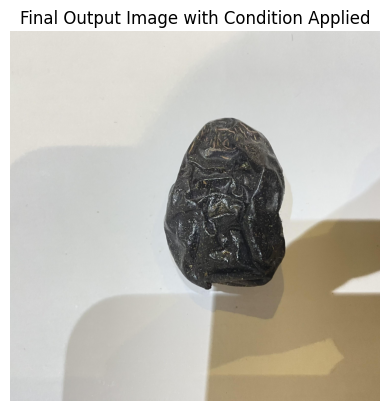

Processing (288/328)87.80%: static/inputs/JD2031_2.jpg


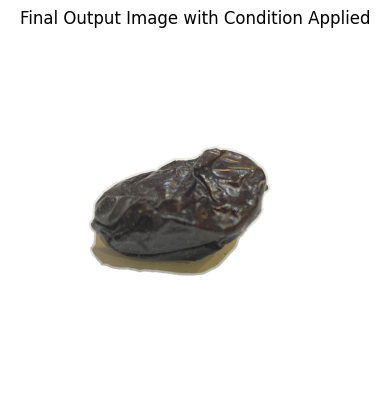

Processing (289/328)88.11%: static/inputs/JD2019_7.jpg


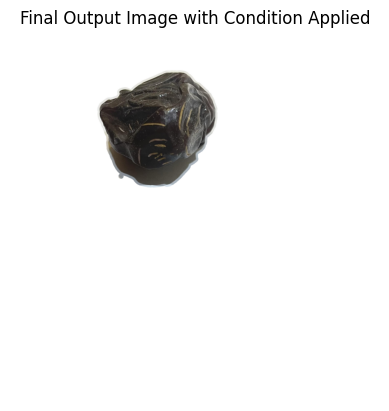

Processing (290/328)88.41%: static/inputs/JD2034_4.jpg


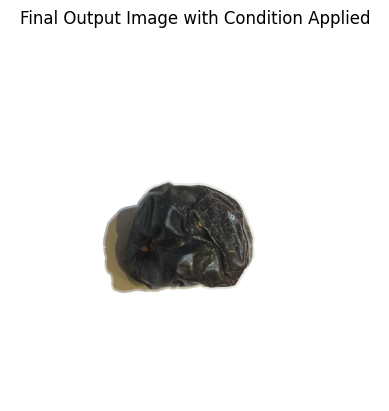

Processing (291/328)88.72%: static/inputs/JD2024_8.jpg


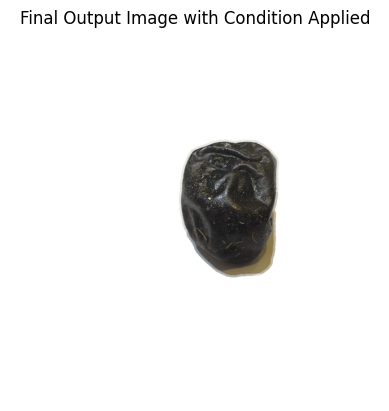

Processing (292/328)89.02%: static/inputs/JD2009_2.jpg


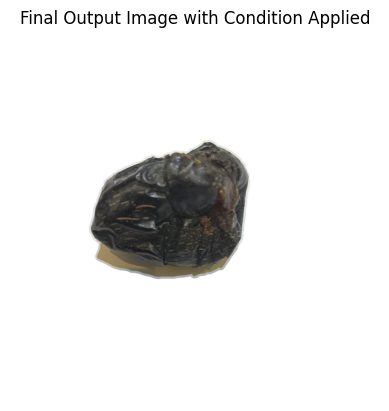

Processing (293/328)89.33%: static/inputs/JD2026_2.jpg


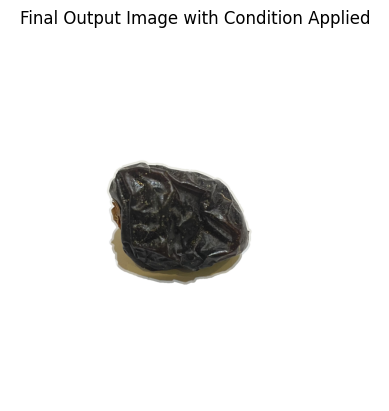

Processing (294/328)89.63%: static/inputs/JD2029_8.jpg


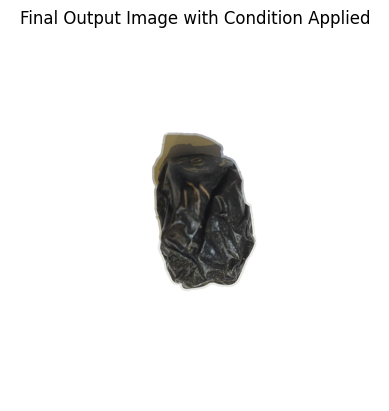

Processing (295/328)89.94%: static/inputs/JD2018_4.jpg


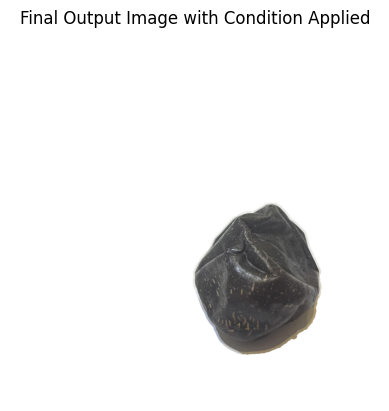

Processing (296/328)90.24%: static/inputs/JD2005_4.jpg


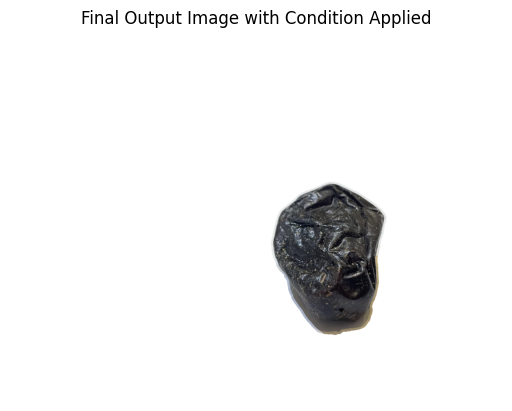

Processing (297/328)90.55%: static/inputs/JD2013_1.jpg


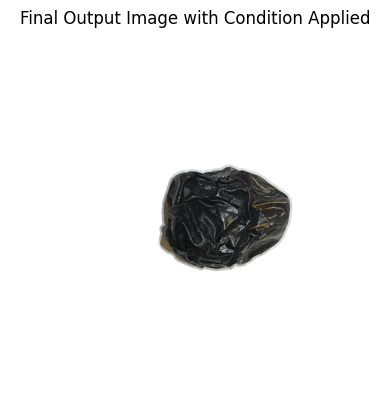

Processing (298/328)90.85%: static/inputs/JD2037_4.jpg


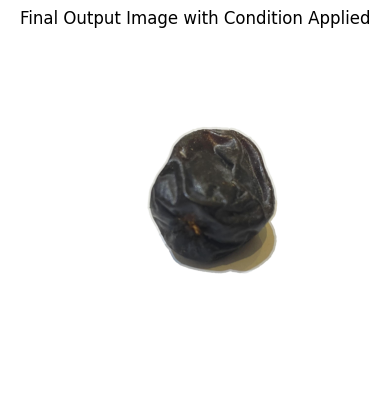

Processing (299/328)91.16%: static/inputs/JD2027_1.jpg


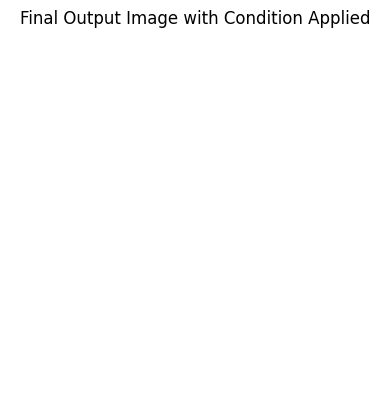

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2027_1.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (300/328)91.46%: static/inputs/JD2004_6.jpg


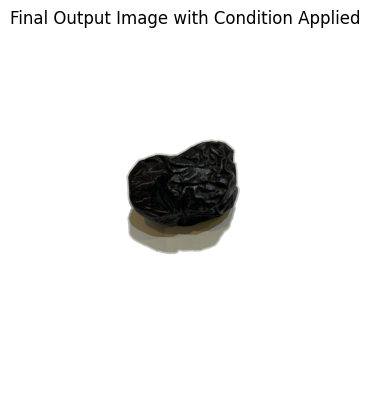

Processing (301/328)91.77%: static/inputs/JD2034_2.jpg


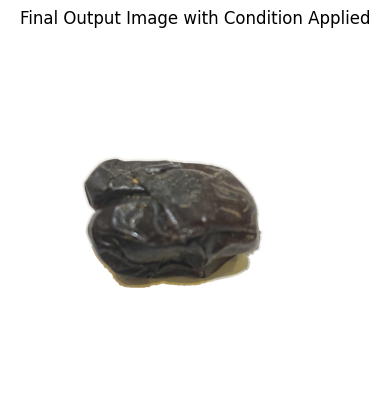

Processing (302/328)92.07%: static/inputs/JD2036_5.jpg


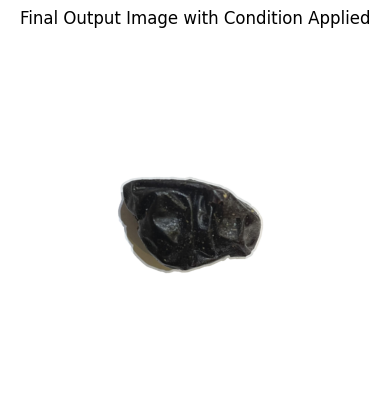

Processing (303/328)92.38%: static/inputs/JD2012_8.jpg


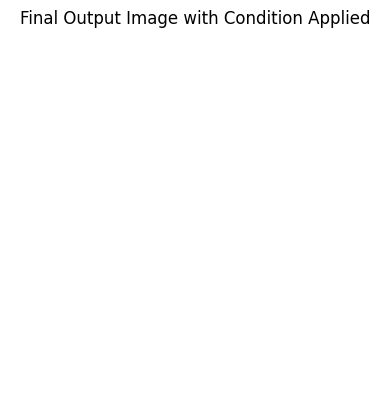

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2012_8.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (304/328)92.68%: static/inputs/JD2014_8.jpg


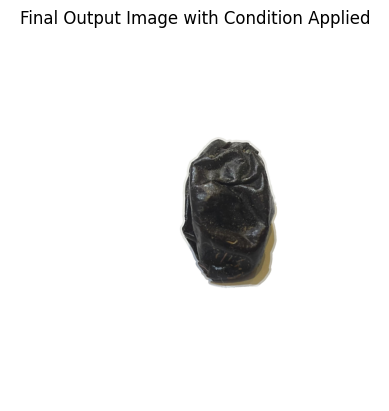

Processing (305/328)92.99%: static/inputs/JD2030_2.jpg


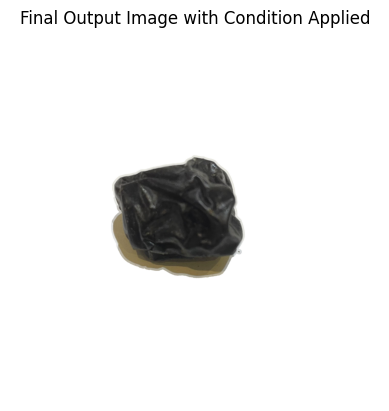

Processing (306/328)93.29%: static/inputs/JD2029_2.jpg


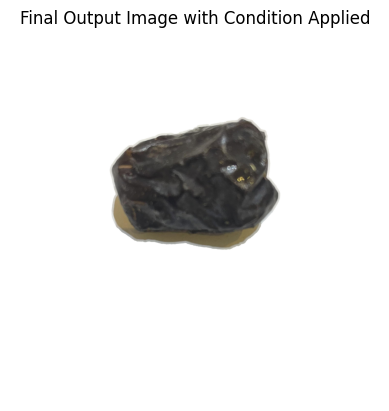

Processing (307/328)93.60%: static/inputs/JD2016_4.jpg


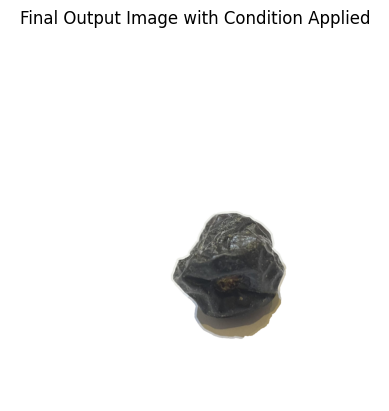

Processing (308/328)93.90%: static/inputs/JD2005_5.jpg


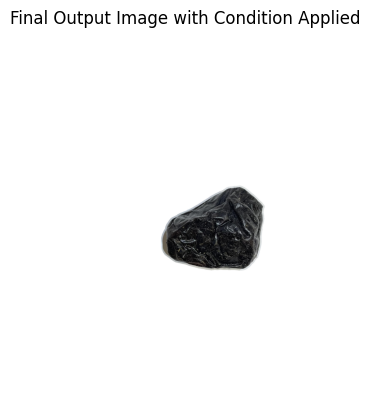

Processing (309/328)94.21%: static/inputs/JD2039_6.jpg


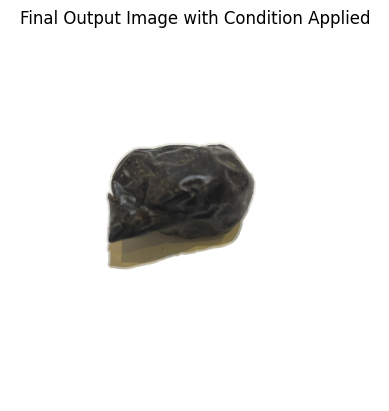

Processing (310/328)94.51%: static/inputs/JD2019_2.jpg


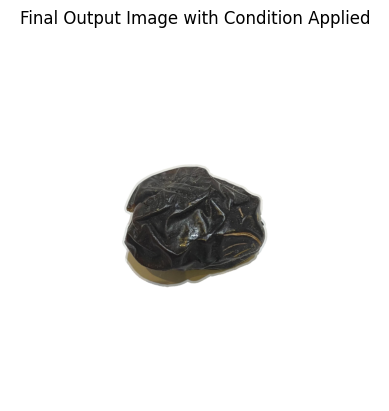

Processing (311/328)94.82%: static/inputs/JD2017_2.jpg


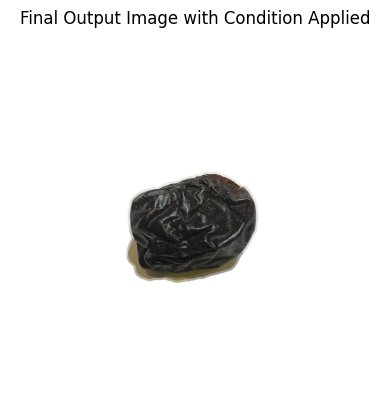

Processing (312/328)95.12%: static/inputs/JD2016_2.jpg


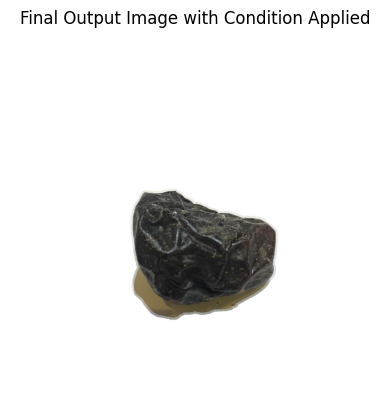

Processing (313/328)95.43%: static/inputs/JD2013_8.jpg


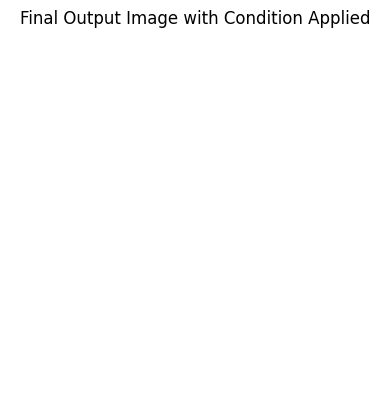

/tmp/ipykernel_16481/2528290728.py:21: UserWarning: static/processed_results/JD2013_8.jpg is a low contrast image
  imsave(output_path, cleaned_processed_image)


Processing (314/328)95.73%: static/inputs/JD2008_2.jpg


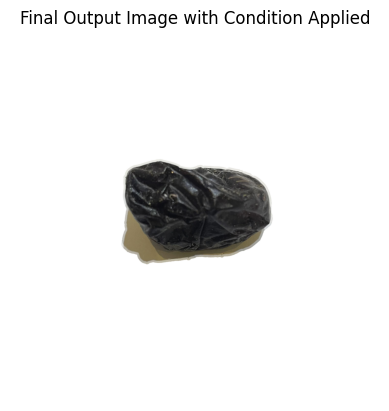

Processing (315/328)96.04%: static/inputs/JD2006_3.jpg


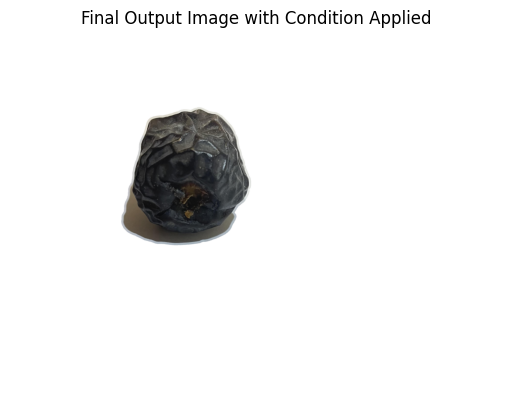

Processing (316/328)96.34%: static/inputs/JD2037_6.jpg


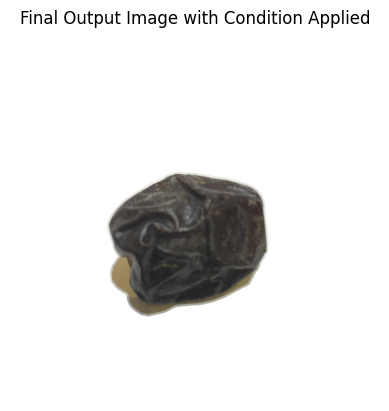

Processing (317/328)96.65%: static/inputs/JD2007_6.jpg


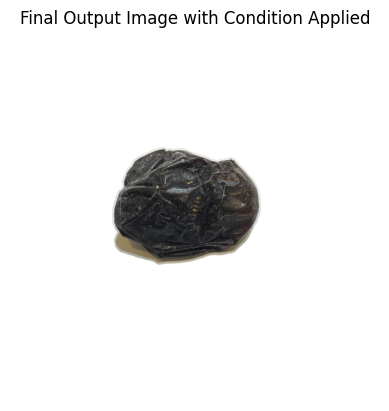

Processing (318/328)96.95%: static/inputs/JD2025_7.jpg


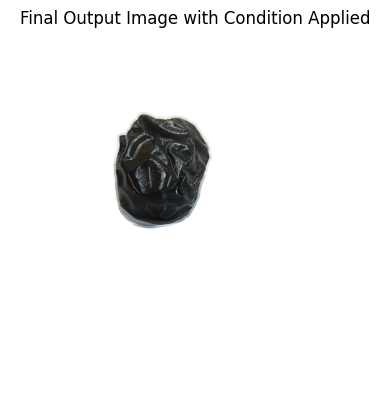

Processing (319/328)97.26%: static/inputs/JD2021_5.jpg


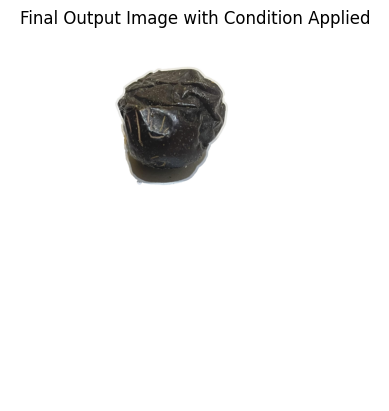

Processing (320/328)97.56%: static/inputs/JD2040_5.jpg


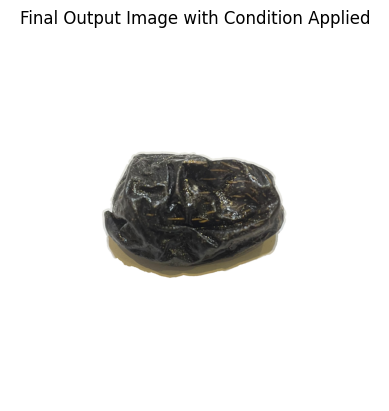

Processing (321/328)97.87%: static/inputs/JD2028_7.jpg


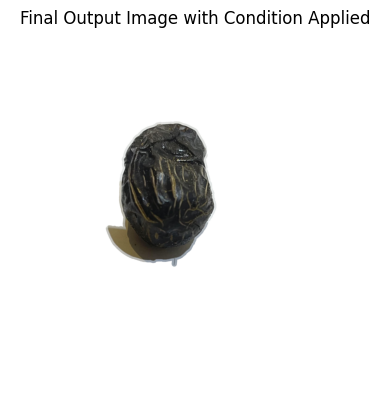

Processing (322/328)98.17%: static/inputs/JD2041_3.jpg


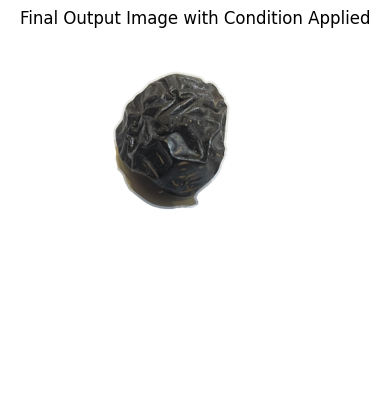

Processing (323/328)98.48%: static/inputs/JD2034_5.jpg


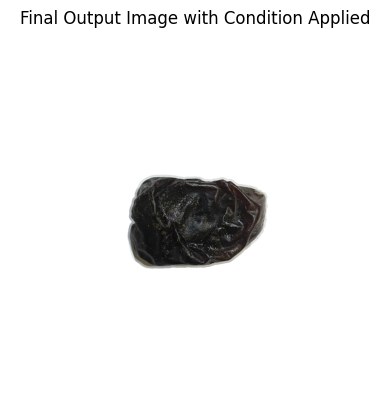

Processing (324/328)98.78%: static/inputs/JD2018_1.jpg


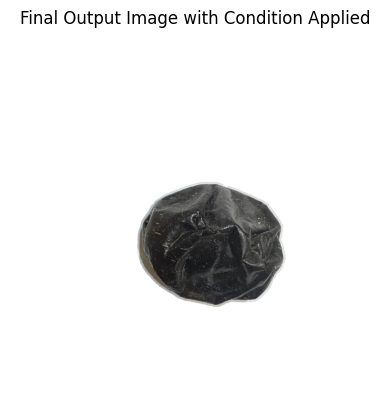

Processing (325/328)99.09%: static/inputs/JD2008_8.jpg


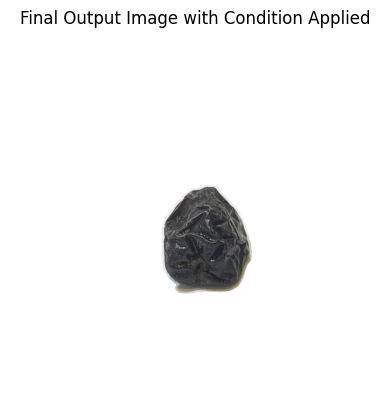

Processing (326/328)99.39%: static/inputs/JD2032_5.jpg


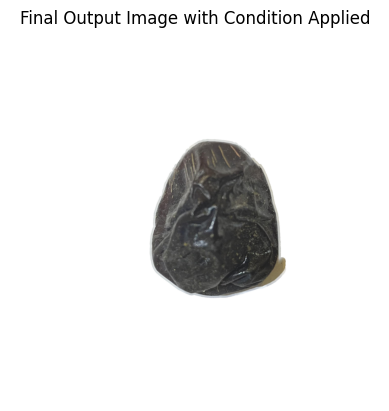

Processing (327/328)99.70%: static/inputs/JD2007_1.jpg


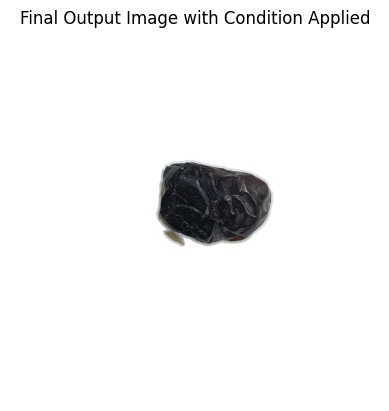

Processing (328/328)100.00%: static/inputs/JD2013_2.jpg


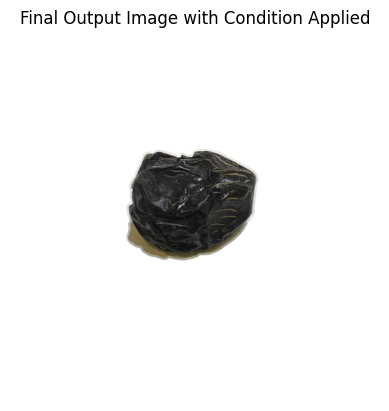

In [12]:
# Specify the paths
output_directory = "static/processed_results/"  # Specify your output directory here
if not os.path.exists(output_directory):
    os.makedirs(output_directory)




# ------- Loop through all PNG files in the directory --------
img_directory = "static/inputs/"
i=1
for imgPath in glob.glob(os.path.join(img_directory, "*.jpg")):
    print(f"Processing ({i}/328){((i/328)*100):.2f}%: {imgPath}")

    # ------- Call The Cleaning & Processing Function --------
    cleaned_processed_image = edge_detect_and_noise_remover_colored(imread(imgPath))

    # Construct output file path
    original_filename = os.path.basename(imgPath)  # Get the original image name
    output_path = os.path.join(output_directory, original_filename)
    imsave(output_path, cleaned_processed_image)

    i+=1